In [2]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

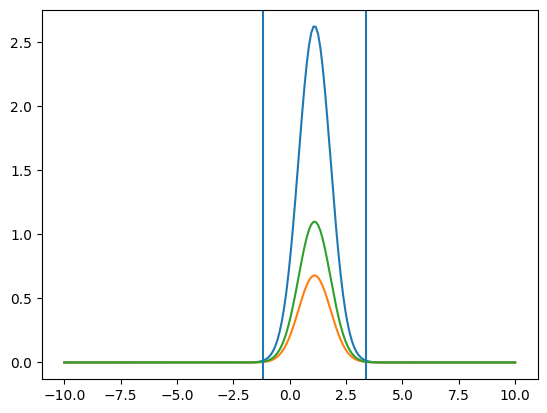

*Extracting Pieces for TH2*
Available Functions:
	Num_Xbins(TH2_) returns number of X bins for a TH2
	Num_Ybins(TH2_) returns number of Y bins for a TH2
	XEdges_2d(TH2_) returns edges of x bins for a TH2
	YEdges_2d(TH2_) returns edges of y bins for a TH2
	Center_Xbins(TH2_) returns center values for x bins for a TH2
	Center_Ybins(TH2_) returns center value for y bins for a TH2
	XY_Values(TH2_) returns a 2D np.array for z values arranged [x][y] for a TH2
	YX_Values(TH2_) returns a 2D np.array for z values arranged [y][x] for a TH2
Enjoy using TH2s



In [3]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions.ipynb
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb

In [43]:
sim="exp"
run="e16"
cut_perf="delta"
species = "pip"

date = "05-31-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/2024/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/06-13-2022"

root_file=dir+"/"+sim+"_"+run+"_clas6_"+cut_perf+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)
#selection 0-> pid in experimental W range, 1->event selection in full W range
selection = 1
# 0 => full range 1=> Experimental W range
W_range = 0

rel_top=['mnone','mall']

W_bits=['all','in_range']

In [44]:
#The Various layers of TDirectories to get to the histograms
layer1='Delta'
layer2=cut_perf+"_"+species
layer3=[layer2+"_pid",layer2+"_event"]
layer4=[[layer3[sel]+"_sec"+str(sec+1) for sel in range(2)] for sec in range(6)]
layer5=[[layer4[sec][sel]+"_cut" for sel in range(2)] for sec in range(6)]
layer6=[[layer5[sec][0]+"_mnone",layer5[sec][1]+"_mall"] for sec in range(6)]
layer7=[[layer6[sec][sel]+"_in_range" for sel in range(2)] for sec in range(6)]
layer8=[[layer3[sel]+"_cut_"+rel_top[sel]+"_sec"+str(sec+1)+"_"+W_bits[W_range] for sel in range(2)] for sec in range(6)]
dir_loc0= [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection] for sec in range(6)]
dir_loc = [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection]+"/"+layer8[sec][selection] for sec in range(6)]

hist = [file[dir_loc[sec]] for sec in range(6)]

print(layer8[0][selection])

delta_pip_event_cut_mall_sec1_all


In [45]:
print(layer8[0])
file[dir_loc0[0]].keys()


['delta_pip_pid_cut_mnone_sec1_all', 'delta_pip_event_cut_mall_sec1_all']


[b'delta_pip_event_cut_mall_sec1_in_range;1',
 b'delta_pip_event_cut_mall_sec1_all;1']

In [46]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

In [47]:
#Extracting X and Y bins
#X and Y binning is the same for all sectors
xbins=Center_Xbins(hist[0])
ybins=Center_Ybins(hist[0])

In [48]:
#Extracting Zvals for 2d histograms
zvals_xy=[XY_Values(hist[sec]) for sec in range(6)]
zvals_yx=[YX_Values(hist[sec]) for sec in range(6)]

In [49]:
#Determining Cell Merging 
xmerge=2
ymerge=2
xname="p(GeV)"
yname="\u0395 t"
#Merge -> No Zeros
x = Merge_Bins(xbins,xmerge)
y = Merge_Bins(ybins,ymerge)
xedges = Merge_Bin_Edges(XEdges_2d(hist[0]),xmerge)
yedges = Merge_Bin_Edges(YEdges_2d(hist[0]),ymerge)
z_xy=[Merge_Z(zvals_xy[i],xmerge,ymerge) for i in range(6)]
z_yx=[Merge_Z(zvals_xy[i],ymerge,xmerge) for i in range(6)]
fit_x = [[Remove_Zeros_X(y,z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
fit_y = [[Remove_Zeros_Y(z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]



In [50]:
#dumb_x= np.zeros((6,len(x)*len(y)))
#dumb_y= np.zeros((6,len(x)*len(y)))
#dense2 = np.zeros((6,len(x)*len(y)))
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    #for i in range(len(x)):
    for i in range(len(xbins)):
        #for j in range(len(y)):
        for j in range(len(ybins)):
            #dumb_x[sec][i+j*len(x)]+=x[i]
            #dumb_y[sec][i+j*len(x)]+=y[j]
            #dense2[sec][i+j*len(x)]+=zvals_xy[sec][i][j]
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]


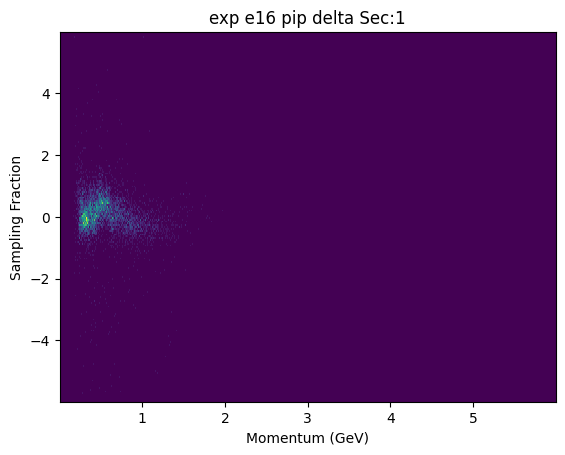

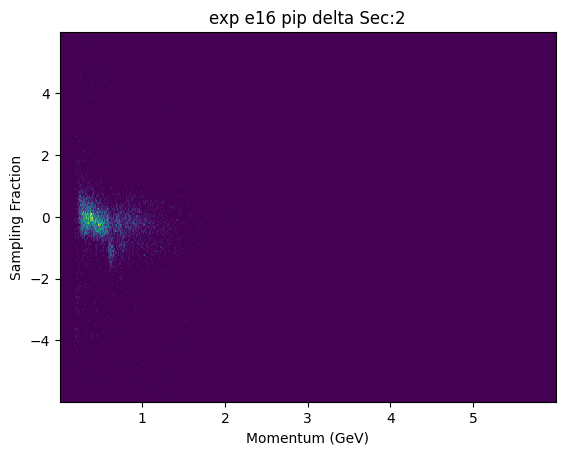

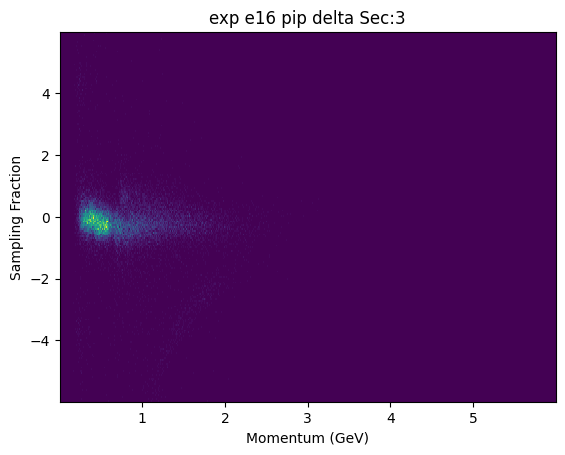

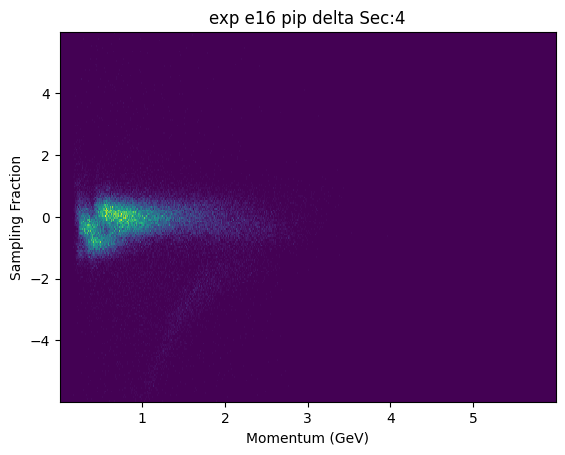

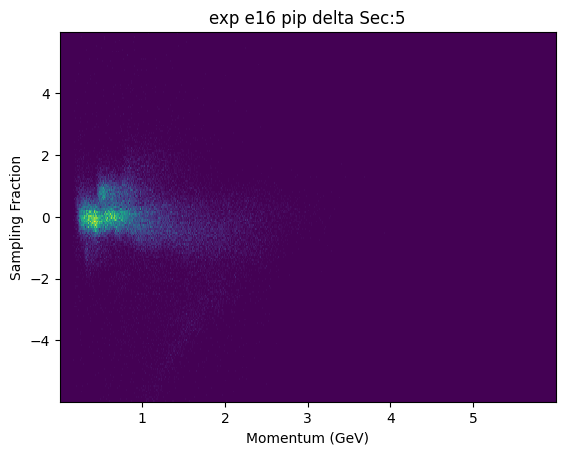

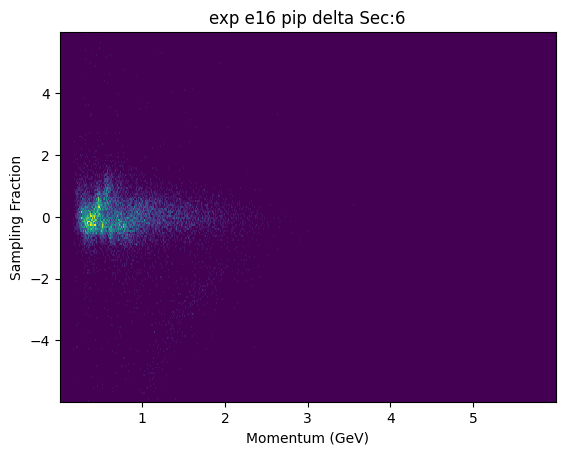

In [51]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(x), len(y)), weights=dense2[sec])
    plt.title("{} {} {} {} Sec:{}".format(sim,run,species,cut_perf,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("Sampling Fraction")
    plt.show()
    
    
    

In [52]:
def Pbin_low(xbin_):
    return round(xedges[xbin_],3)
def Pbin_top(xbin_):
    return round(xedges[xbin_+1],3)

-0.7559291430352854 0.6500968053225523
-0.8965317378710692 0.7906994001583362
-1.037134332706853 0.9313019949941199
[13.0760723  -0.05291617  0.28120519]


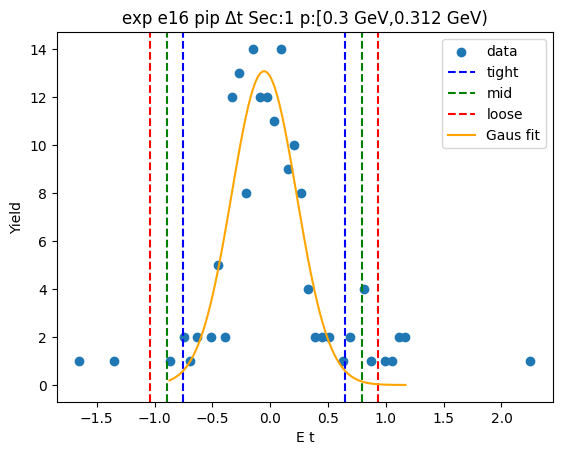

-0.8877711082086961 0.7996966446318727
-1.0565178834927529 0.9684434199159295
-1.22526465877681 1.1371901951999865
[11.29157796 -0.04403723  0.33749355]


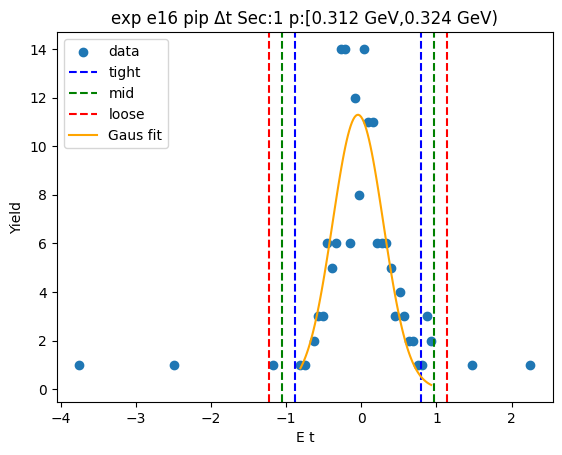

-0.6799353655208131 0.5337543105804983
-0.8013043331309442 0.6551232781906293
-0.9226733007410753 0.7764922458007605
[15.09164706 -0.07309053  0.24273794]


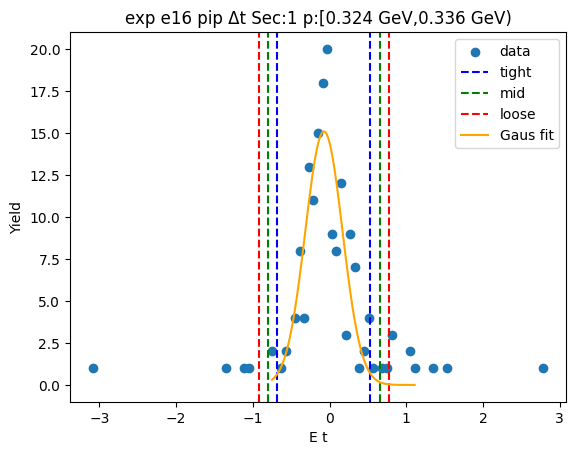

-0.8039021485344541 0.6604316697951956
-0.9503355303674191 0.8068650516281607
-1.096768912200384 0.9532984334611255
[11.60028557 -0.07173524  0.29286676]


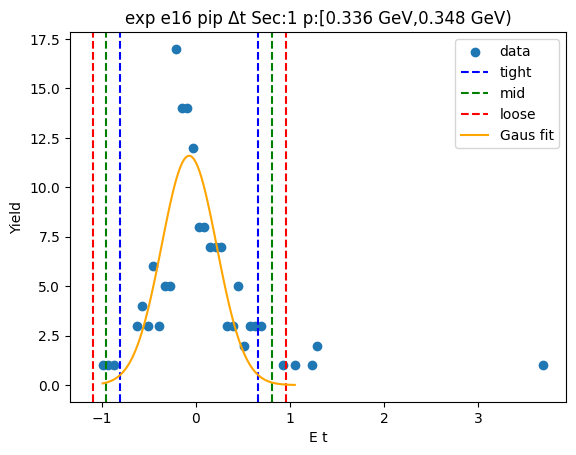

-1.161151261714792 0.9440563917302252
-1.371672027059294 1.154577157074727
-1.5821927924037955 1.3650979224192286
[ 8.18231736 -0.10854743  0.42104153]


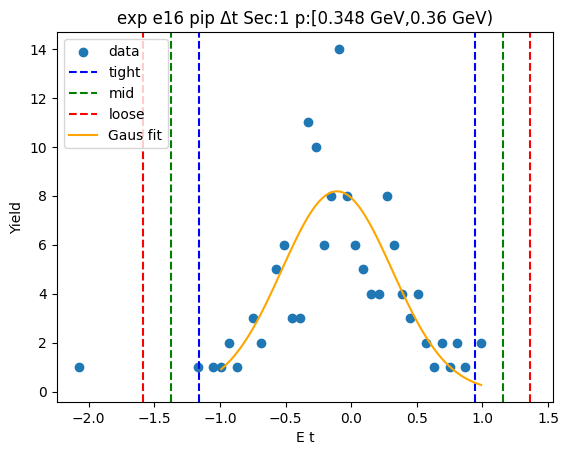

-1.0916510461457674 1.3850394250912244
-1.3393200932694664 1.6327084722149234
-1.5869891403931657 1.8803775193386227
[6.35325979 0.14669419 0.49533809]


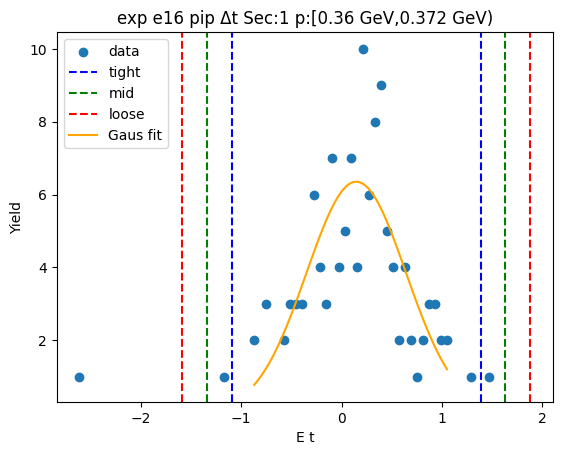

-0.914252662247358 1.301626418091741
-1.1358405702812682 1.523214326125651
-1.3574284783151782 1.744802234159561
[8.19468574 0.19368688 0.44317582]


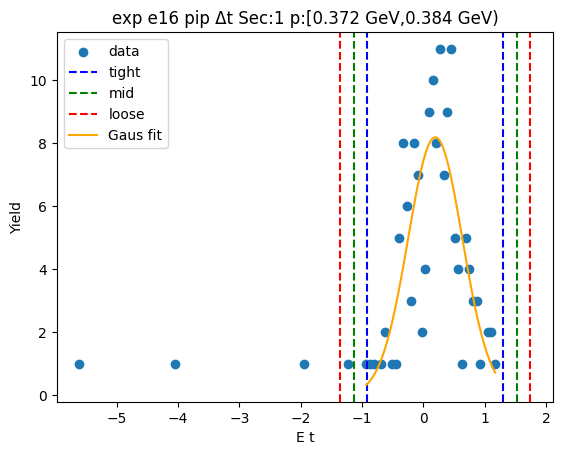

-0.817976909781211 0.9329731008784944
-0.9930719108471815 1.108068101944465
-1.168166911913152 1.2831631030104353
[8.46776248 0.0574981  0.35019   ]


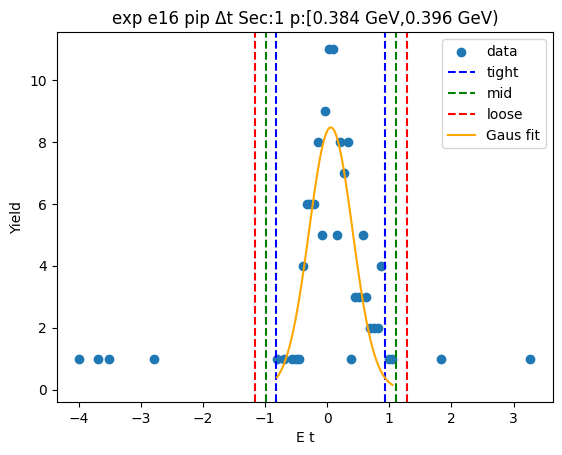

-1.1846462158619315 1.229456143680035
-1.426056451816128 1.4708663796342316
-1.6674666877703246 1.7122766155884281
[7.31480187 0.02240496 0.48282047]


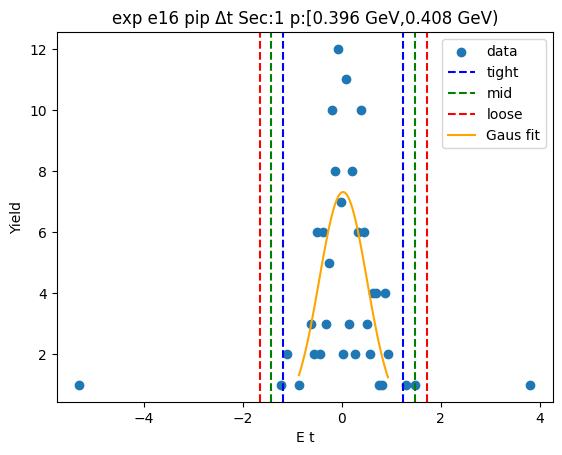

-1.3941861186474134 1.3901185684148663
-1.6726165873536412 1.668549037121094
-1.9510470560598692 1.946979505827322
[ 5.70283223e+00 -2.03377512e-03  5.56860937e-01]


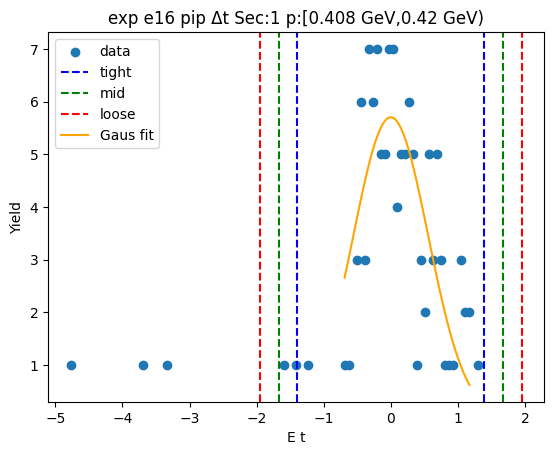

-1.146756963159681 1.1791035591125387
-1.3793430153869028 1.4116896113397606
-1.6119290676141247 1.6442756635669824
[8.12451898 0.0161733  0.4651721 ]


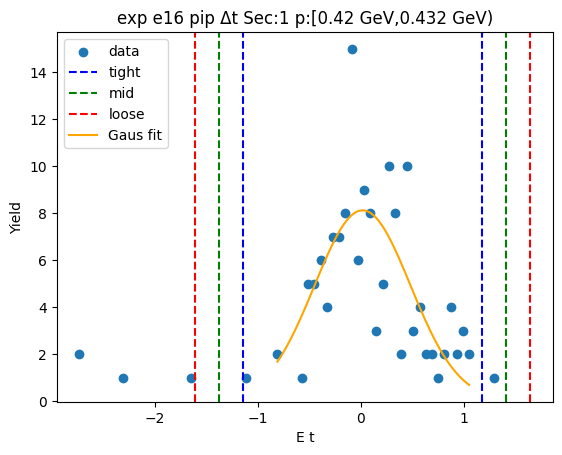

-0.8210181881846661 0.9769055264614561
-1.0008105596492782 1.1566978979260683
-1.1806029311138906 1.3364902693906806
[7.85801148 0.07794367 0.35958474]


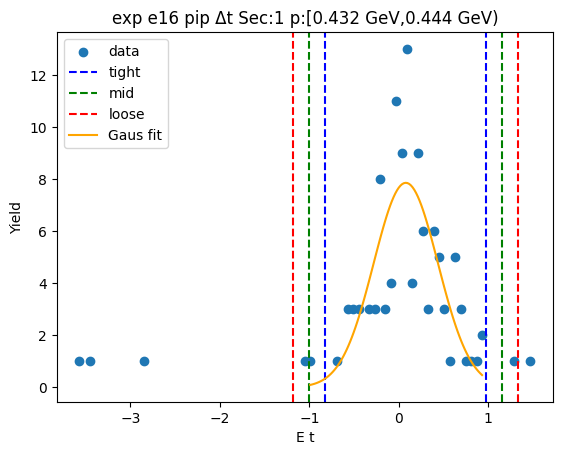

-0.7837538314615808 1.2286338449901142
-0.9849925991067503 1.4298726126352836
-1.1862313667519198 1.631111380280453
[8.10768417 0.22244001 0.40247754]


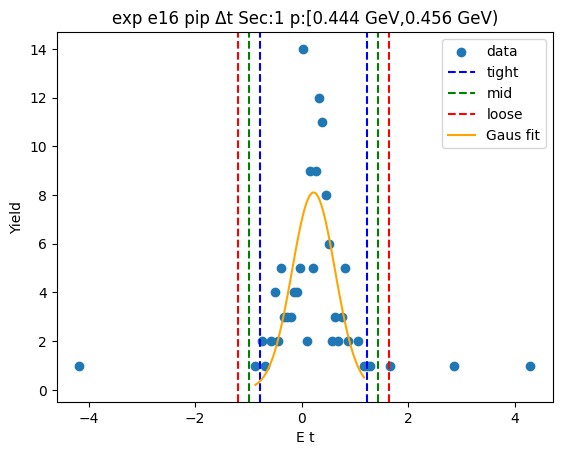

-0.5932435610122005 1.1117144281653917
-0.7637393599299598 1.282210227083151
-0.9342351588477189 1.4527060260009101
[7.89337524 0.25923543 0.3409916 ]


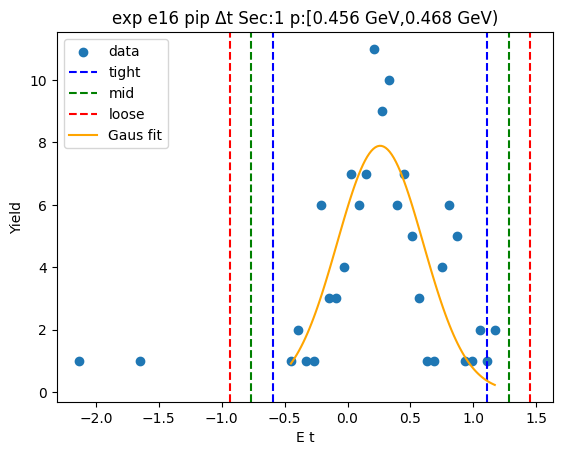

-0.9174302005473898 1.3369030283393086
-1.1428635234360598 1.5623363512279786
-1.3682968463247296 1.7877696741166484
[6.60134004 0.20973641 0.45086665]


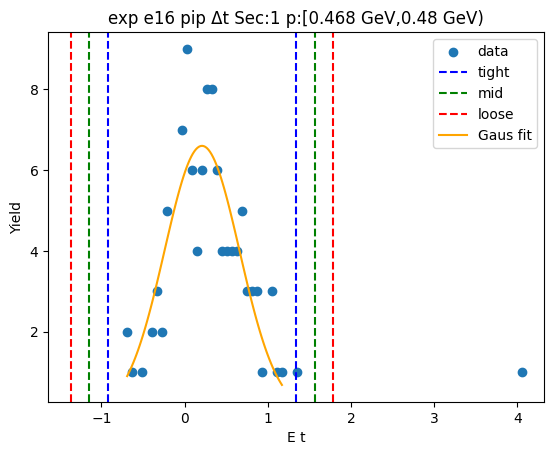

-0.5169181297227032 1.3968723093419615
-0.7082971736291699 1.5882513532484281
-0.8996762175356363 1.7796303971548946
[7.30894326 0.43997709 0.38275809]


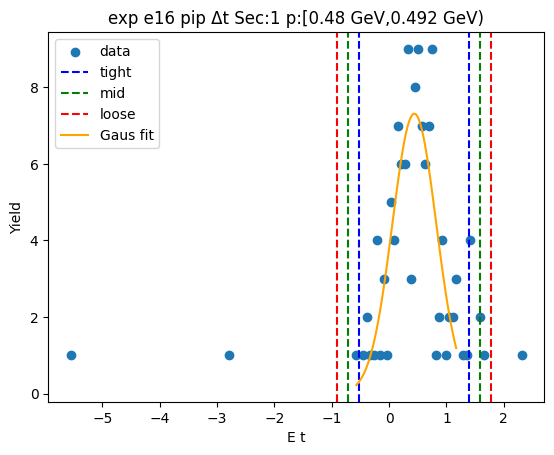

-0.5821041713420692 1.3697240326526818
-0.7772869917415441 1.564906853052157
-0.9724698121410194 1.7600896734516323
[7.58452953 0.39380993 0.39036564]


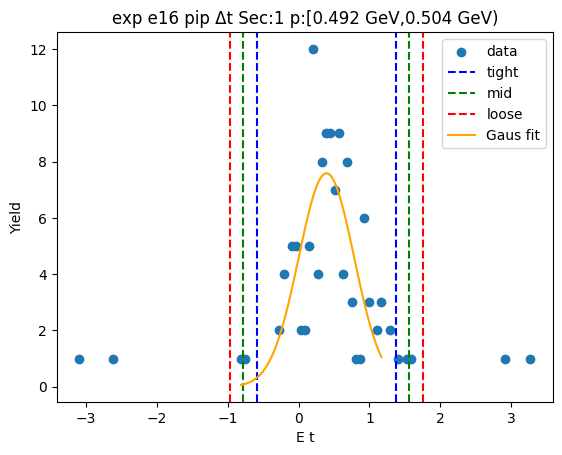

-0.4011254776287137 1.2440180807215557
-0.5656398334637407 1.4085324365565826
-0.7301541892987677 1.5730467923916096
[8.52748947 0.4214463  0.32902871]


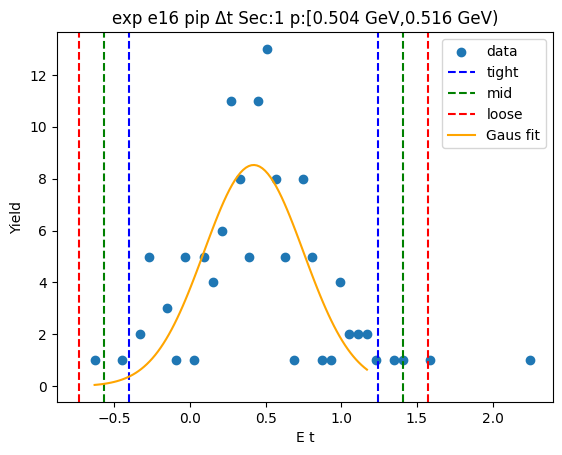

-0.5420036624312121 1.3044052942868156
-0.726644558103015 1.4890461899586185
-0.9112854537748176 1.6736870856304211
[7.03556309 0.38120082 0.36928179]


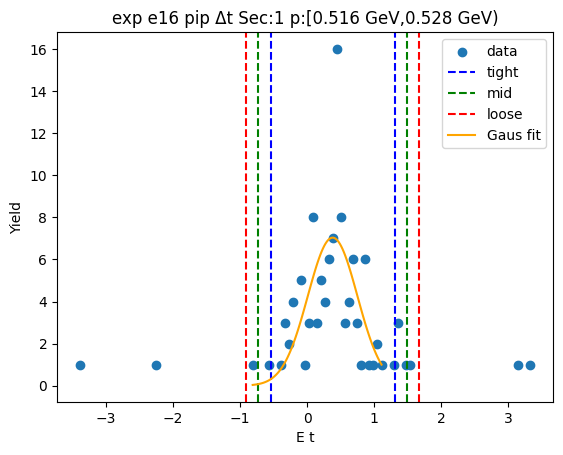

-0.35679483027648756 1.1867334034431136
-0.5111476536484478 1.3410862268150738
-0.6655004770204078 1.4954390501870338
[7.66337223 0.41496929 0.30870565]


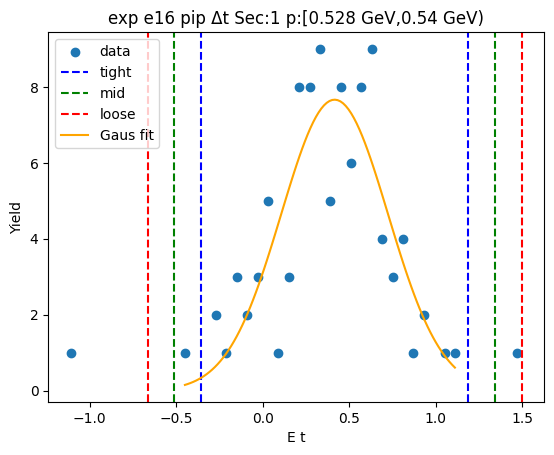

-0.46749519262693084 1.1028628763117168
-0.6245309995207956 1.2598986832055816
-0.7815668064146605 1.4169344900994463
[6.54228019 0.31768384 0.31407161]


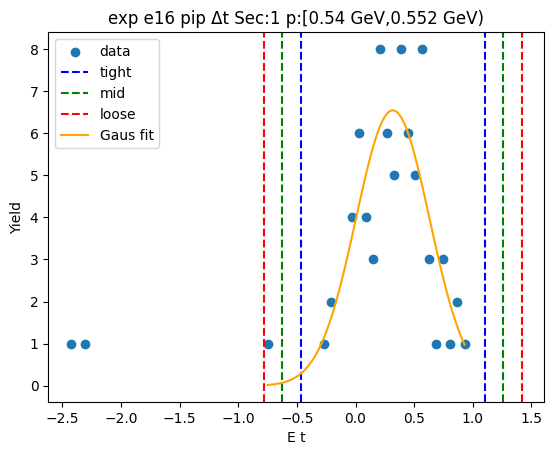

-0.2710811248465499 1.0898444690384261
-0.4071736842350474 1.2259370284269235
-0.543266243623545 1.3620295878154214
[6.98969717 0.40938167 0.27218512]


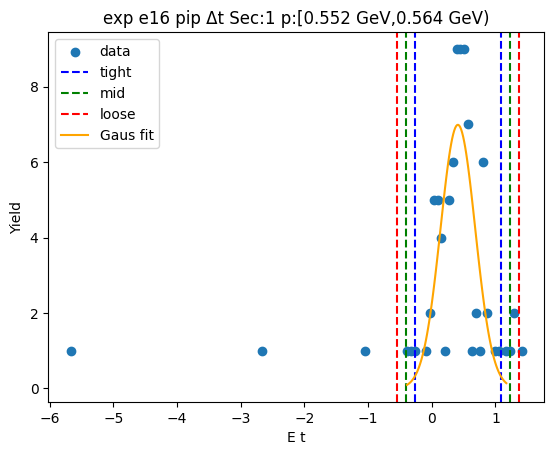

-0.5944525859834764 1.5041854916085398
-0.804316393742678 1.7140492993677414
-1.0141802015018797 1.923913107126943
[6.16233063 0.45486645 0.41972762]


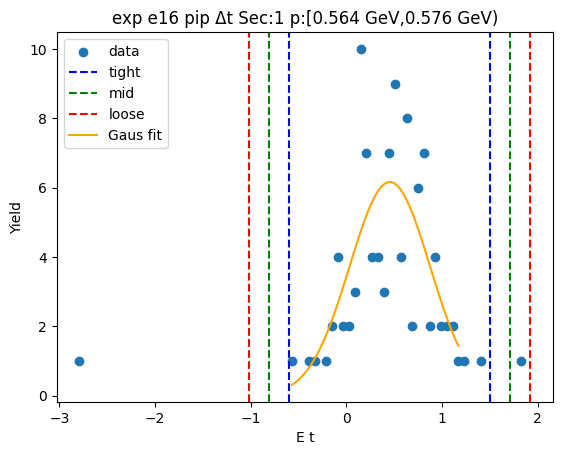

-0.19638464295904745 1.0582024047446117
-0.32184334772941336 1.1836611095149776
-0.4473020524997793 1.3091198142853435
[8.48524464 0.43090888 0.25091741]


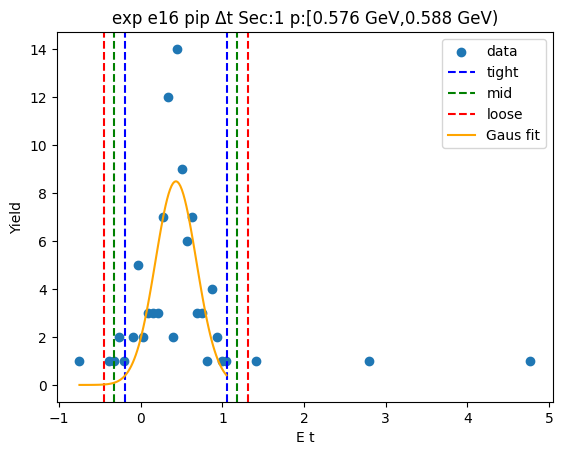

-0.6911579057465261 1.3517475319339778
-0.8954484495145764 1.5560380757020282
-1.0997389932826267 1.7603286194700787
[5.04055159 0.33029481 0.40858109]


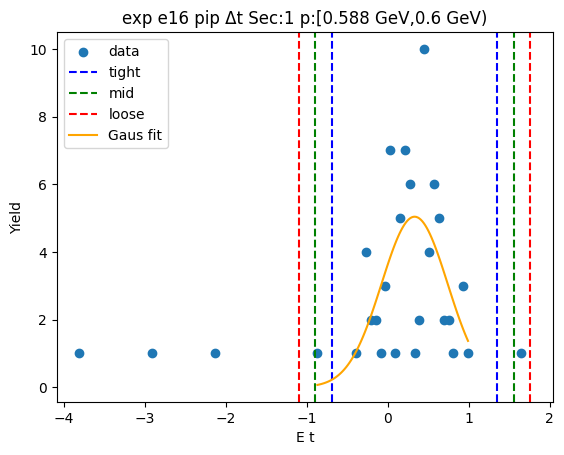

-1.1031840376462057 1.7660601377754694
-1.3901084551883733 2.052984555317637
-1.6770328727305408 2.3399089728598046
[4.06182167 0.33143805 0.57384884]


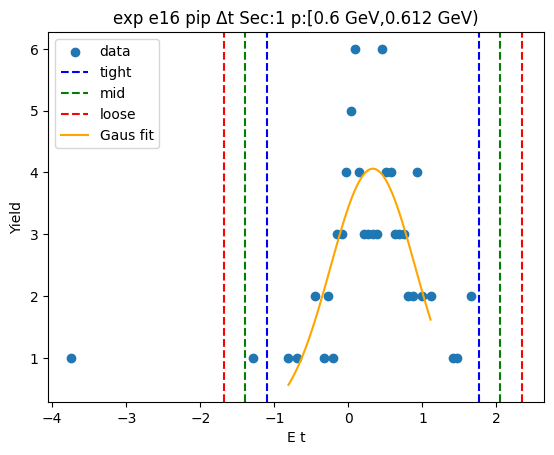

-1.306439665437913 1.4561102558370664
-1.5826946575654108 1.7323652479645644
-1.8589496496929088 2.0086202400920623
[3.93943963 0.0748353  0.55250998]


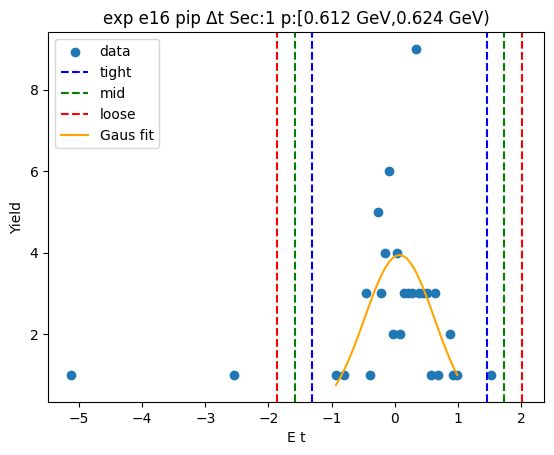

-1.2250217624830173 1.335002937134132
-1.4810242324447322 1.591005407095847
-1.7370267024064472 1.847007877057562
[4.42105485 0.05499059 0.51200494]


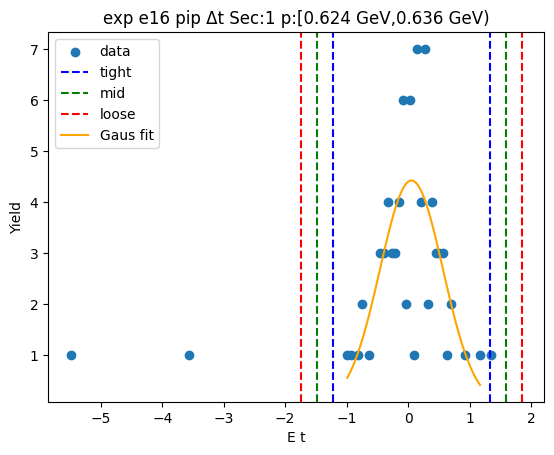

-1.0666625291672756 0.9018956274619655
-1.2635183448301999 1.0987514431248897
-1.460374160493124 1.2956072587878138
[ 4.62607295 -0.08238345  0.39371163]


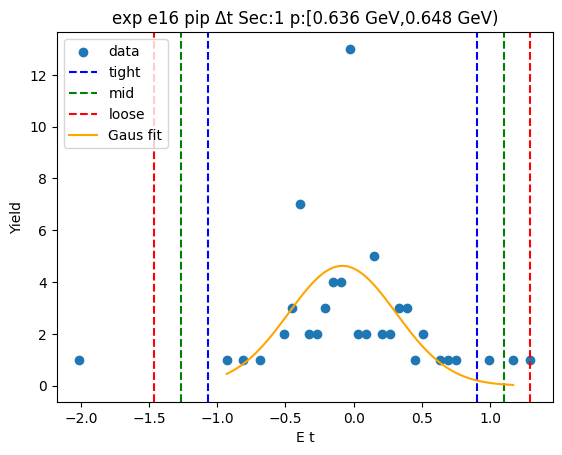

-1.232521040448453 1.0893175365473937
-1.4647048981480377 1.3215013942469784
-1.6968887558476224 1.5536852519465632
[ 3.49075619 -0.07160175  0.46436772]


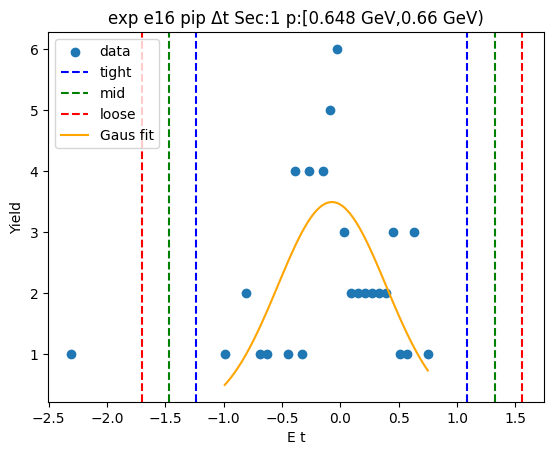

-1.3661097321375186 1.4834969334575276
-1.6510703986970234 1.7684576000170324
-1.936031065256528 2.053418266576537
[2.53055564 0.0586936  0.56992133]


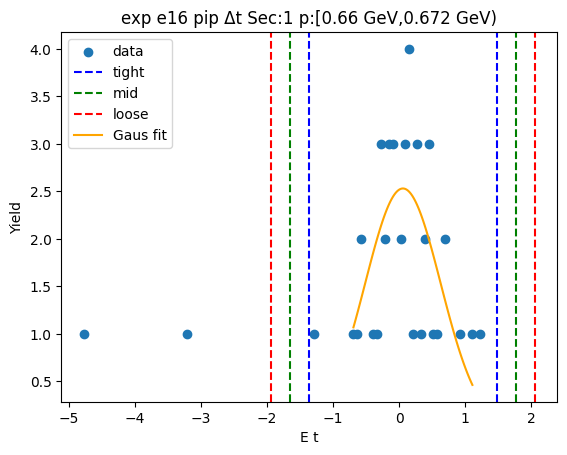

-1.0106600762980296 1.2510362652388285
-1.2368297104517154 1.4772058993925143
-1.4629993446054013 1.7033755335462002
[4.21669853 0.12018809 0.45233927]


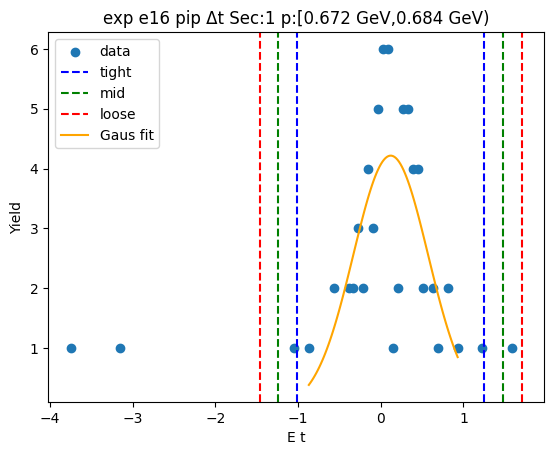

-1.114260474021995 1.3447245870950402
-1.3601589801336986 1.5906230932067438
-1.606057486245402 1.8365215993184472
[3.82422954 0.11523206 0.49179701]


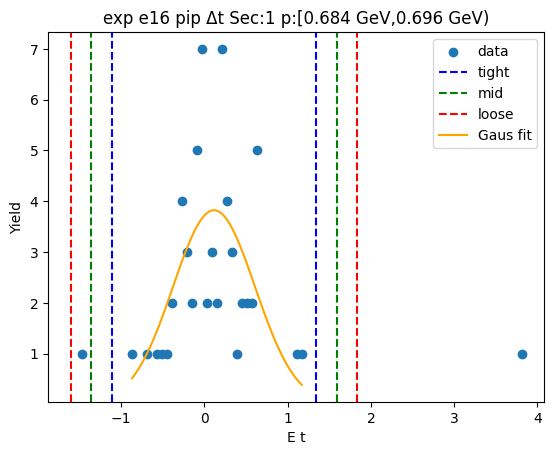

-0.6824550740806011 1.2210064718787366
-0.872801228676535 1.4113526264746703
-1.0631473832724687 1.601698781070604
[4.12284454 0.2692757  0.38069231]


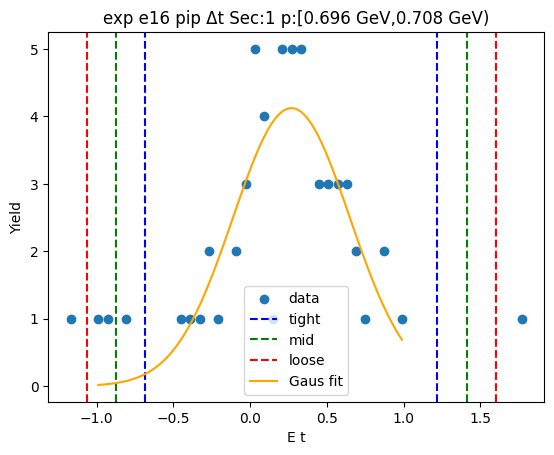

-1.1999091238997766 1.553425247132545
-1.4752425610030089 1.8287586842357773
-1.750575998106241 2.104092121339009
[3.19300913 0.17675806 0.55066687]


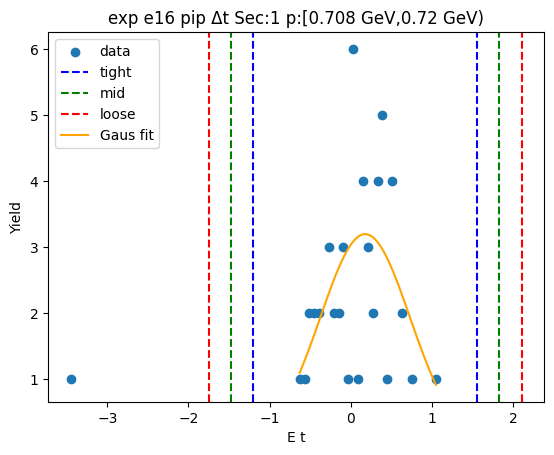

-0.8327003681988313 0.9129028467043286
-1.0072606896891474 1.0874631681946447
-1.1818210111794634 1.2620234896849607
[3.62158226 0.04010124 0.34912064]


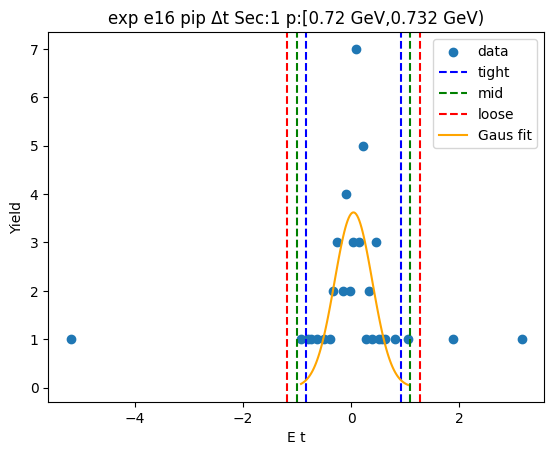

-1.0521810065370314 1.5399359962163377
-1.3113927068123683 1.7991476964916746
-1.5706044070877052 2.0583593967670115
[2.93521621 0.24387749 0.5184234 ]


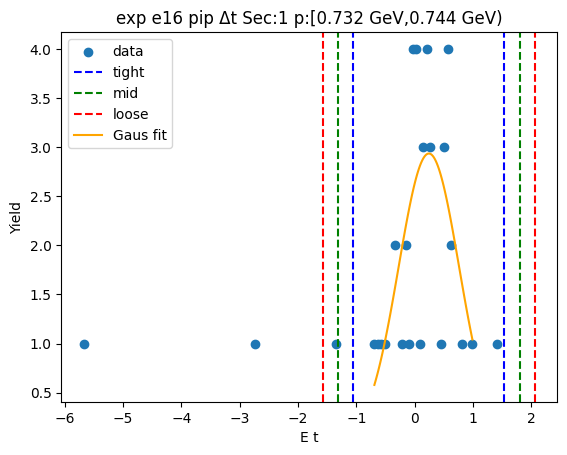

-1.2386127024759994 1.319647865061278
-1.494438759229727 1.5754739218150056
-1.7502648159834546 1.8312999785687332
[2.88827411 0.04051758 0.51165211]


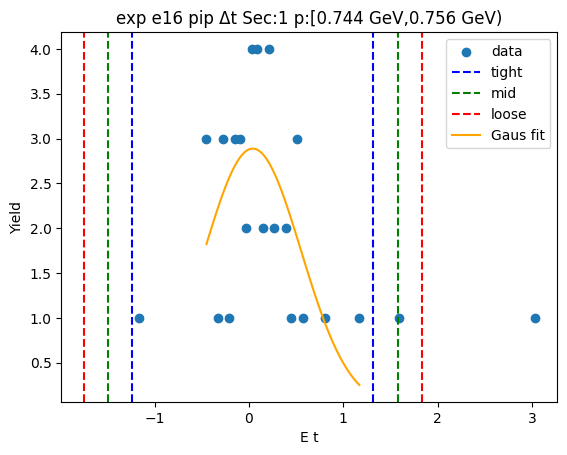

-0.9619466442223744 1.0255926520702294
-1.1607005738516347 1.2243465816994898
-1.3594545034808951 1.4231005113287503
[3.17909711 0.031823   0.39750786]


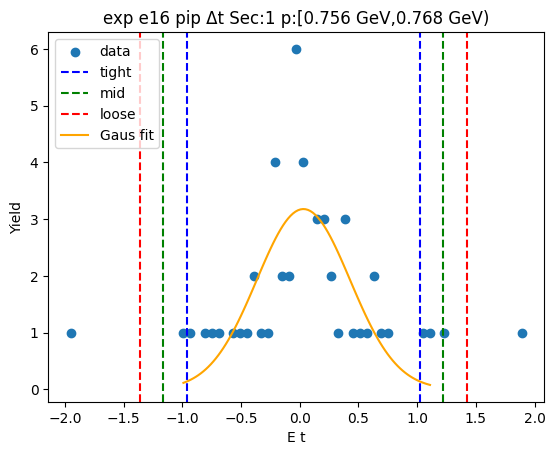

-1.4711781553927366 1.7618655284039688
-1.794482523772407 2.085169896783639
-2.1177868921520773 2.40847426516331
[2.60197773 0.14534369 0.64660874]


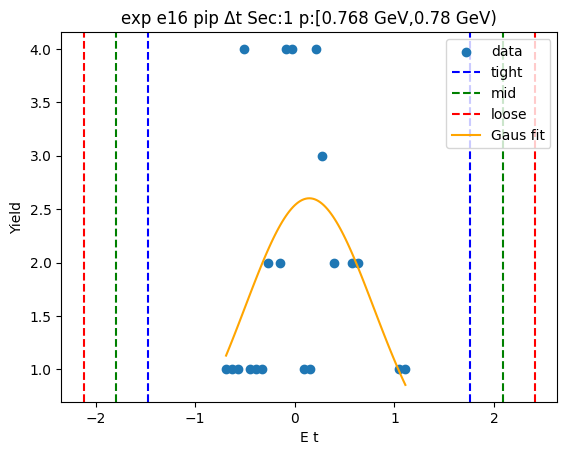

-2.008616855530796 2.6216746203280015
-2.4716460031166756 3.084703767913881
-2.9346751507025552 3.5477329154997608
[2.65977231 0.30652888 0.9260583 ]


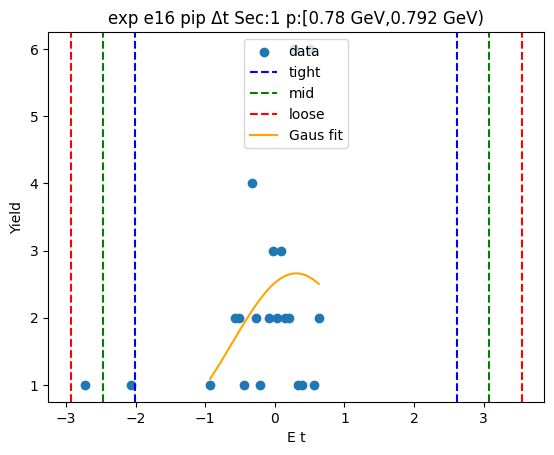

-2.001785890739113 1.8451425235118137
-2.3864787321642056 2.2298353649369065
-2.7711715735892986 2.6145282063619995
[ 1.96845701 -0.07832168  0.76938568]


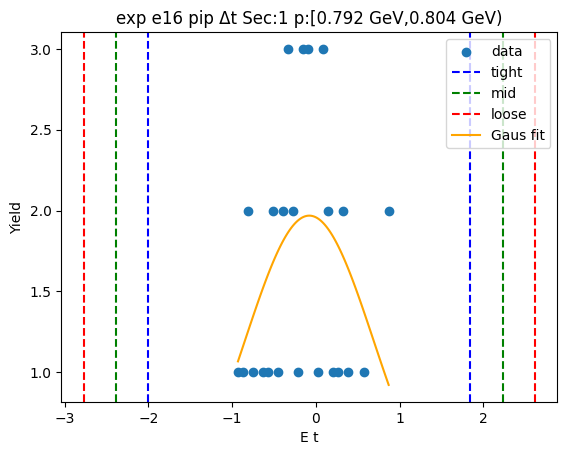

-1.2906881186715184 0.8505140157869928
-1.5048083321173698 1.0646342292328441
-1.7189285455632208 1.2787544426786952
[ 3.33702763 -0.22008705  0.42824043]


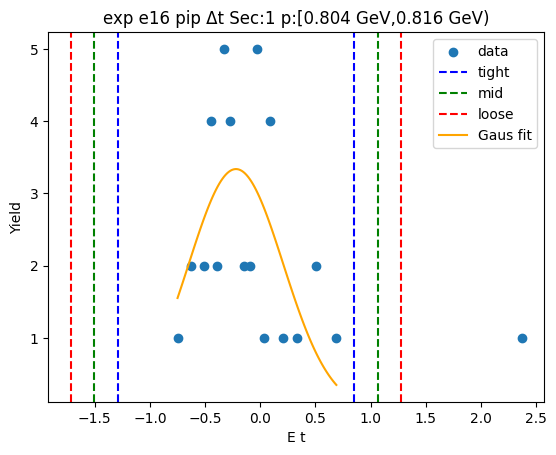

-1.4579773016010873 1.4072835378852497
-1.7445033855497212 1.6938096218338836
-2.0310294694983546 1.9803357057825173
[ 2.78660057 -0.02534688  0.57305217]


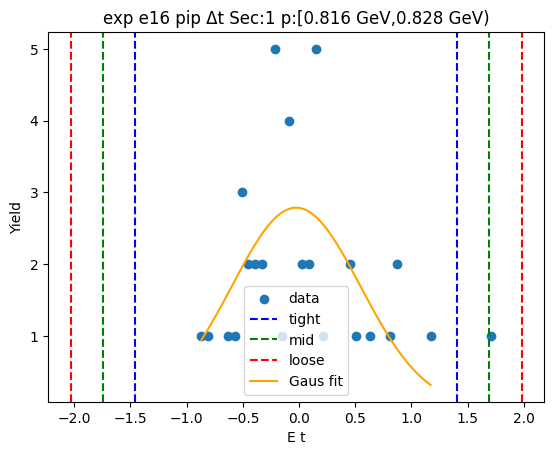

-0.7242815624483492 0.5788384042289954
-0.8545935591160837 0.7091504008967299
-0.9849055557838182 0.8394623975644644
[ 3.88080607 -0.07272158  0.26062399]


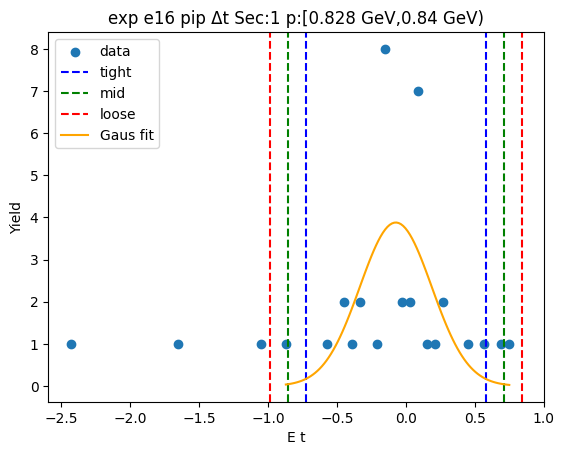

-1.1348671823836882 0.7679366677415752
-1.3251475673962145 0.9582170527541016
-1.5154279524087408 1.148497437766628
[ 2.69546016 -0.18346526  0.38056077]


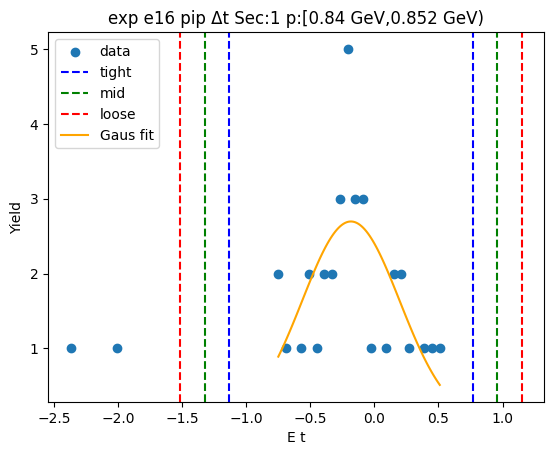

-1.2229546168128234 0.7195278876016857
-1.4172028672542742 0.9137761380431368
-1.6114511176957251 1.1080243884845877
[ 2.97841844 -0.25171336  0.3884965 ]


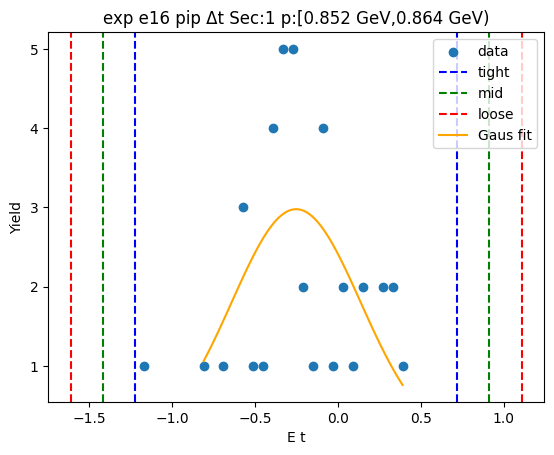

-1.1057114742199212 0.7912433148194744
-1.2954069531238608 0.980938793723414
-1.4851024320278003 1.1706342726273535
[ 3.0456557  -0.15723408  0.37939096]


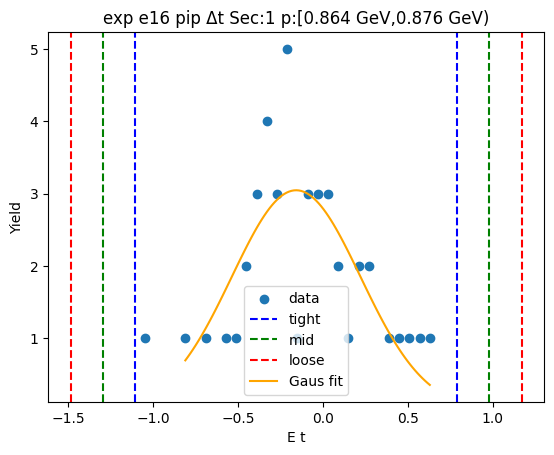

-1.3769336994176213 1.0560727590121268
-1.6202343452605963 1.2993734048551018
-1.8635349911035712 1.5426740506980767
[ 2.47387206 -0.16043047  0.48660129]


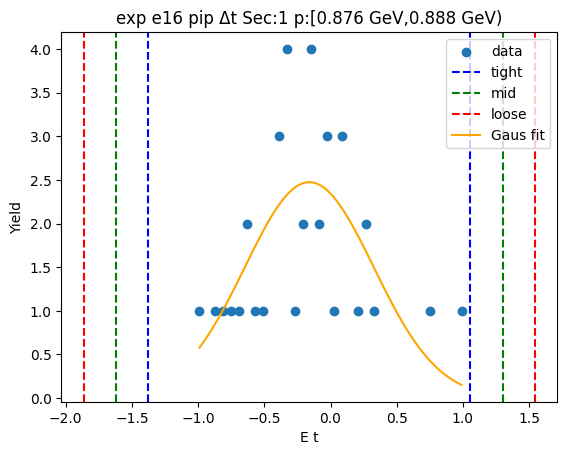

-3.4649337731593017 2.38056866667211
-4.049484017142443 2.965118910655251
-4.634034261125584 3.549669154638392
[ 1.92057856 -0.54218255  1.16910049]


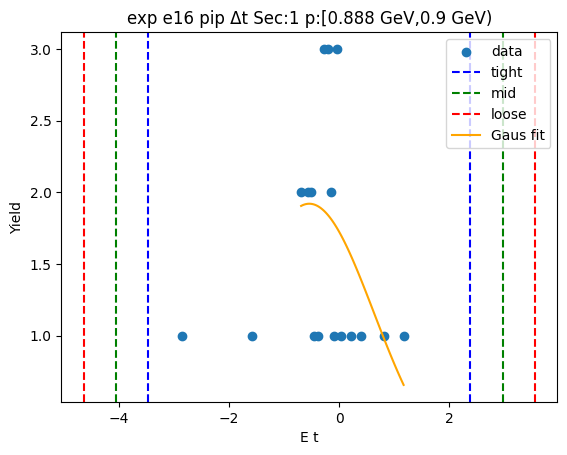

-1.7053441867131707 1.0031548809168214
-1.9761940934761697 1.2740047876798204
-2.247044000239169 1.5448546944428196
[ 2.37940491 -0.35109465  0.54169981]


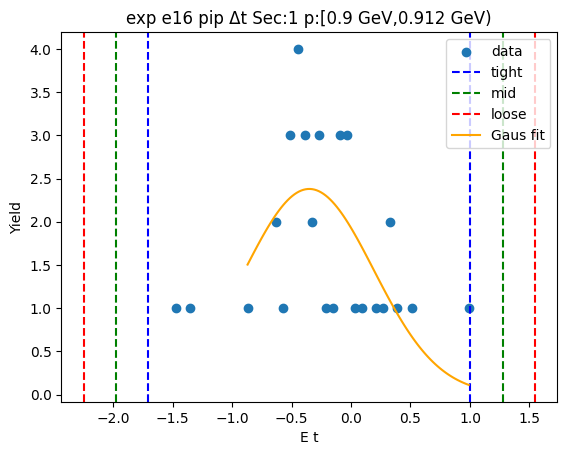

-2.6324983715508417 2.1090091468153735
-3.1066491233874634 2.5831598986519952
-3.5807998752240846 3.0573106504886165
[ 1.59050765 -0.26174461  0.9483015 ]


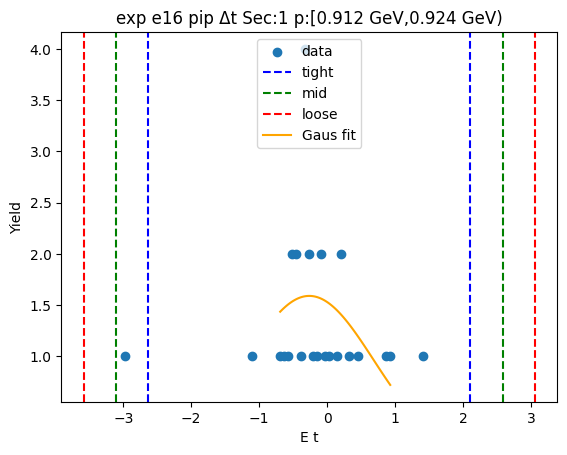

-1.3167938900129261 1.1511548574635957
-1.5635887647605784 1.397949732211248
-1.8103836395082304 1.6447446069589
[ 2.57493016 -0.08281952  0.49358975]


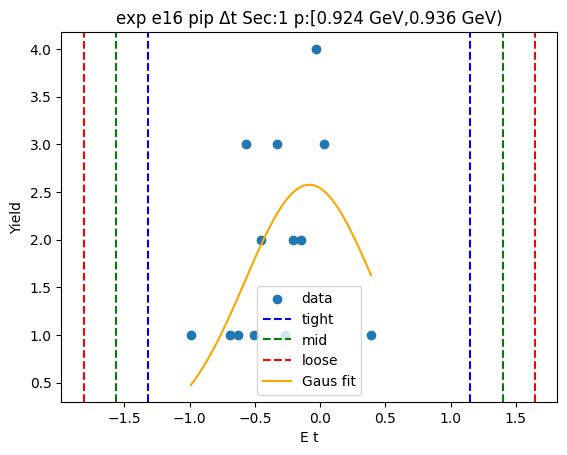

-1.4464959090420941 1.0737829528342195
-1.6985237952297256 1.325810839021851
-1.9505516814173571 1.5778387252094825
[ 2.58891636 -0.18635648  0.50405577]


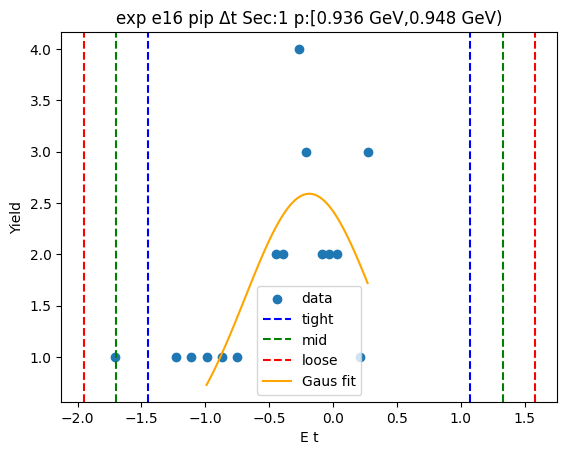

-0.776453629848602 0.020572616164554136
-0.8561562544499175 0.10027524076586974
-0.9358588790512332 0.17997786536718535
[ 4.88639276 -0.37794051  0.15940525]


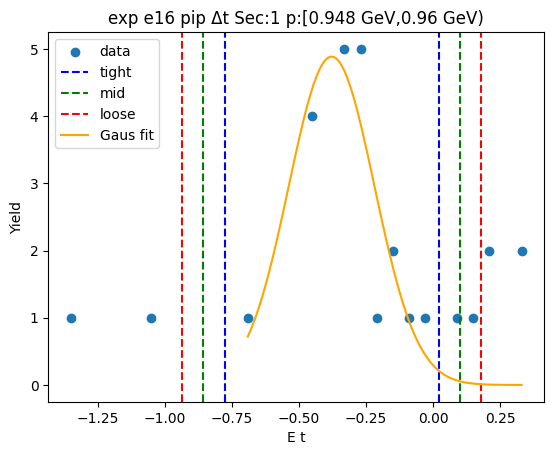

-2.454668752168369 1.8957345831415002
-2.889709085699357 2.330774916672487
-3.3247494192303435 2.765815250203474
[ 1.80728357 -0.27946708  0.87008067]


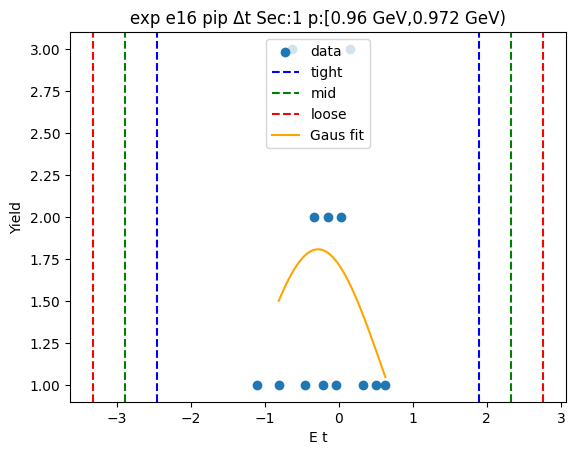

-1.0138602173223157 0.6736220196633844
-1.1826084410208857 0.8423702433619544
-1.3513566647194557 1.0111184670605244
[ 3.03877708 -0.1701191   0.33749645]


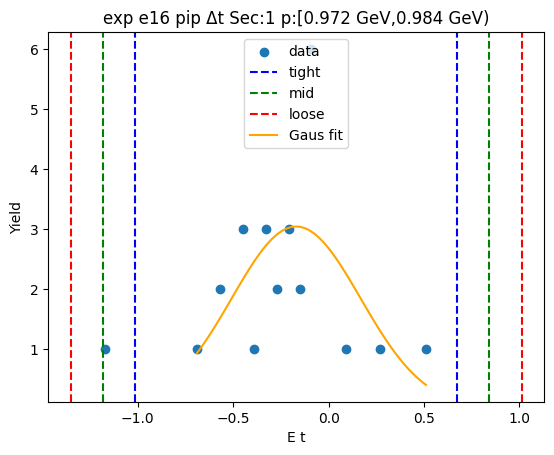

-1.2989513711934775 0.6541758703408219
-1.4942640953469073 0.8494885944942518
-1.6895768195003371 1.0448013186476817
[ 2.02043714 -0.32238775  0.39062545]


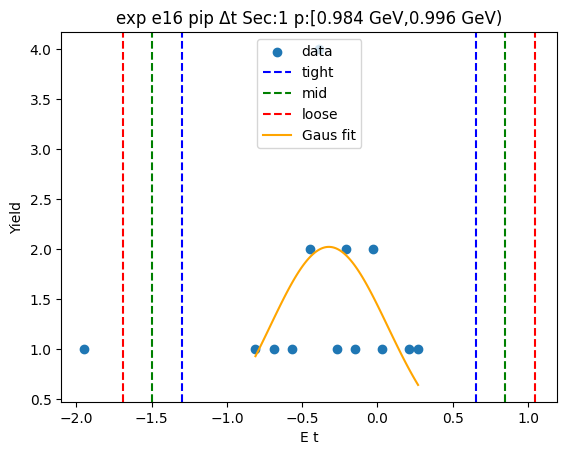

-1.3986194629093087 0.7439027554797305
-1.612871684748213 0.9581549773186345
-1.8271239065871168 1.1724071991575382
[ 2.31070883 -0.32735835  0.42850444]


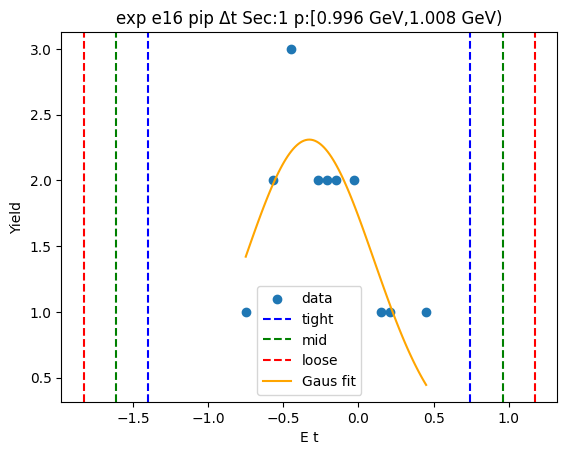

-4.0205098685432485 9.547446251233456
-5.377305480520919 10.904241863211128
-6.734101092498589 12.261037475188798
[2.51568377 2.76346819 2.71359122]


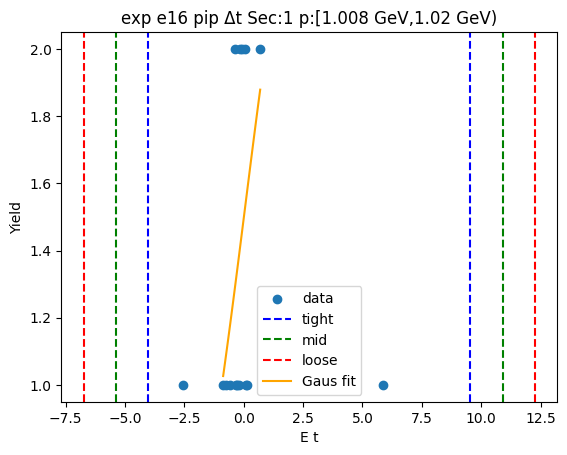

-158.84051758791202 52.07570217798478
-179.9321395645017 73.16732415457447
-201.0237615410914 94.25894613116414
[  2.69805775 -53.3824077   42.18324395]


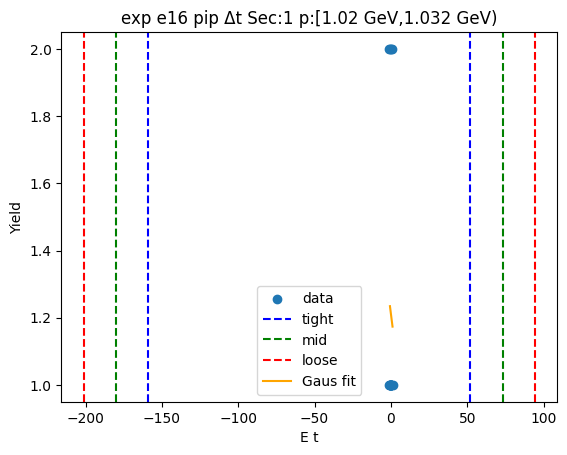

-1.186908388071506 0.9164852092159324
-1.3972477478002496 1.126824568944676
-1.6075871075289936 1.33716392867342
[ 2.06132826 -0.13521159  0.42067872]


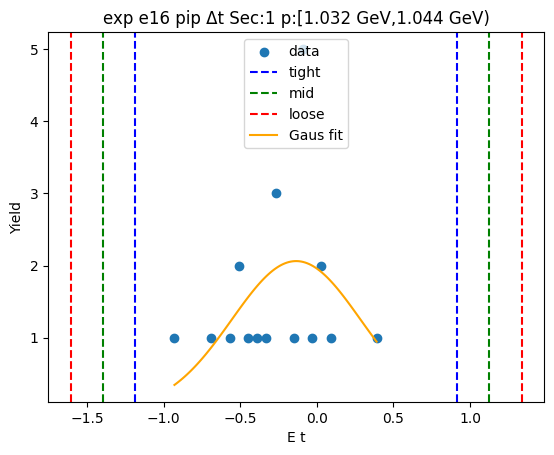

Runtime Error
[ 2.06132826 -0.13521159  0.42067872]


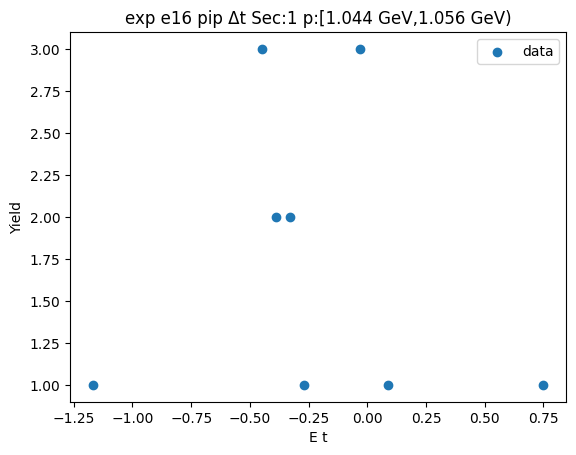

-3.996888641055948 13.556969568049537
-5.752274461966495 15.312355388960084
-7.507660282877044 17.067741209870633
[3.97562814 4.78004046 3.51077164]


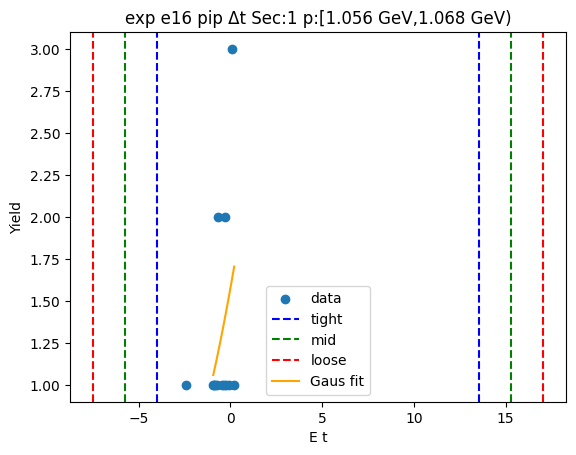

-1.06083693414324 0.9084296781113677
-1.2577635953687007 1.1053563393368284
-1.4546902565941615 1.3022830005622892
[ 1.74286873 -0.07620363  0.39385332]


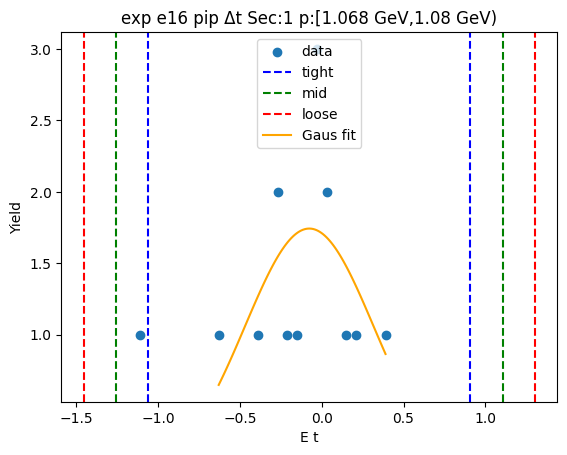

-1.4457364148929392 0.9821718695285143
-1.6885272433350842 1.2249626979706596
-1.9313180717772296 1.467753526412805
[ 2.30702166 -0.23178227  0.48558166]


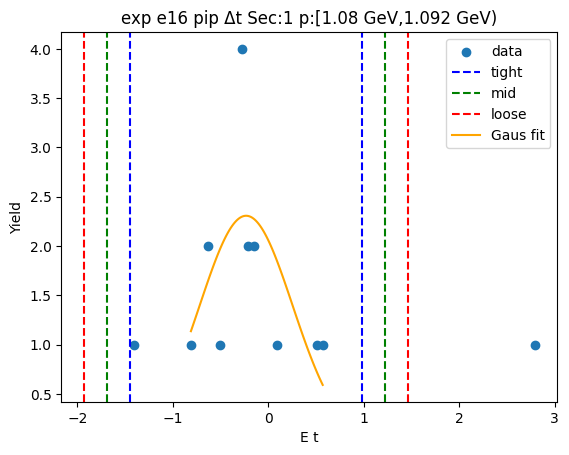

-4.441928690708167 3.4498735684886093
-5.231108916627845 4.239053794408287
-6.020289142547522 5.0282340203279645
[ 1.23475854 -0.49602756  1.57836045]


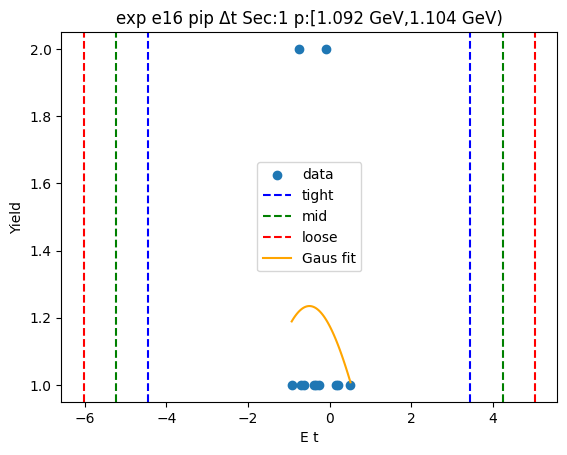

-4.2001828626740645 3.694883618268045
-4.989689510768275 4.484390266362255
-5.7791961588624865 5.273896914456467
[ 1.3142871  -0.25264962  1.5790133 ]


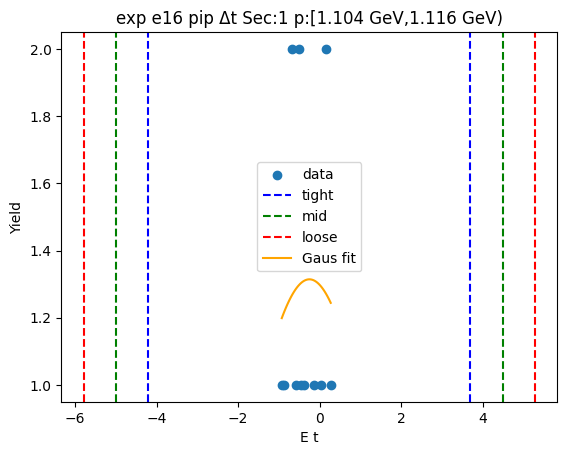

-1.9056072392183137 1.762724091432198
-2.2724403722833646 2.1295572244972494
-2.6392735053484158 2.4963903575623005
[ 1.52526558 -0.07144157  0.73366627]


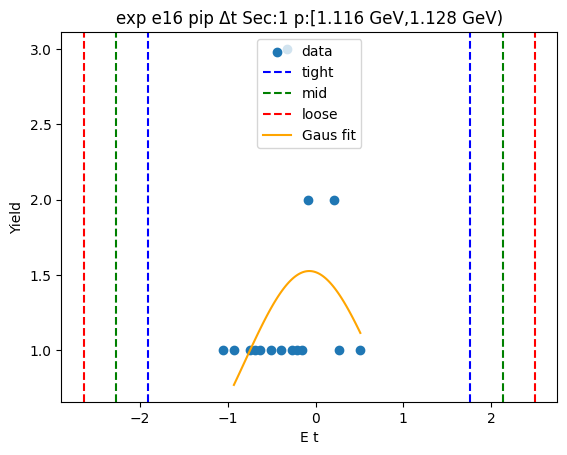

-2.629390473315116 1.5150394996688785
-3.043833470613515 1.9294824969672777
-3.4582764679119142 2.343925494265677
[ 1.61735234 -0.55717549  0.82888599]


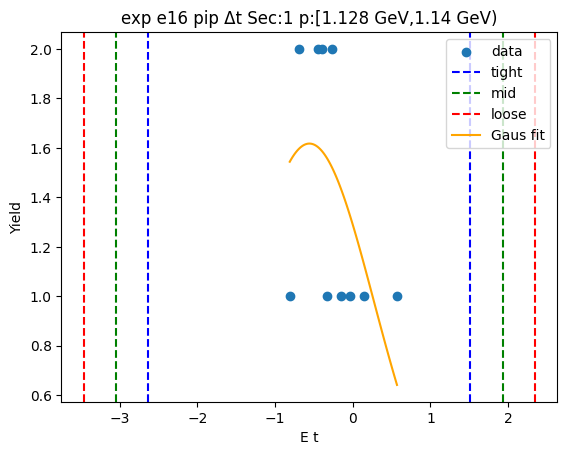

-1.3492072368361023 0.6617964885934711
-1.5503076093790598 0.8628968611364285
-1.751407981922017 1.0639972336793857
[ 1.61290415 -0.34370537  0.40220075]


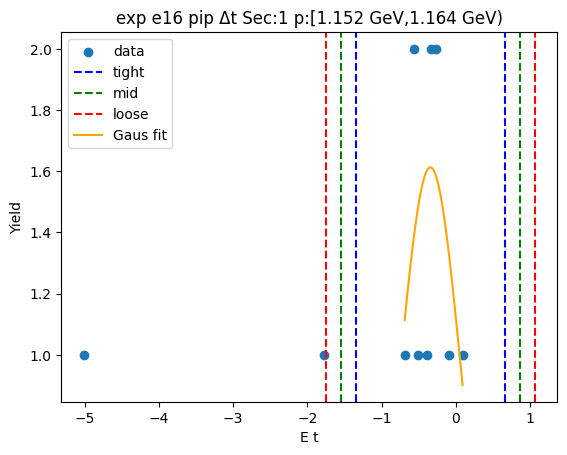

-3.169369570240286 2.5307960669007463
-3.7393861339543895 3.1008126306148496
-4.309402697668492 3.670829194328953
[ 1.65910214 -0.31928675  1.14003313]


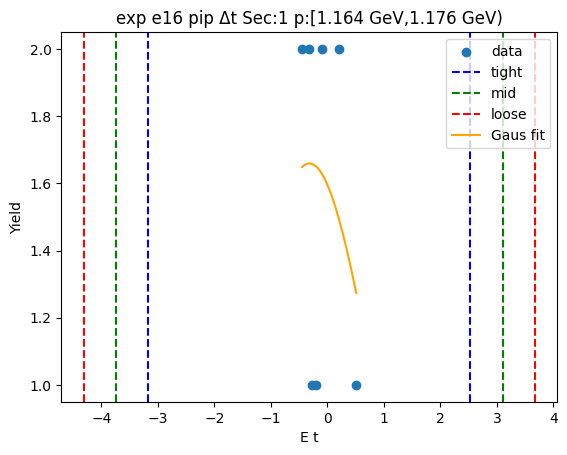

0.7299792722449158 -0.8661324261188196
0.8895904420812892 -1.025743595955193
1.0492016119176628 -1.1853547657915664
[ 2.88913034 -0.06807658 -0.31922234]


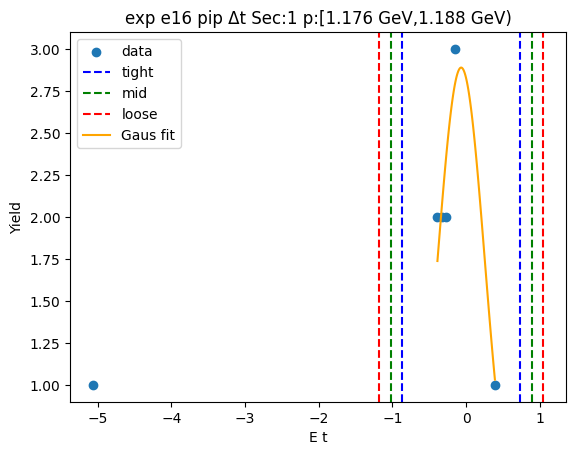

1.151359281666057 -1.3745752751430986
1.4039527373469727 -1.6271687308240144
1.6565461930278882 -1.8797621865049299
[ 1.64647785 -0.111608   -0.50518691]


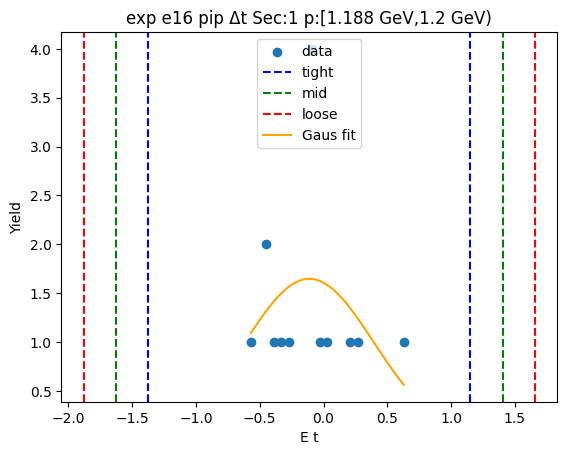

-0.9786372339321421 0.8313946955925413
-1.1596404268846103 1.0123978885450096
-1.3406436198370788 1.193401081497478
[10.28726847 -0.07362127  0.36200639]


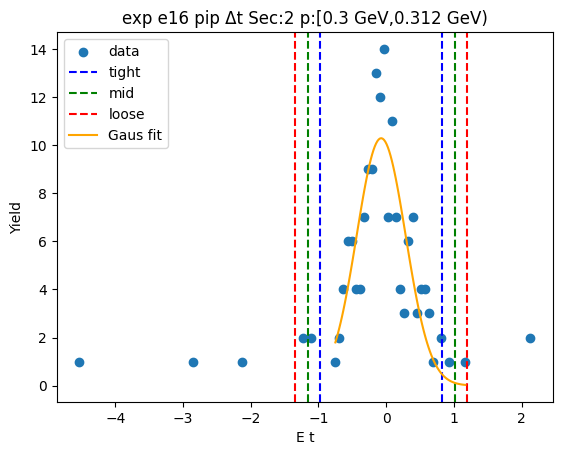

-0.8914457901359227 0.8178044484061193
-1.0623708139901271 0.9887294722603237
-1.2332958378443313 1.1596544961145279
[11.70132815 -0.03682067  0.34185005]


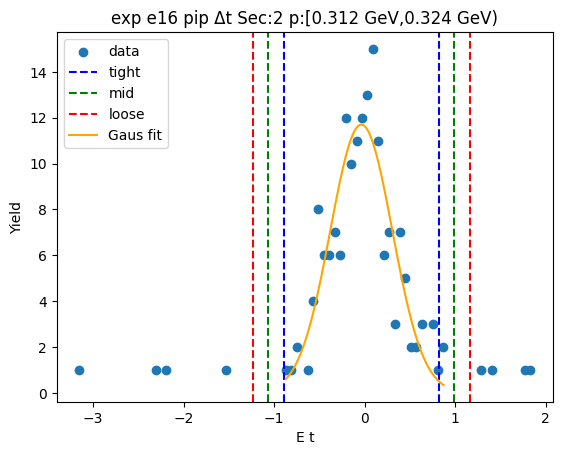

-1.0265810909225512 0.8148520235523458
-1.2107244023700408 0.9989953349998353
-1.3948677138175305 1.183138646447325
[11.48396438 -0.10586453  0.36828662]


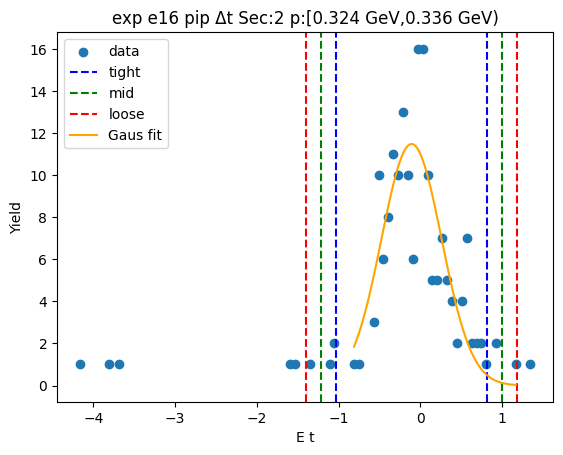

-0.9524396339268352 0.876446722618169
-1.1353282695813356 1.0593353582726694
-1.3182169052358361 1.24222399392717
[11.56977794 -0.03799646  0.36577727]


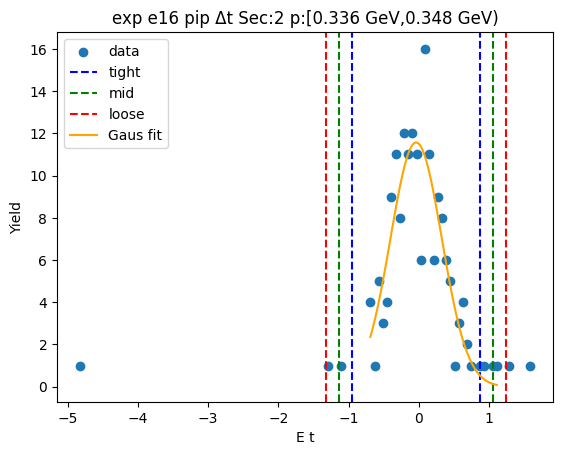

-0.805882793650743 0.7348978165957233
-0.9599608546753897 0.88897587762037
-1.1140389157000363 1.0430539386450166
[13.41405305 -0.03549249  0.30815612]


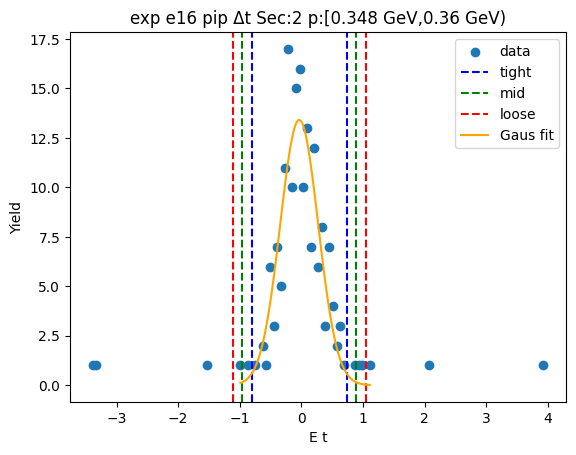

-0.9193466891084061 0.8910164596436394
-1.1003830039836107 1.072052774518844
-1.2814193188588152 1.2530890893940485
[ 9.41352699 -0.01416511  0.36207263]


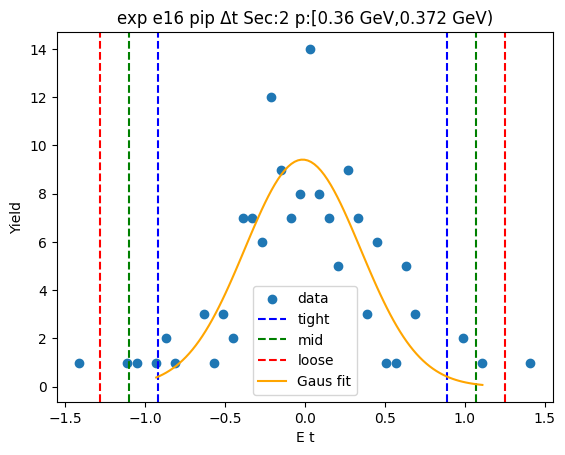

-0.5750501734642205 0.5933796564872095
-0.6918931564593634 0.7102226394823524
-0.8087361394545065 0.8270656224774955
[1.68467116e+01 9.16474151e-03 2.33685966e-01]


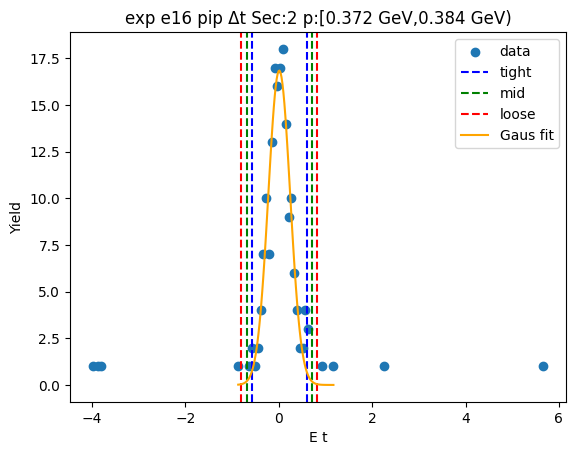

-0.5356532816329002 0.4991989460638705
-0.6391385044025771 0.6026841688335475
-0.7426237271722542 0.7061693916032246
[15.67944881 -0.01822717  0.20697045]


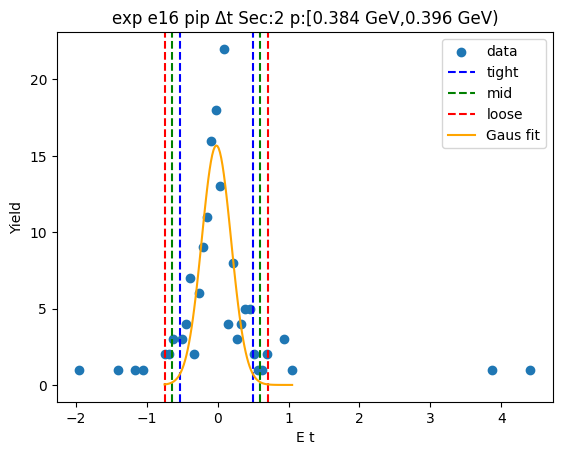

-0.7025023827643258 0.6386284172840855
-0.8366154627691669 0.7727414972889266
-0.970728542774008 0.9068545772937677
[14.02408691 -0.03193698  0.26822616]


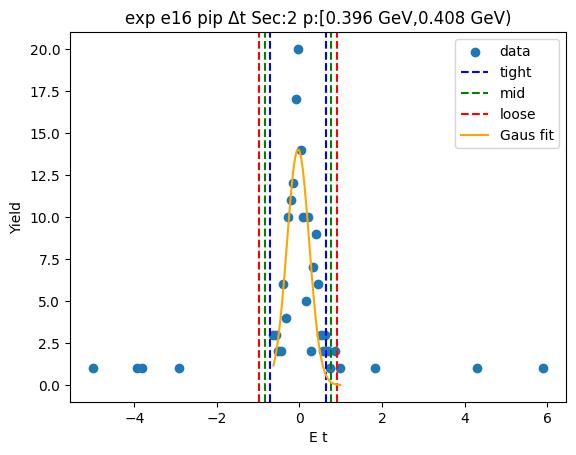

-0.8785004316019646 0.6857255104313226
-1.0349230258052933 0.8421481046346513
-1.1913456200086219 0.9985706988379799
[11.99095277 -0.09638746  0.31284519]


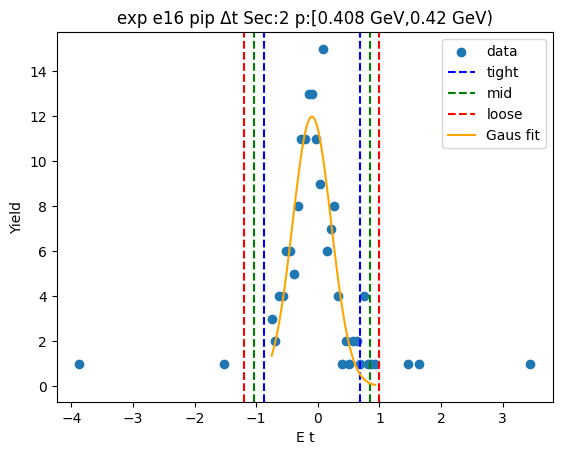

-1.068708330367744 0.6601328736548726
-1.2415924507700058 0.8330169940571344
-1.4144765711722673 1.005901114459396
[ 9.51354393 -0.20428773  0.34576824]


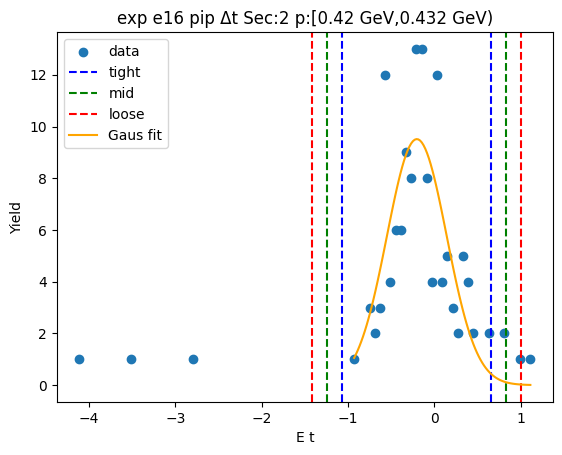

-0.8218619742010217 0.4825132464170031
-0.9522994962628242 0.6129507684788056
-1.0827370183246265 0.7433882905406081
[13.29246644 -0.16967436  0.26087504]


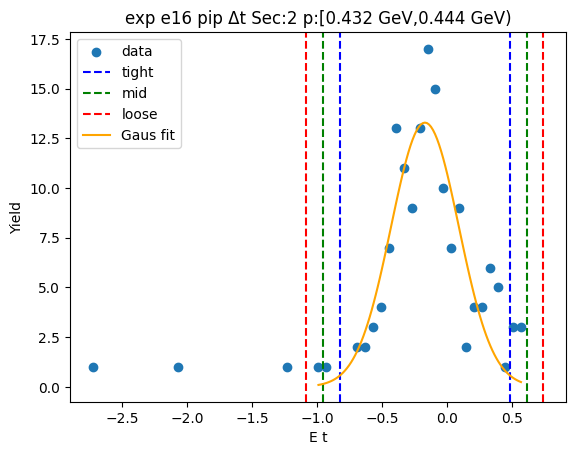

-0.969579062252077 0.5654461675631326
-1.1230815852335978 0.7189486905446535
-1.2765841082151188 0.8724512135261744
[ 9.75958182 -0.20206645  0.30700505]


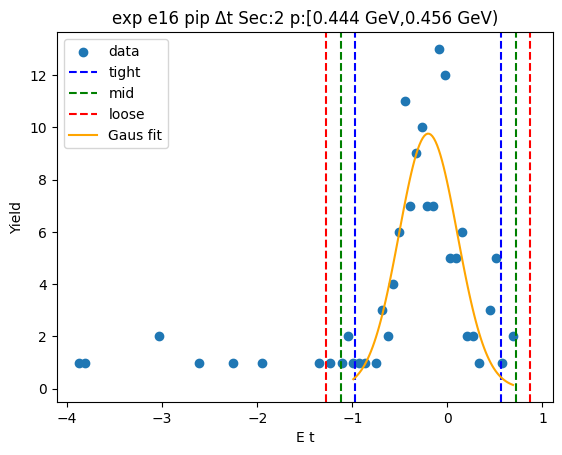

-0.9945937127524223 0.6878606368685207
-1.1628391477145166 0.8561060718306149
-1.3310845826766107 1.0243515067927094
[10.50125577 -0.15336654  0.33649087]


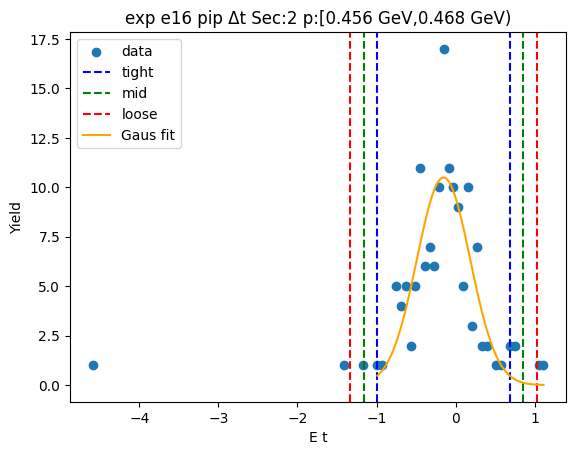

-0.9253344765774332 0.5368741820560354
-1.0715553424407802 0.6830950479193824
-1.217776208304127 0.8293159137827293
[11.90627873 -0.19423015  0.29244173]


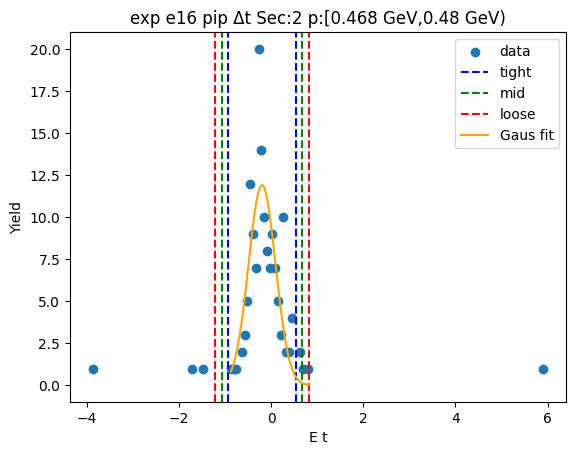

-0.8052519669889608 0.3899179972469385
-0.9247689634125507 0.5094349936705285
-1.0442859598361407 0.6289519900941183
[12.65714052 -0.20766698  0.23903399]


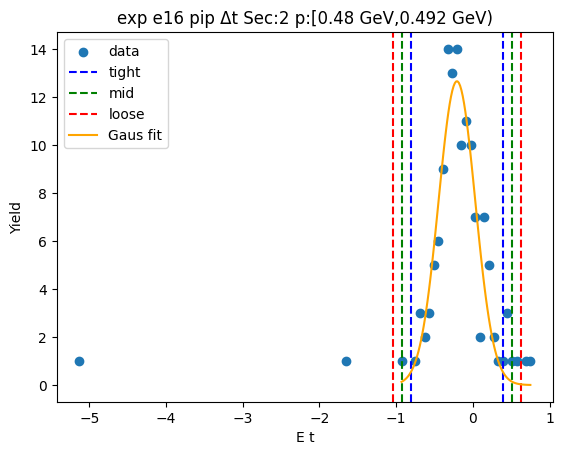

-0.9810249602849552 0.4048057684995119
-1.1196080331634017 0.5433888413779585
-1.2581911060418487 0.6819719142564052
[11.66357136 -0.2881096   0.27716615]


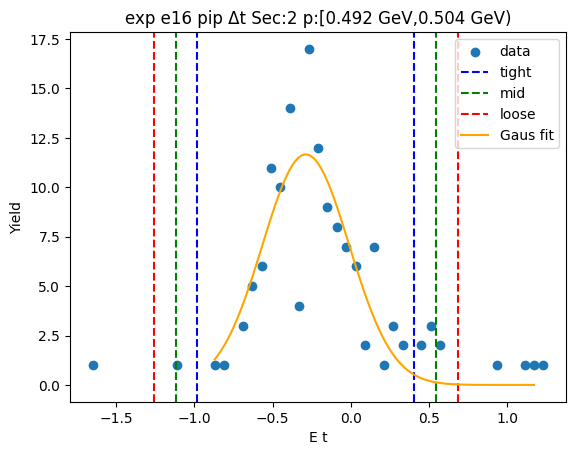

-0.8275427721770361 0.45804016957334115
-0.9561010663520738 0.5865984637483789
-1.0846593605271115 0.7151567579234166
[ 9.34885034 -0.1847513   0.25711659]


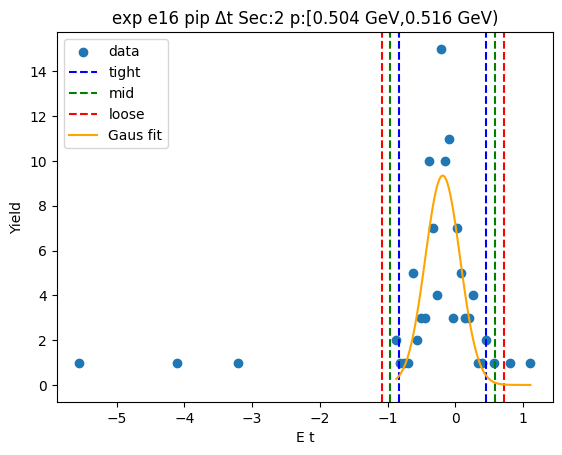

-1.044241800118885 0.5498827544066652
-1.2036542555714402 0.7092952098592203
-1.3630667110239951 0.8687076653117752
[11.05204046 -0.24717952  0.31882491]


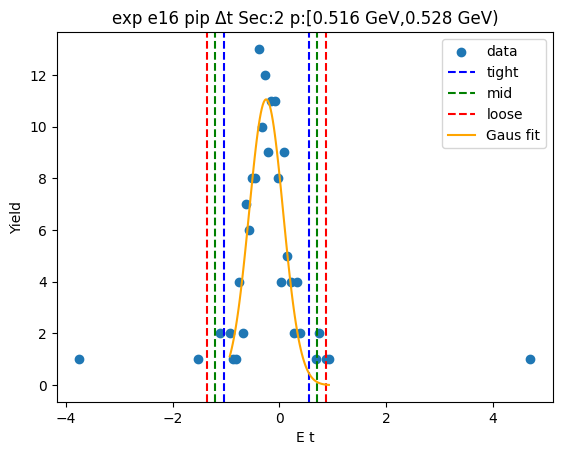

-0.9776197359768861 0.3738881759619299
-1.1127705271707677 0.5090389671558114
-1.2479213183646491 0.644189758349693
[ 8.96539528 -0.30186578  0.27030158]


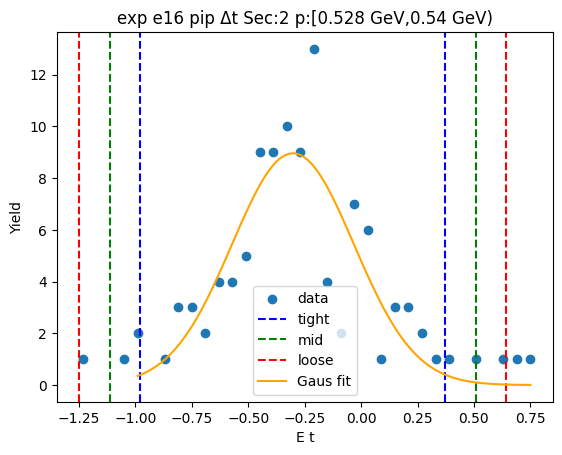

-0.9988207367869584 0.5616585930928106
-1.1548686697749353 0.7177065260807873
-1.3109166027629122 0.8737544590687643
[ 8.51930298 -0.21858107  0.31209587]


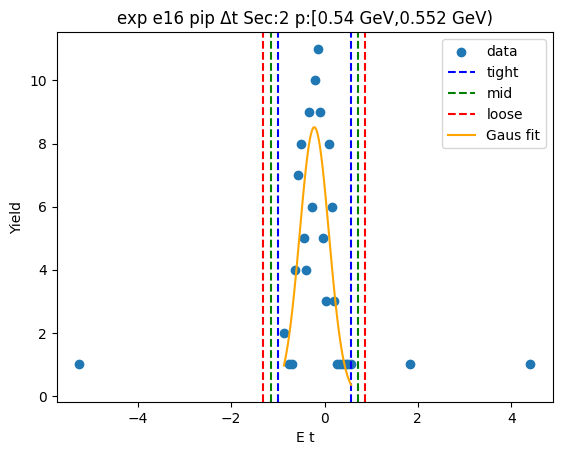

-1.3094584513012255 0.7136717948882748
-1.5117714759201757 0.9159848195072248
-1.7140845005391259 1.1182978441261748
[ 6.40128799 -0.29789333  0.40462605]


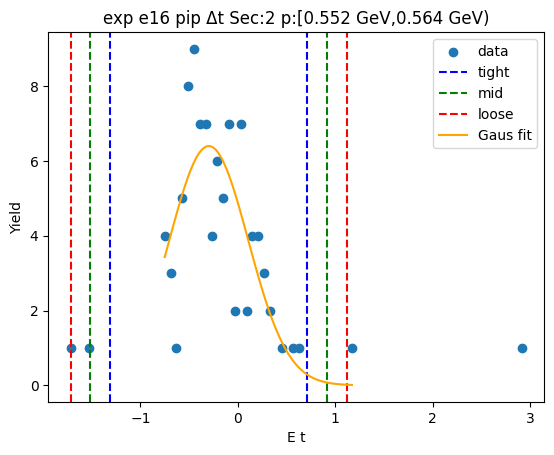

-1.0321137733308912 0.5622630353837107
-1.1915514542023513 0.721700716255171
-1.3509891350738115 0.8811383971266311
[ 6.92943423 -0.23492537  0.31887536]


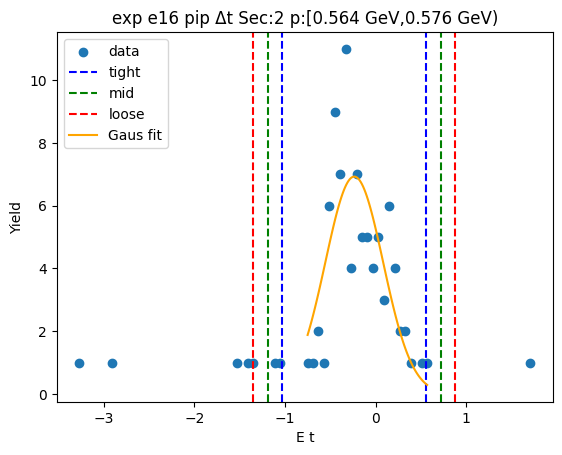

-0.9471152737262489 0.6369796369825167
-1.1055247647971256 0.7953891280533933
-1.263934255868002 0.9537986191242698
[ 8.41276963 -0.15506782  0.31681898]


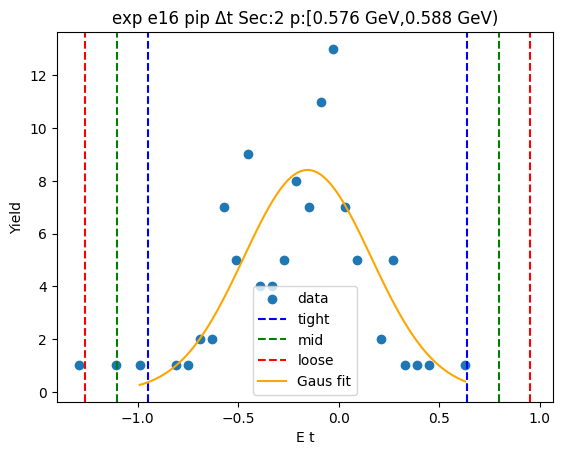

-1.2412132673820695 0.745953930222476
-1.439929987142524 0.9446706499829305
-1.6386467069029786 1.1433873697433852
[ 5.74465314 -0.24762967  0.39743344]


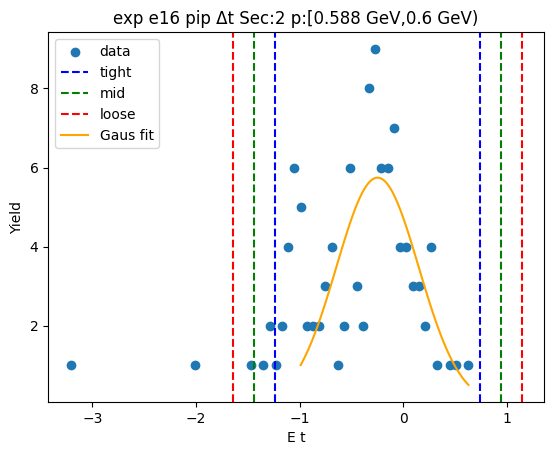

-2.487463725164581 1.3270654329727671
-2.868916640978316 1.708518348786502
-3.2503695567920503 2.0899712646002366
[ 3.58755202 -0.58019915  0.76290583]


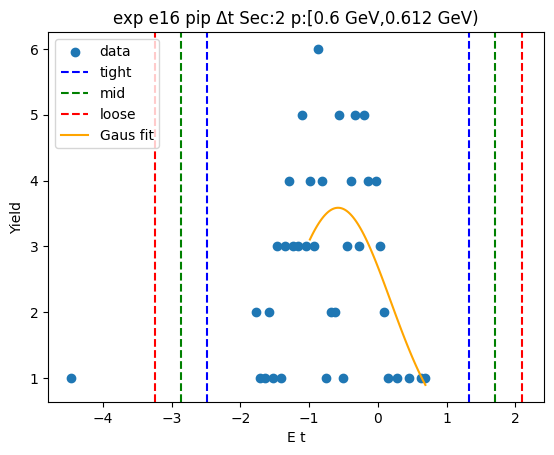

-6.074941637943778 2.3175775360213384
-6.914193555340289 3.15682945341785
-7.753445472736801 3.9960813708143617
[ 3.47796584 -1.87868205  1.67850383]


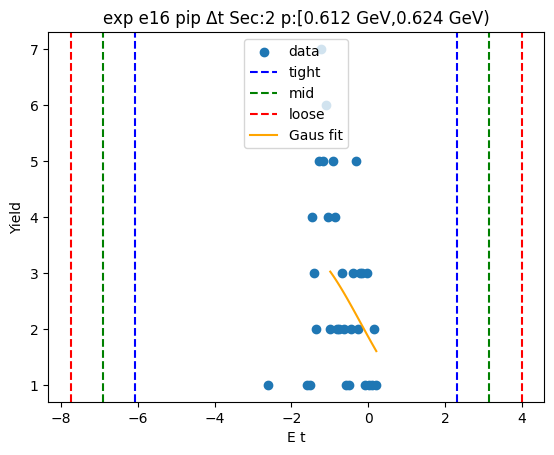

Runtime Error
[ 3.47796584 -1.87868205  1.67850383]


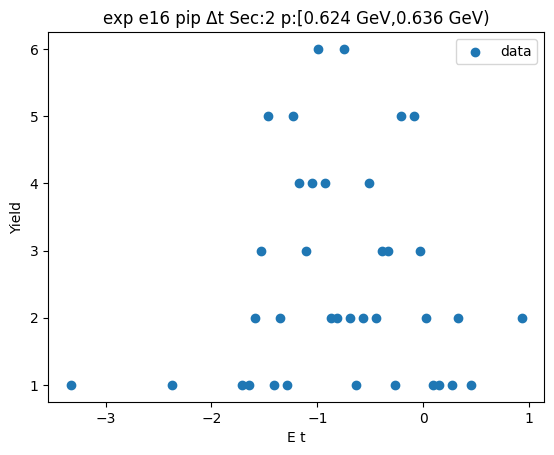

Runtime Error
[ 3.47796584 -1.87868205  1.67850383]


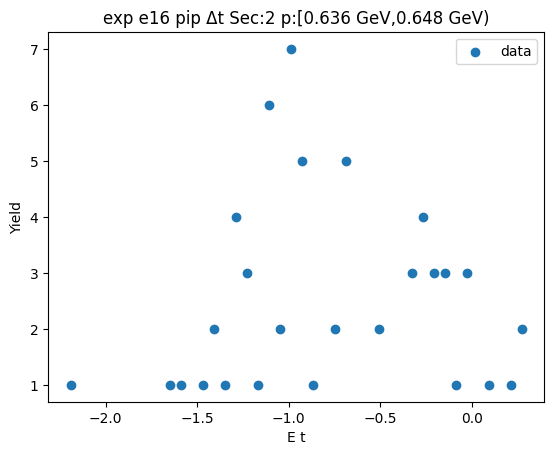

-1.7898515208552317 1.2477082011099474
-2.093607493051749 1.5514641733064651
-2.397363465248268 1.8552201455029833
[ 2.55521704 -0.27107166  0.60751194]


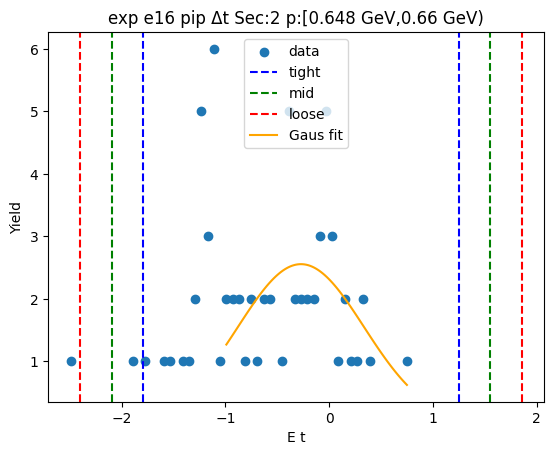

-1.5908475755539966 1.1091996662582497
-1.860852299735221 1.3792043904394742
-2.1308570239164455 1.6492091146206989
[ 2.63709335 -0.24082395  0.54000945]


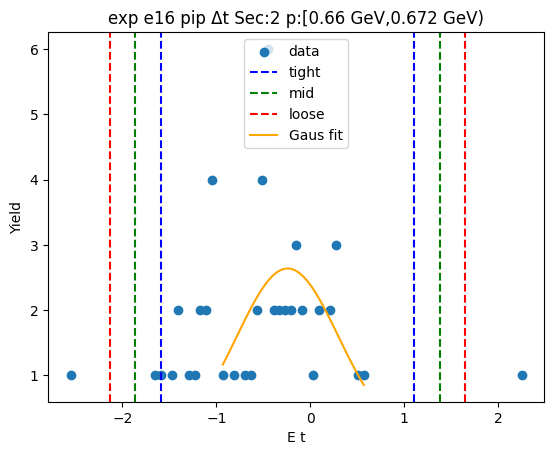

-1.3017645939871472 0.9848994274828208
-1.530430996134144 1.2135658296298177
-1.7590973982811409 1.4422322317768146
[ 3.8489538  -0.15843258  0.4573328 ]


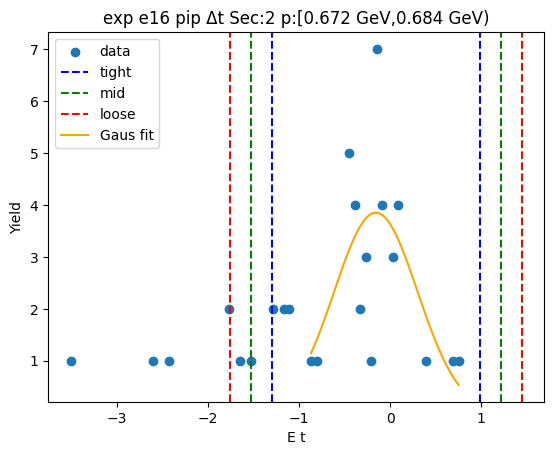

-0.9300838370118878 0.6947752236216476
-1.0925697430752412 0.857261129685001
-1.255055649138595 1.0197470357483547
[ 4.94129959 -0.11765431  0.32497181]


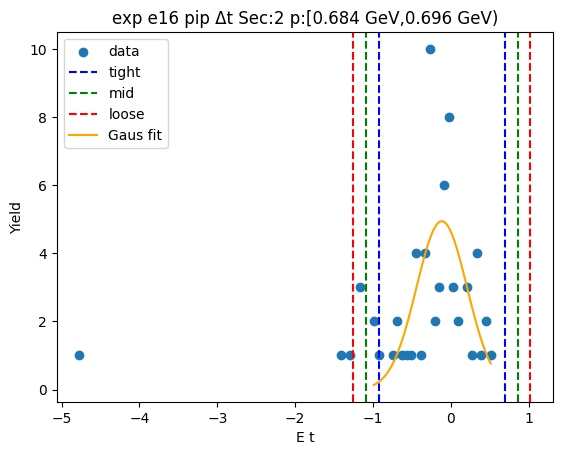

-1.364490106370308 1.118295169192277
-1.6127686339265668 1.3665736967485356
-1.8610471614828252 1.614852224304794
[ 4.04296105 -0.12309747  0.49655706]


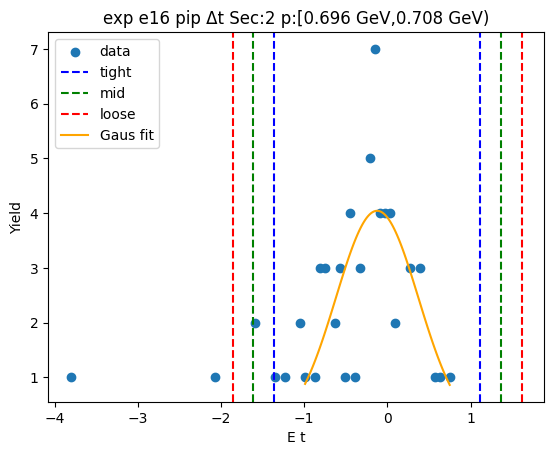

-1.0780349948188939 0.7987320575875005
-1.2657117000595335 0.9864087628281402
-1.4533884053001729 1.1740854680687796
[ 4.04608251 -0.13965147  0.37535341]


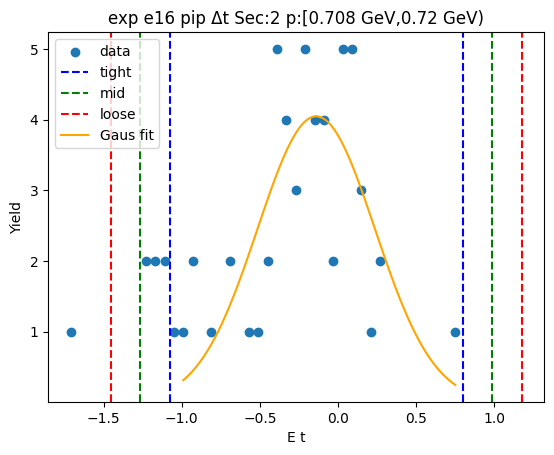

-1.1103736258526988 0.5852109821464235
-1.2799320866526112 0.7547694429463359
-1.4494905474525233 0.924327903746248
[ 4.26006796 -0.26258132  0.33911692]


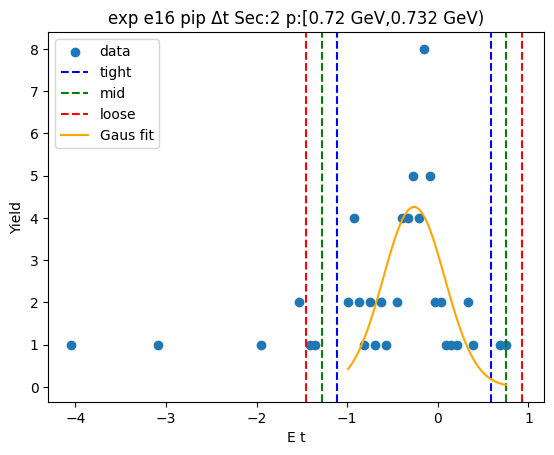

-1.5725668998042643 0.77753502173964
-1.8075770919586547 1.0125452138940303
-2.0425872841130452 1.2475554060484209
[ 3.94394636 -0.39751594  0.47002038]


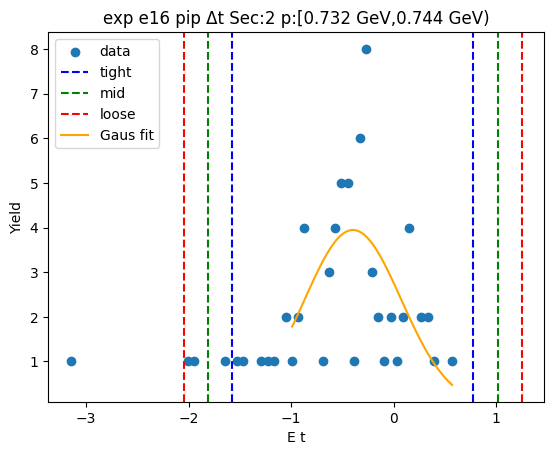

-2.3959768874096192 1.3467546780027475
-2.7702500439508557 1.721027834543984
-3.1445232004920927 2.095300991085221
[ 2.73206543 -0.5246111   0.74854631]


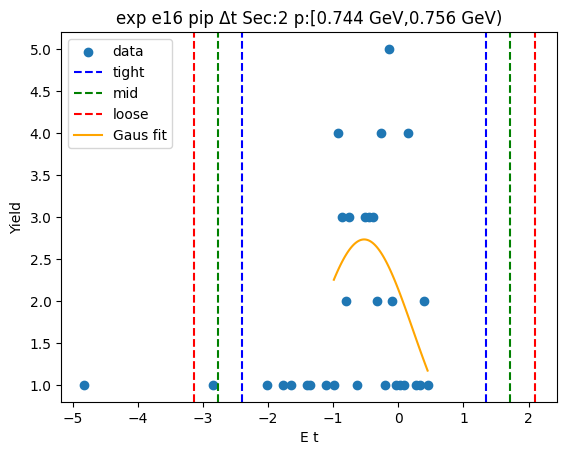

-2.7312062491767186 1.7850763140262424
-3.182834505497015 2.236704570346539
-3.634462761817311 2.688332826666835
[ 2.09162968 -0.47306497  0.90325651]


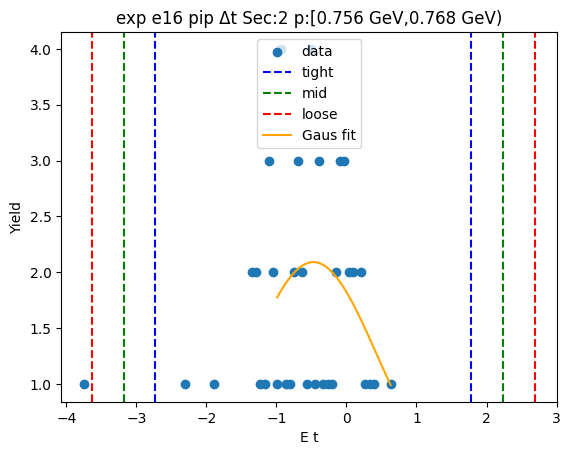

-2.6668047936145407 1.4151637150767162
-3.0750016444836668 1.8233605659458423
-3.4831984953527924 2.231557416814968
[ 2.49753585 -0.62582054  0.8163937 ]


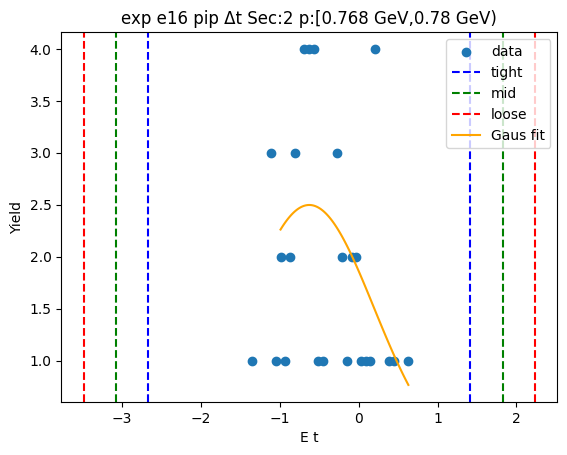

Runtime Error
[ 2.49753585 -0.62582054  0.8163937 ]


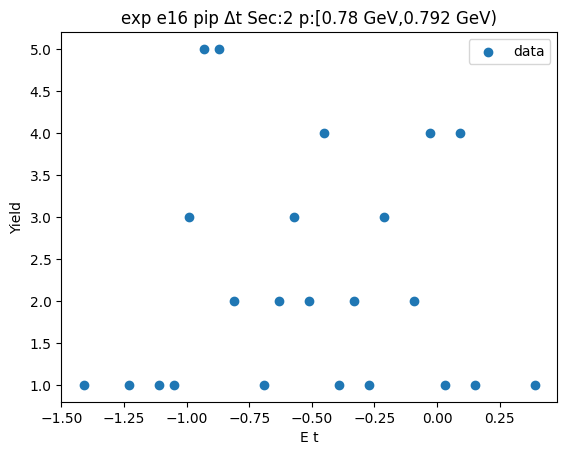

-1.576340700918558 1.36887695570748
-1.8708624665811617 1.6633987213700838
-2.165384232243765 1.9579204870326874
[ 2.52473229 -0.10373187  0.58904353]


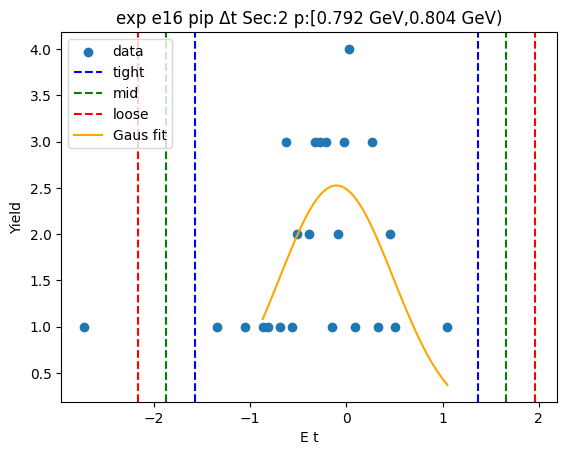

-1.6575421224066575 1.418117586082528
-1.9651080932555762 1.7256835569314466
-2.272674064104495 2.0332495277803653
[ 2.6582151  -0.11971227  0.61513194]


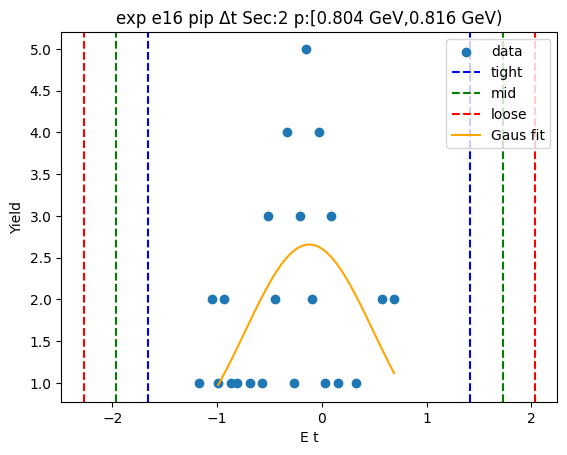

-2.2085845710322887 1.6983442854411392
-2.5992774566796313 2.089037171088482
-2.9899703423269743 2.479730056735825
[ 2.19049272 -0.25512014  0.78138577]


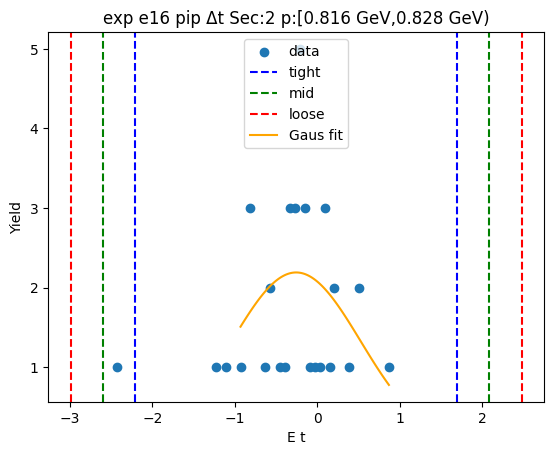

-1.490795582291232 1.1781782512804808
-1.7576929656484033 1.445075634637652
-2.0245903490055746 1.7119730179948234
[ 2.71650768 -0.15630867  0.53379477]


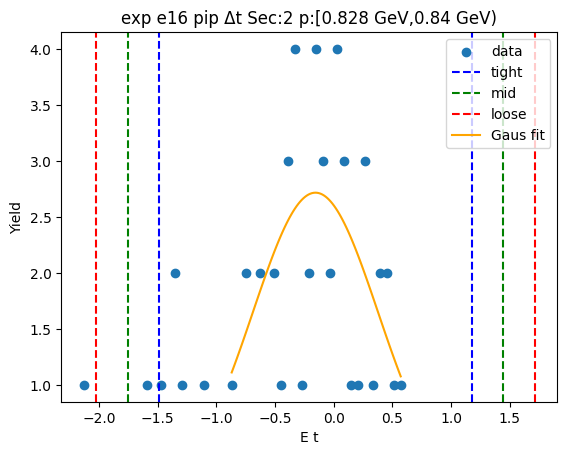

-1.4211116759444147 1.1942605412377285
-1.6826488976626288 1.4557977629559427
-1.9441861193808432 1.717334984674157
[ 2.61970627 -0.11342557  0.52307444]


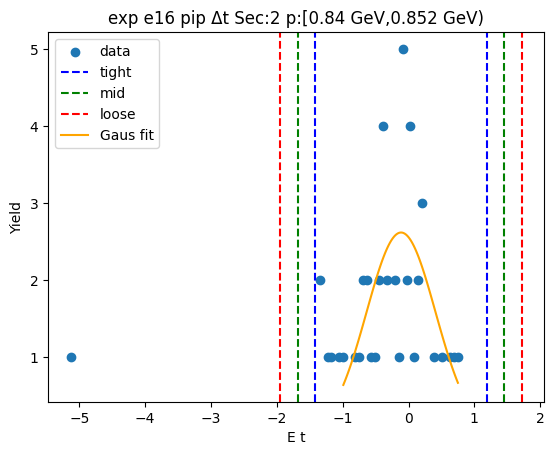

-0.9954939798218447 0.734094982639089
-1.168452876067938 0.9070538788851823
-1.3414117723140315 1.0800127751312758
[ 3.28454279 -0.1306995   0.34591779]


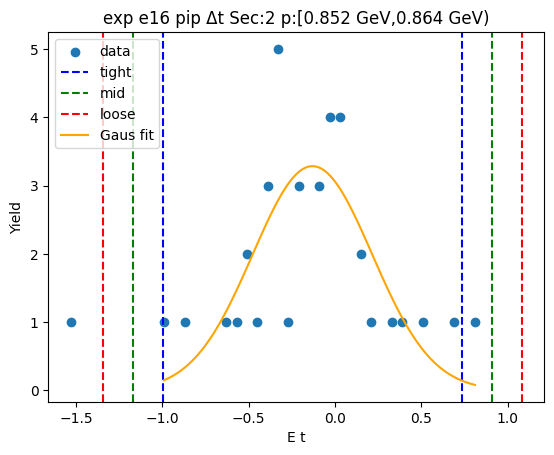

-1.618673968334077 1.205875079281464
-1.901128873095631 1.4883299840430182
-2.1835837778571854 1.7707848888045723
[ 1.81712598 -0.20639944  0.56490981]


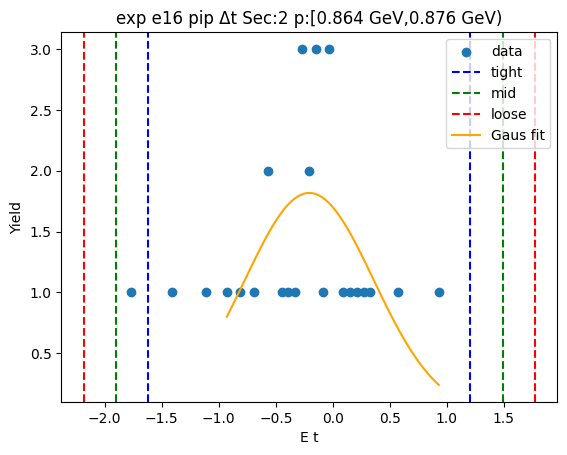

-344.61621951543617 29.44423956051031
-382.02226542303083 66.85028546810494
-419.42831133062543 104.25633137569957
[  17.38496583 -157.58598998   74.81209182]


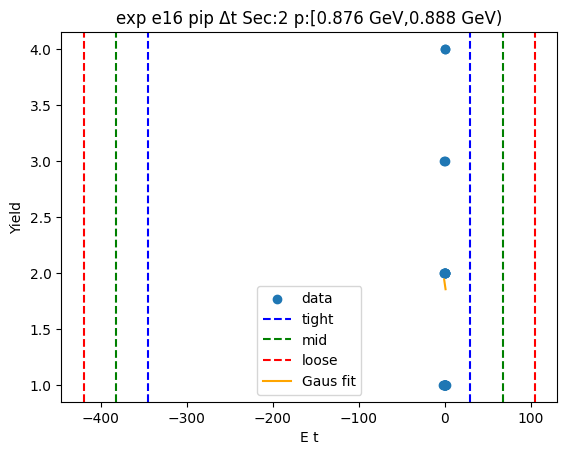

0.7370264128892874 -1.2421989060174259
0.9349489447799587 -1.4401214379080973
1.1328714766706303 -1.6380439697987685
[ 2.98311336 -0.25258625 -0.39584506]


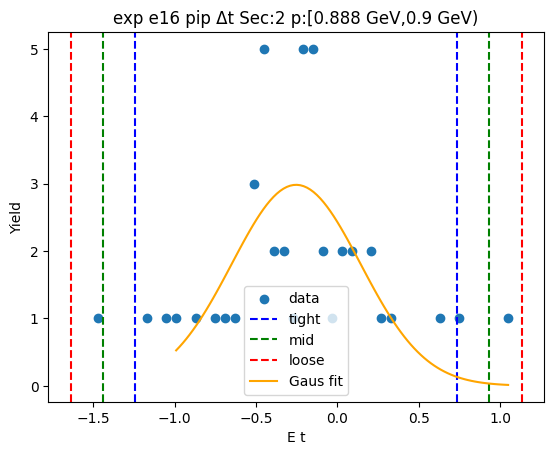

0.9507144700781804 -1.2326362857489204
1.1690495456608907 -1.4509713613316306
1.3873846212436007 -1.6693064369143407
[ 2.62960277 -0.14096091 -0.43667015]


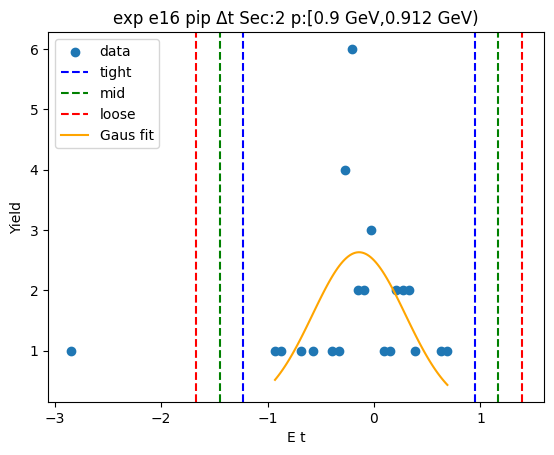

1.4532052671844458 -1.8459995752909237
1.7831257514319825 -2.175920059538461
2.1130462356795197 -2.505840543785998
[ 2.03055843 -0.19639715 -0.65984097]


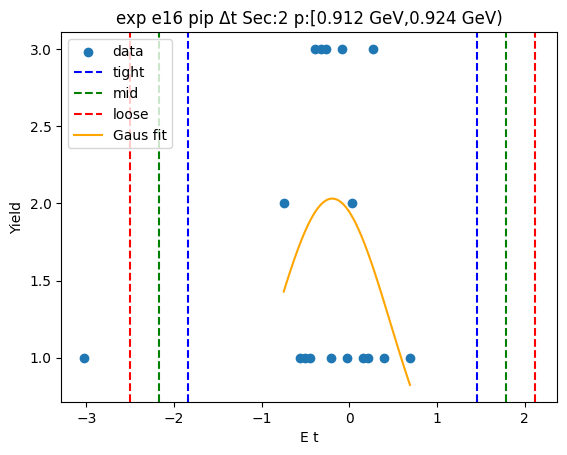

1.0250947852023173 -1.2504386449406055
1.2526481282166095 -1.4779919879548977
1.480201471230902 -1.7055453309691901
[ 2.80974261 -0.11267193 -0.45510669]


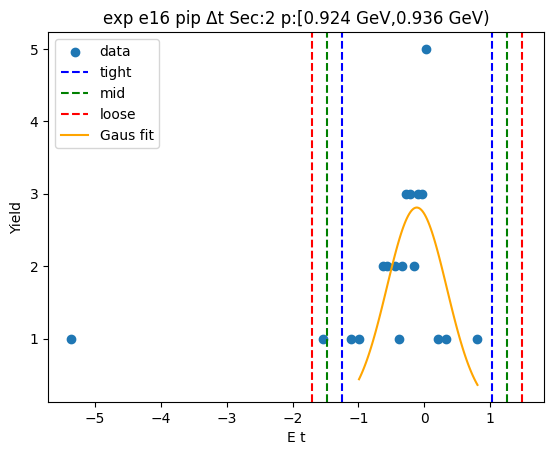

2.342949919047558 -2.0786011539464297
2.7851050263469572 -2.520756261245828
3.2272601336463556 -2.9629113685452273
[ 1.88337536  0.13217438 -0.88431021]


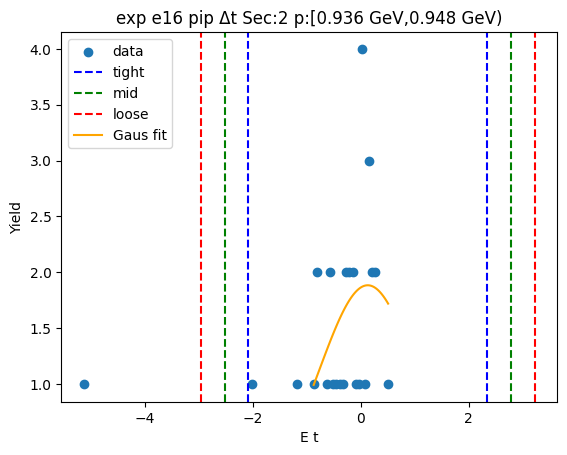

-66.78152396545569 -189.79558627914054
-54.4801177340872 -202.096992510509
-42.17871150271873 -214.3983987418775
[ 1.28967858e+06 -1.28288555e+02 -2.46028125e+01]


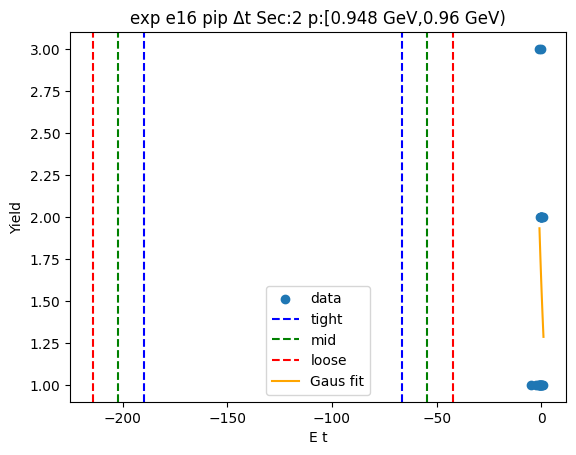

1.1309594119990054 -1.163082116082316
1.3603635648071375 -1.392486268890448
1.5897677176152696 -1.62189042169858
[ 2.88942006 -0.01606135 -0.45880831]


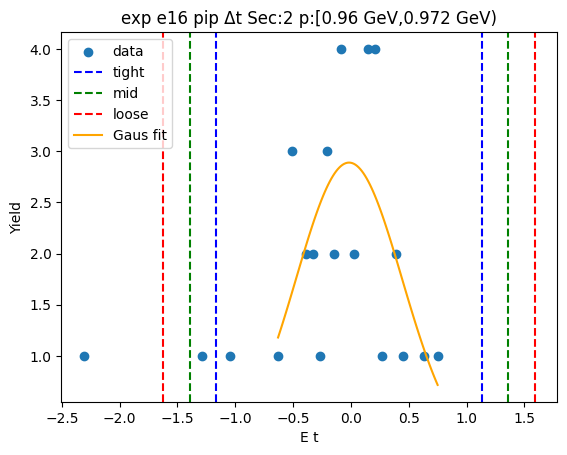

2.508806382246429 -2.9903003623916478
3.058717056710237 -3.540211036855456
3.6086277311740447 -4.090121711319263
[ 1.56955867 -0.24074699 -1.09982135]


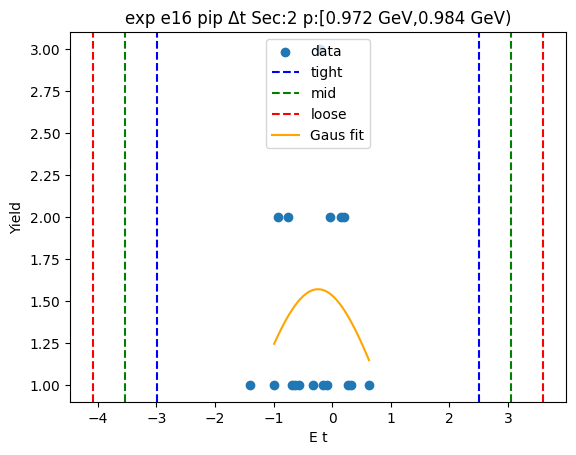

1.5335134696814365 -2.2766537645315954
1.91453019310274 -2.657670487952899
2.295546916524043 -3.038687211374202
[ 1.82993955 -0.37157015 -0.76203345]


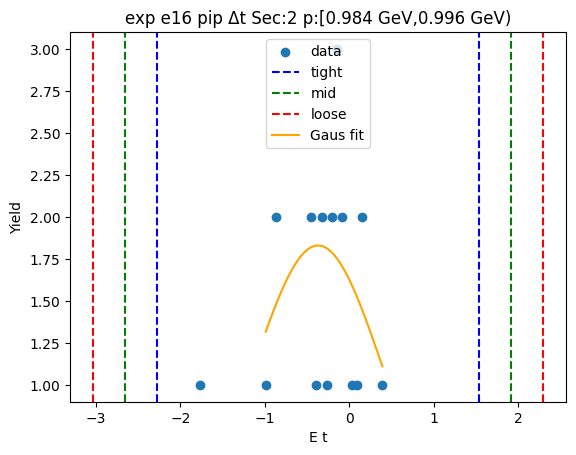

-17.87104594635194 -184.83724276938676
-1.1744262640484493 -201.53386245169025
15.522193418255029 -218.23048213399372
[ 140.96621256 -101.35414436  -33.39323936]


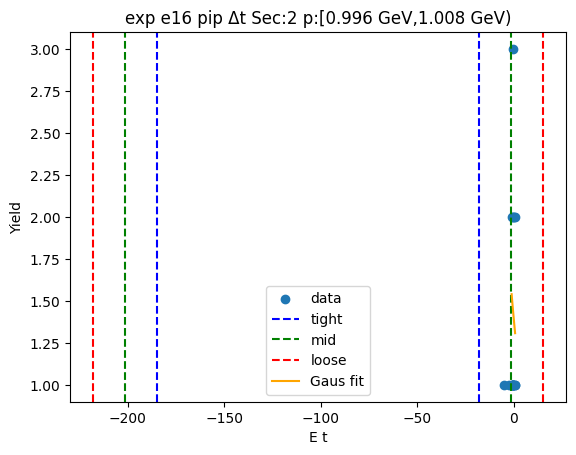

1.180130104493973 -1.804934526733
1.4786365676166704 -2.1034409898556974
1.7771430307393676 -2.4019474529783946
[ 1.6760984  -0.31240221 -0.59701293]


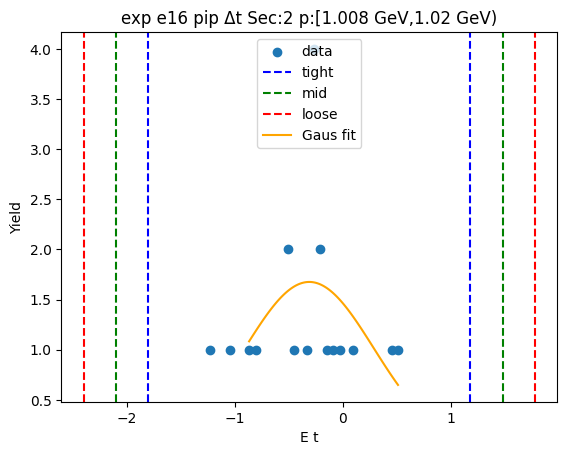

1.006518886428339 -1.4321460042844016
1.250385375499613 -1.6760124933556757
1.494251864570887 -1.9198789824269498
[ 2.60307494 -0.21281356 -0.48773298]


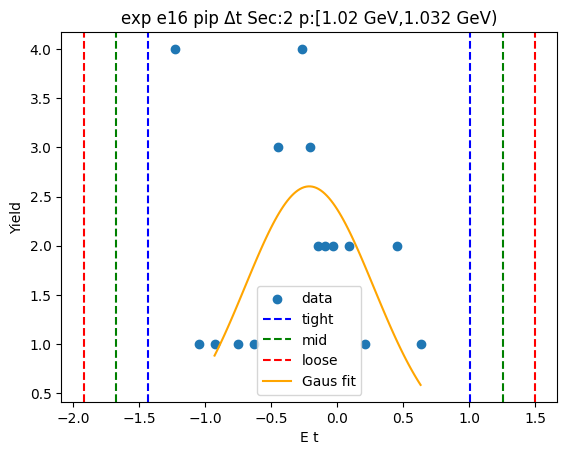

1.5882178267350984 -2.049961948427686
1.9520358042513768 -2.413779925943964
2.315853781767655 -2.7775979034602423
[ 1.81744396 -0.23087206 -0.72763596]


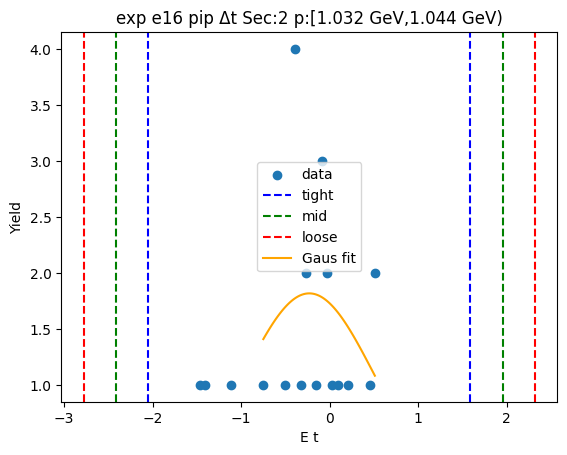

3.2338927458974602 -5.247737203858556
4.082055740873062 -6.0959001988341575
4.930218735848664 -6.944063193809759
[ 1.7204815  -1.00692223 -1.69632599]


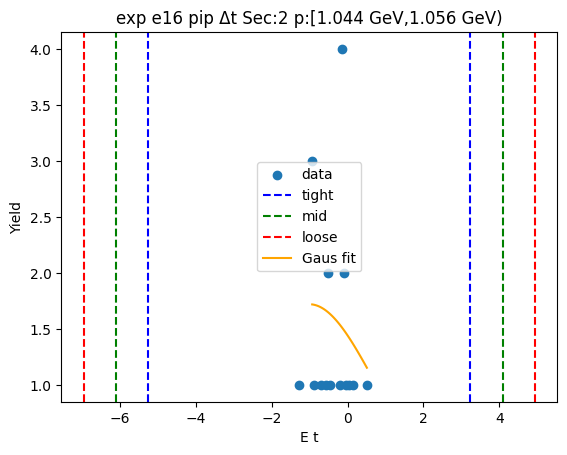

2.1966952968700086 -3.832302917335789
2.799595118290588 -4.435202738756368
3.4024949397111683 -5.038102560176949
[ 1.6514576  -0.81780381 -1.20579964]


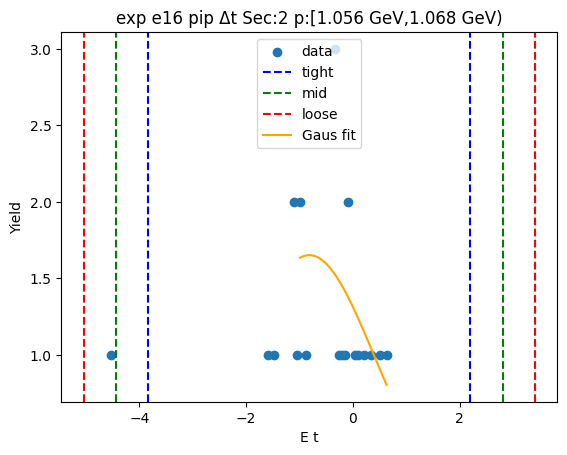

1.5167664579090527 -1.7638818104051286
1.8448312847404709 -2.0919466372365467
2.172896111571889 -2.420011464067965
[ 1.77553856 -0.12355768 -0.65612965]


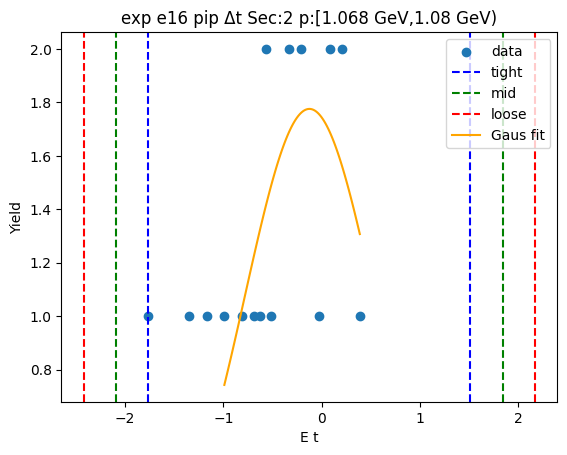

0.8535117053343759 -1.3497955099323922
1.073842426861053 -1.5701262314590692
1.2941731483877297 -1.790456952985746
[ 1.6158786  -0.2481419  -0.44066144]


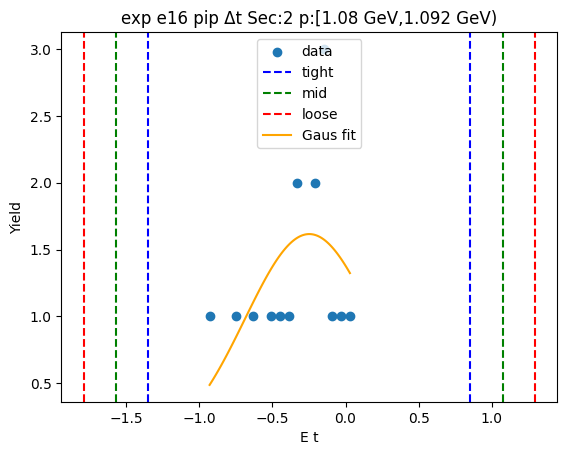

1.7910652846500599 -2.01588806475498
2.171760619590564 -2.396583399695484
2.552455954531068 -2.777278734635988
[ 1.60136911 -0.11241139 -0.76139067]


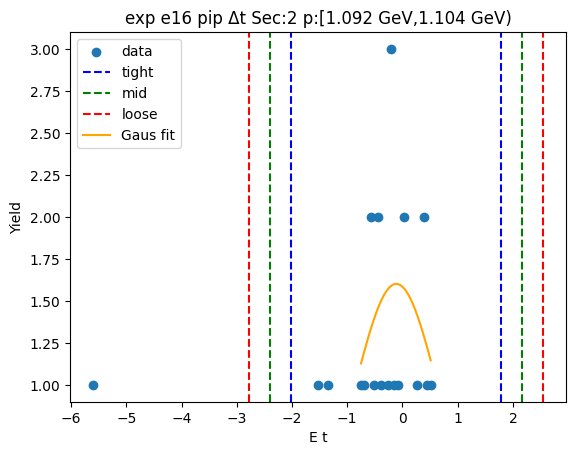

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.00000000e+00 -1.65697582e-02 -1.83842520e+04]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_70472/3799154978.py:63: RuntimeWarning: invalid value encountered in scalar subtract
  sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]


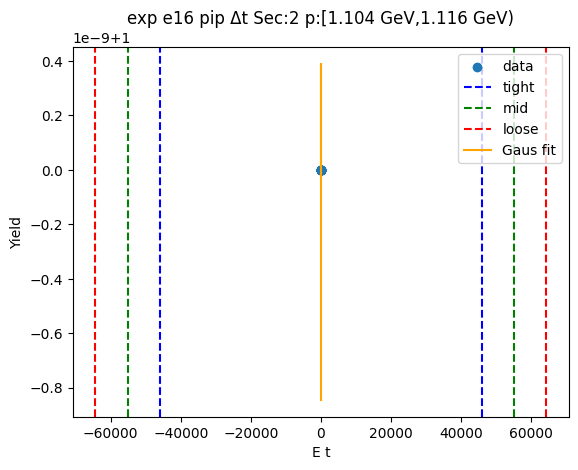

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.22222222e+00 -1.65697582e-02 -1.83842520e+04]


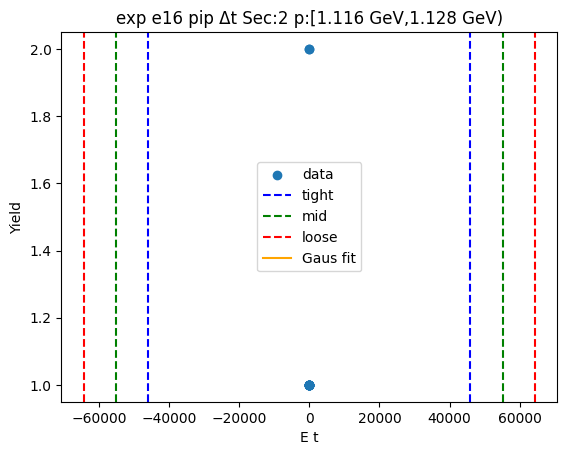

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.36363636e+00 -1.65697582e-02 -1.83842520e+04]


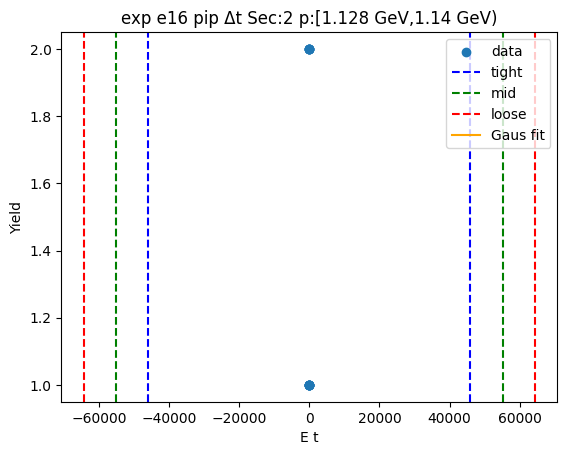

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.22222222e+00 -1.65697582e-02 -1.83842520e+04]


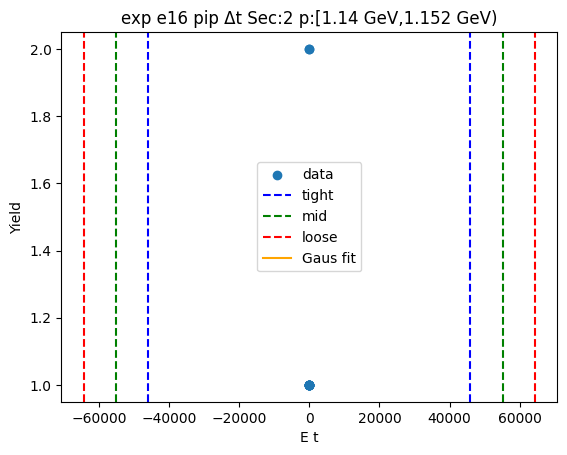

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.28571429e+00 -1.65697582e-02 -1.83842520e+04]


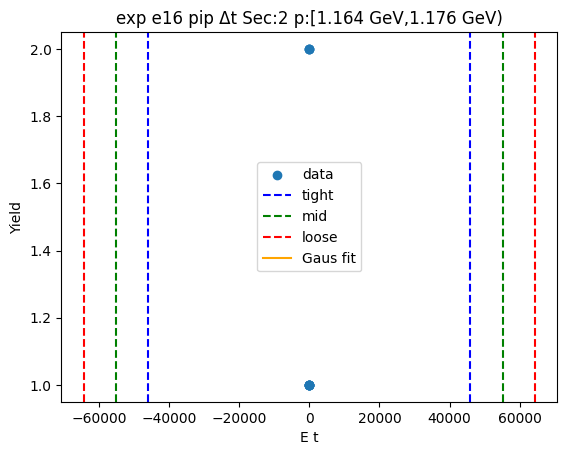

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.50000000e+00 -1.65697582e-02 -1.83842520e+04]


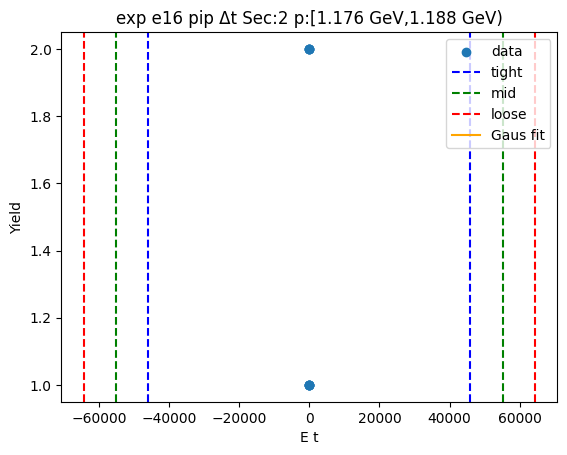

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.25000000e+00 -1.65697582e-02 -1.83842520e+04]


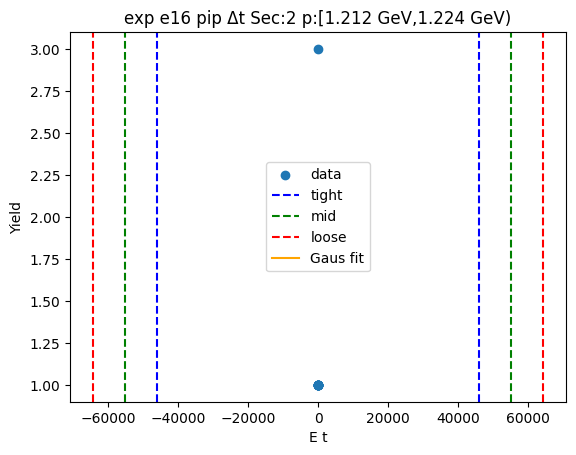

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.20000000e+00 -1.65697582e-02 -1.83842520e+04]


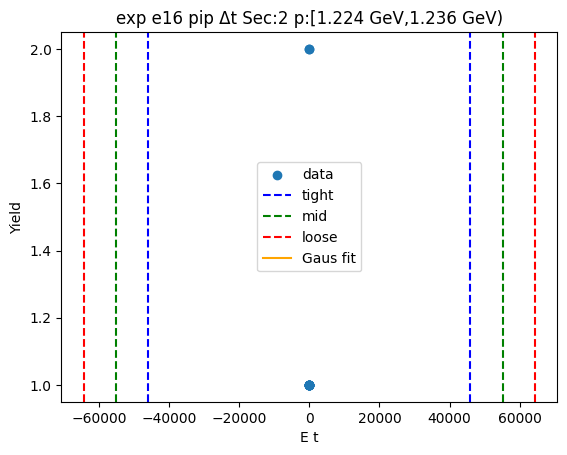

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.12500000e+00 -1.65697582e-02 -1.83842520e+04]


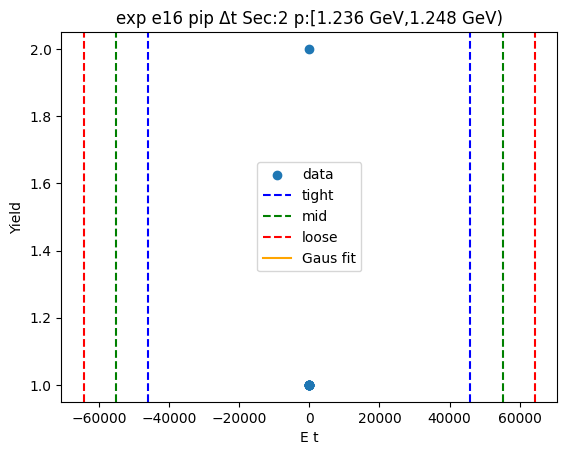

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.37500000e+00 -1.65697582e-02 -1.83842520e+04]


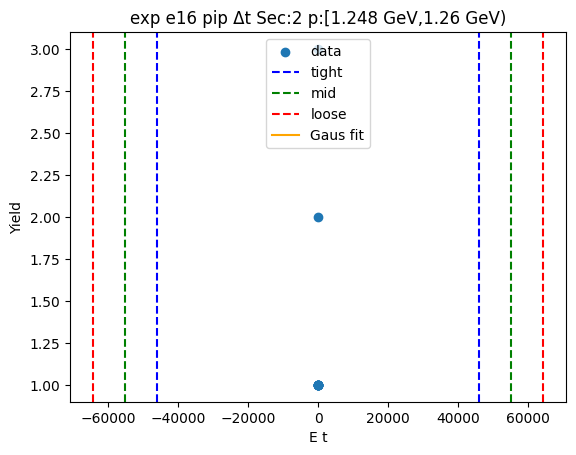

45960.61352127817 -45960.64666079458
55152.73953948545 -55152.77267900186
64344.86555769272 -64344.89869720913
[ 1.10000000e+00 -1.65697582e-02 -1.83842520e+04]


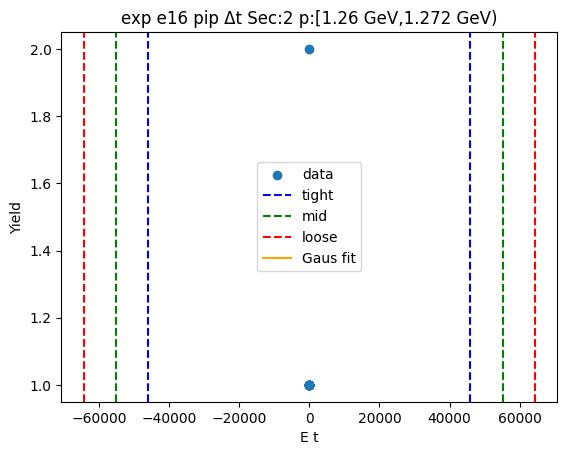

-0.7257798183035905 0.5476403149528654
-0.8531218316292362 0.674982328278511
-0.9804638449548818 0.8023243416041567
[26.15170364 -0.08906975  0.25468403]


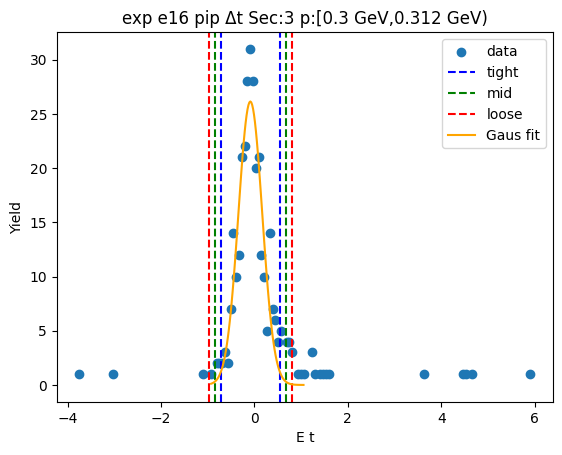

-0.7623843674832463 0.7331487906884296
-0.911937683300414 0.8827021065055973
-1.0614909991175816 1.032255422322765
[ 2.70797895e+01 -1.46177884e-02  2.99106632e-01]


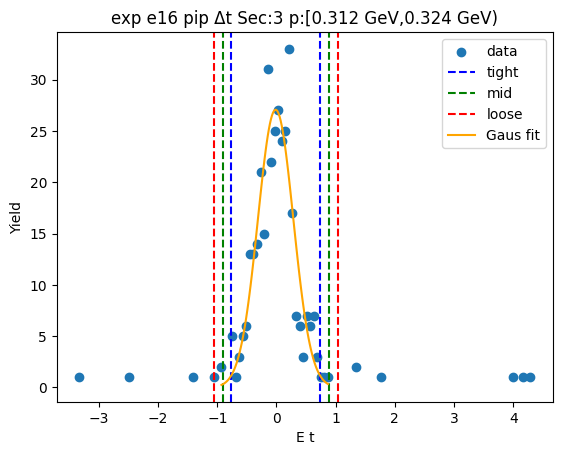

-0.770226597309197 0.59662285136161
-0.9069115421762776 0.7333077962286906
-1.0435964870433583 0.8699927410957713
[28.18312967 -0.08680187  0.27336989]


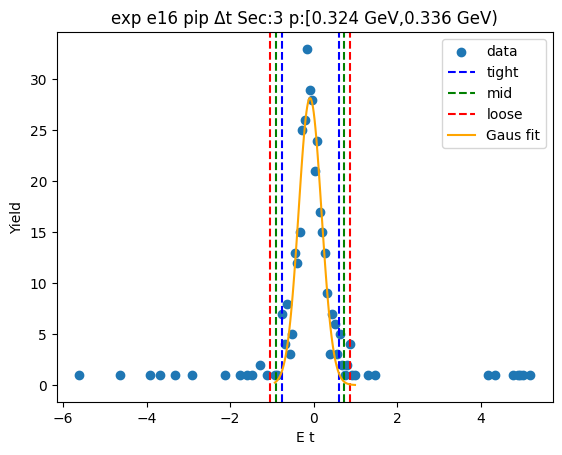

-0.8608067341178015 0.640736877394548
-1.0109610952690367 0.790891238545783
-1.1611154564202715 0.9410455996970178
[29.59627519 -0.11003493  0.30030872]


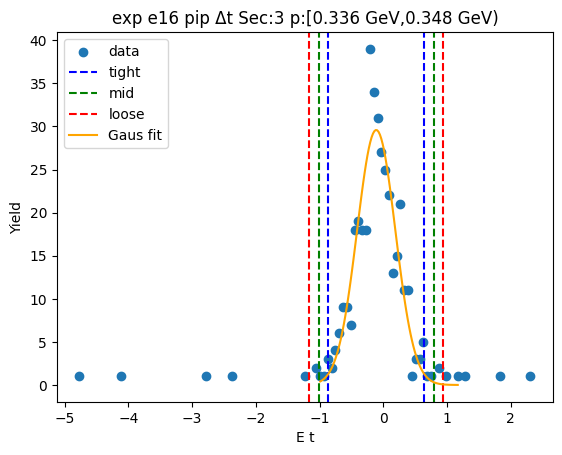

-0.920507549586082 0.6683897052532607
-1.0793972750700163 0.8272794307371949
-1.2382870005539504 0.9861691562211291
[25.05728227 -0.12605892  0.31777945]


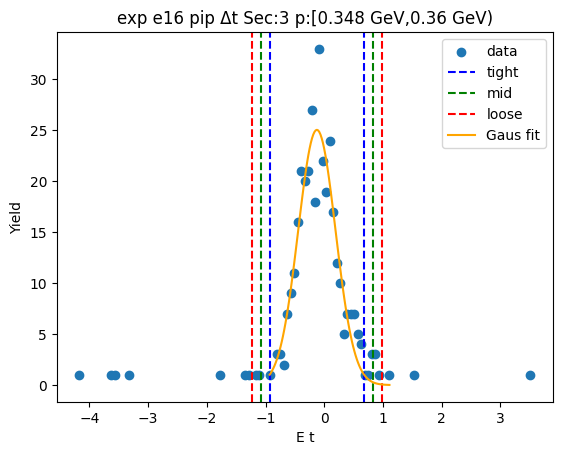

-0.7983424831374631 0.6914275691310067
-0.9473194883643101 0.8404045743578537
-1.0962964935911572 0.9893815795847007
[31.68461148 -0.05345746  0.29795401]


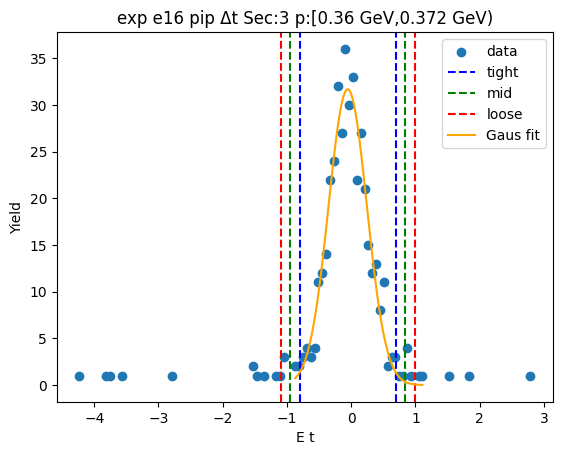

-0.8272928297544652 0.7313883831372262
-0.9831609510436342 0.8872565044263953
-1.1390290723328036 1.0431246257155644
[31.14061804 -0.04795222  0.31173624]


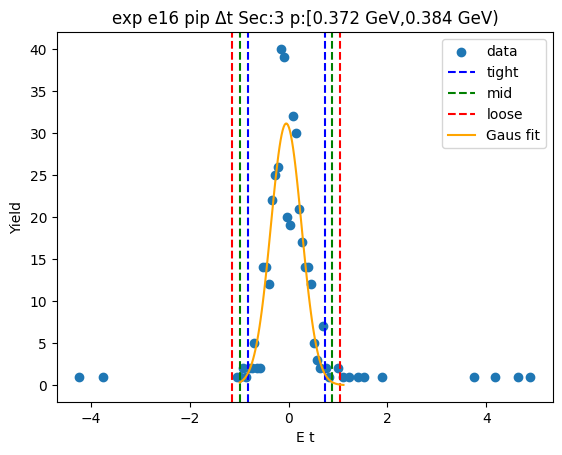

-0.8609749393261903 0.7097498367997468
-1.018047416938784 0.8668223144123406
-1.1751198945513777 1.0238947920249342
[31.88866628 -0.07561255  0.31414496]


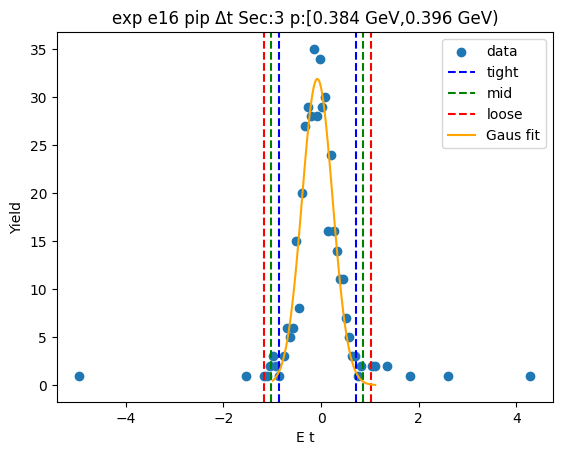

-0.7717553241159949 0.7304722924410252
-0.9219780857716968 0.8806950540967271
-1.072200847427399 1.0309178157524292
[ 3.05617440e+01 -2.06415158e-02  3.00445523e-01]


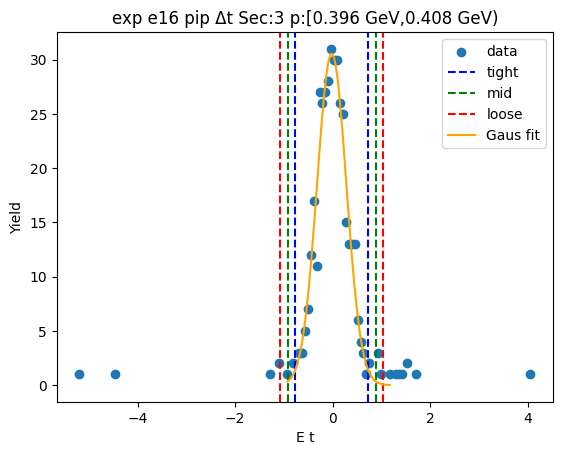

-0.7008107740966167 0.5633249897919641
-0.8272243504854748 0.6897385661808222
-0.9536379268743329 0.8161521425696803
[37.14458493 -0.06874289  0.25282715]


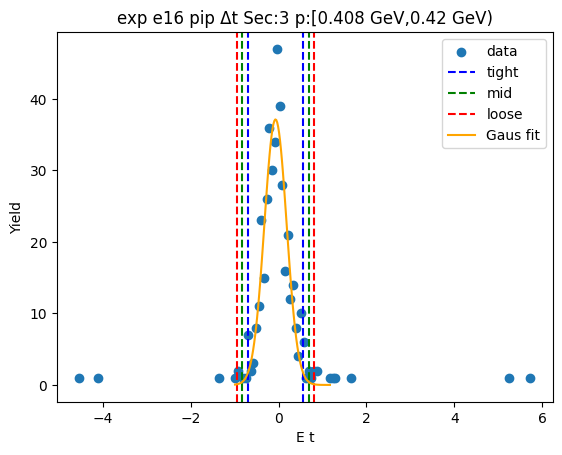

-0.9177601246141379 0.6912406792564615
-1.0786602050011977 0.8521407596435214
-1.2395602853882577 1.0130408400305815
[30.68079929 -0.11325972  0.32180016]


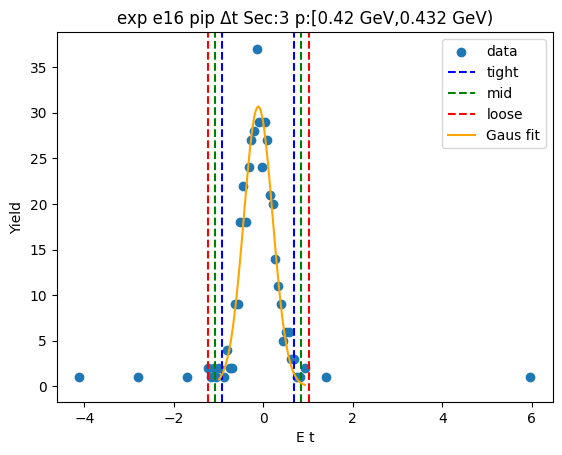

-0.9734102400788189 0.6756453627257608
-1.1383158003592768 0.8405509230062187
-1.303221360639735 1.0054564832866768
[29.61059066 -0.14888244  0.32981112]


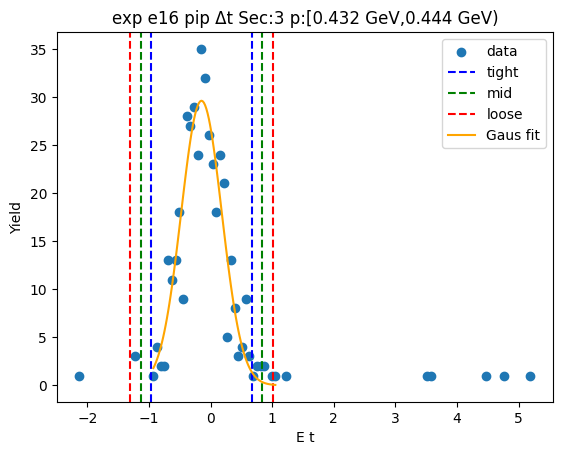

-1.0202255150172643 0.6647136321807867
-1.1887194297370693 0.8332075469005917
-1.3572133444568746 1.001701461620397
[28.90164486 -0.17775594  0.33698783]


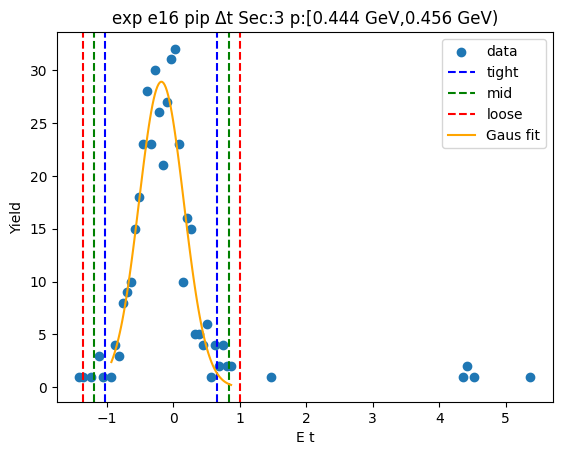

-0.9447193255750258 0.5796025024797492
-1.0971515083805032 0.7320346852852266
-1.2495836911859808 0.8844668680907041
[31.51811641 -0.18255841  0.30486437]


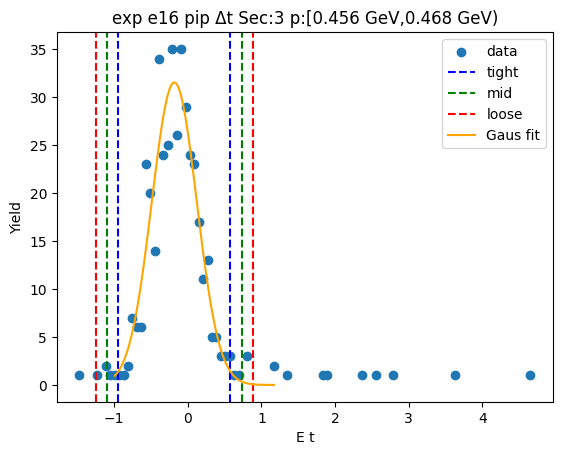

-1.0349123296078475 0.578181165351939
-1.196221679103826 0.7394905148479176
-1.3575310285998048 0.9007998643438964
[31.83645975 -0.22836558  0.3226187 ]


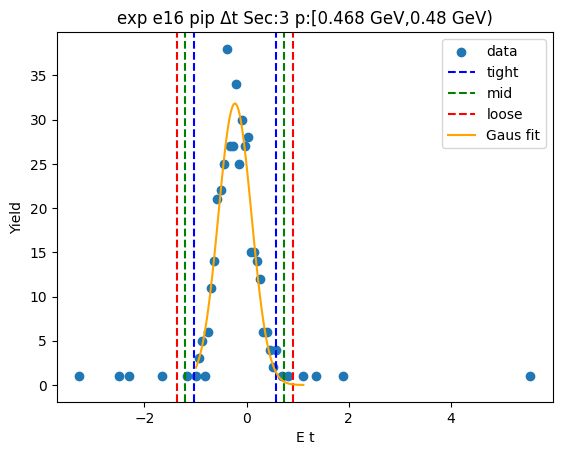

-1.0759432593617553 0.6110240610195052
-1.2446399913998811 0.7797207930576313
-1.4133367234380072 0.9484175250957574
[30.5725752  -0.2324596   0.33739346]


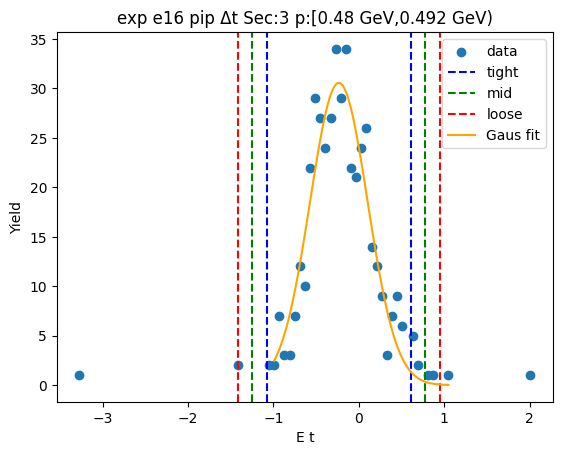

-0.9641864701627147 0.5395013774384594
-1.1145552549228324 0.6898701621985769
-1.2649240396829495 0.8402389469586943
[33.0192239  -0.21234255  0.30073757]


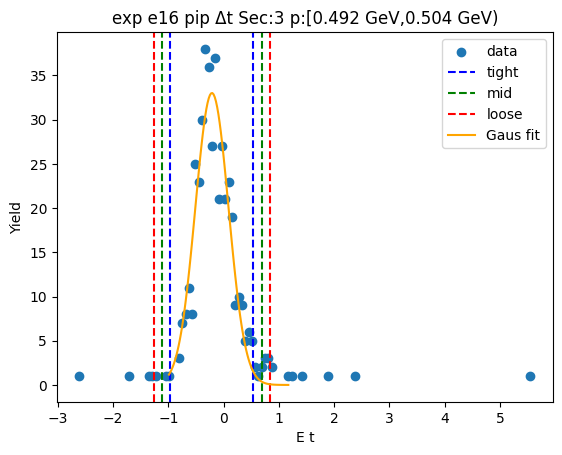

-1.0290310953420396 0.614302000031848
-1.1933644048794283 0.7786353095692367
-1.3576977144168172 0.9429686191066255
[28.49909215 -0.20736455  0.32866662]


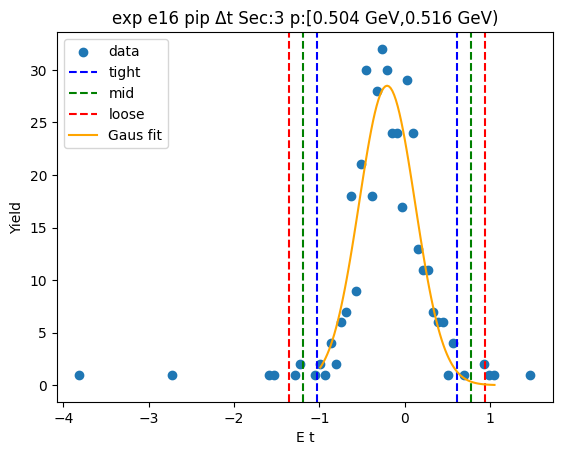

-0.9871171275772073 0.5447061381916443
-1.1402994541540925 0.6978884647685295
-1.2934817807309775 0.8510707913454145
[28.78524131 -0.22120549  0.30636465]


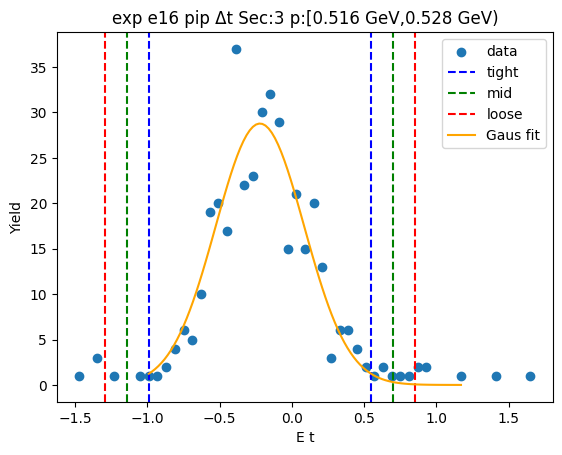

-0.925150825779925 0.4726800633455108
-1.0649339146924688 0.6124631522580545
-1.2047170036050123 0.7522462411705981
[31.93230936 -0.22623538  0.27956618]


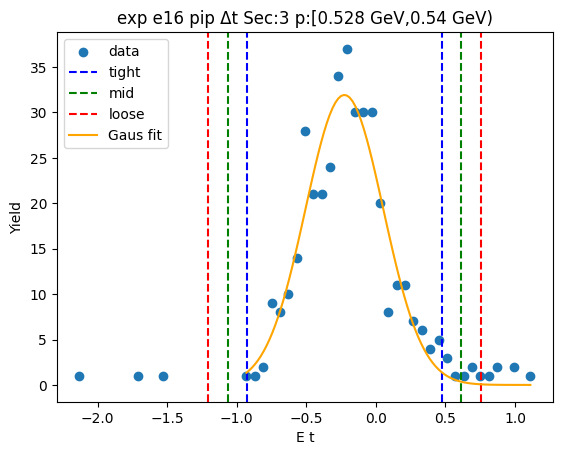

-0.9560253948981441 0.38301021953801656
-1.0899289563417602 0.5169137809816327
-1.2238325177853762 0.6508173424252488
[32.78371239 -0.28650759  0.26780712]


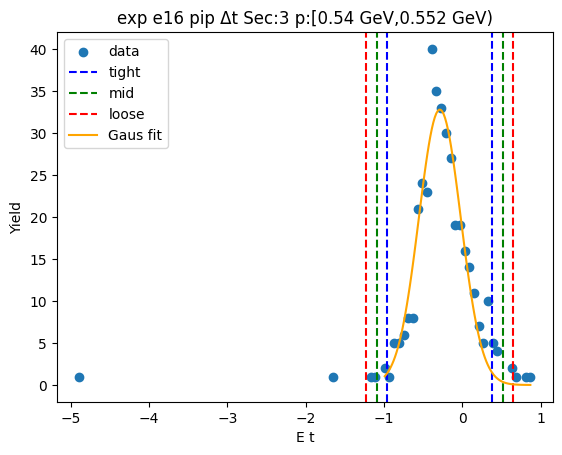

-0.9610655507341008 0.40650083969629347
-1.09782218977714 0.5432574787393328
-1.2345788288201796 0.6800141177823722
[31.31515324 -0.27728236  0.27351328]


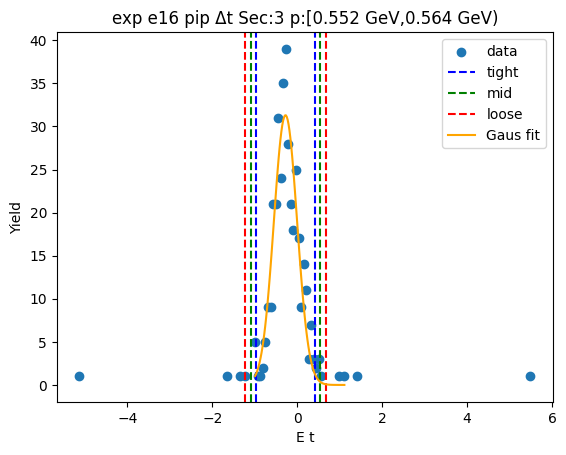

-0.8630022414661959 0.3486468495500513
-0.9841671505678206 0.469811758651676
-1.1053320596694451 0.5909766677533007
[38.38241162 -0.2571777   0.24232982]


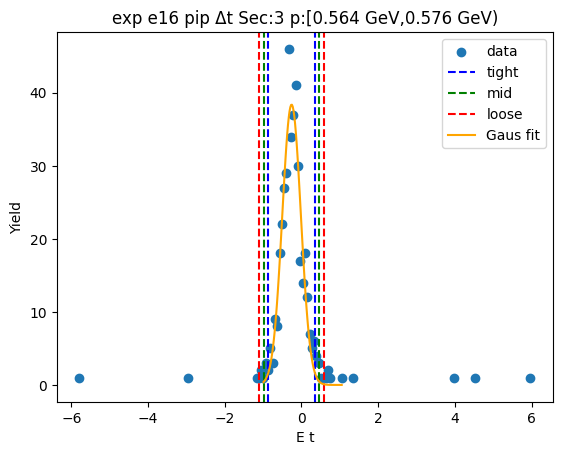

-0.9120425546334833 0.41513361553215755
-1.0447601716500474 0.5478512325487217
-1.1774777886666117 0.6805688495652858
[33.91266205 -0.24845447  0.26543523]


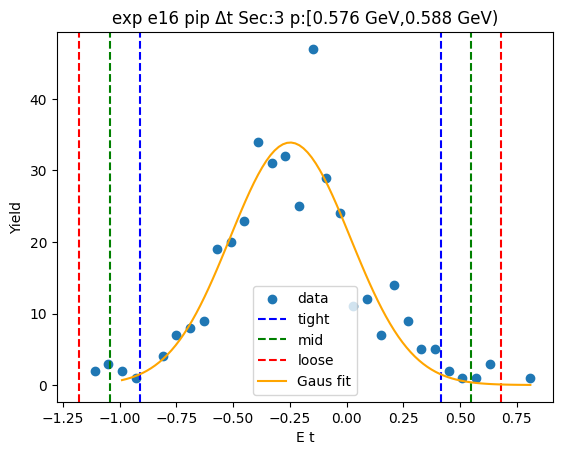

-1.0048666595718982 0.5617904088797221
-1.1615323664170605 0.7184561157248842
-1.3181980732622225 0.8751218225700462
[23.35979145 -0.22153813  0.31333141]


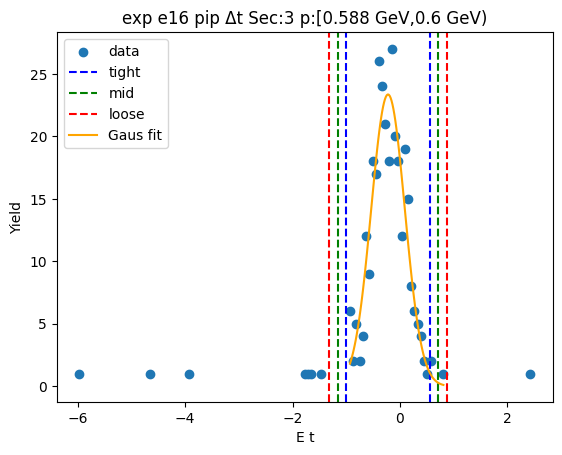

-1.0461578041082409 0.5063583136801091
-1.2014094158870758 0.6616099254589441
-1.356661027665911 0.8168615372377792
[15.90176114 -0.26989975  0.31050322]


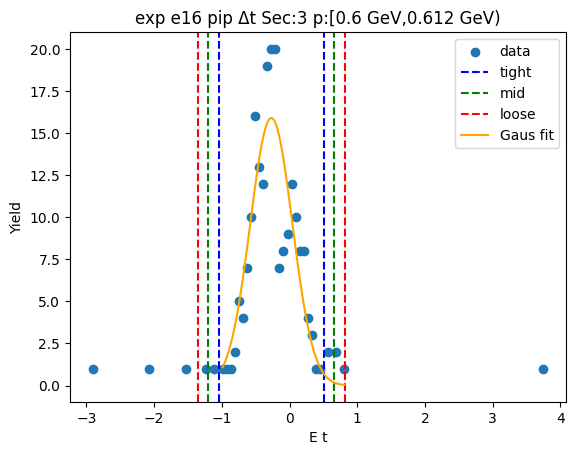

-0.9974642865800536 0.5293645049612179
-1.1501471657341809 0.6820473841153449
-1.302830044888308 0.834730263269472
[18.50363441 -0.23404989  0.30536576]


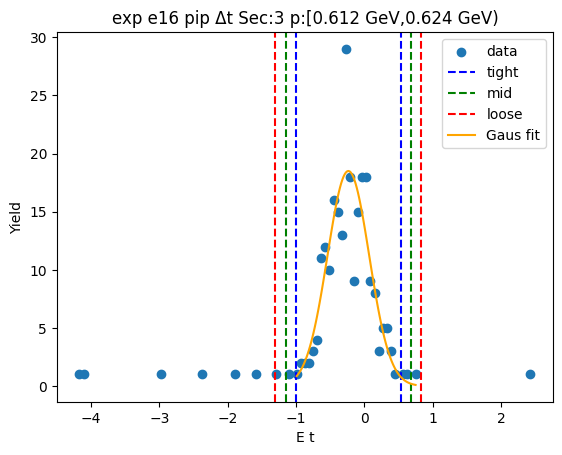

-0.8930541028777483 0.44091199282232907
-1.026450712447756 0.5743086023923367
-1.1598473220177636 0.7077052119623445
[16.84859838 -0.22607106  0.26679322]


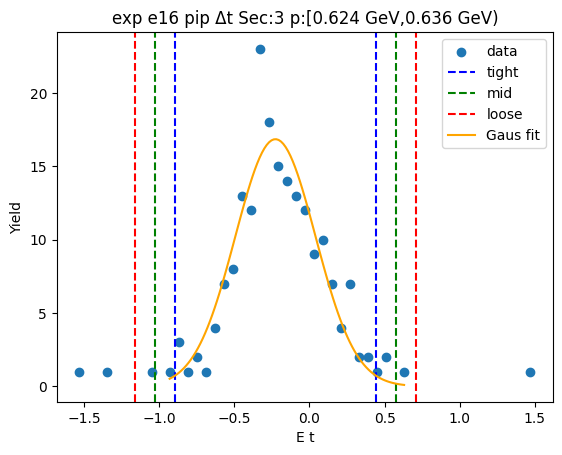

-1.0008268957353903 0.5016536678638327
-1.1510749520953127 0.6519017242237549
-1.3013230084552352 0.8021497805836774
[12.53856066 -0.24958661  0.30049611]


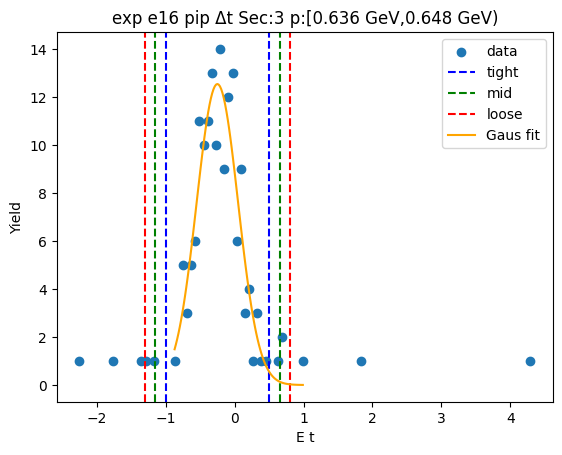

-0.9856718528316579 0.4692725488160721
-1.131166292996431 0.6147669889808451
-1.2766607331612039 0.760261429145618
[12.04577028 -0.25819965  0.29098888]


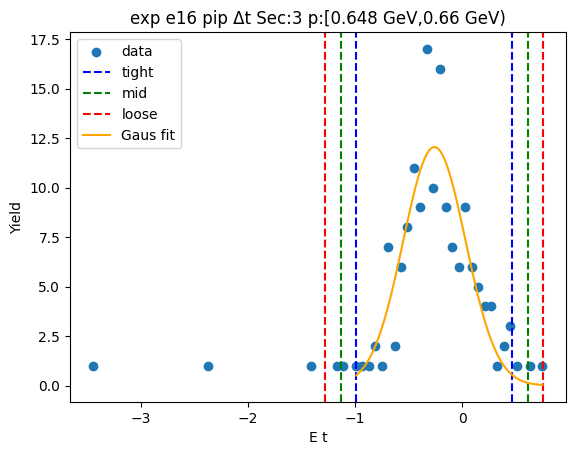

-1.0866567636187299 0.48089506388212855
-1.2434119463688158 0.6376502466322145
-1.4001671291189015 0.7944054293823002
[14.78642061 -0.30288085  0.31351037]


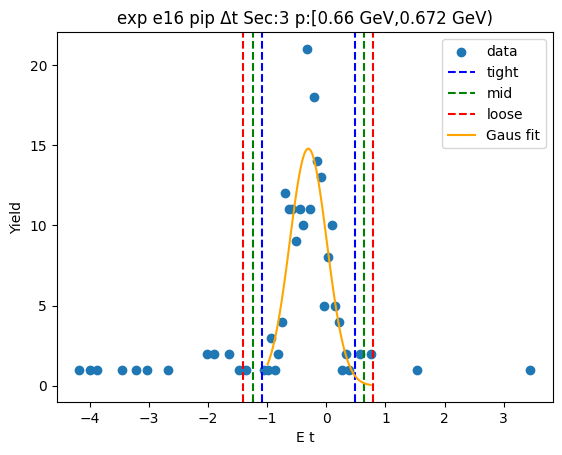

-1.1698828124944662 0.6365712146778542
-1.3505282152116982 0.8172166173950861
-1.5311736179289304 0.9978620201123183
[13.6936433  -0.2666558   0.36129081]


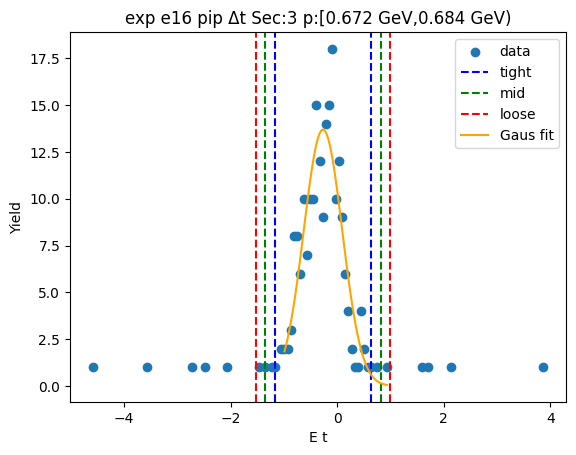

-1.2154660393248486 0.6147178116185237
-1.3984844244191859 0.797736196712861
-1.5815028095135233 0.9807545818071982
[13.79993741 -0.30037411  0.36603677]


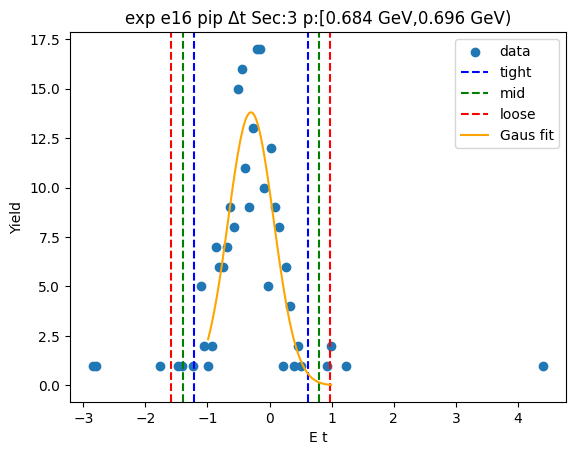

-1.1922136294806407 0.6247758825269225
-1.373912580681397 0.8064748337276789
-1.5556115318821533 0.9881737849284352
[14.48957431 -0.28371887  0.3633979 ]


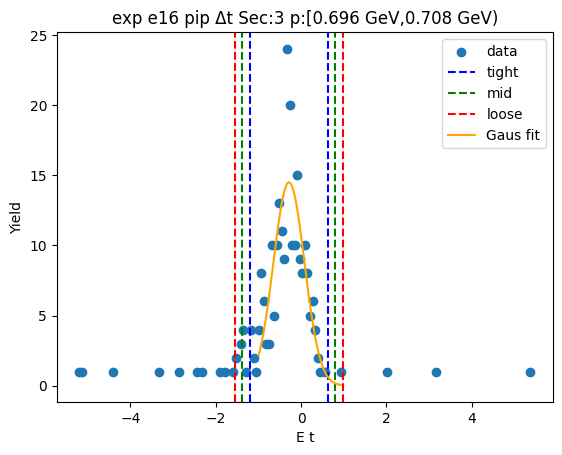

-1.0889405374869376 0.4267918384105923
-1.2405137750766906 0.5783650760003454
-1.3920870126664435 0.7299383135900984
[14.8046463  -0.33107435  0.30314648]


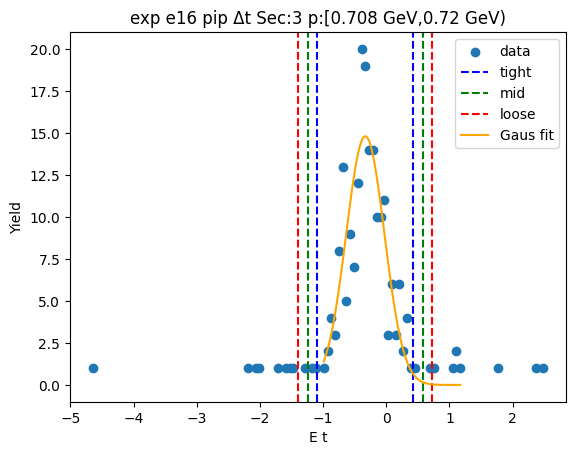

-1.2964878969827485 0.6059762062788506
-1.4867343073089083 0.7962226166050107
-1.6769807176350682 0.9864690269311706
[12.50331442 -0.34525585  0.38049282]


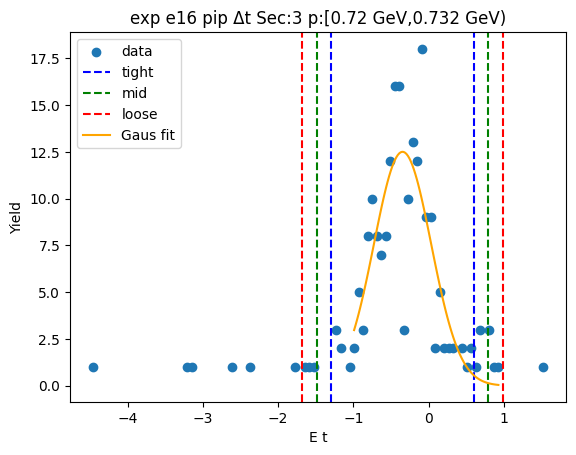

-1.064358131849251 0.4006420919386481
-1.2108581542280408 0.547142114317438
-1.3573581766068306 0.6936421366962278
[15.36411608 -0.33185802  0.29300004]


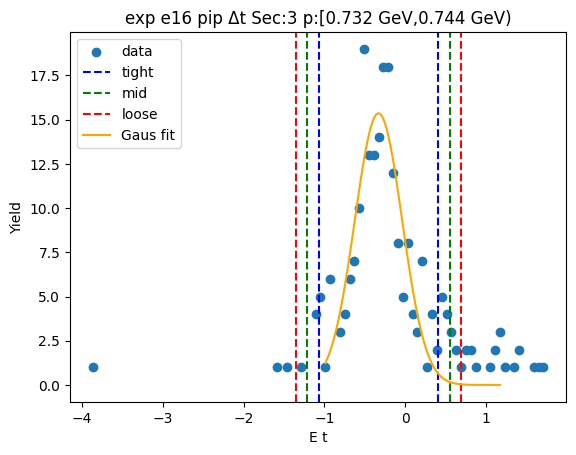

-1.0955602400962086 0.4982396827984333
-1.2549402323856726 0.6576196750878973
-1.414320224675137 0.8169996673773616
[11.86137759 -0.29866028  0.31875998]


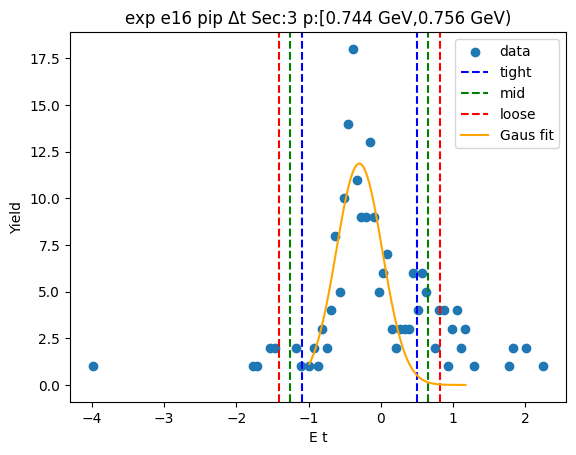

-1.5065285730779618 0.9329469397123948
-1.7504761243569975 1.1768944909914305
-1.9944236756360332 1.4208420422704662
[ 9.87929432 -0.28679082  0.4878951 ]


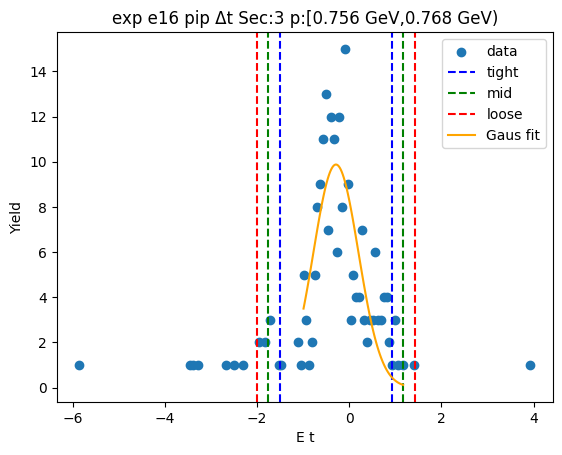

-1.8584206160151273 1.2215641989699921
-2.1664190975136393 1.529562680468504
-2.4744175790121514 1.8375611619670162
[ 7.88427291 -0.31842821  0.61599696]


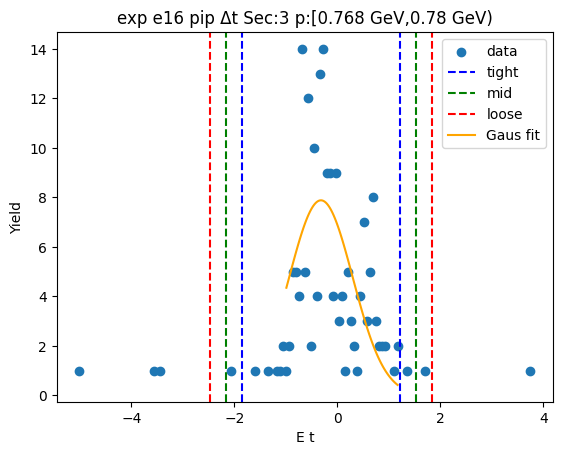

-1.8711721655880746 1.3308117659064729
-2.1913705587375296 1.6510101590559276
-2.5115689518869844 1.9712085522053824
[ 7.69334256 -0.2701802   0.64039679]


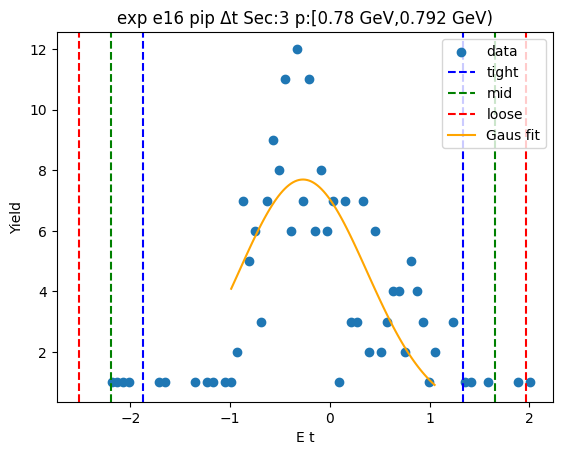

-2.1875985358118673 1.3883109011651018
-2.5451894795095638 1.7459018448627988
-2.9027804232072607 2.1034927885604957
[ 7.52655068 -0.39964382  0.71518189]


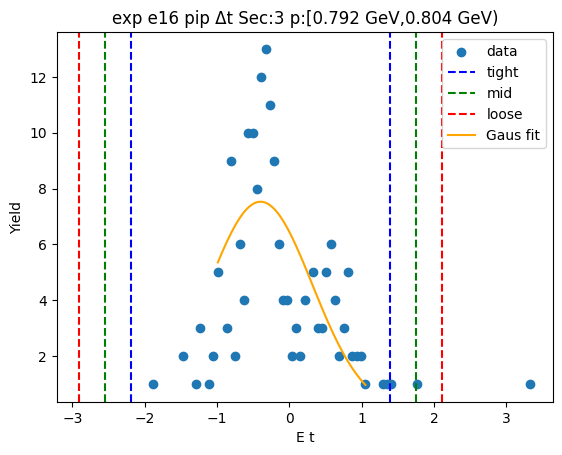

-1.6761998230494795 0.94979679963067
-1.9387994853174946 1.212396461898685
-2.2013991475855095 1.4749961241667
[ 8.65320346 -0.36320151  0.52519932]


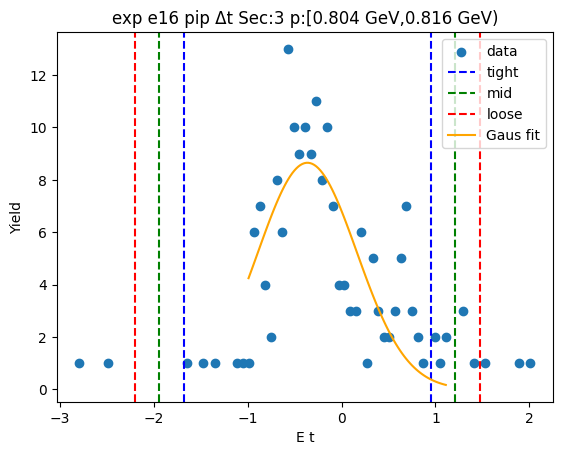

-2.235519250865667 1.438237240333252
-2.602894899985559 1.805612889453144
-2.9702705491054506 2.1729885385730356
[ 7.28602749 -0.39864101  0.7347513 ]


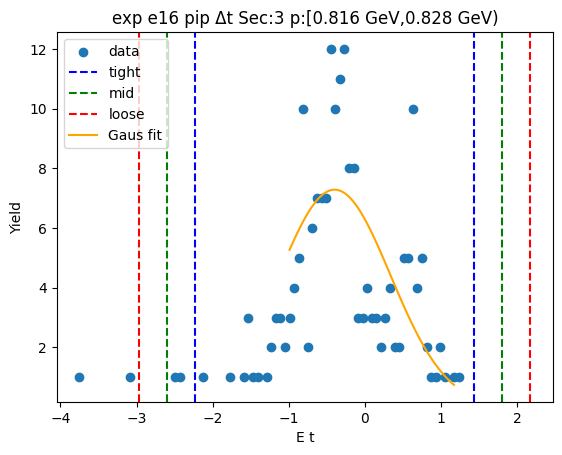

-1.5124616281437977 0.8540160826977201
-1.7491093992279494 1.0906638537818718
-1.9857571703121013 1.3273116248660237
[ 8.62230393 -0.32922277  0.47329554]


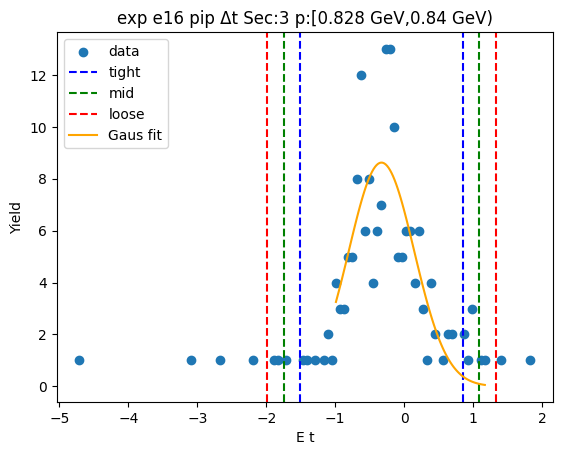

-1.2940466247324427 0.712752552833676
-1.4947265424890546 0.9134324705902879
-1.6954064602456664 1.1141123883468997
[ 8.28459471 -0.29064704  0.40135984]


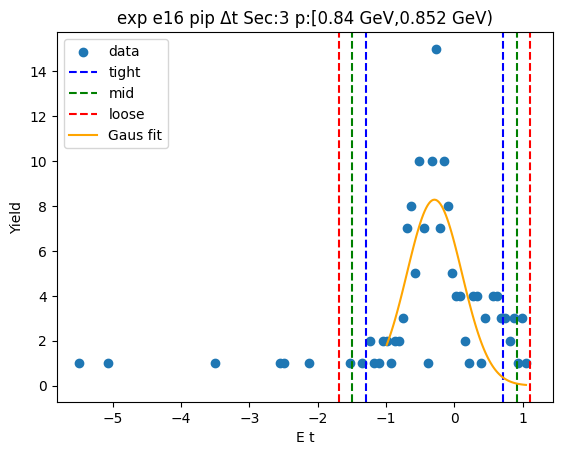

-1.3535797590542586 0.7074586267340346
-1.559683597633088 0.913562465312864
-1.7657874362119172 1.1196663038916932
[10.23961656 -0.32306057  0.41220768]


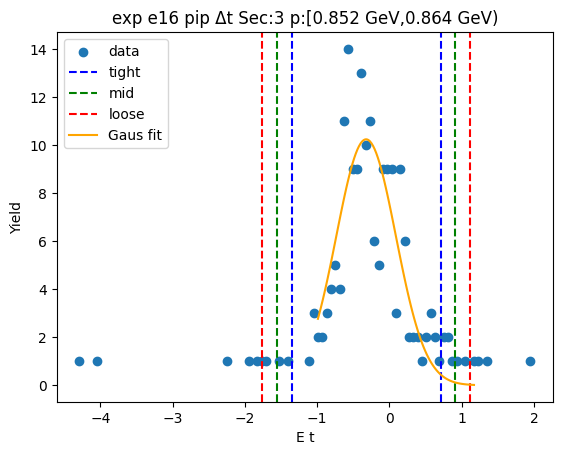

-1.50630233182354 0.8407143896294857
-1.7410040039688426 1.0754160617747883
-1.9757056761141452 1.310117733920091
[ 8.33953876 -0.33279397  0.46940334]


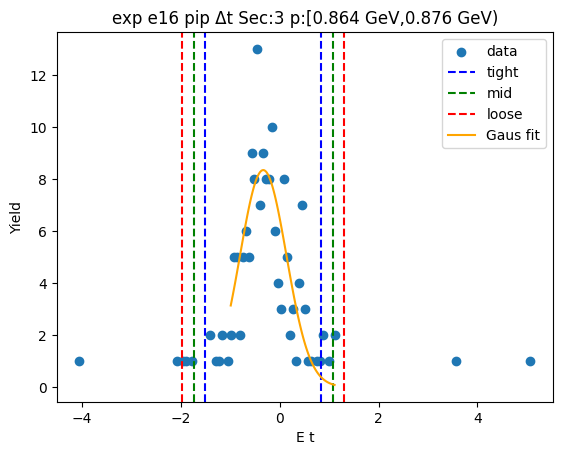

-1.2912820269512206 0.7888970672459066
-1.4992999363709334 0.9969149766656193
-1.7073178457906462 1.2049328860853321
[10.26799133 -0.25119248  0.41603582]


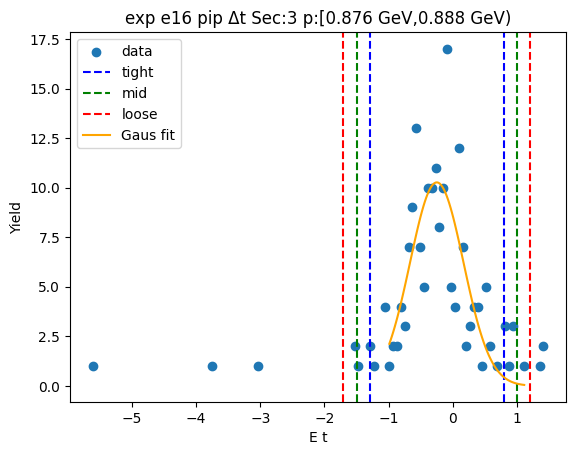

-1.2090885963580873 0.6311919599891728
-1.3931166519928135 0.8152200156238988
-1.5771447076275393 0.9992480712586248
[ 9.17857531 -0.28894832  0.36805611]


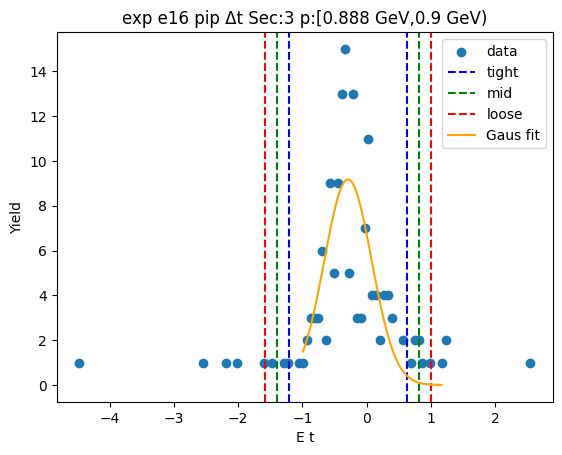

-1.2017810043235877 0.6780556118440337
-1.3897646659403498 0.8660392734607958
-1.577748327557112 1.054022935077558
[ 8.44283792 -0.2618627   0.37596732]


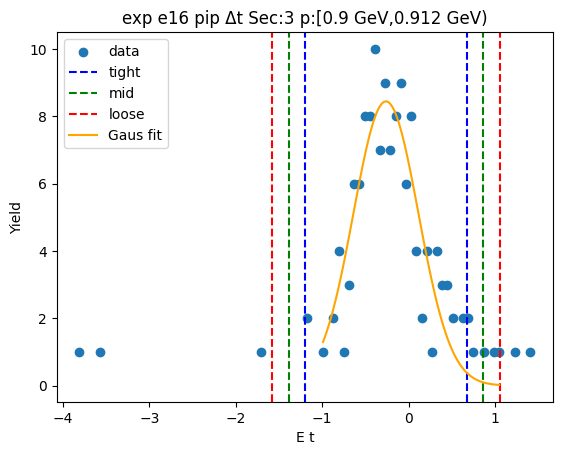

-1.1589999189524776 0.4376769600778399
-1.3186676068555092 0.5973446479808715
-1.478335294758541 0.7570123358839034
[ 8.65411316 -0.36066148  0.31933538]


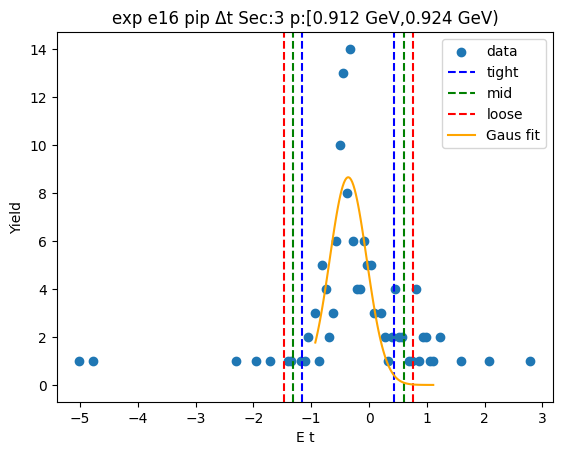

-1.1989781873097525 0.7215985957656567
-1.391035865617293 0.9136562740731974
-1.583093543924834 1.1057139523807384
[ 8.8939276  -0.2386898   0.38411536]


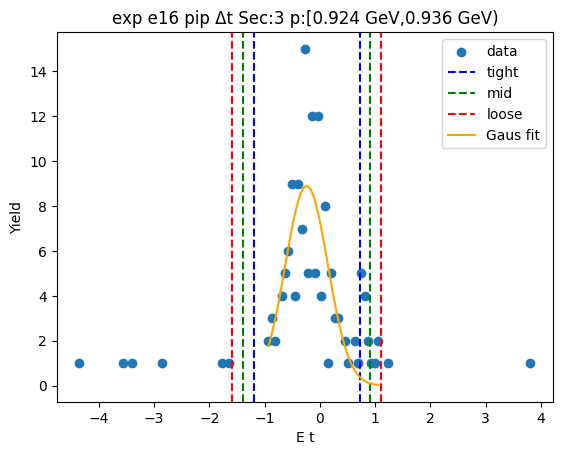

-1.132969934588157 0.5378595218815363
-1.3000528802351263 0.7049424675285054
-1.4671358258820957 0.8720254131754748
[10.81563772 -0.29755521  0.33416589]


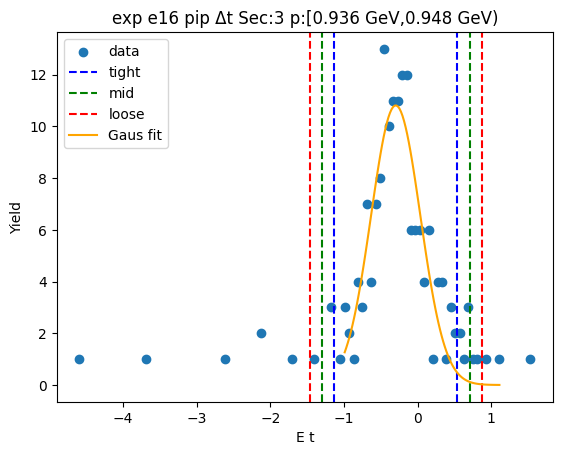

-1.2359255065068266 0.6382427028095234
-1.4233423274384616 0.8256595237411584
-1.6107591483700967 1.0130763446727935
[ 8.48978654 -0.2988414   0.37483364]


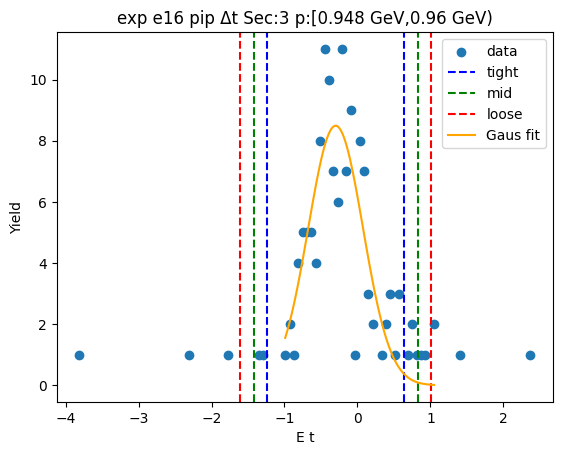

-1.6480670889140705 1.2476277530937834
-1.9376365731148557 1.5371972372945686
-2.2272060573156414 1.826766721495354
[ 6.29195299 -0.20021967  0.57913897]


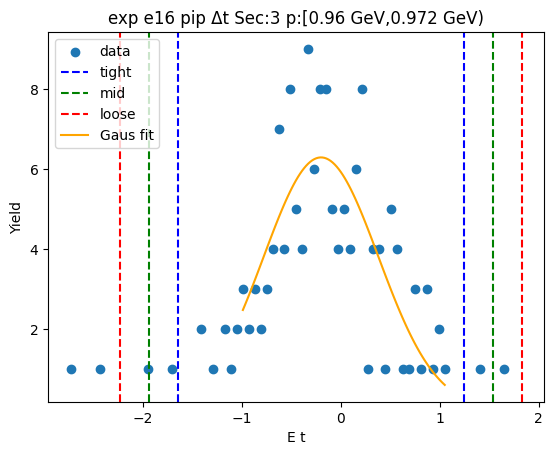

-1.366079144041298 0.8122336956572404
-1.5839104280111518 1.0300649796270944
-1.801741711981006 1.2478962635969482
[ 7.58915762 -0.27692272  0.43566257]


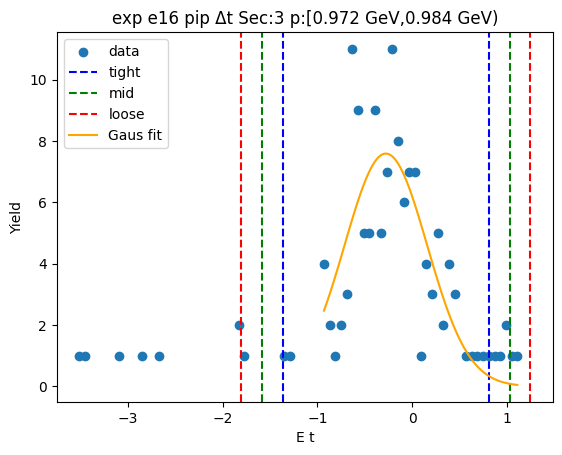

-1.1935391930182473 0.7401143252325069
-1.3869045448433226 0.9334796770575824
-1.5802698966683981 1.126845028882658
[ 7.35093941 -0.22671243  0.3867307 ]


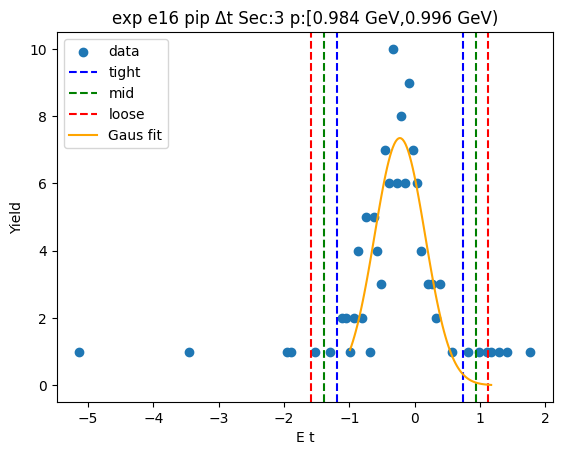

-1.0823424412590947 0.5863908165754955
-1.2492157670425539 0.7532641423589546
-1.4160890928260128 0.9201374681424135
[ 7.70594292 -0.24797581  0.33374665]


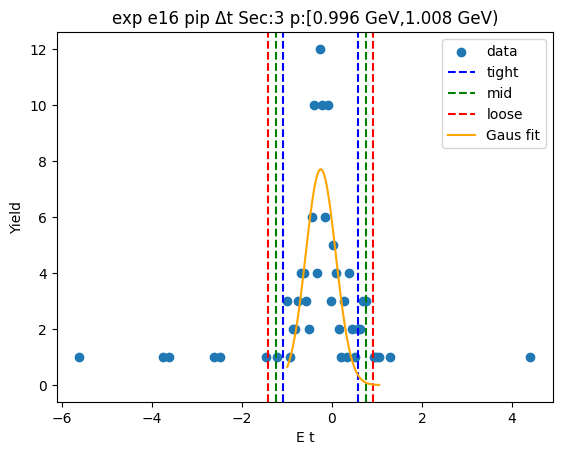

-1.3066262053992 1.006095647237938
-1.5378983906629136 1.2373678325016517
-1.7691705759266274 1.4686400177653656
[ 6.28217646 -0.15026528  0.46254437]


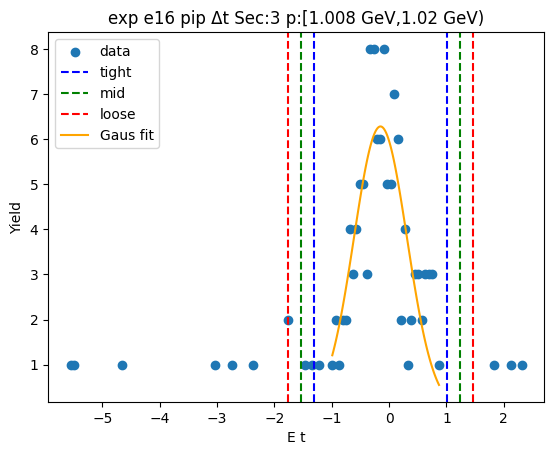

-1.4819151285592347 1.042723393368064
-1.7343789807519647 1.295187245560794
-1.9868428329446945 1.5476510977535238
[ 7.02924061 -0.21959587  0.5049277 ]


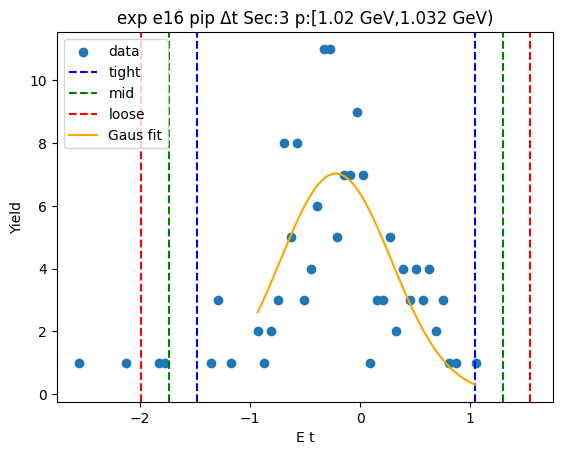

-1.1269869183686765 0.701598196664112
-1.3098454298719555 0.8844567081673911
-1.4927039413752343 1.06731521967067
[ 7.10275239 -0.21269436  0.36571702]


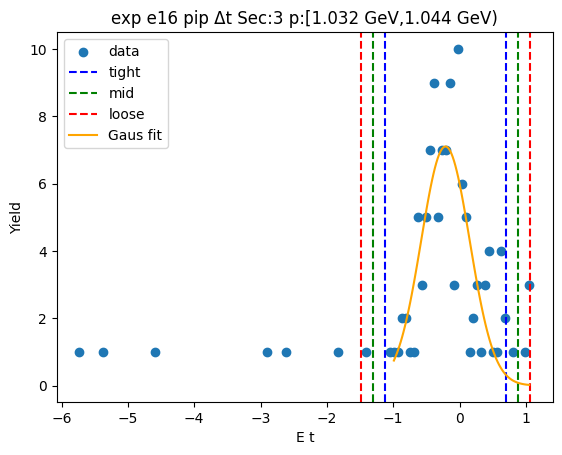

-1.4258532089955187 0.852135456814874
-1.653652075576558 1.0799343233959133
-1.8814509421575973 1.3077331899769526
[ 5.97750661 -0.28685888  0.45559773]


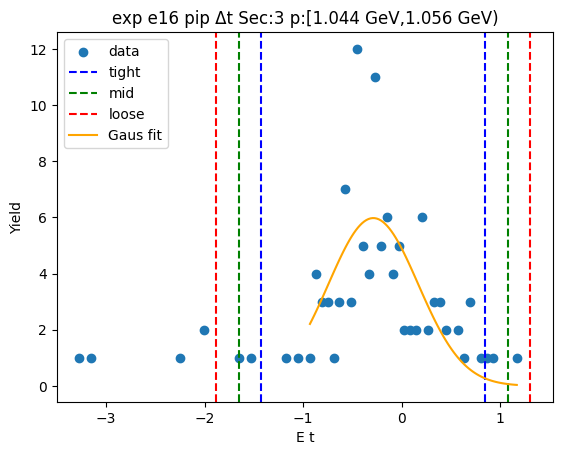

-1.2609318808945575 0.7177810910678635
-1.4588031780907997 0.9156523882641057
-1.6566744752870417 1.1135236854603476
[ 6.43271285 -0.27157539  0.39574259]


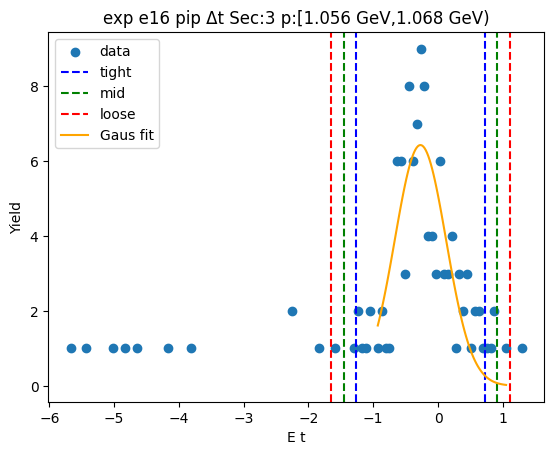

-1.5211360906943572 1.08374219760801
-1.7816239195245935 1.3442300264382467
-2.0421117483548303 1.604717855268483
[ 5.90572493 -0.21869695  0.52097566]


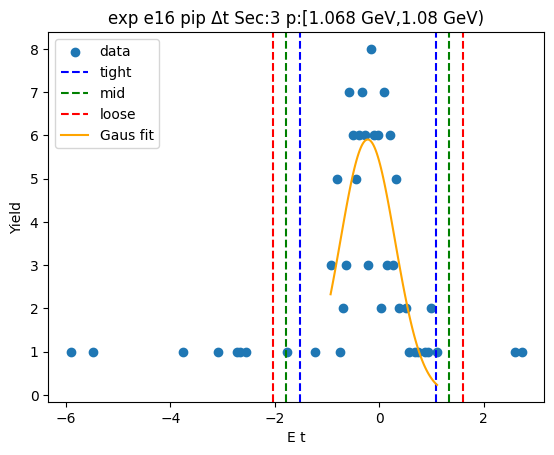

-1.4831414038919735 1.0828112793006555
-1.7397366722112362 1.3394065476199182
-1.9963319405304991 1.5960018159391811
[ 6.33728207 -0.20016506  0.51319054]


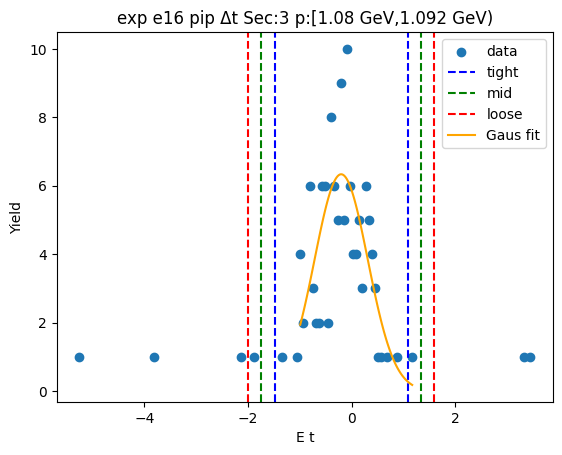

-1.5850528278653506 0.9862238296733921
-1.8421804936192248 1.2433514954272662
-2.099308159373099 1.5004791611811403
[ 5.22821905 -0.2994145   0.51425533]


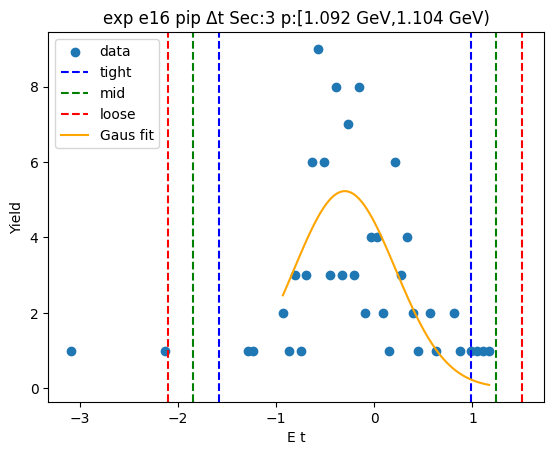

-1.0473353908007794 0.5328583655815387
-1.2053547664390112 0.6908777412197706
-1.3633741420772432 0.8488971168580024
[ 6.34393424 -0.25723851  0.31603875]


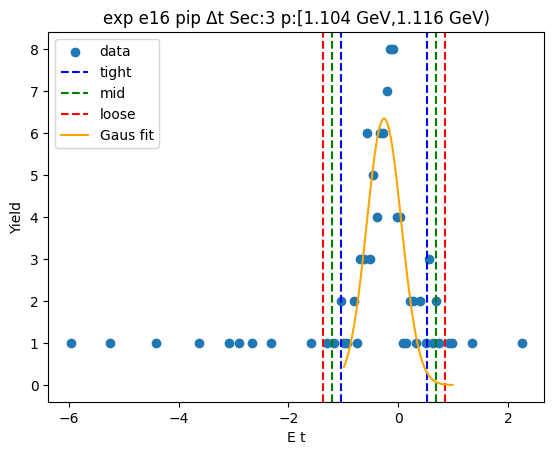

-1.3114897725457637 0.989683469257018
-1.5416070967260418 1.219800793437296
-1.77172442090632 1.4499181176175744
[ 5.5527021  -0.16090315  0.46023465]


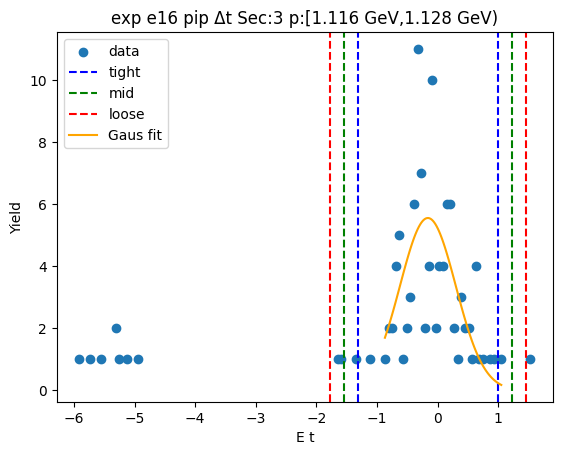

-1.2289385599479044 0.557072074270061
-1.407539623369701 0.7356731376918577
-1.5861406867914976 0.9142742011136542
[ 5.88303403 -0.33593324  0.35720213]


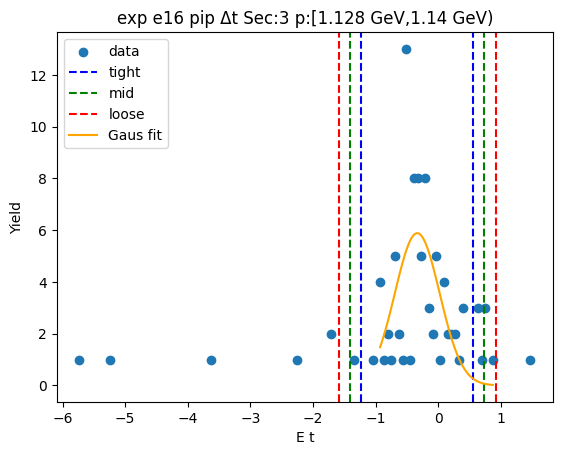

-1.1405018126510178 0.7274289739579513
-1.3272948913119147 0.9142220526188481
-1.5140879699728116 1.101015131279745
[ 6.97498543 -0.20653642  0.37358616]


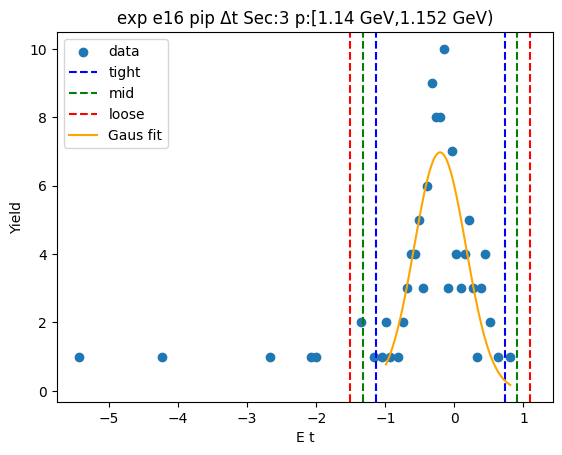

-1.5812442583549808 1.164886556007985
-1.8558573397912774 1.4394996374442817
-2.130470421227574 1.7141127188805783
[ 4.55821985 -0.20817885  0.54922616]


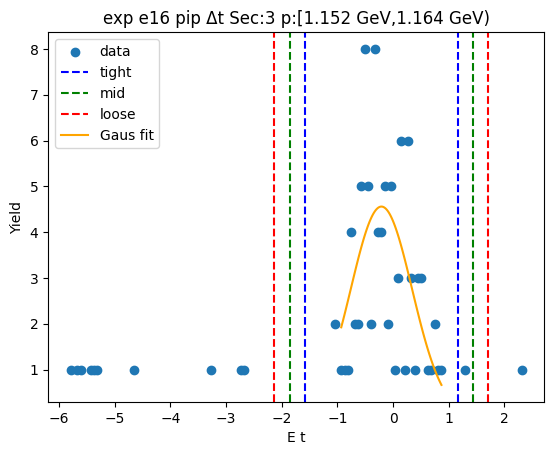

-1.550872753944179 1.0563872503336753
-1.8115987543719645 1.317113250761461
-2.07232475479975 1.5778392511892463
[ 5.7040603  -0.24724275  0.521452  ]


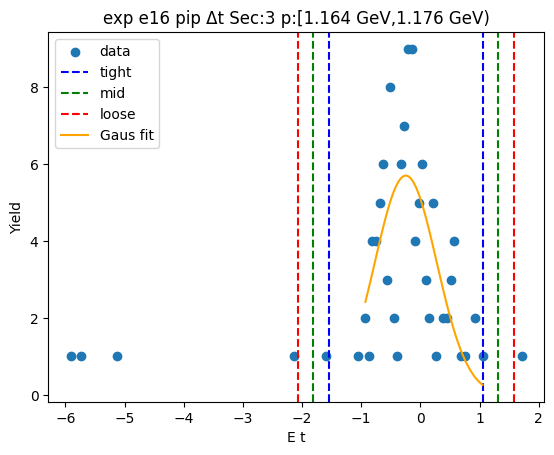

-1.43087225003799 1.123483860772135
-1.6863078611190023 1.3789194718531472
-1.9417434722000149 1.6343550829341598
[ 4.67193313 -0.15369419  0.51087122]


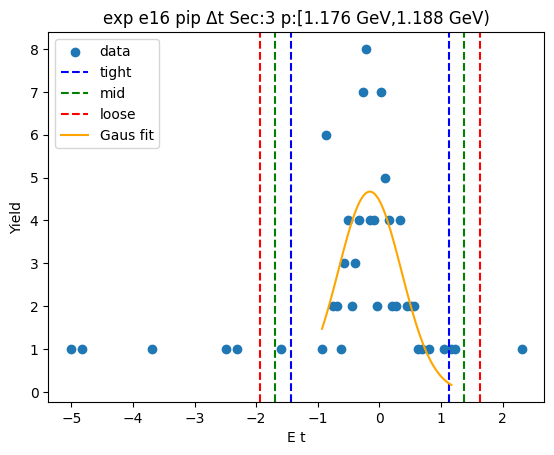

-1.726468758946852 1.141238326919155
-2.0132394675334524 1.4280090355057558
-2.300010176120053 1.7147797440923565
[ 4.07926759 -0.29261522  0.57354142]


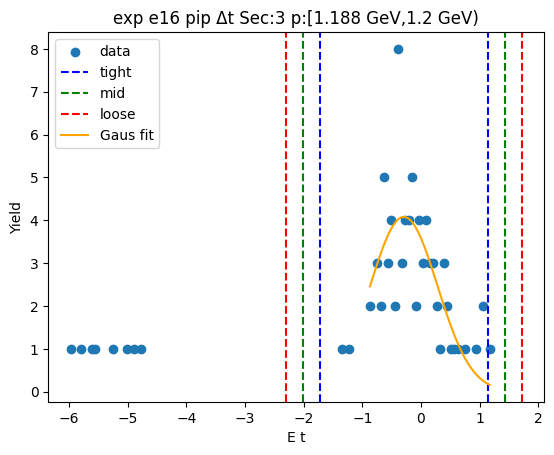

-1.4891731292360524 1.0111003180356277
-1.7392004739632205 1.2611276627627959
-1.9892278186903887 1.511155007489964
[ 4.85918031 -0.23903641  0.50005469]


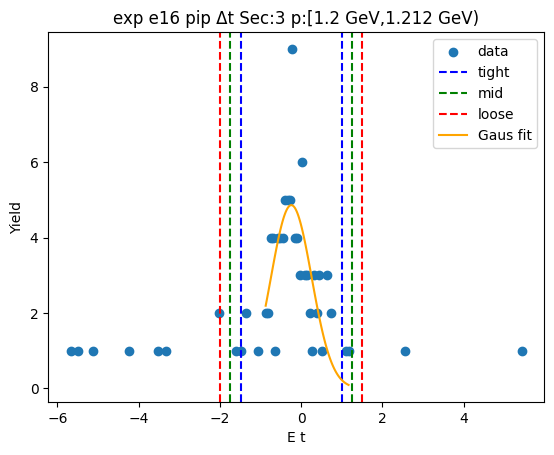

-1.4348346709189421 1.1127652499394127
-1.6895946630047778 1.3675252420252484
-1.9443546550906132 1.6222852341110838
[ 4.8027221  -0.16103471  0.50951998]


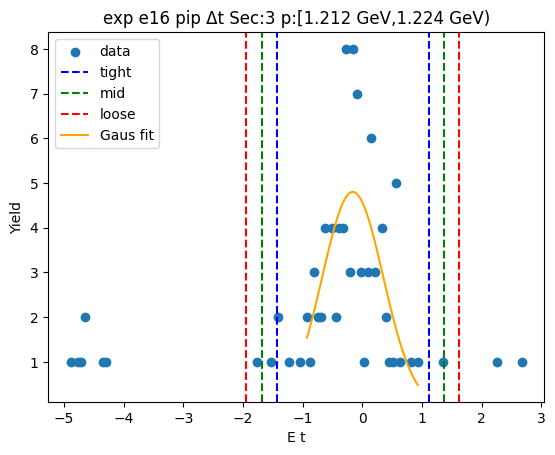

-1.1256555587077464 0.6639377631884509
-1.3046148908973663 0.8428970953780708
-1.483574223086986 1.0218564275676905
[ 5.78334253 -0.2308589   0.35791866]


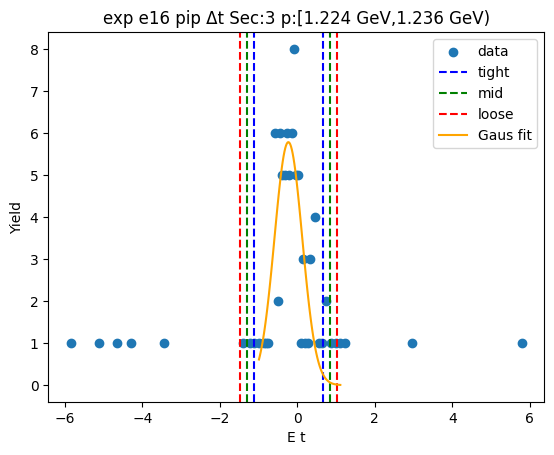

-1.24917286580188 0.8462432159245921
-1.458714473974527 1.0557848240972392
-1.6682560821471744 1.2653264322698865
[ 5.46491599 -0.20146482  0.41908322]


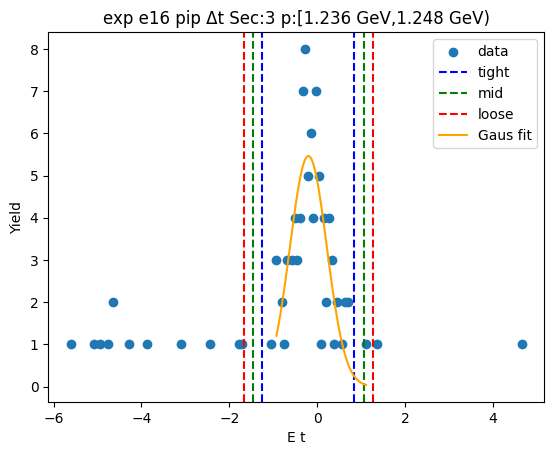

-1.2788870333190967 0.9231462929043129
-1.4990903659414379 1.1433496255266542
-1.7192936985637788 1.3635529581489951
[ 5.17003271 -0.17787037  0.44040667]


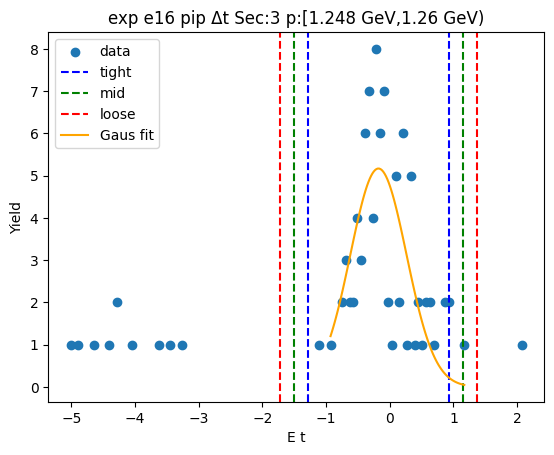

-1.2114851317869442 0.7697528598588073
-1.4096089309515194 0.9678766590233825
-1.6077327301160944 1.1660004581879575
[ 3.98911212 -0.22086614  0.3962476 ]


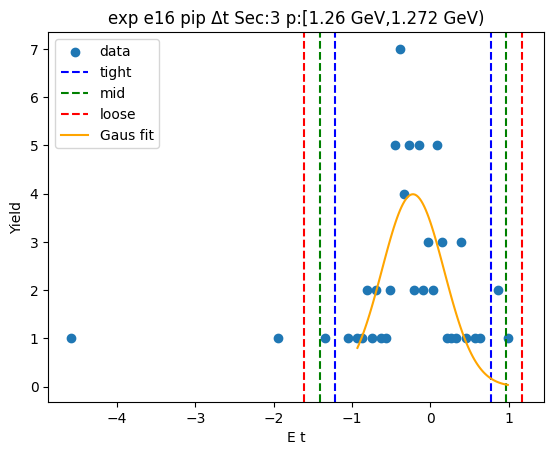

-1.55241859593875 1.2126697606030146
-1.8289274315929263 1.4891785962571908
-2.1054362672471028 1.7656874319113673
[ 4.08688666 -0.16987442  0.55301767]


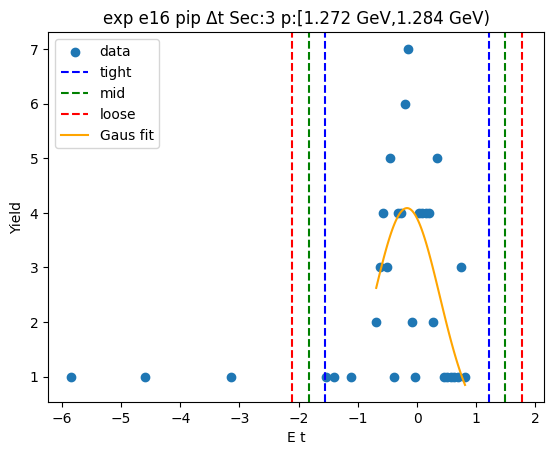

-1.1208767408683609 0.5282086615047579
-1.2857852811056727 0.6931172017420699
-1.4506938213429847 0.8580257419793818
[ 5.72302635 -0.29633404  0.32981708]


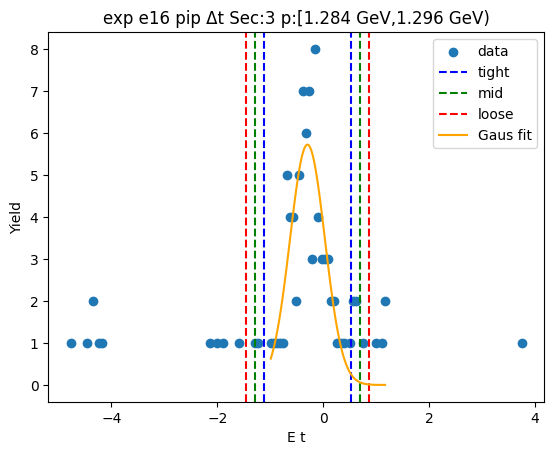

-1.6704724969589437 1.5197568039445823
-1.9894954270492962 1.8387797340349348
-2.308518357139649 2.1578026641252874
[ 3.98313503 -0.07535785  0.63804586]


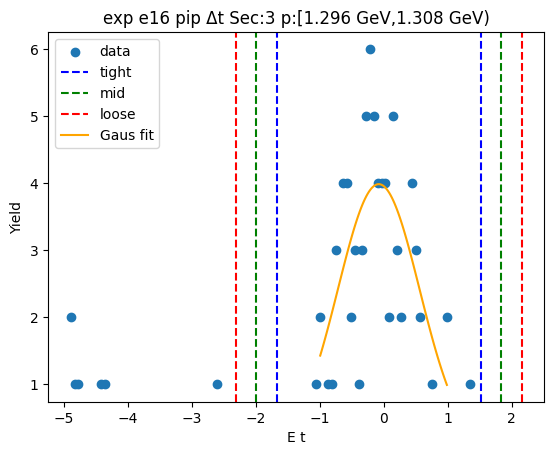

-1.2228772752780386 1.189701169154981
-1.4641351197213404 1.4309590135982828
-1.7053929641646424 1.6722168580415848
[ 3.3727846  -0.01658805  0.48251569]


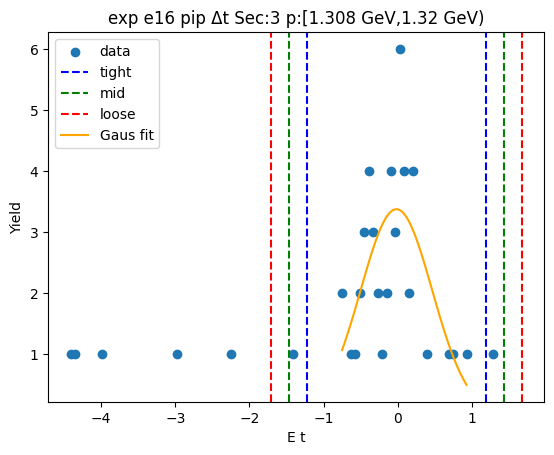

-1.267451076173181 0.9444456478108361
-1.4886407485715827 1.1656353202092378
-1.7098304209699844 1.3868249926076395
[ 4.26519242 -0.16150271  0.44237934]


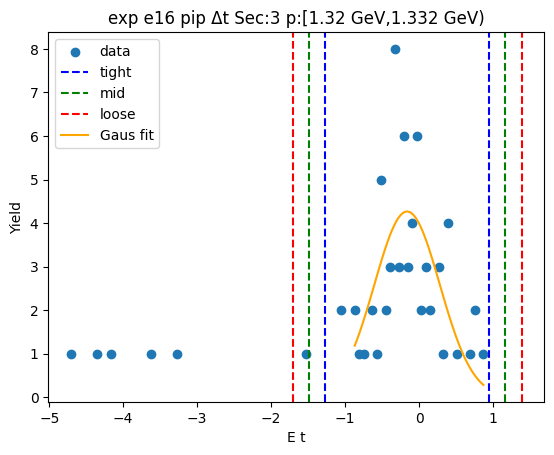

-1.47619159901689 1.0550674051520454
-1.7293174994337832 1.3081933055689392
-1.982443399850677 1.5613192059858325
[ 4.22343578 -0.2105621   0.5062518 ]


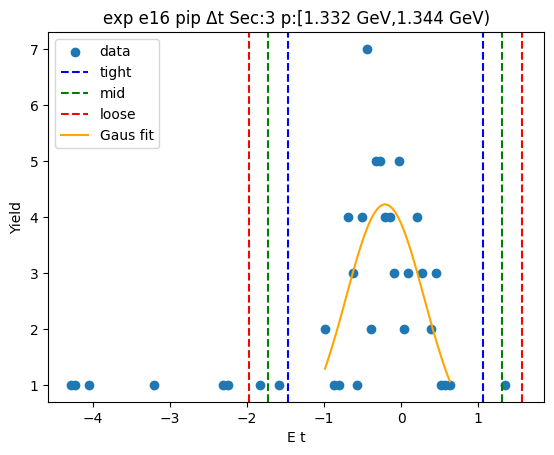

-1.392285335466028 1.0902981156480949
-1.6405436805774403 1.3385564607595075
-1.888802025688853 1.5868148058709197
[ 3.75663203 -0.15099361  0.49651669]


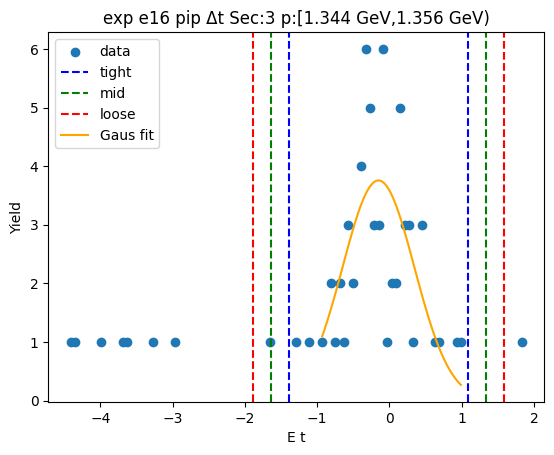

-1.7031750324035875 1.6020176234210333
-2.0336942979860497 1.9325368890034955
-2.3642135635685118 2.2630561545859575
[ 3.62226952 -0.0505787   0.66103853]


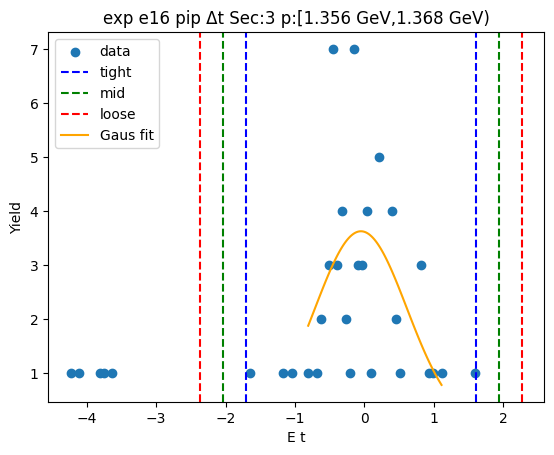

-1.3958362927939207 0.8508287247960382
-1.6205027945529167 1.0754952265550342
-1.8451692963119126 1.30016172831403
[ 2.99028952 -0.27250378  0.449333  ]


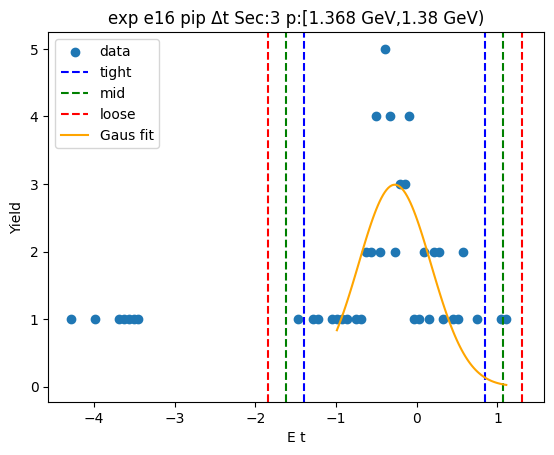

-1.2854816454162095 0.7811576464808654
-1.492145574605917 0.9878215756705728
-1.6988095037956243 1.1944855048602803
[ 4.16686753 -0.252162    0.41332786]


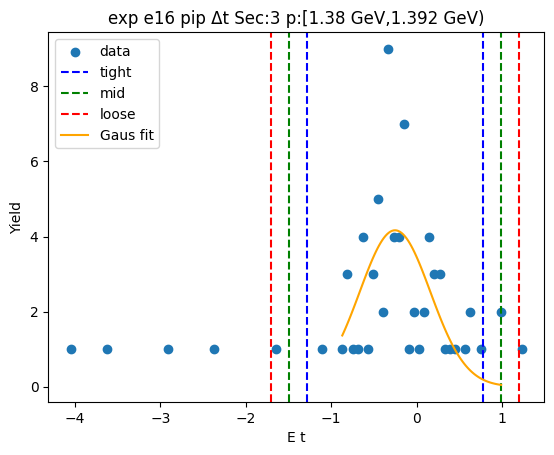

-1.7838549961094126 1.147118724545689
-2.076952368174923 1.4402160966111994
-2.370049740240433 1.7333134686767093
[ 3.46581374 -0.31836814  0.58619474]


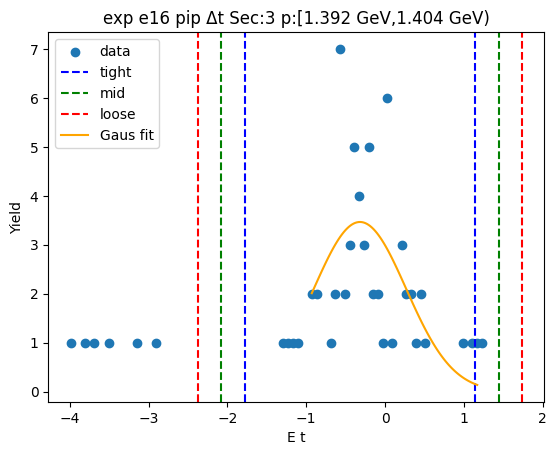

-1.3096613212941974 0.8323960252273375
-1.5238670559463507 1.0466017598794908
-1.7380727905985043 1.2608074945316443
[ 4.49338047 -0.23863265  0.42841147]


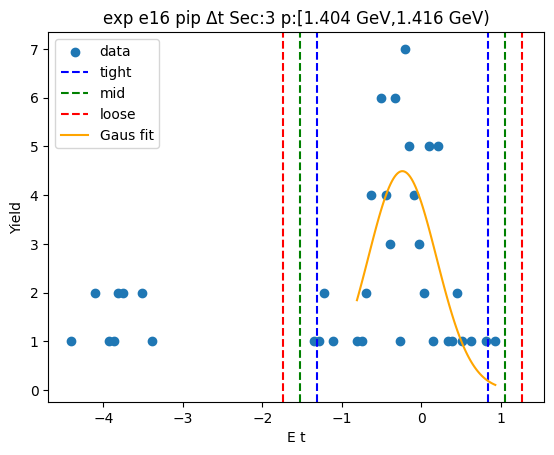

-1.0168343594519307 0.7914030649045919
-1.197658101887583 0.9722268073402441
-1.3784818443232352 1.1530505497758963
[ 3.87344574 -0.11271565  0.36164748]


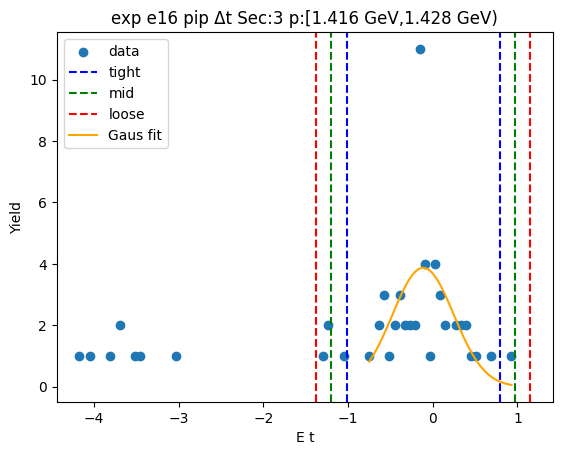

-1.191399584881537 0.7902002981130767
-1.3895595731809987 0.9883602864125381
-1.58771956148046 1.1865202747119994
[ 3.90236151 -0.20059964  0.39631998]


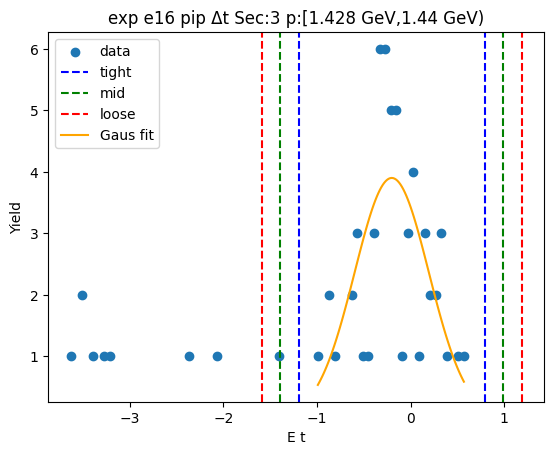

-1.6744070863260947 1.7803065802816325
-2.0198784529868674 2.125777946942405
-2.36534981964764 2.471249313603178
[2.84606535 0.05294975 0.69094273]


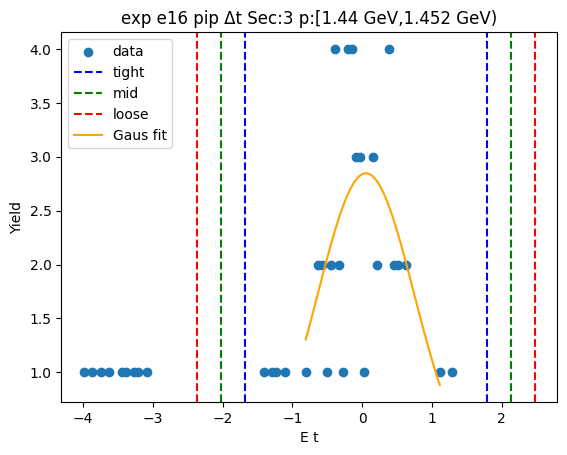

-1.2337993946124282 0.8134054280725941
-1.4385198768809302 1.018125910341096
-1.6432403591494325 1.2228463926095983
[ 3.71965004 -0.21019698  0.40944096]


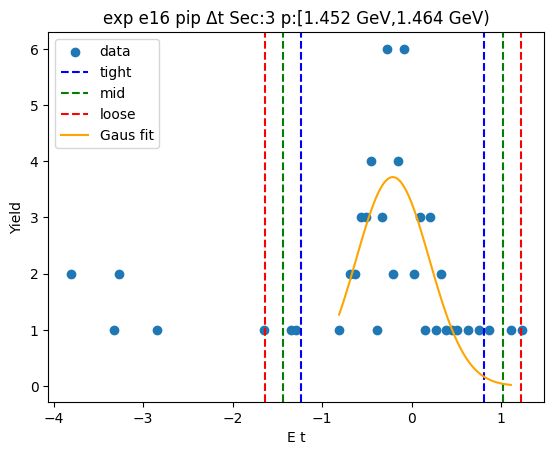

-1.2114444342710788 0.8399391544991563
-1.4165827931481023 1.0450775133761798
-1.6217211520251258 1.2502158722532033
[ 4.30826073 -0.18575264  0.41027672]


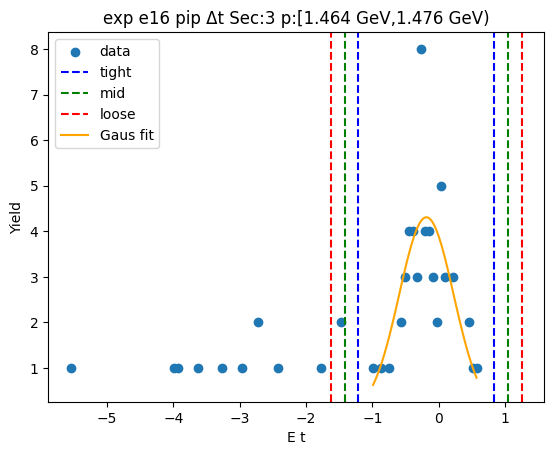

-1.34394109166414 0.8908203531044282
-1.5674172361409968 1.114296497581285
-1.7908933806178535 1.3377726420581417
[ 3.48653944 -0.22656037  0.44695229]


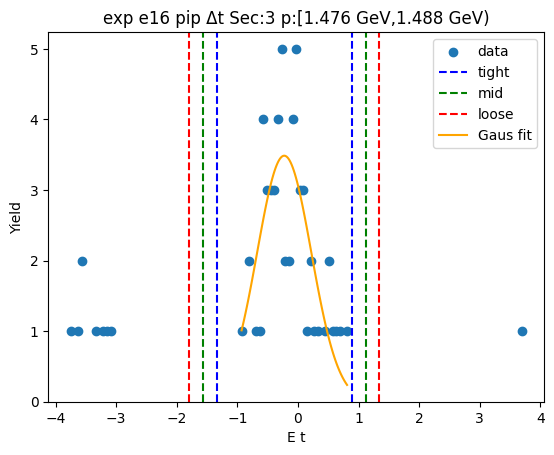

-1.1663266137645023 0.7592215787441089
-1.3588814330153633 0.9517763979949699
-1.5514362522662246 1.1443312172458313
[ 4.29135627 -0.20355252  0.38510964]


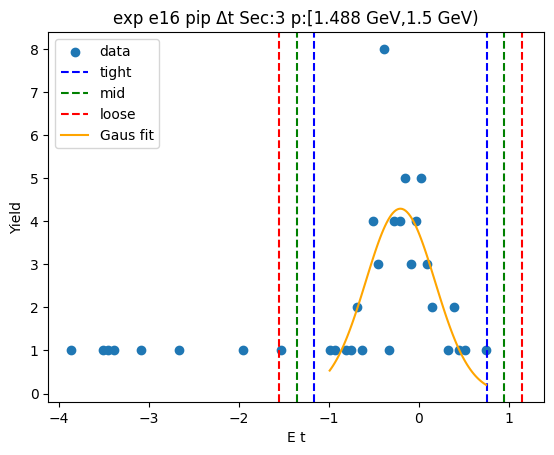

-1.953584477871067 1.455367168843415
-2.294479642542515 1.7962623335148633
-2.6353748072139633 2.1371574981863115
[ 4.29135627 -0.20355252  0.38510964]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_70472/557356721.py:14: RuntimeWarning: divide by zero encountered in divide
  return a_*np.exp(-(x-m_)*(x-m_)/(2*s_*s_))


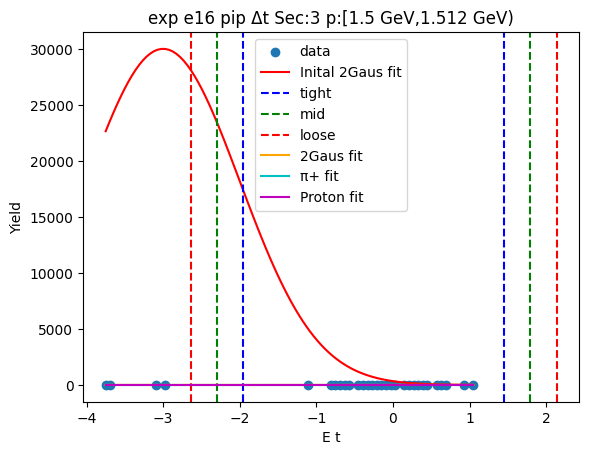

-0.7100923412014934 0.18273850780436574
-0.7993754261020795 0.27202159270495174
-0.8886585110026654 0.36130467760553764
[ 4.29135627 -0.20355252  0.38510964]


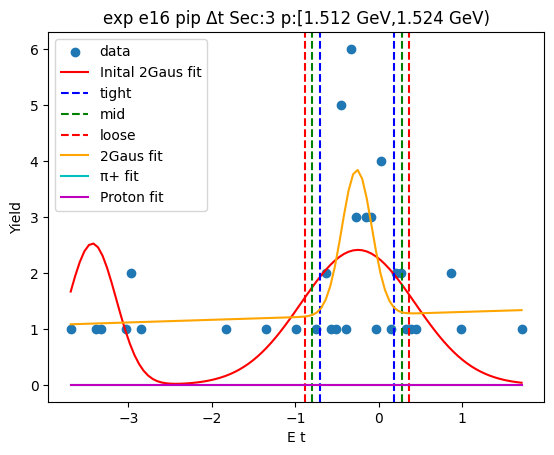

-0.3830744182699462 -0.39702720882876347
-0.3816791392140645 -0.3984224878846452
-0.3802838601581828 -0.3998177669405269
[ 4.29135627 -0.20355252  0.38510964]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_70472/3799154978.py:89: RuntimeWarning: invalid value encountered in scalar subtract
  sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]


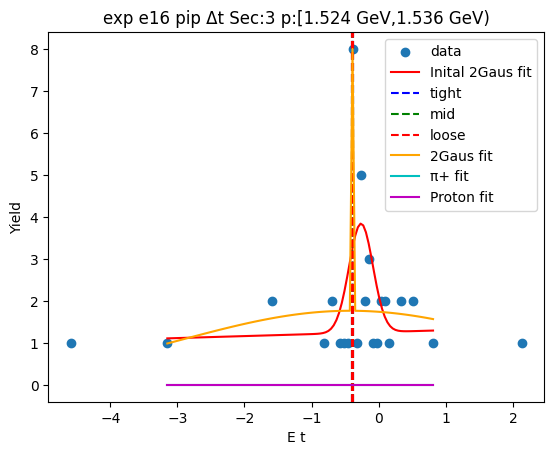

-0.38336895195200427 -0.6950330066999151
-0.35220254647721316 -0.7261994121747062
-0.32103614100242206 -0.7573658176494973
[ 4.29135627 -0.20355252  0.38510964]


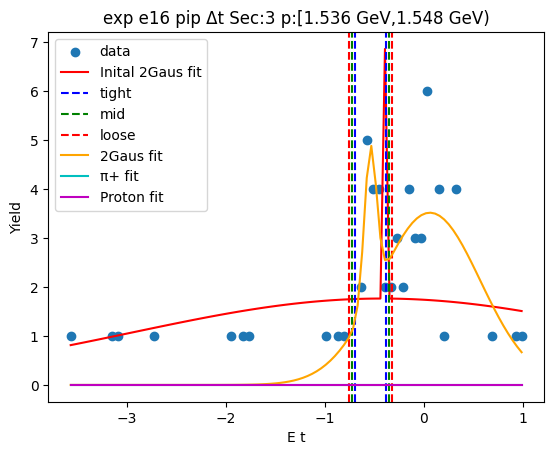

-0.2596600860755498 -0.33116494389313345
-0.25250960029379144 -0.3383154296748918
-0.2453591145120331 -0.3454659154566502
[ 4.29135627 -0.20355252  0.38510964]


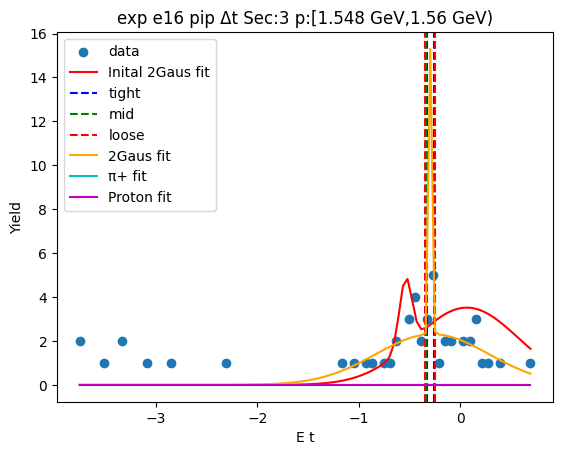

-0.26823712417017065 -0.28853712951951516
-0.2662071236352362 -0.2905671300544496
-0.2641771231003017 -0.2925971305893841
[ 4.29135627 -0.20355252  0.38510964]


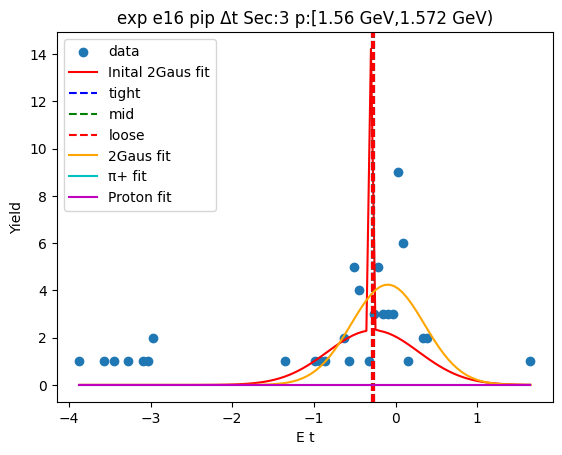

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


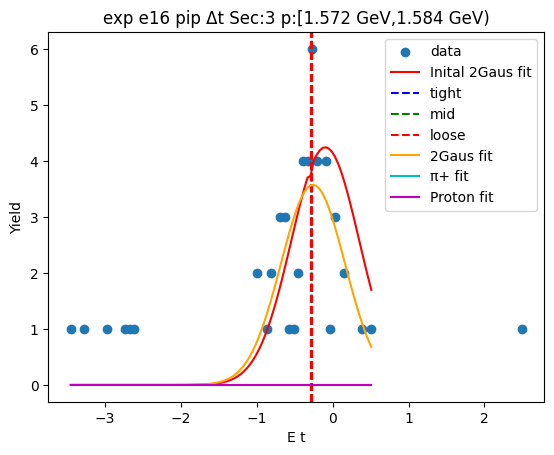

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


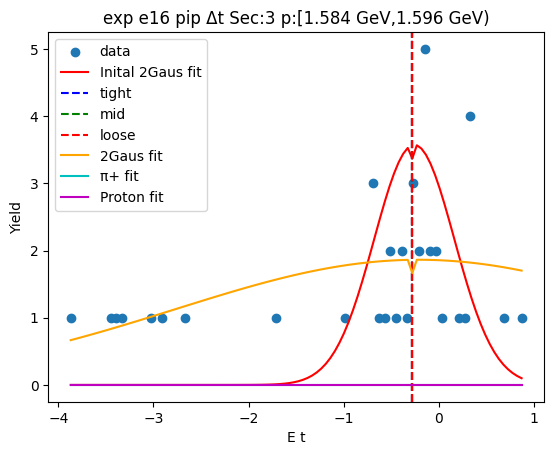

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


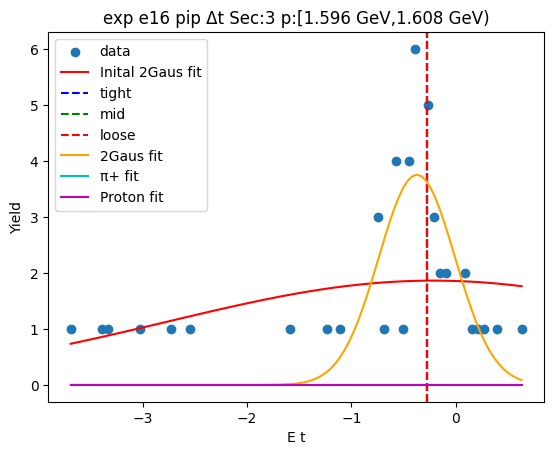

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


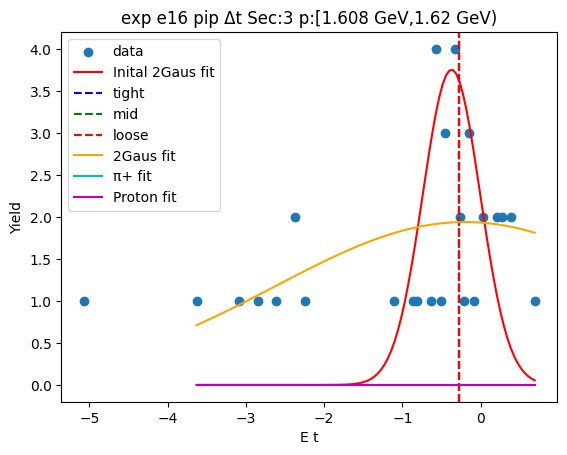

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


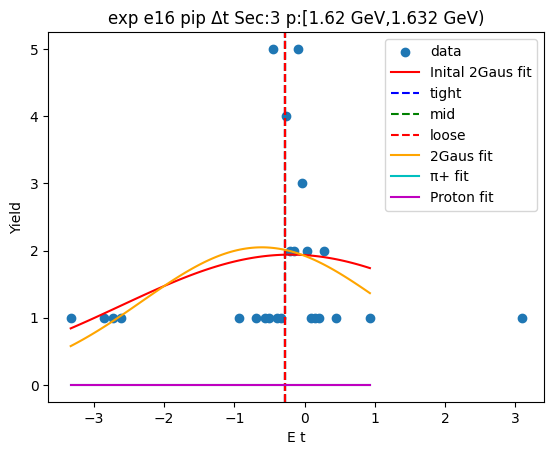

Runtime Error
[ 4.29135627 -0.20355252  0.38510964]


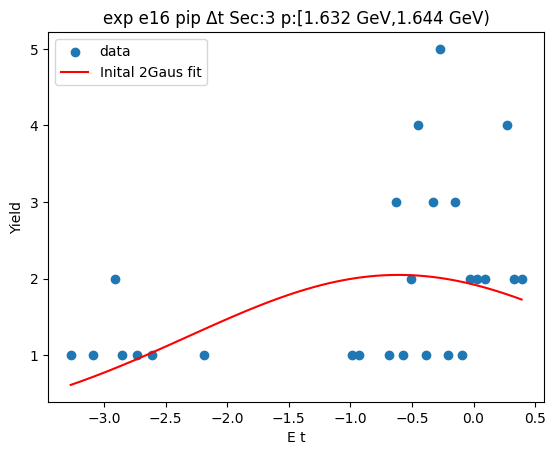

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


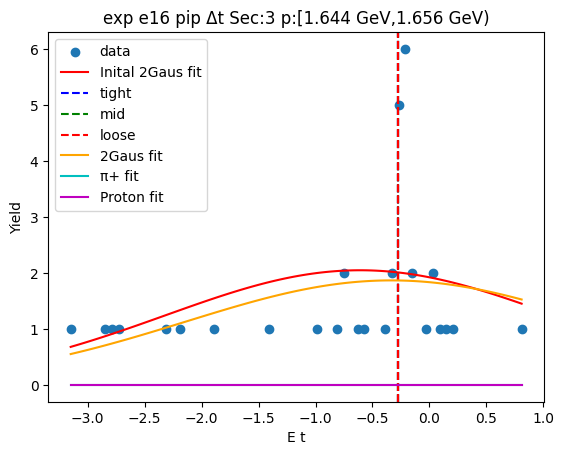

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


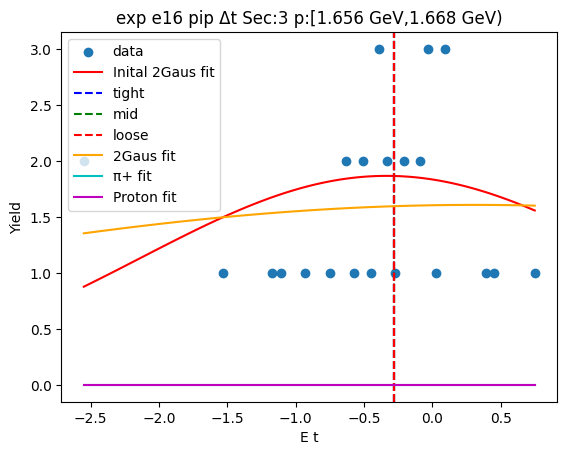

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


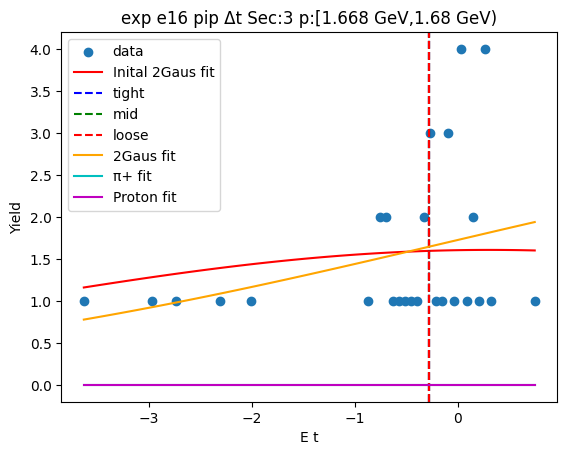

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


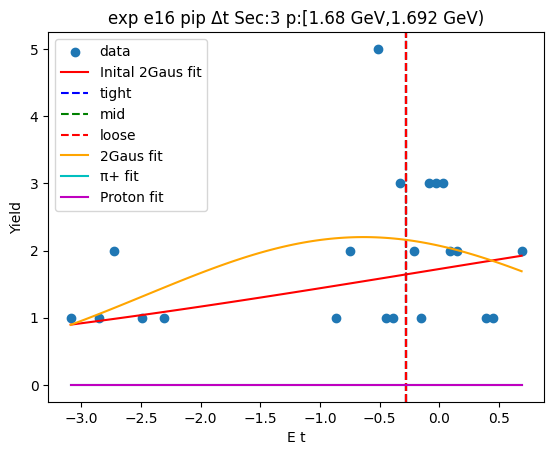

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


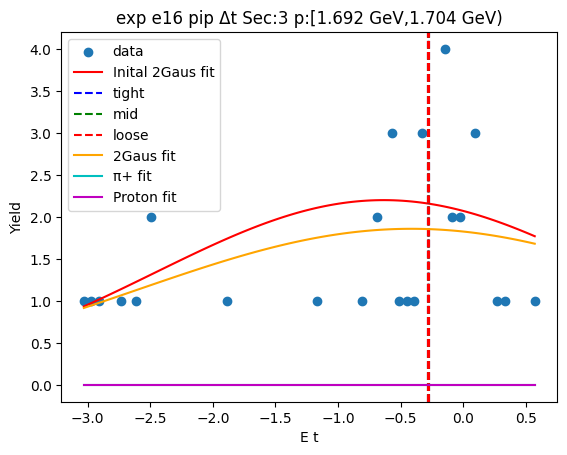

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


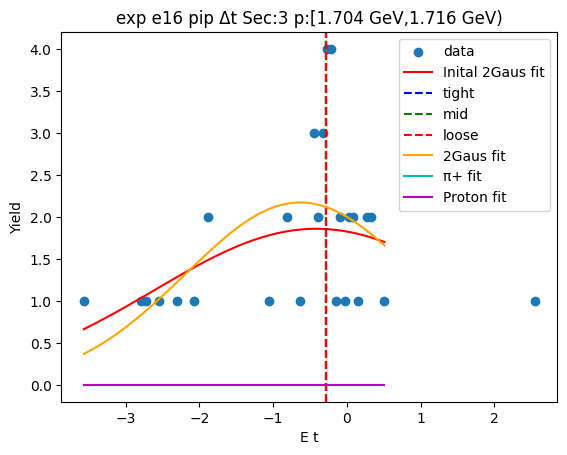

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


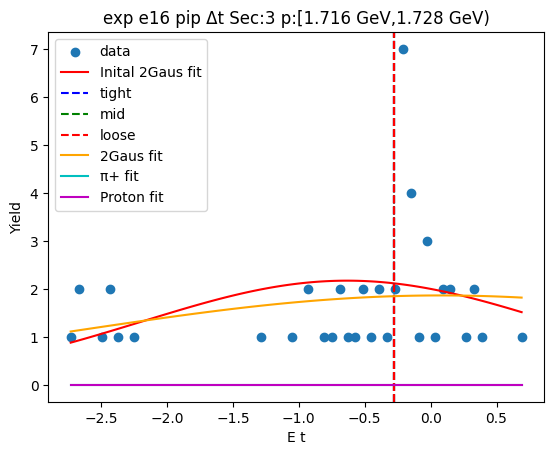

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


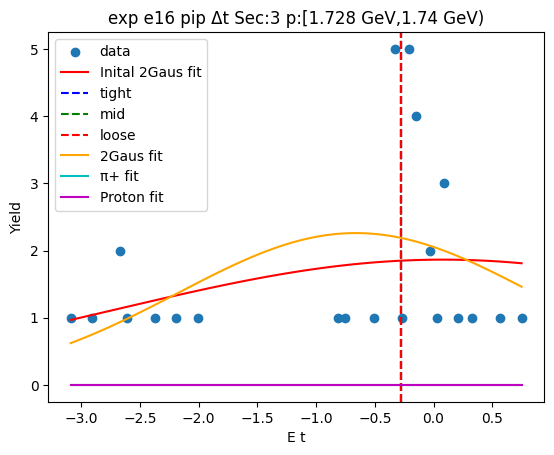

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


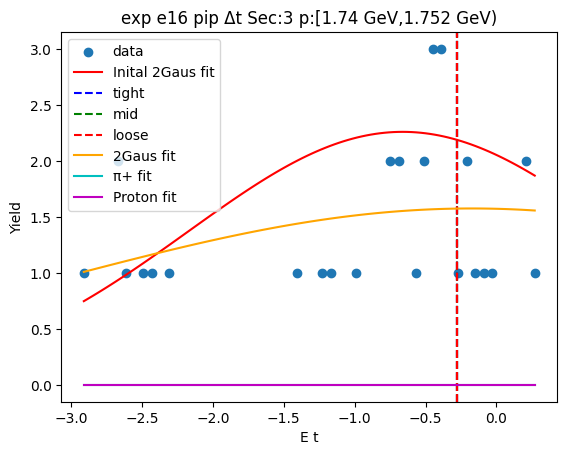

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


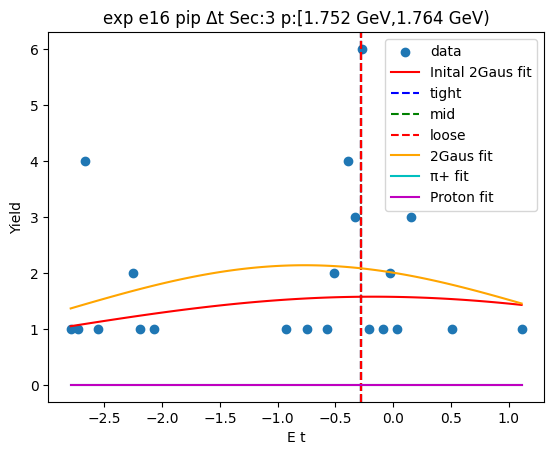

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


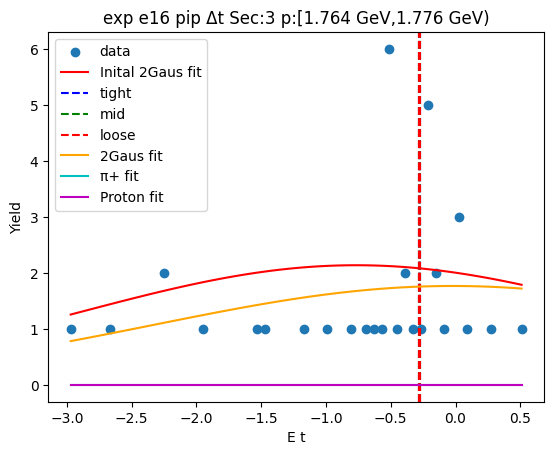

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


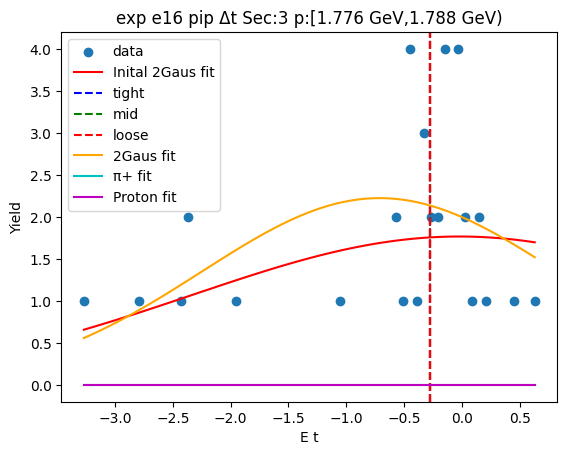

Runtime Error
[ 4.29135627 -0.20355252  0.38510964]


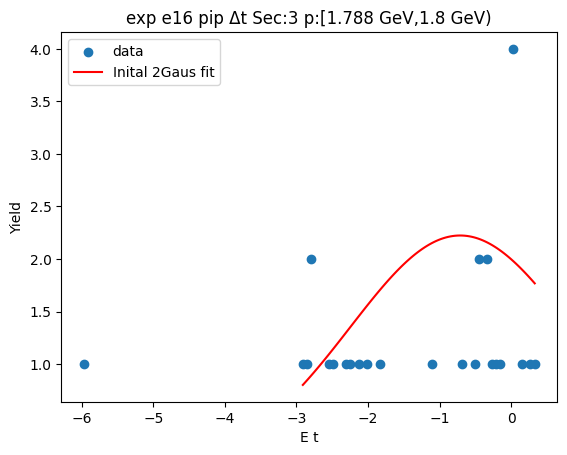

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


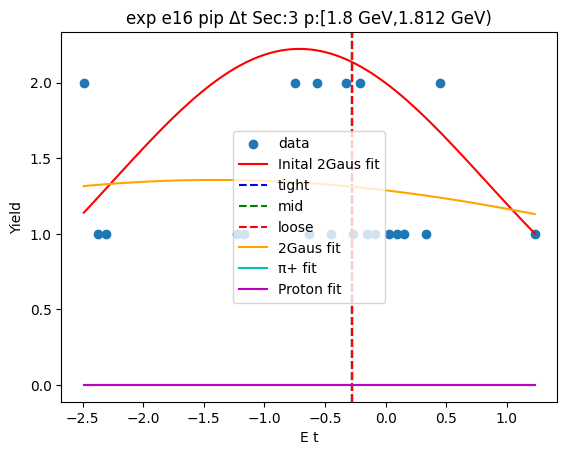

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


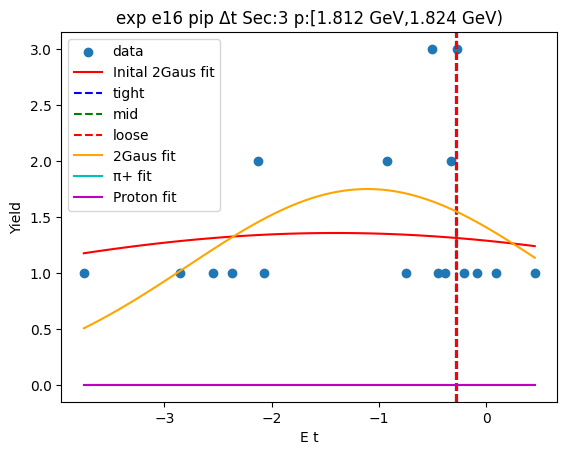

Runtime Error
[ 4.29135627 -0.20355252  0.38510964]


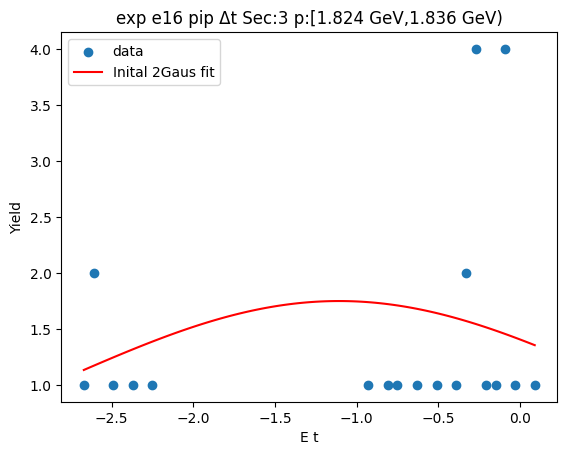

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


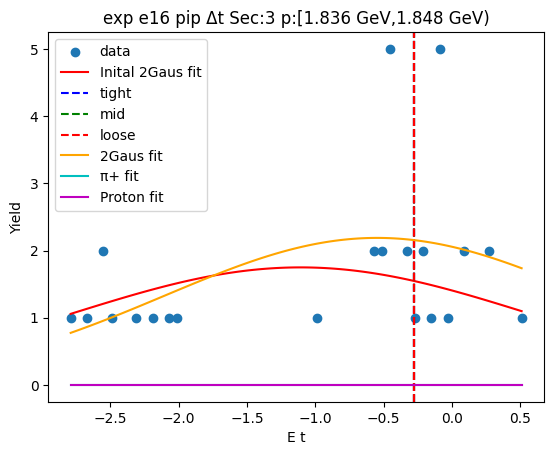

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


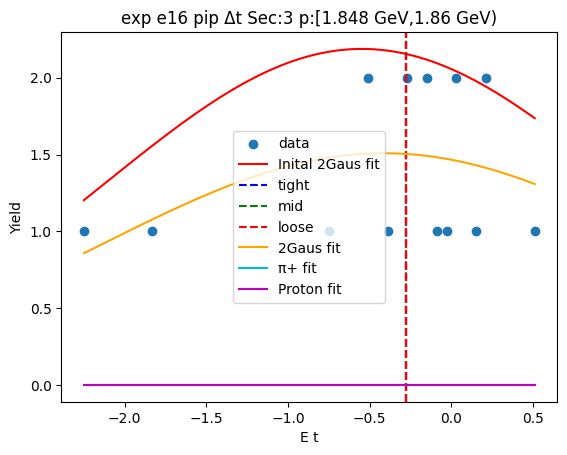

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


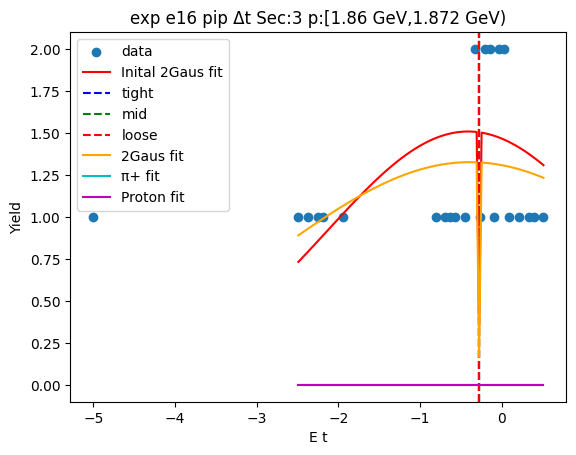

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


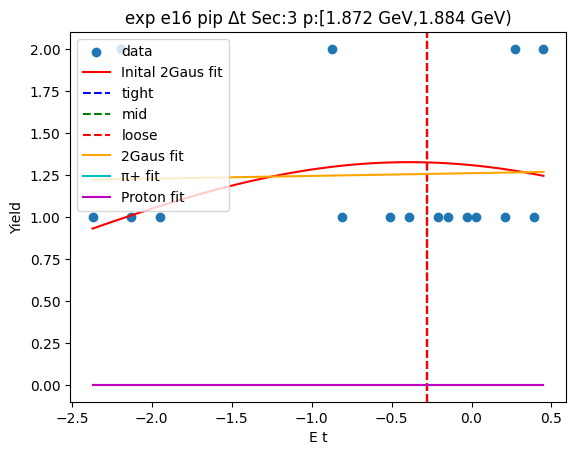

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


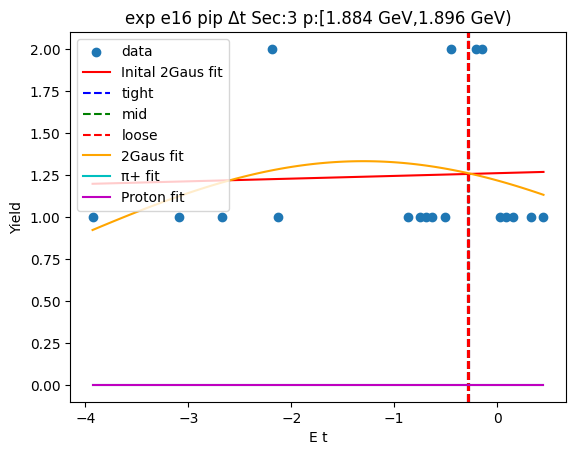

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


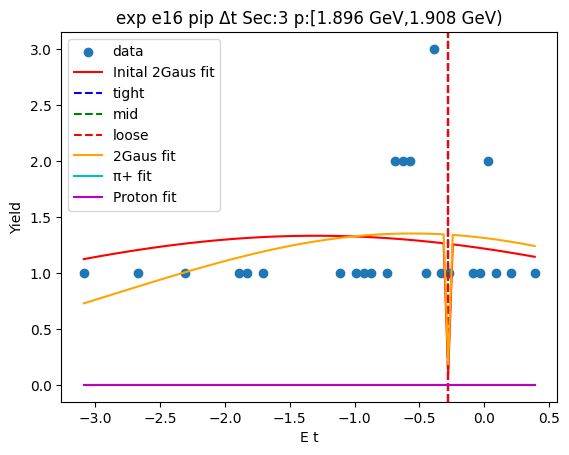

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


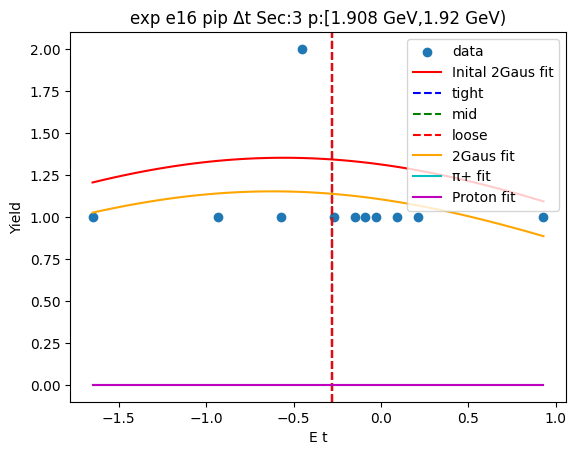

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


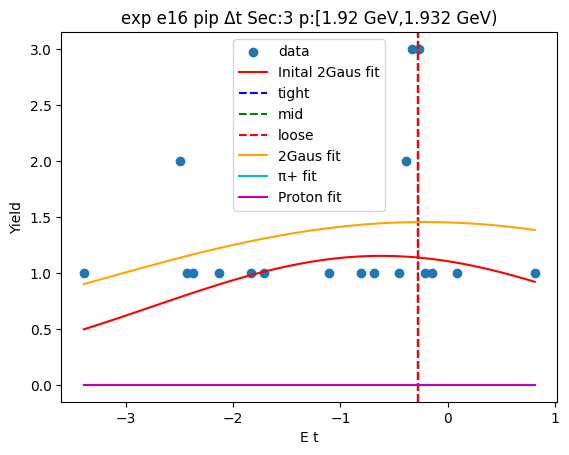

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


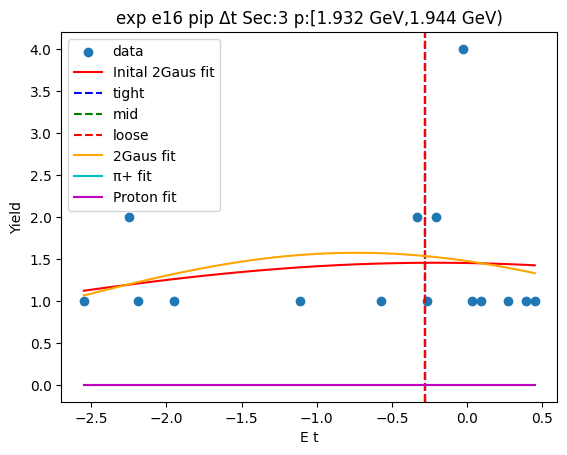

Runtime Error
[ 4.29135627 -0.20355252  0.38510964]


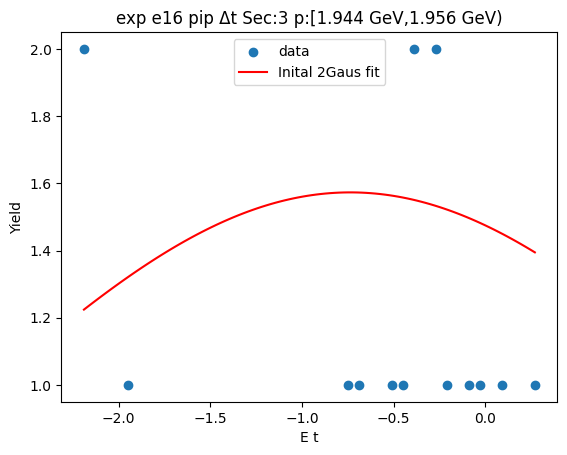

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


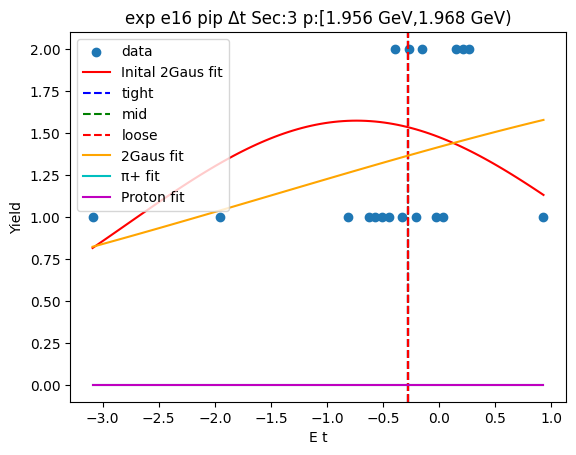

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


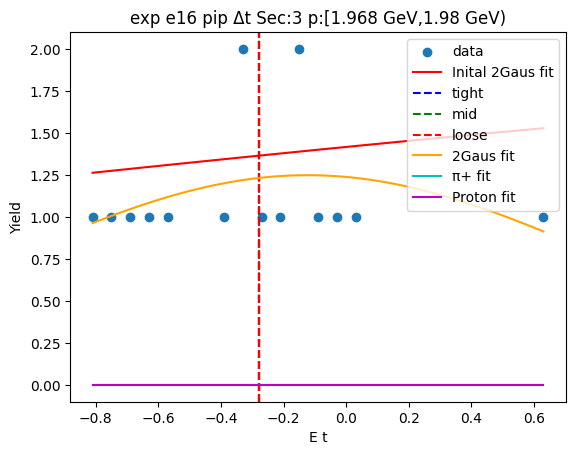

Runtime Error
[ 4.29135627 -0.20355252  0.38510964]


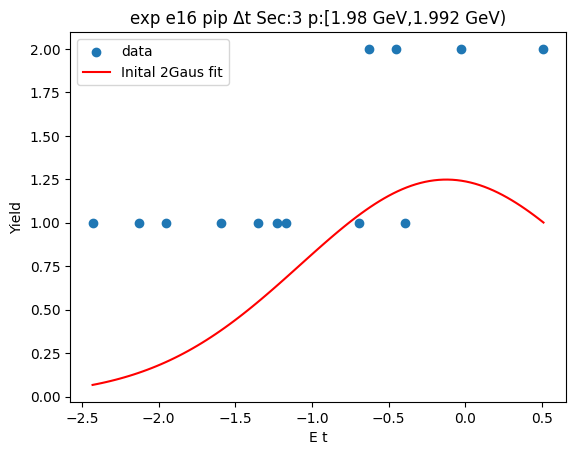

-0.277738757721919 -0.2790354959677668
-0.27760908389733424 -0.27916516979235156
-0.27747941007274946 -0.27929484361693635
[ 4.29135627 -0.20355252  0.38510964]


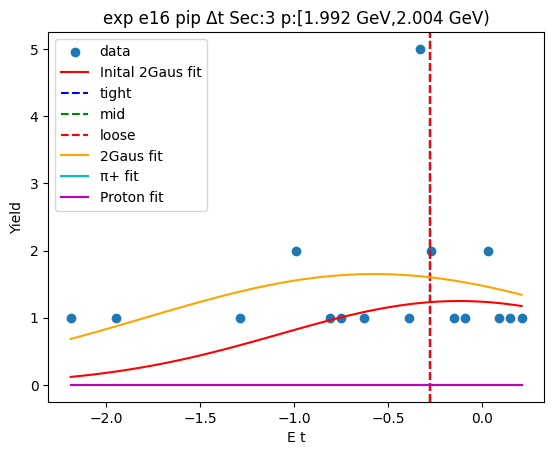

-1.2739976465997698 0.6906486208797674
-1.4704622733477233 0.887113247627721
-1.666926900095677 1.0835778743756748
[31.21926891 -0.29167451  0.39292925]


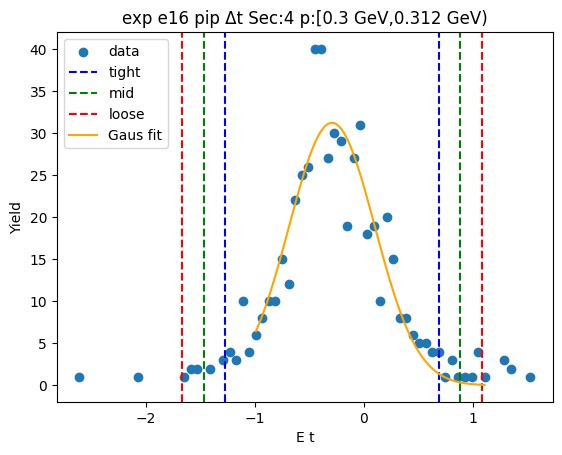

-1.349186120446947 0.740570206070965
-1.5581617530987386 0.9495458387227563
-1.7671373857505297 1.1585214713745473
[28.99390595 -0.30430796  0.41795127]


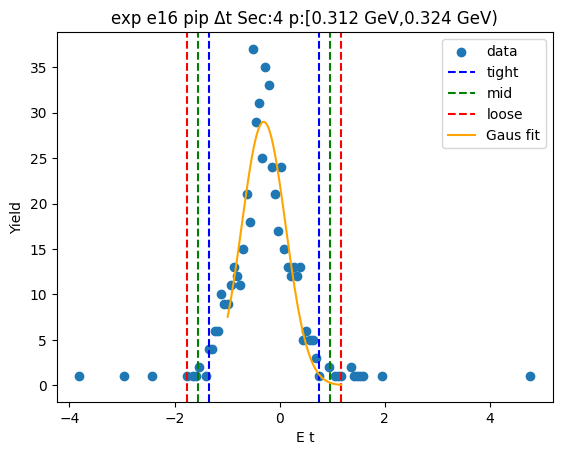

-1.5968971862349615 0.8478302065471373
-1.8413699255131712 1.092302945825347
-2.0858426647913815 1.336775685103557
[26.56414539 -0.37453349  0.48894548]


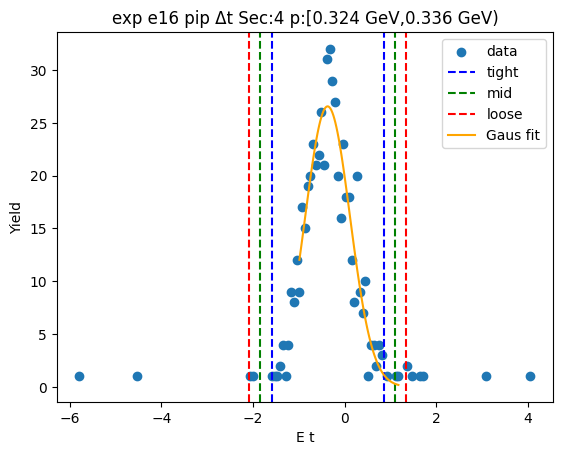

-1.3605578216494223 0.6753711470873309
-1.5641507185230976 0.8789640439610062
-1.767743615396773 1.0825569408346816
[34.02354762 -0.34259334  0.40718579]


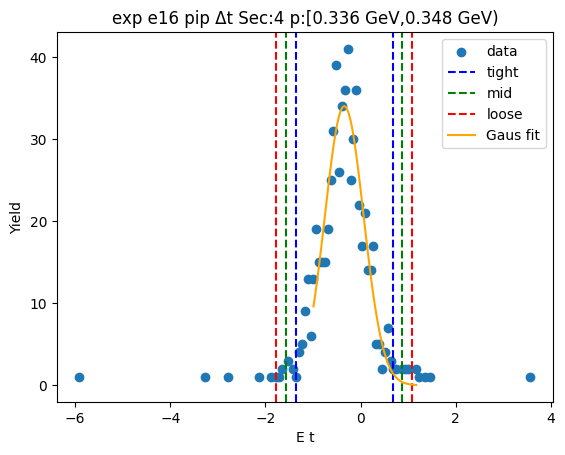

-1.557945584514591 0.7324653341308758
-1.7869866763791378 0.9615064259954225
-2.0160277682436845 1.1905475178599692
[33.02246472 -0.41274013  0.45808218]


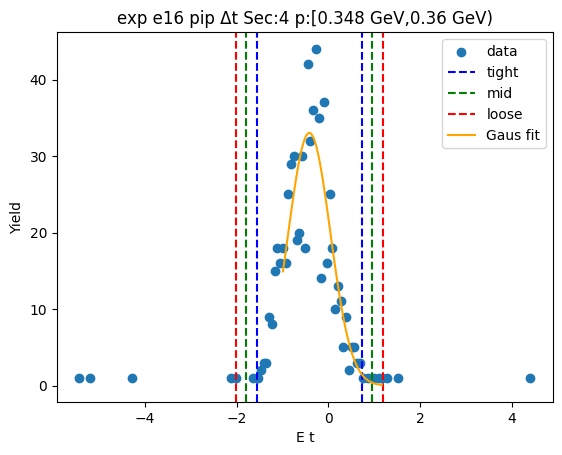

-1.5591269799269185 0.8010444492692852
-1.7951441228465388 1.0370615921889055
-2.0311612657661593 1.273078735108526
[31.95381002 -0.37904127  0.47203429]


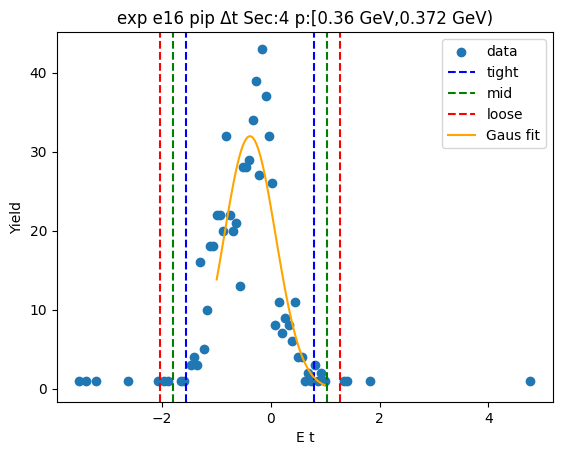

-1.5191718248491517 0.6203137268456795
-1.733120380018635 0.8342622820151628
-1.947068935188118 1.048210837184646
[32.08428926 -0.44942905  0.42789711]


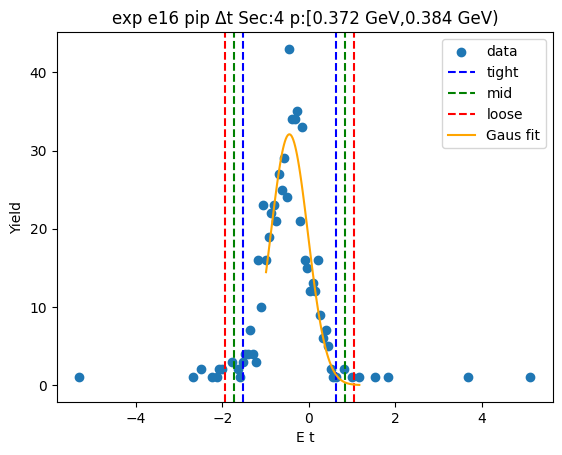

-1.8025175722707 0.6943337734832152
-2.0522027068460913 0.9440189080586067
-2.301887841421483 1.1937040426339984
[32.46737712 -0.5540919   0.49937027]


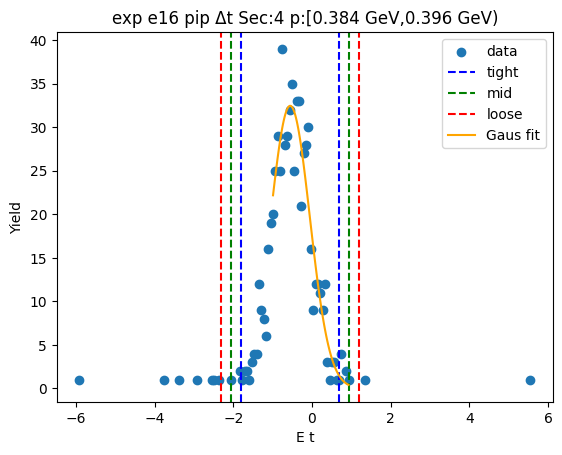

-1.7355479731060142 0.5986485276123628
-1.968967623177852 0.8320681776842005
-2.2023872732496894 1.0654878277560382
[33.15370658 -0.56844972  0.4668393 ]


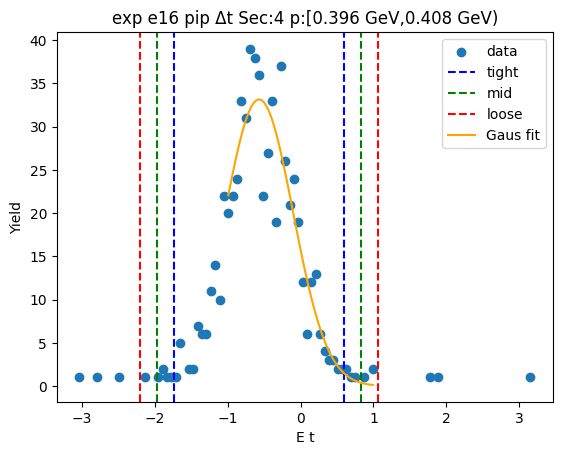

-2.2250101986502964 0.7848097181350222
-2.525992190328828 1.0857917098135539
-2.82697418200736 1.3867737014920858
[34.69978704 -0.72010024  0.60196398]


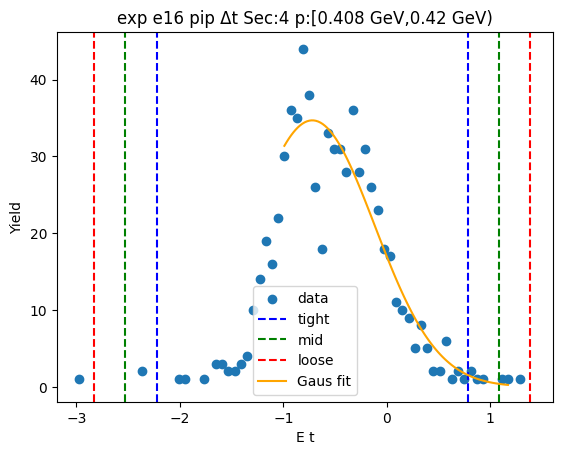

-2.3864930585373862 1.1054663471624326
-2.735688999107368 1.4546622877324147
-3.08488493967735 1.8038582283023965
[30.3287805  -0.64051336  0.69839188]


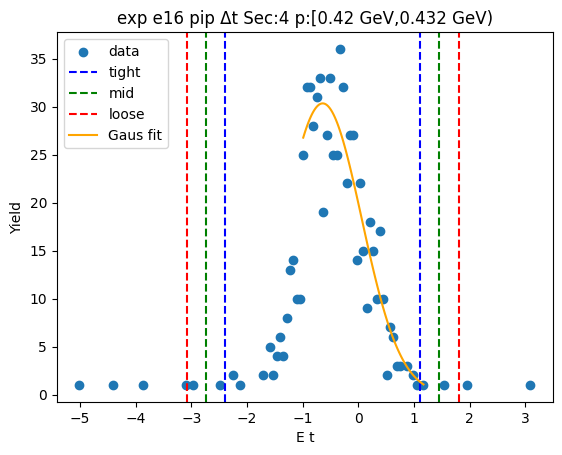

-2.6398819441711496 1.2637102705939718
-3.030241165647662 1.6540694920704837
-3.4206003871241744 2.044428713546996
[29.04569514 -0.68808584  0.78071844]


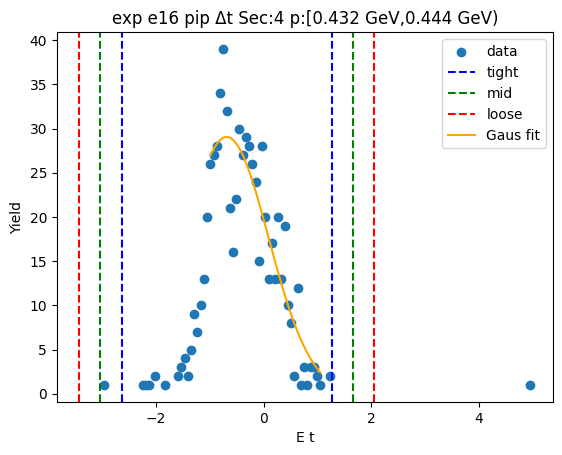

-2.755778930246283 1.5096741109498903
-3.1823242343659004 1.9362194150695073
-3.608869538485518 2.3627647191891246
[28.53089343 -0.62305241  0.85309061]


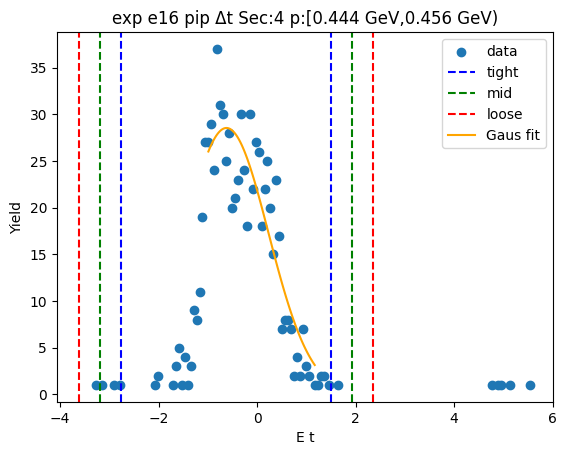

-2.7860713054790915 1.5448236558931692
-3.2191608016163173 1.977913152030395
-3.652250297753543 2.4110026481676208
[27.76946306 -0.62062382  0.86617899]


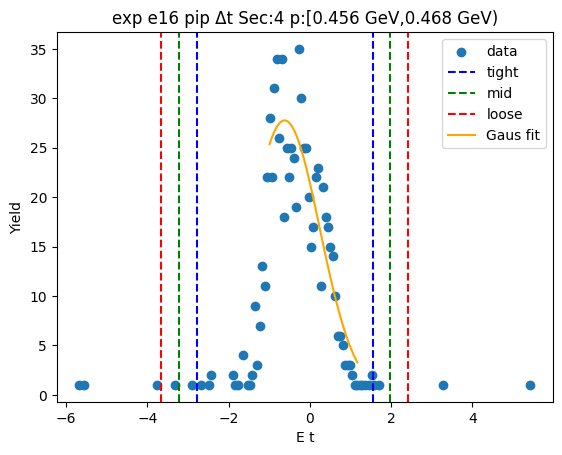

-2.2638285726230687 1.5287315071684935
-2.6430845806022245 1.9079875151476497
-3.0223405885813808 2.287243523126806
[25.96778203 -0.36754853  0.75851202]


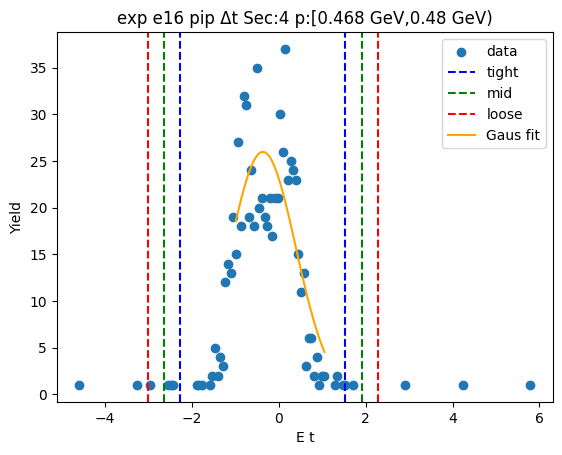

-2.484259314650683 1.6440380813202402
-2.8970890542477754 2.056867820917333
-3.3099187938448678 2.469697560514425
[27.53500873 -0.42011062  0.82565948]


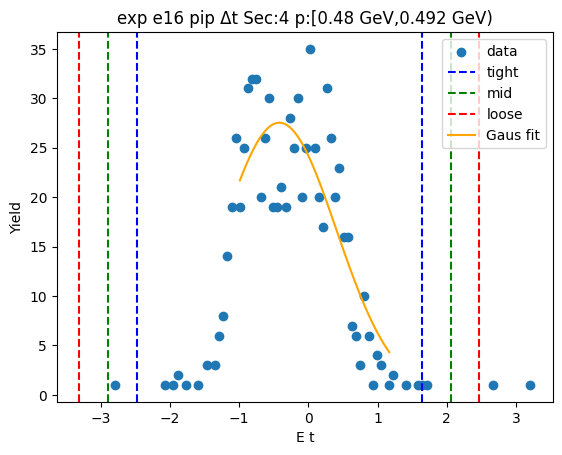

-3.2008460056963526 1.8561834577472438
-3.706548952040712 2.3618864040916034
-4.212251898385072 2.867589350435963
[28.73887029 -0.67233127  1.01140589]


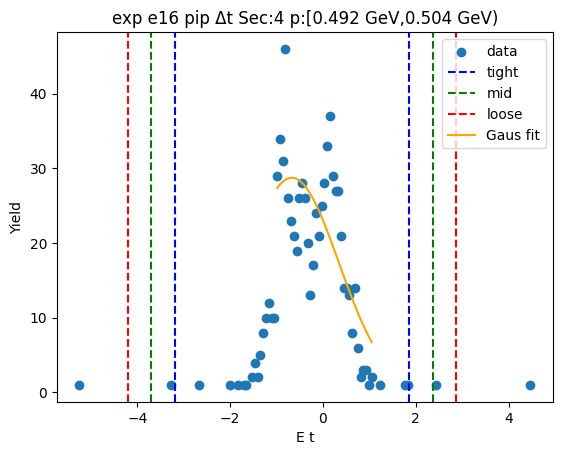

-2.2697975520997833 1.733212613420827
-2.670098568651844 2.133513629972888
-3.0703995852039054 2.533814646524949
[25.53450176 -0.26829247  0.80060203]


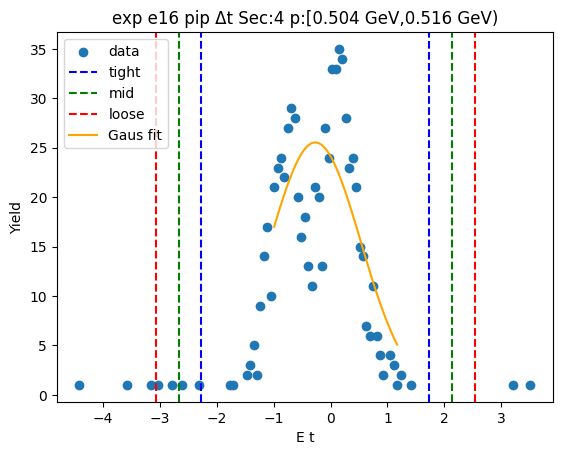

-1.8806851294745999 1.4754061994515169
-2.2162942623672115 1.8110153323441287
-2.551903395259823 2.1466244652367403
[29.01090239 -0.20263947  0.67121827]


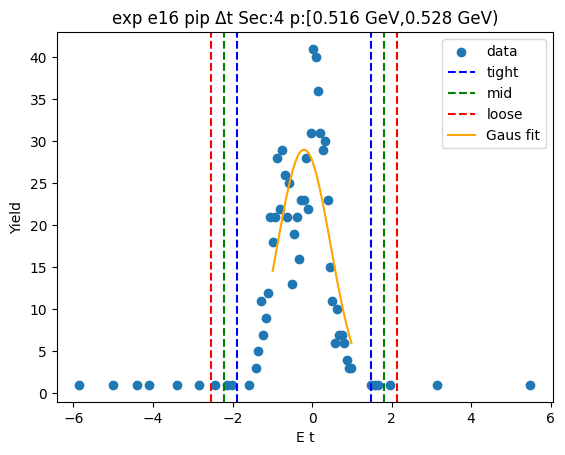

-1.581529252444826 1.3604953264701327
-1.8757317103363216 1.6546977843616284
-2.169934168227818 1.9489002422531245
[31.76220137 -0.11051696  0.58840492]


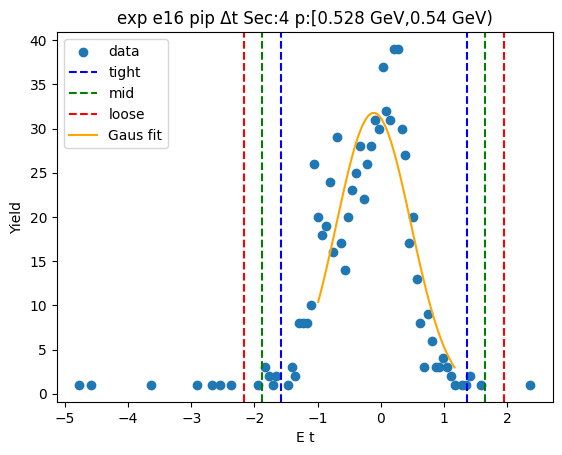

-1.8808717724371569 1.6054444049688987
-2.229503390177763 1.9540760227095046
-2.5781350079183682 2.30270764045011
[28.10135865 -0.13771368  0.69726324]


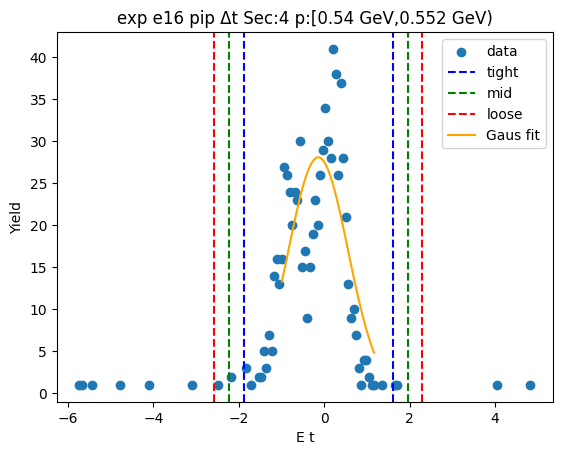

-1.427745301346693 1.403197530354116
-1.7108395845167739 1.6862918135241969
-1.9939338676868548 1.9693860966942778
[ 3.21129150e+01 -1.22738855e-02  5.66188566e-01]


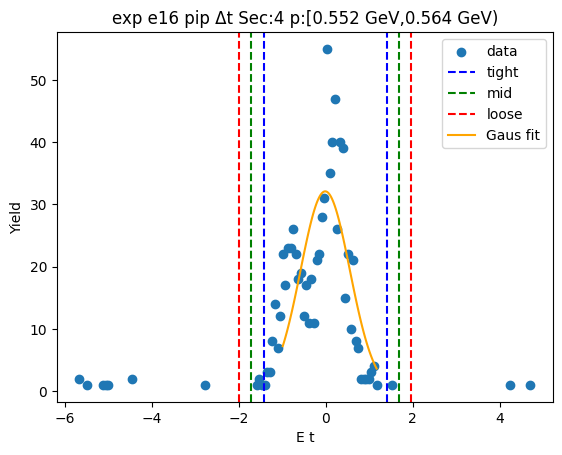

-0.9540812160689023 1.1321583083354096
-1.1627051685093335 1.3407822607758408
-1.3713291209497647 1.549406213216272
[41.49887555  0.08903855  0.4172479 ]


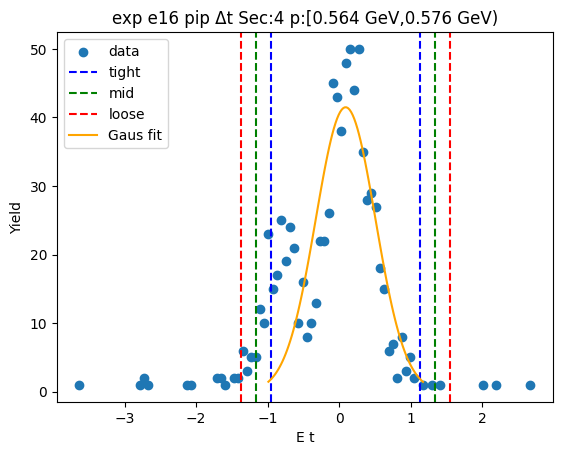

-1.4053856672573892 1.3584784135657753
-1.6817720753397059 1.6348648216480919
-1.9581584834220223 1.9112512297304083
[ 3.36003408e+01 -2.34536268e-02  5.52772816e-01]


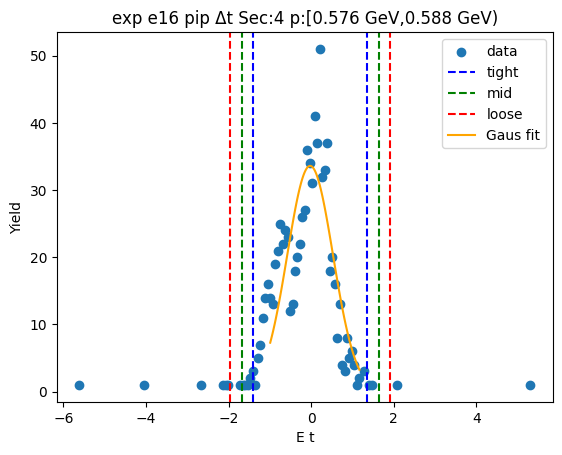

-1.7723890949198298 1.4958065993539478
-2.099208664347208 1.8226261687813257
-2.4260282337745855 2.1494457382087035
[29.97664609 -0.13829125  0.65363914]


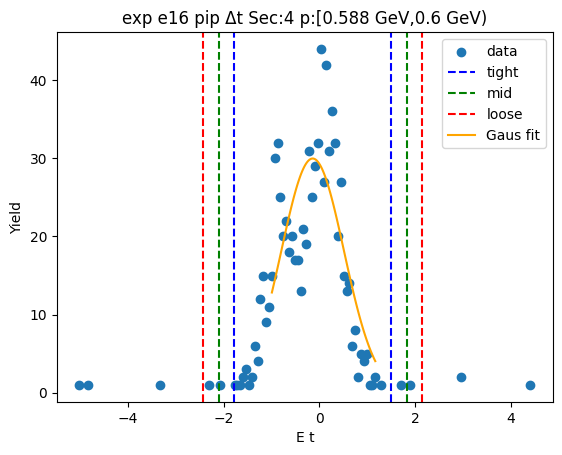

-1.5626055810083874 1.384032247562086
-1.857269363865435 1.6786960304191336
-2.151933146722482 1.9733598132761807
[33.035775   -0.08928667  0.58932757]


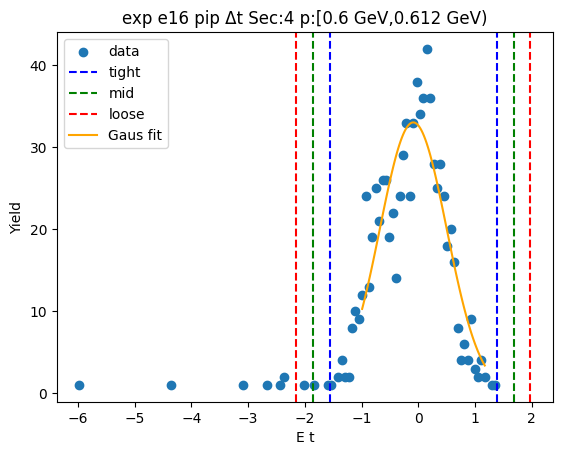

-1.4228265776741773 1.2626675034355366
-1.6913759857851487 1.531216911546508
-1.95992539389612 1.7997663196574794
[33.65667677 -0.08007954  0.53709882]


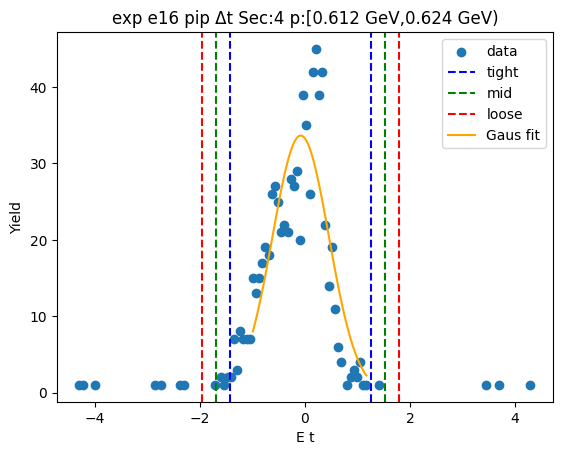

-1.487639177213403 1.288734054277535
-1.7652765003624966 1.5663713774266286
-2.0429138235115905 1.8440087005757224
[34.03714487 -0.09945256  0.55527465]


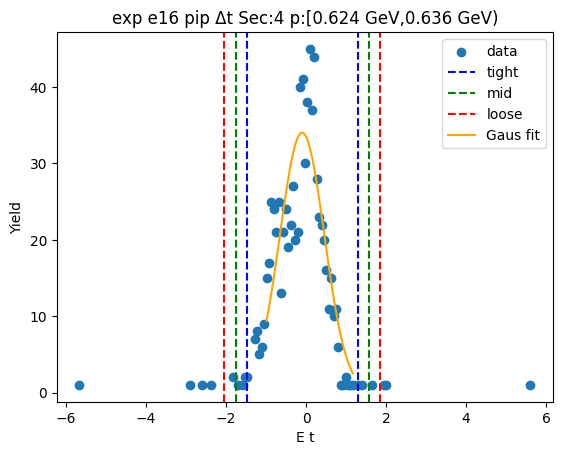

-1.4506040640678528 1.323711245499738
-1.728035595024612 1.6011427764564972
-2.0054671259813714 1.8785743074132564
[31.6542078  -0.06344641  0.55486306]


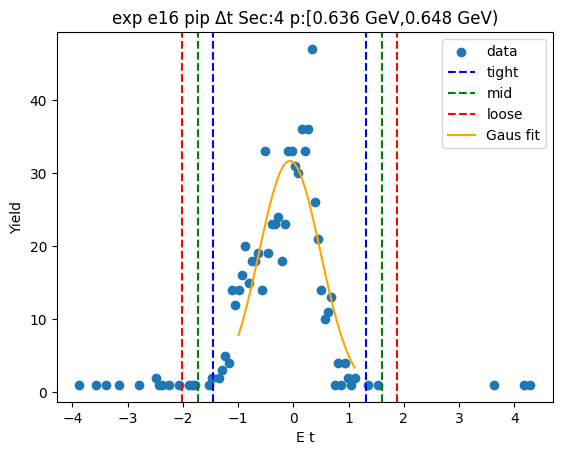

-1.2976084273173132 1.19048335690482
-1.5464176057395265 1.4392925353270334
-1.7952267841617398 1.6881017137492467
[33.81589207 -0.05356254  0.49761836]


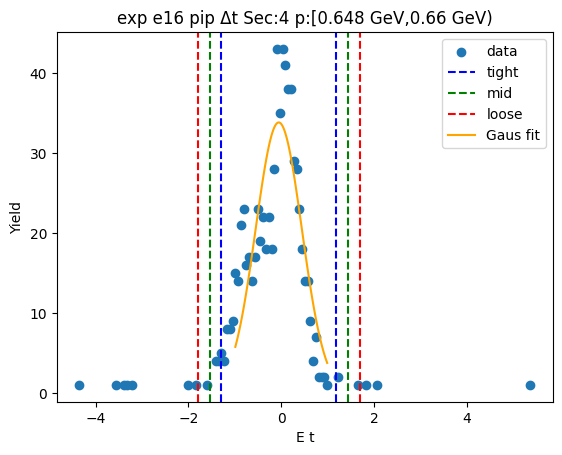

-1.43261520626509 1.2258069002364804
-1.6984574169152473 1.4916491108866377
-1.9642996275654043 1.7574913215367947
[32.30267397 -0.10340415  0.53168442]


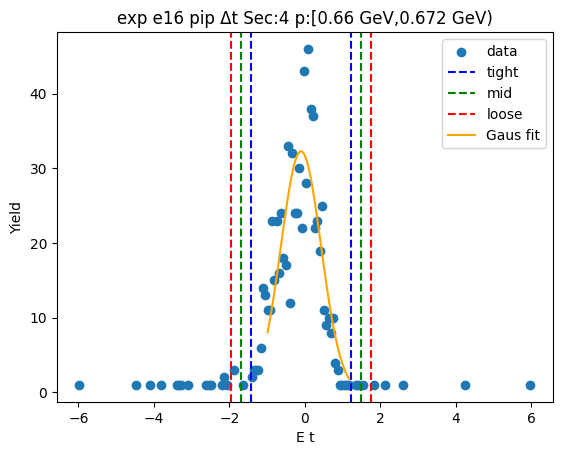

-1.2674299358545826 1.1604178977294164
-1.5102147192129824 1.4032026810878162
-1.7529995025713827 1.645987464446216
[35.39715314 -0.05350602  0.48556957]


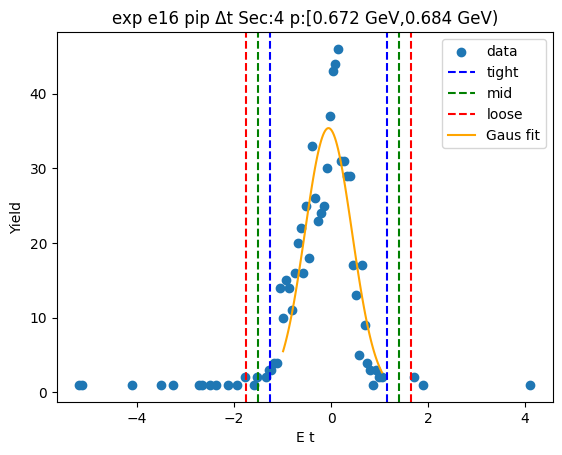

-1.1207700487368637 1.0810545469715893
-1.340952508307709 1.3012370065424346
-1.5611349678785542 1.5214194661132798
[ 3.41180542e+01 -1.98577509e-02  4.40364919e-01]


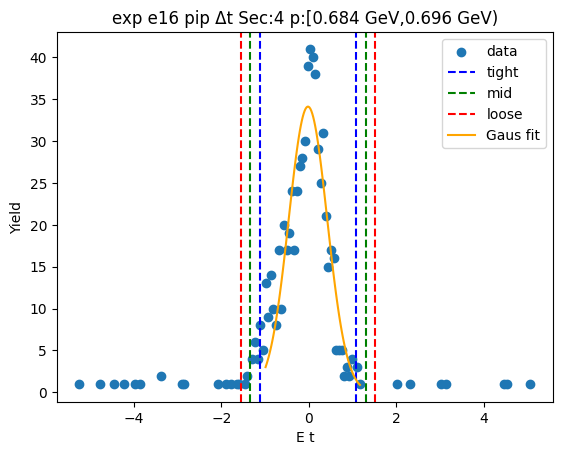

-1.148386909248635 1.0421158576642457
-1.367437185939923 1.2611661343555338
-1.586487462631211 1.480216411046822
[37.14521977 -0.05313553  0.43810055]


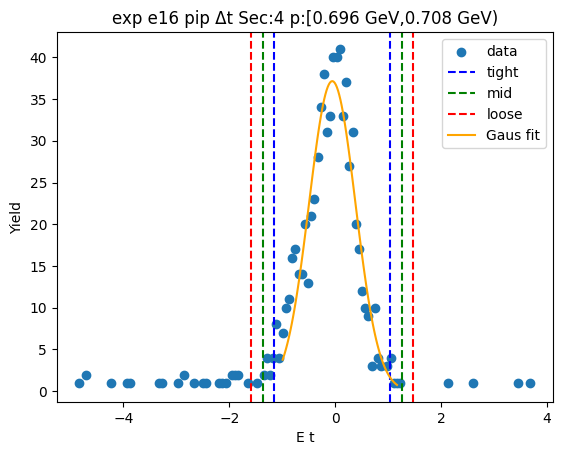

-1.0919945221731893 1.078438885500785
-1.3090378629405868 1.2954822262681824
-1.526081203707984 1.5125255670355797
[ 3.68638307e+01 -6.77781834e-03  4.34086682e-01]


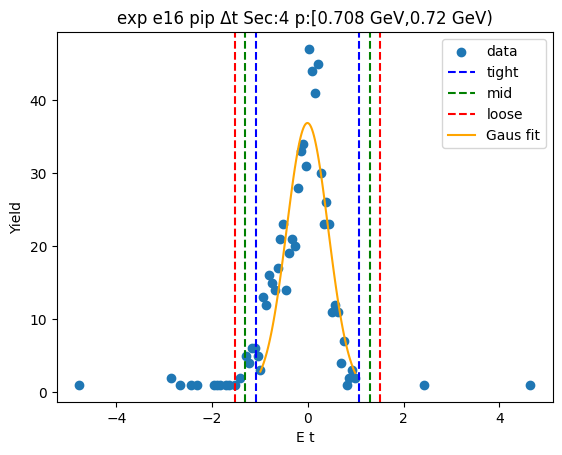

-1.2076494369497486 1.024544480483759
-1.4308688286930993 1.2477638722271096
-1.65408822043645 1.4709832639704603
[36.41304498 -0.09155248  0.44643878]


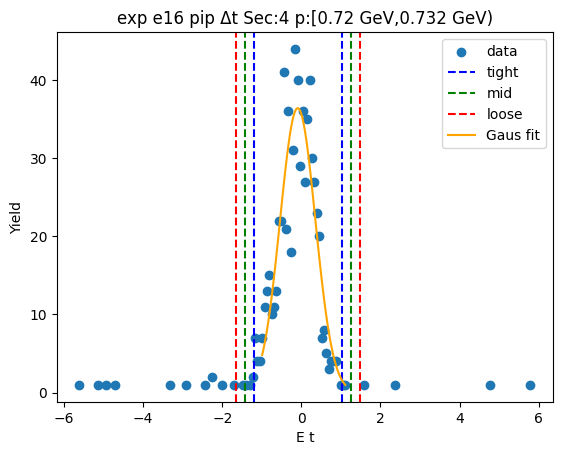

-1.1619709736732309 1.0145728607401907
-1.379625357114573 1.2322272441815327
-1.597279740555915 1.4498816276228748
[38.29337669 -0.07369906  0.43530877]


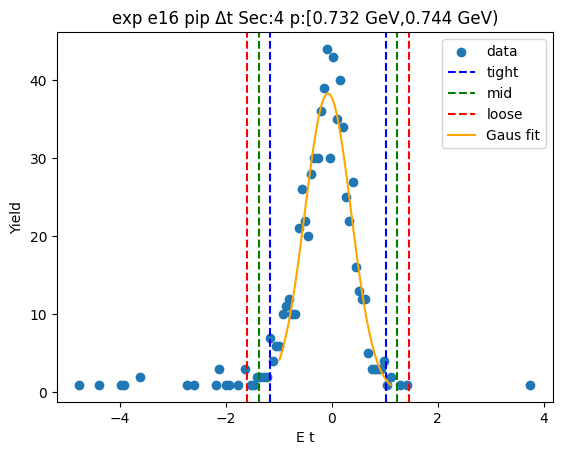

-1.031554710521114 0.9405030953358604
-1.2287604911068113 1.1377088759215577
-1.4259662716925088 1.3349146565072552
[41.26485224 -0.04552581  0.39441156]


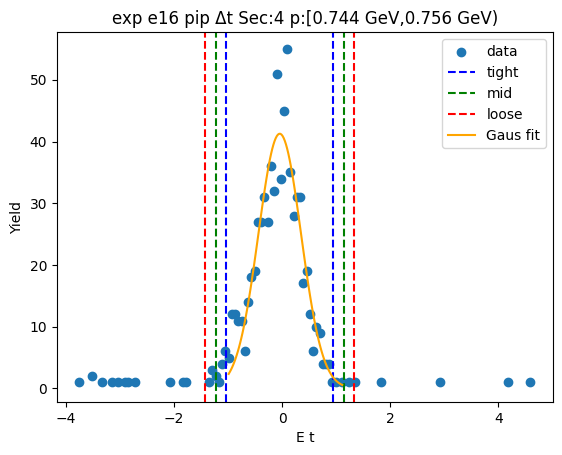

-1.2164152736179745 1.0414689127958612
-1.4422036922593582 1.2672573314372448
-1.6679921109007416 1.4930457500786283
[35.49627502 -0.08747318  0.45157684]


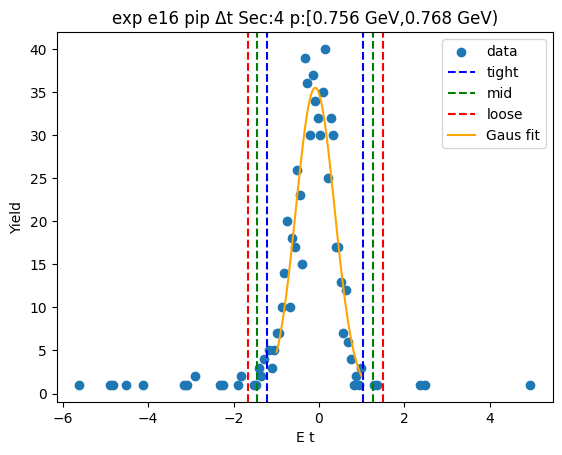

-1.082342335954568 0.9766793383734301
-1.288244503387368 1.1825815058062301
-1.4941466708201678 1.38848367323903
[38.78560127 -0.0528315   0.41180433]


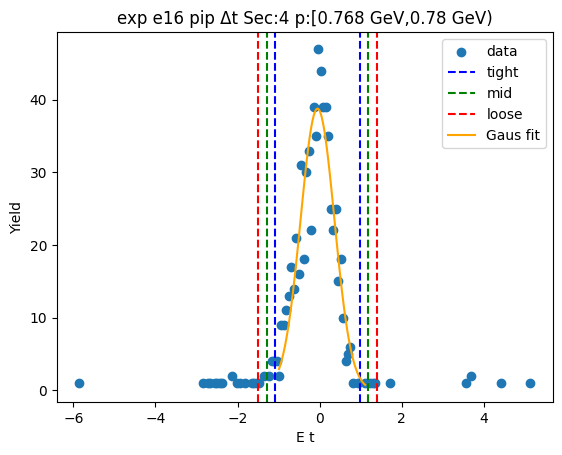

-1.1001764429236944 1.0066922794378321
-1.3108633151598472 1.217379151673985
-1.521550187396 1.4280660239101377
[35.68516143 -0.04674208  0.42137374]


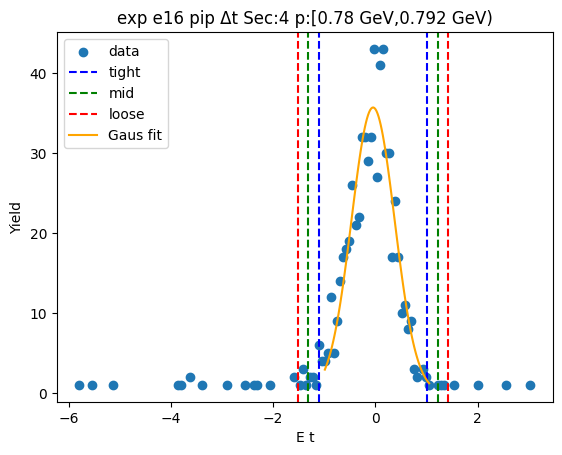

-1.0590329013418895 0.9499364322519102
-1.2599298347012695 1.1508333656112901
-1.4608267680606495 1.35173029897067
[38.91166612 -0.05454823  0.40179387]


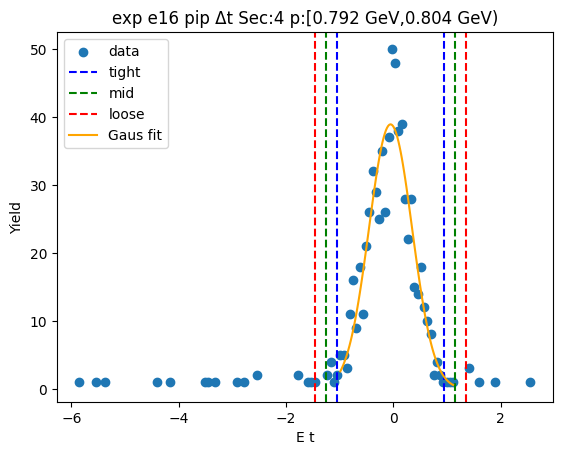

-0.9833297904889553 0.9201444752164598
-1.173677217059497 1.1104919017870014
-1.3640246436300383 1.3008393283575428
[ 3.81355000e+01 -3.15926576e-02  3.80694853e-01]


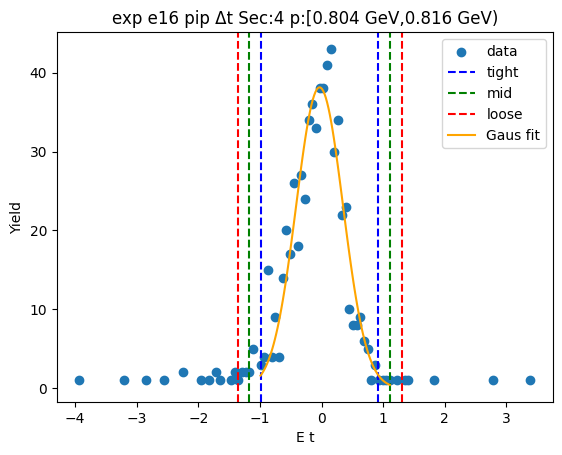

-1.0562700103736347 0.9480598893453609
-1.2567030003455344 1.1484928793172606
-1.457135990317434 1.3489258692891601
[38.6892349  -0.05410506  0.40086598]


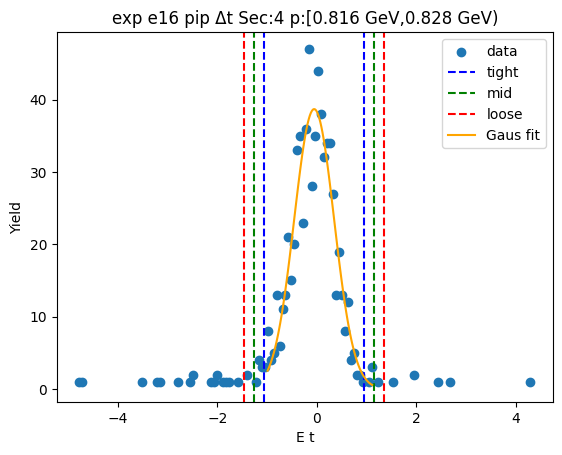

-1.0182245689083314 0.8914538973997068
-1.2091924155391351 1.0824217440305108
-1.400160262169939 1.2733895906613146
[37.28268362 -0.06338534  0.38193569]


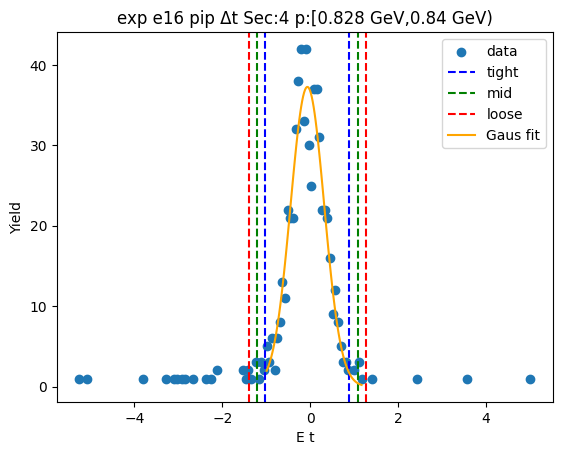

-1.0076311059083143 0.9382154319656684
-1.2022157596957124 1.1328000857530665
-1.3968004134831107 1.3273847395404648
[ 3.49718425e+01 -3.47078370e-02  3.89169308e-01]


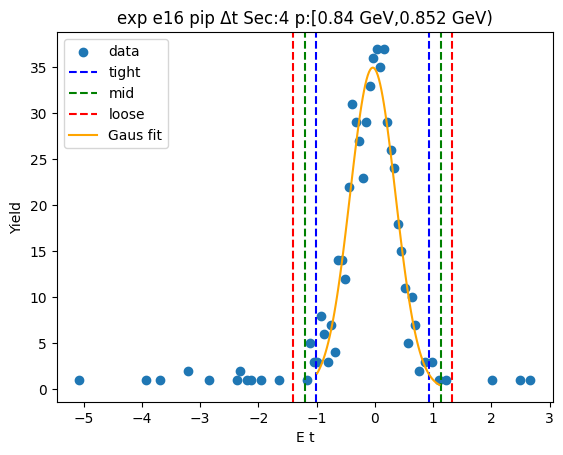

-0.9806588559482153 0.960281764895763
-1.174752918032613 1.154375826980161
-1.368846980117011 1.3484698890645588
[ 3.47404916e+01 -1.01885455e-02  3.88188124e-01]


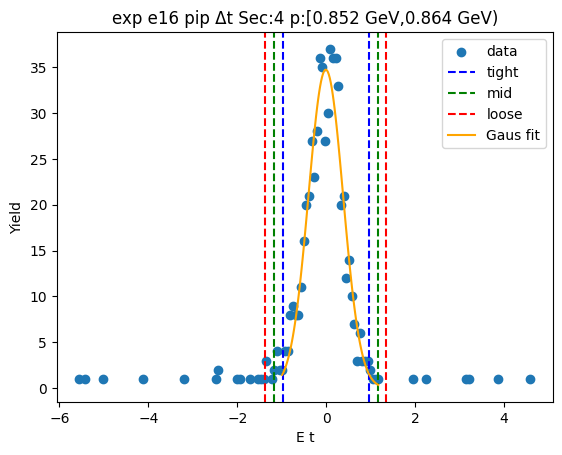

-0.9427544791291549 0.8514038402927051
-1.1221703110713408 1.030819672234891
-1.301586143013527 1.2102355041770771
[36.12720689 -0.04567532  0.35883166]


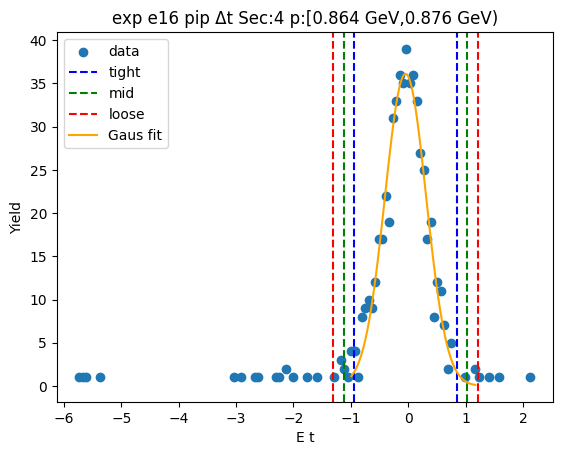

-1.0361200058805107 0.981263757795687
-1.2378583822481304 1.1830021341633066
-1.43959675861575 1.3847405105309263
[ 3.53513977e+01 -2.74281240e-02  4.03476753e-01]


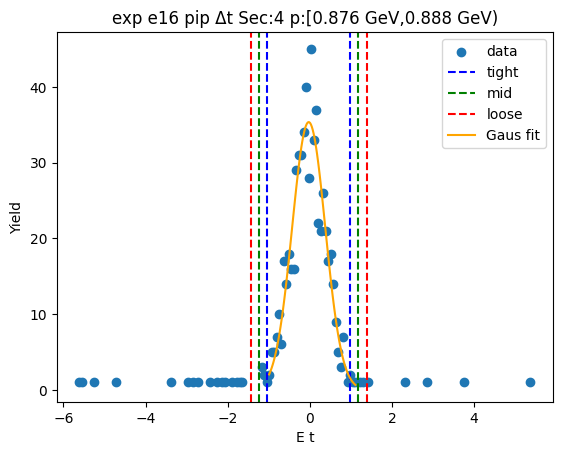

-0.98235323062418 0.9226420132795463
-1.1728527550145524 1.113141537669919
-1.363352279404925 1.3036410620602916
[ 3.47947004e+01 -2.98556087e-02  3.80999049e-01]


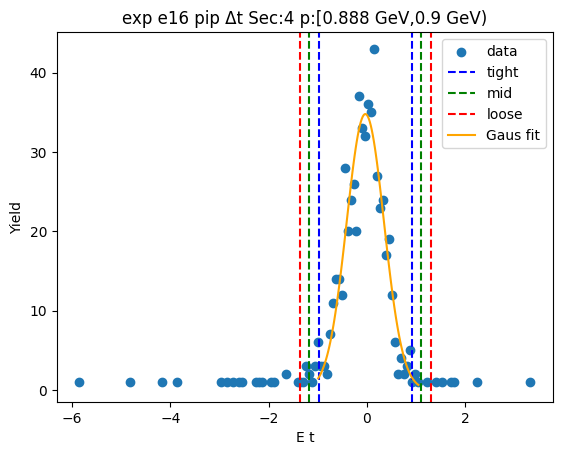

-1.0411740936260236 0.9068361115070198
-1.2359751141393278 1.101637132020324
-1.4307761346526322 1.2964381525336284
[34.91764283 -0.06716899  0.38960204]


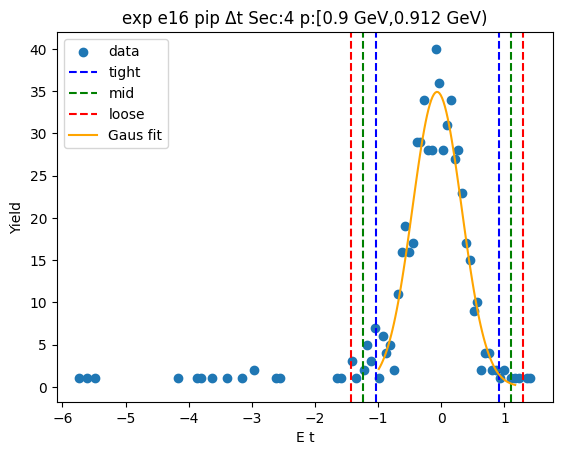

-0.9841902518742162 0.8858025138463336
-1.1711895284462712 1.0728017904183886
-1.3581888050183262 1.2598010669904436
[33.02705524 -0.04919387  0.37399855]


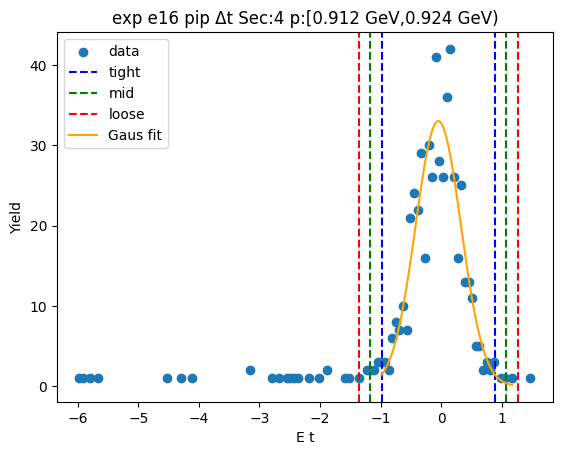

-1.0467789470445323 0.8690797798050376
-1.2383648197294894 1.0606656524899947
-1.4299506924144463 1.2522515251749515
[33.23359221 -0.08884958  0.38317175]


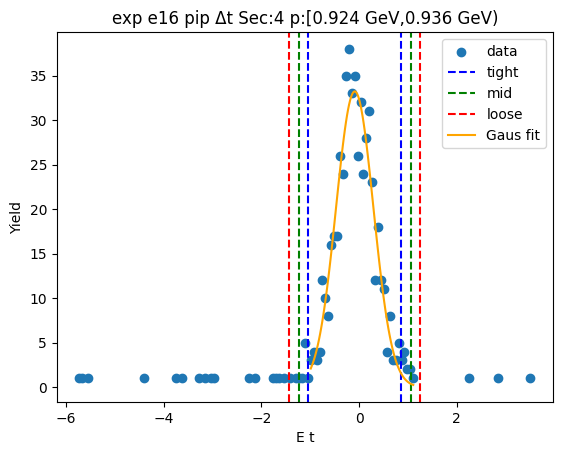

-1.0262674645941683 0.8542333651579258
-1.2143175475693777 1.0422834481331353
-1.4023676305445871 1.2303335311083448
[29.4599153  -0.08601705  0.37610017]


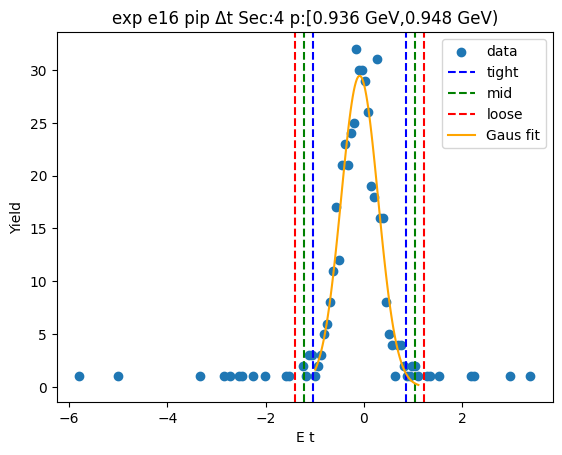

-1.0658541538374255 0.9078448393781674
-1.2632240531589847 1.1052147386997266
-1.460593952480544 1.302584638021286
[30.48998439 -0.07900466  0.3947398 ]


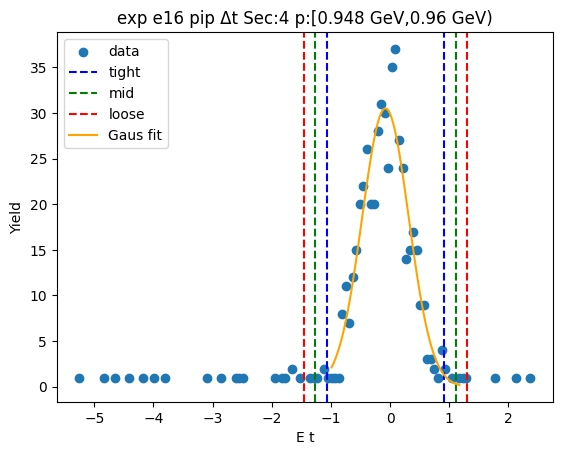

-1.0284017801604777 0.8828259023480031
-1.2195245484113255 1.0739486705988512
-1.4106473166621738 1.265071438849699
[30.8727887  -0.07278794  0.38224554]


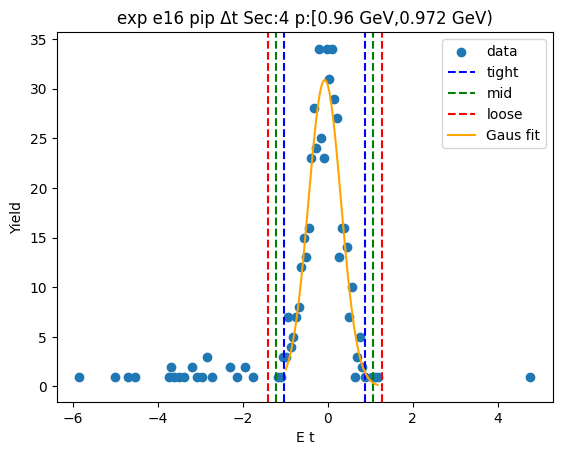

-1.0805738704511345 0.9399230800005531
-1.2826235654963032 1.1419727750457218
-1.484673260541472 1.3440224700908907
[28.87257583 -0.0703254   0.40409939]


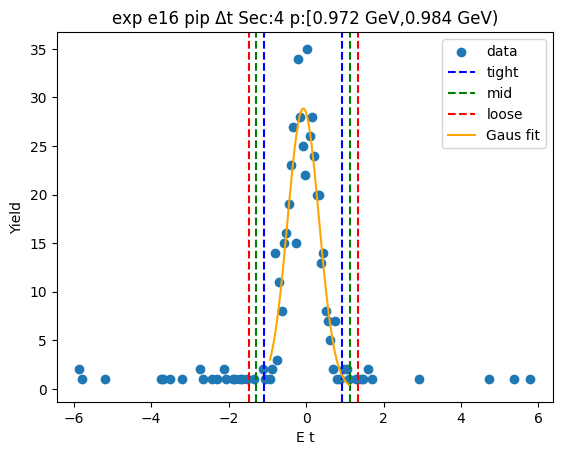

-1.0539701071806102 0.8913367321791579
-1.2485007911165868 1.0858674161151347
-1.4430314750525637 1.2803981000511115
[28.94660676 -0.08131669  0.38906137]


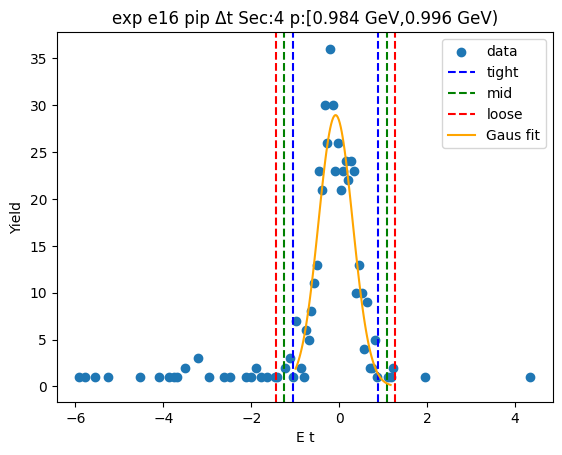

-0.9905346955073111 0.8204053946036474
-1.171628704518407 1.001499403614743
-1.352722713529503 1.182593412625839
[30.84279093 -0.08506465  0.36218802]


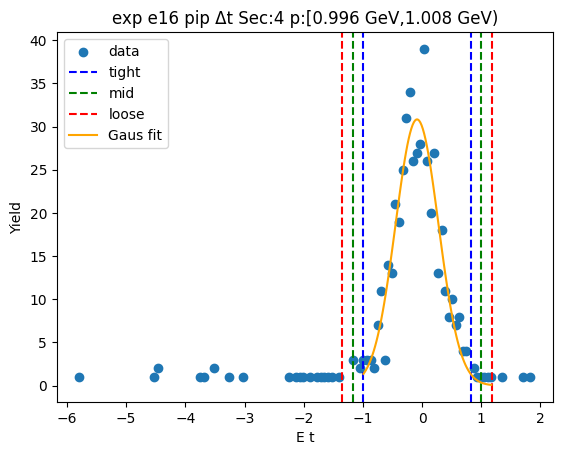

-1.0513058409596414 0.9186124672522452
-1.2482976717808303 1.115604298073434
-1.445289502602019 1.3125961288946226
[27.51465941 -0.06634669  0.39398366]


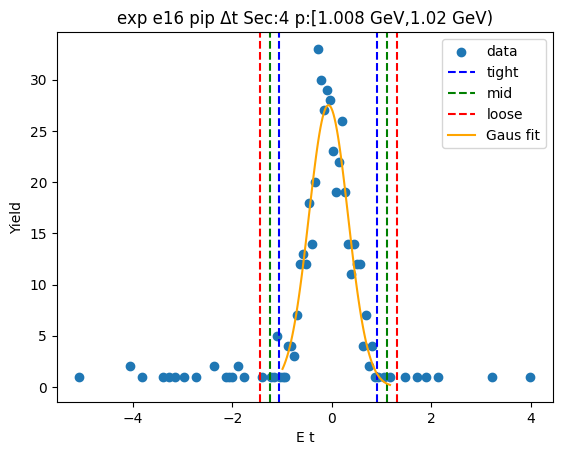

-1.0290076295556099 0.8915038245803361
-1.2210587749692043 1.0835549699939306
-1.4131099203827988 1.275606115407525
[28.36339076 -0.0687519   0.38410229]


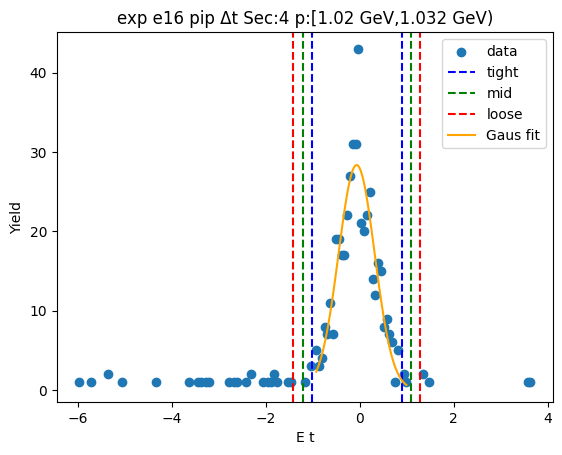

-1.0186966411519367 0.8687739023634641
-1.2074436955034769 1.0575209567150041
-1.3961907498550168 1.246268011066544
[24.71205511 -0.07496137  0.37749411]


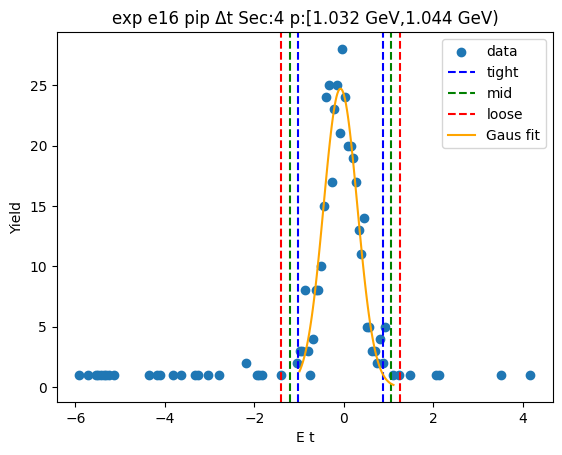

-0.9944209213500645 0.9018546287721554
-1.1840484763622867 1.0914821837843776
-1.3736760313745087 1.2811097387965995
[28.80746592 -0.04628315  0.37925511]


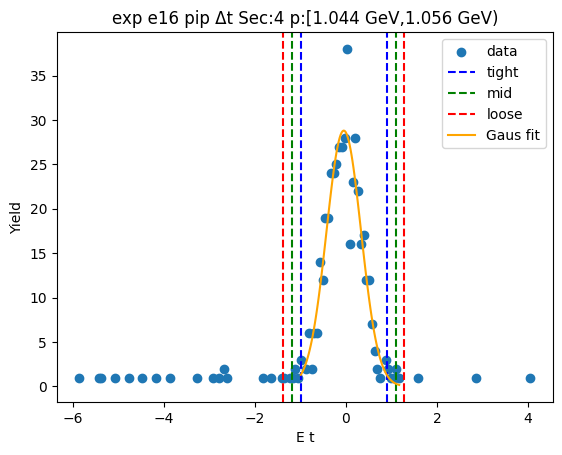

-1.0465174649084565 0.933914777742547
-1.2445606891735568 1.1319580020076474
-1.442603913438657 1.3300012262727476
[25.56684684 -0.05630134  0.39608645]


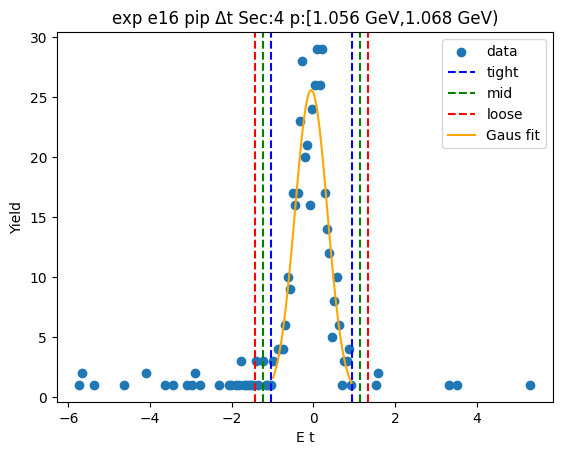

-1.0160535052233899 0.8942183889620521
-1.207080694641934 1.085245578380596
-1.3981078840604781 1.2762727677991403
[25.62284429 -0.06091756  0.38205438]


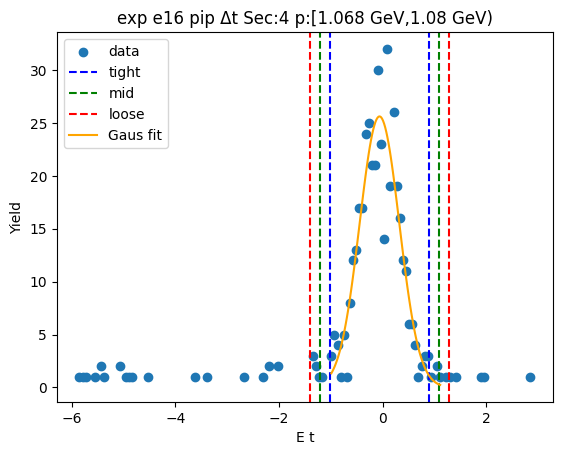

-1.0366825557494477 1.0016912224711518
-1.2405199335715076 1.2055286002932117
-1.4443573113935675 1.4093659781152716
[ 2.34851300e+01 -1.74956666e-02  4.07674756e-01]


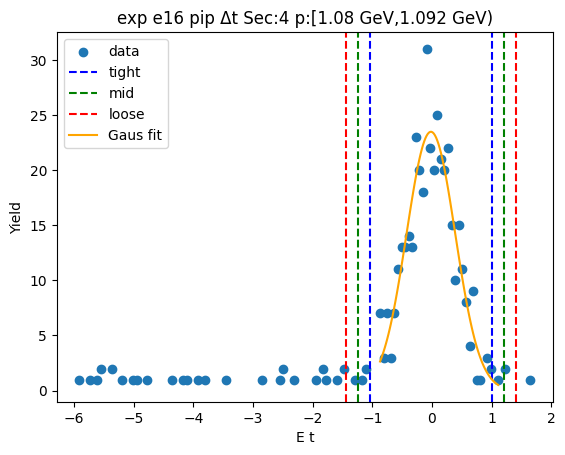

-1.0648598779965053 0.9218953572228605
-1.2635354015184417 1.120570880744797
-1.4622109250403783 1.3192464042667336
[24.14576413 -0.07148226  0.39735105]


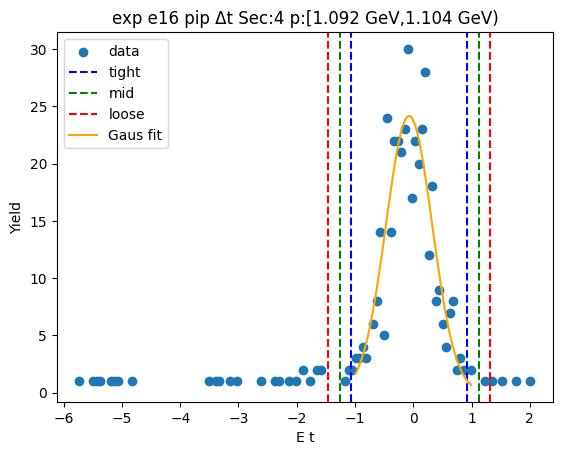

-0.9553904952570131 0.8982611406719048
-1.1407556588499048 1.0836263042647967
-1.3261208224427967 1.2689914678576886
[23.3392964  -0.02856468  0.37073033]


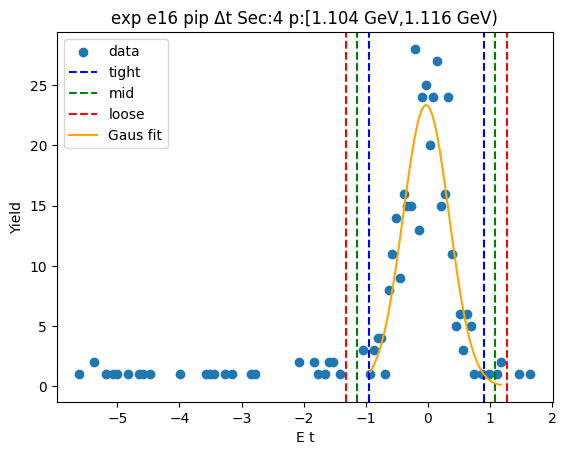

-0.9571407784830961 0.842020621574953
-1.137056918488901 1.021936761580758
-1.316973058494706 1.2018529015865629
[24.000239   -0.05756008  0.35983228]


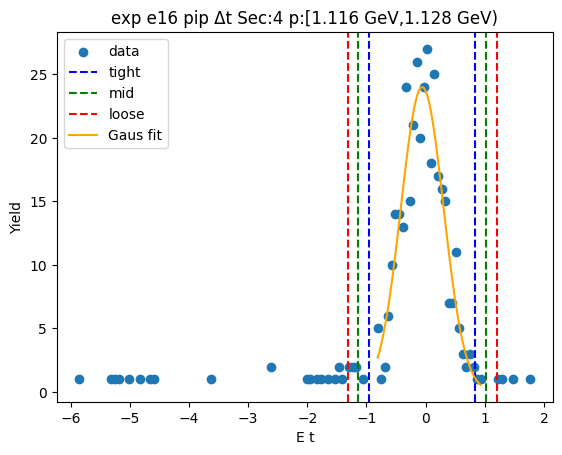

-0.9910074003852658 0.9081733546693678
-1.1809254758907293 1.098091430174831
-1.3708435513961927 1.2880095056802945
[21.12863842 -0.04141702  0.37983615]


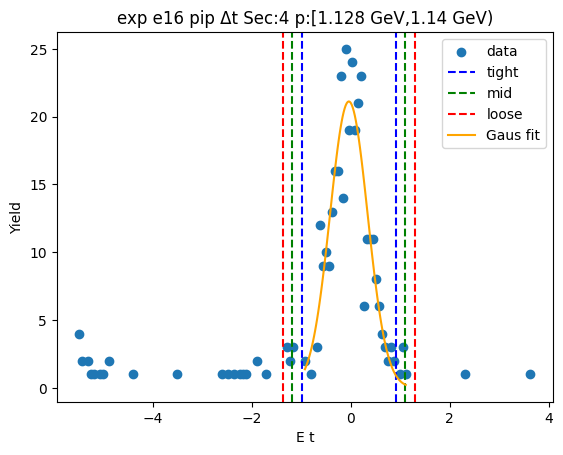

-0.8313276815336881 0.8678450807750704
-1.001244957764564 1.0377623570059464
-1.1711622339954397 1.2076796332368223
[2.41635518e+01 1.82586996e-02 3.39834552e-01]


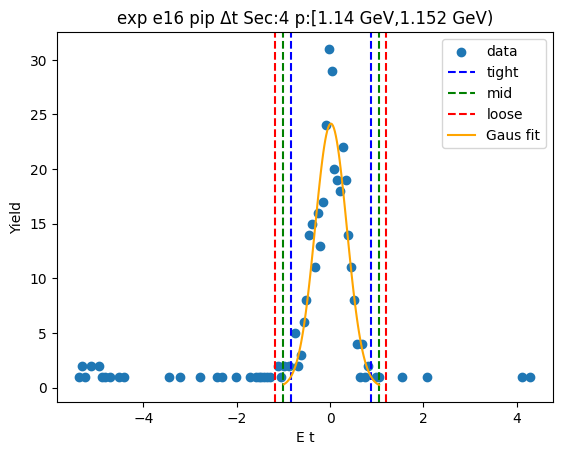

-0.9193630681425466 0.8587666109316856
-1.09717603604997 1.036579578839109
-1.2749890039573932 1.2143925467465322
[24.35387595 -0.03029823  0.35562594]


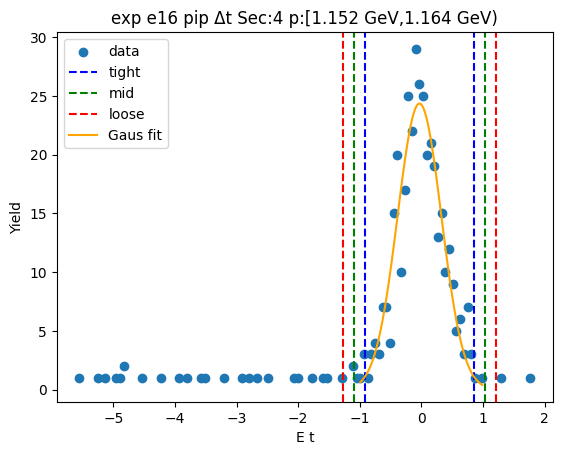

-0.9723275348299223 0.9145785884819475
-1.1610181471611092 1.1032692008131344
-1.3497087594922963 1.2919598131443215
[20.97066931 -0.02887447  0.37738122]


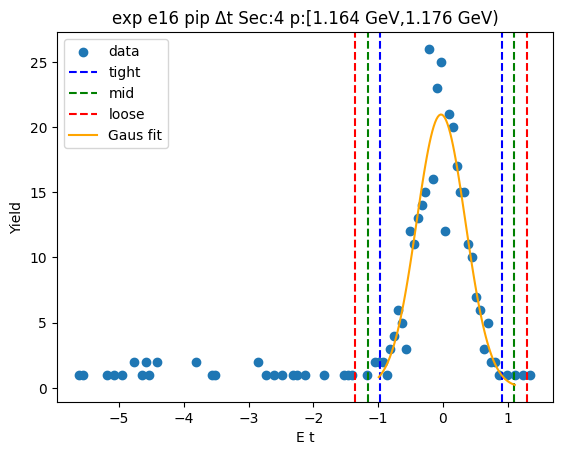

-0.8209111010943999 0.7282705593960228
-0.9758292671434421 0.883188725445065
-1.1307474331924845 1.0381068914941074
[24.7548968  -0.04632027  0.30983633]


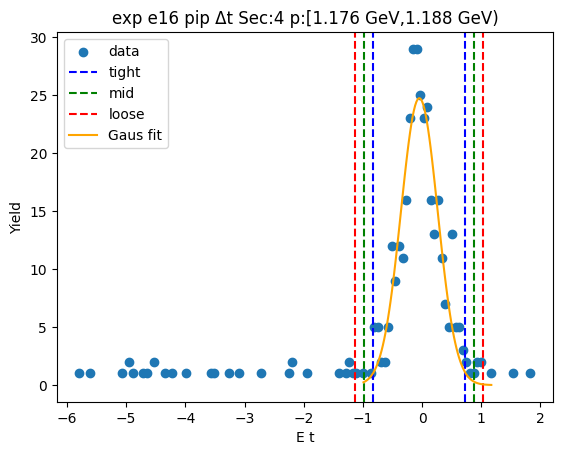

-0.9057092442998474 0.8037465777722929
-1.0766548265070615 0.974692159979507
-1.2476004087142754 1.145637742186721
[23.3803849  -0.05098133  0.34189116]


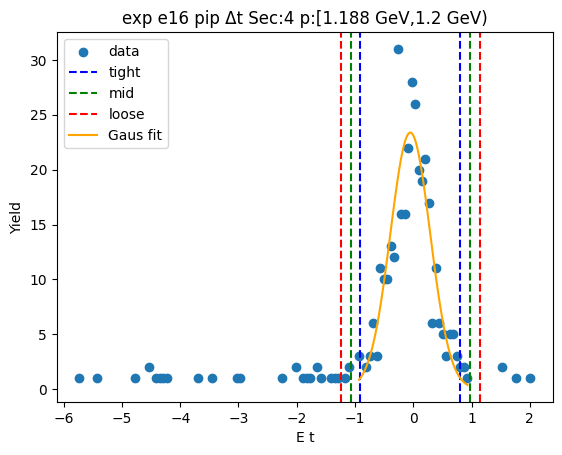

-1.0128384683279212 0.86054998739855
-1.2001773139005683 1.0478888329711973
-1.3875161594732157 1.2352276785438443
[18.74501235 -0.07614424  0.37467769]


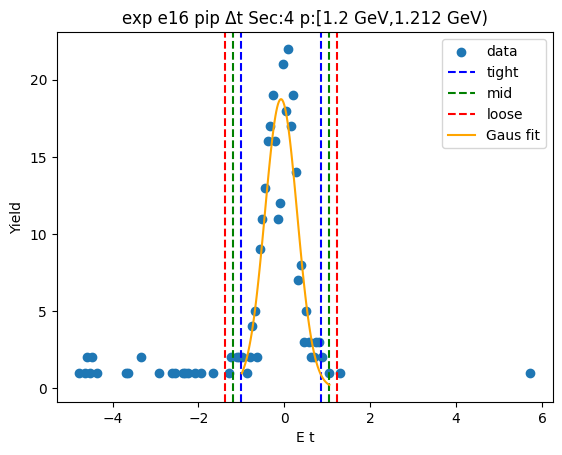

-1.017754073075322 0.8714981195355518
-1.2066792923364094 1.060423338796639
-1.3956045115974969 1.2493485580577266
[19.22513198 -0.07312798  0.37785044]


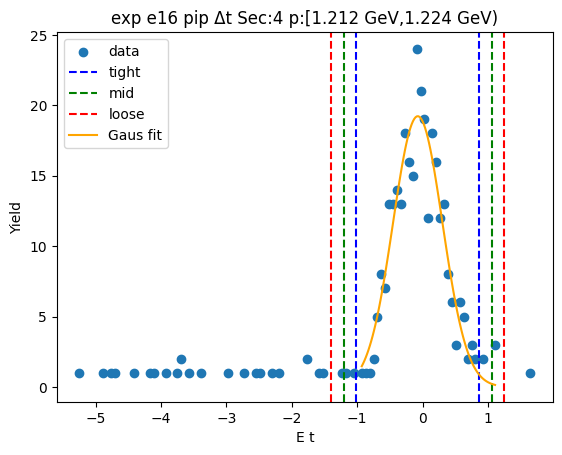

-0.9955687979461452 0.9355155624178164
-1.1886772339825413 1.1286239984542126
-1.3817856700189375 1.3217324344906087
[18.99533458 -0.03002662  0.38621687]


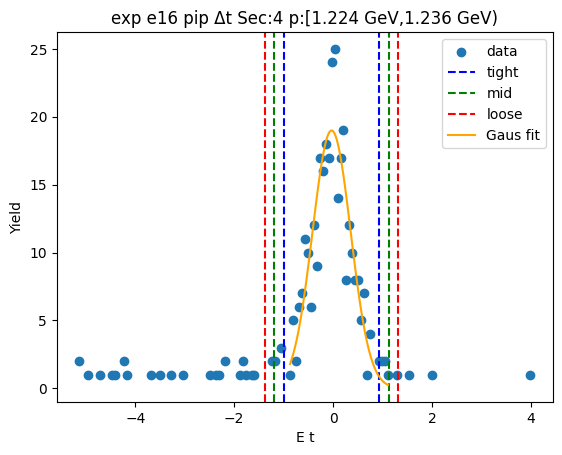

-0.9506360727504434 0.9525375080403579
-1.1409534308295235 1.142854866119438
-1.3312707889086037 1.3331722241985182
[2.04403894e+01 9.50717645e-04 3.80634716e-01]


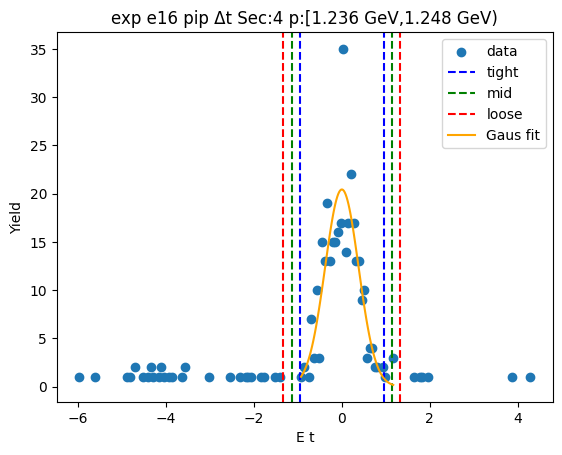

-0.9050878843577461 0.8468497295891637
-1.0802816457524371 1.0220434909838545
-1.2554754071471281 1.1972372523785455
[20.10286041 -0.02911908  0.35038752]


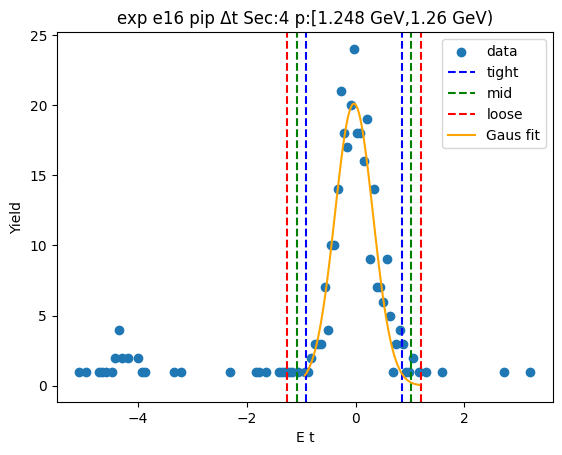

-0.9141119488766342 0.83873987816763
-1.0893971315810607 1.0140250608720565
-1.264682314285487 1.1893102435764829
[19.27465572 -0.03768604  0.35057037]


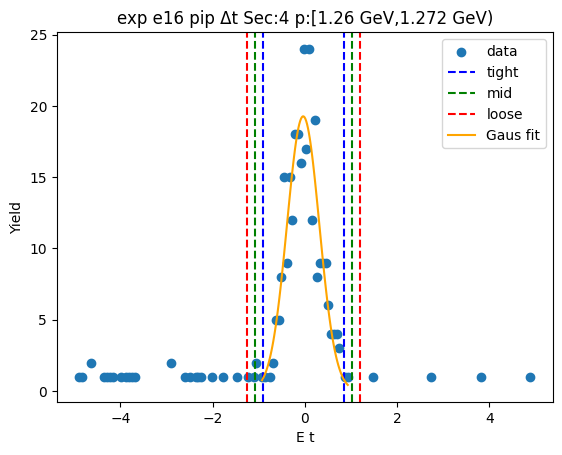

-0.9463464472277351 0.8525287514319654
-1.126233967093705 1.0324162712979355
-1.3061214869596751 1.2123037911639056
[17.56598221 -0.04690885  0.35977504]


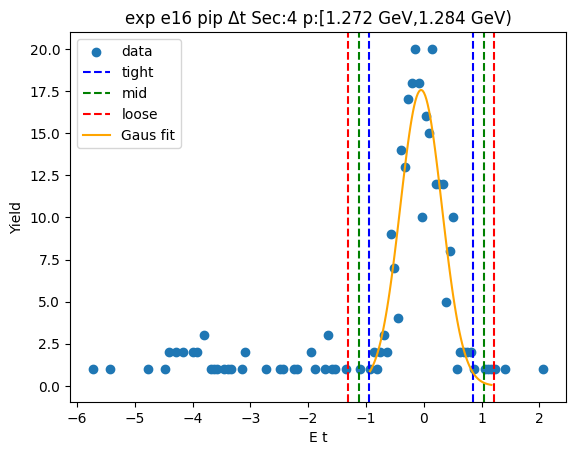

-0.8288402043626556 0.8158986652257748
-0.9933140913214987 0.9803725521846179
-1.1577879782803415 1.144846439143461
[ 2.12361820e+01 -6.47076957e-03  3.28947774e-01]


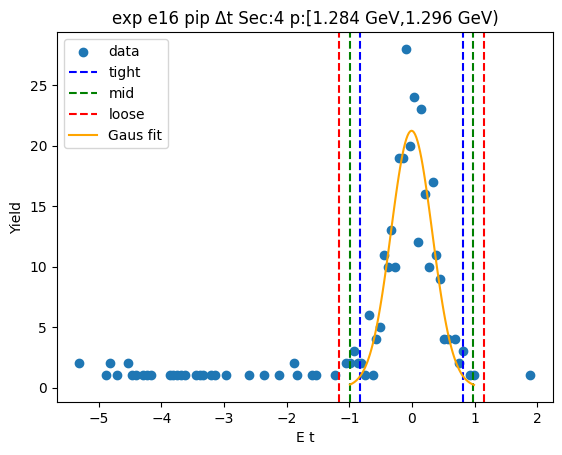

-1.005593866308484 0.8815080758883855
-1.194304060528171 1.0702182701080727
-1.3830142547478579 1.2589284643277596
[16.61593081 -0.0620429   0.37742039]


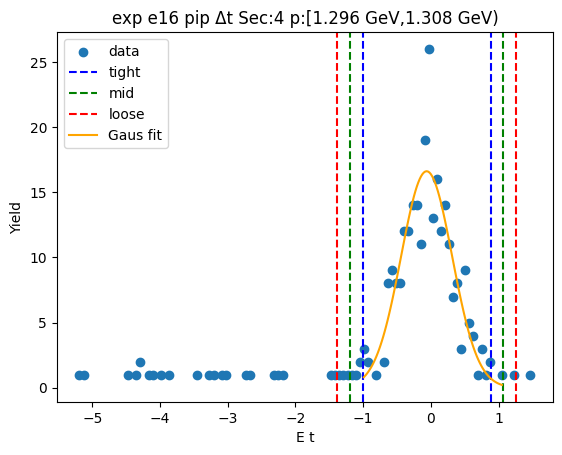

-0.9501221701993461 0.9443034397679055
-1.1395647311960713 1.1337460007646305
-1.3290072921927965 1.3231885617613557
[ 1.71101052e+01 -2.90936522e-03  3.78885122e-01]


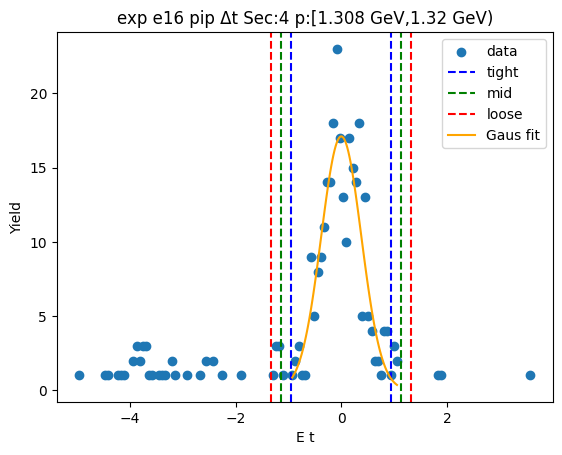

-0.9825154458404214 0.8612017927425794
-1.1668871696987215 1.0455735166008797
-1.3512588935570216 1.2299452404591797
[18.43965772 -0.06065683  0.36874345]


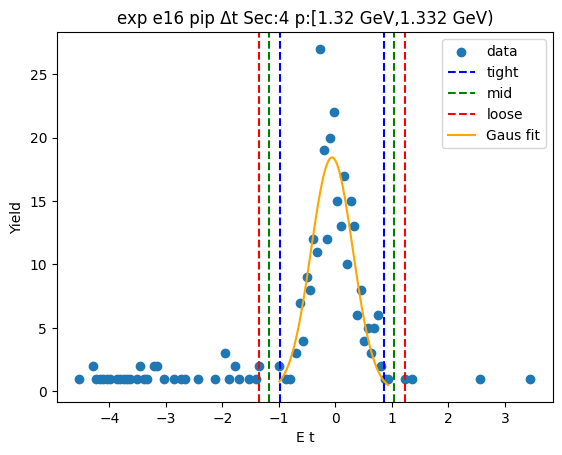

-0.8594179241077395 0.8625517595848422
-1.031614892476998 1.0347487279541006
-1.203811860846256 1.2069456963233587
[1.62492280e+01 1.56691774e-03 3.44393937e-01]


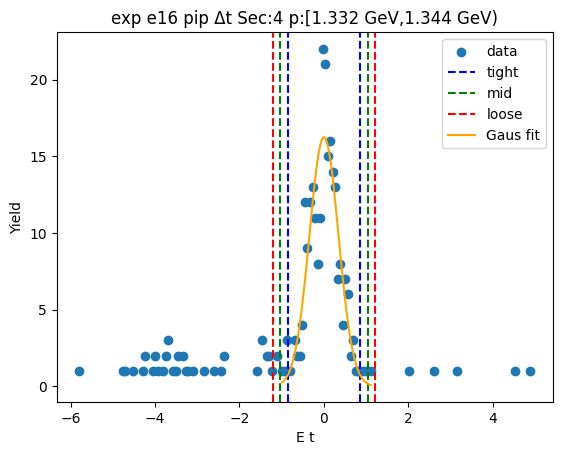

-0.9793085687108237 1.0203376467910985
-1.179273190261016 1.2203022683412907
-1.3792378118112083 1.420266889891483
[15.0931541   0.02051454  0.39992924]


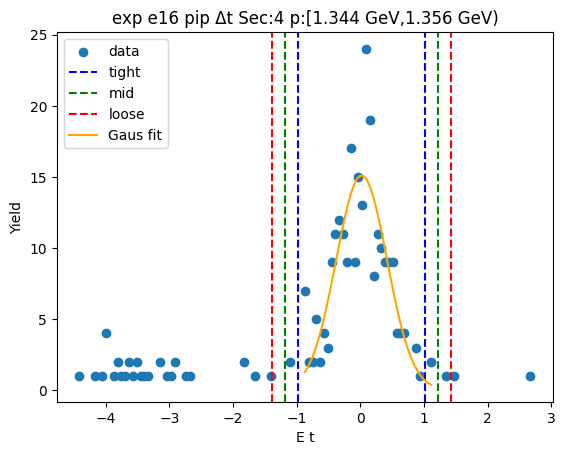

-0.9324701201394077 0.8574493992959134
-1.1114620720829398 1.0364413512394453
-1.290454024026472 1.2154333031829774
[14.6575928  -0.03751036  0.3579839 ]


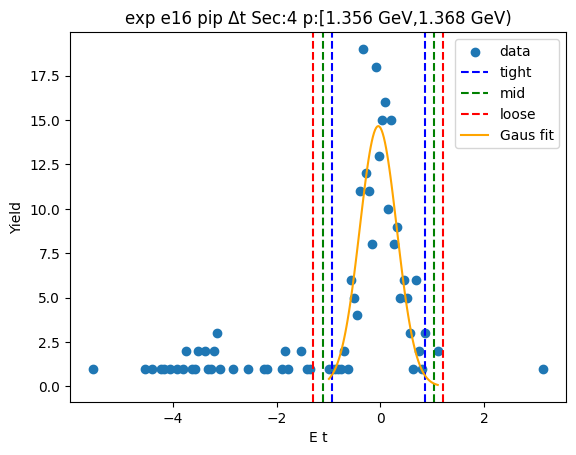

-1.0240193095638181 0.9323617753422625
-1.2196574180544264 1.1279998838328709
-1.4152955265450344 1.323637992323479
[15.33023996 -0.04582877  0.39127622]


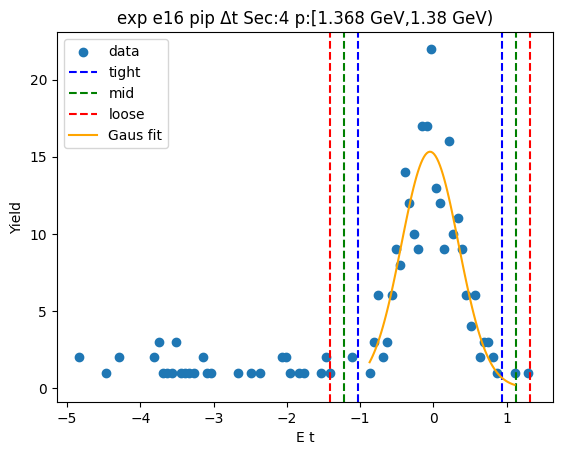

-1.078623711022284 1.1730990711029032
-1.3037959892348028 1.398271349315422
-1.5289682674473215 1.6234436275279407
[12.98210683  0.04723768  0.45034456]


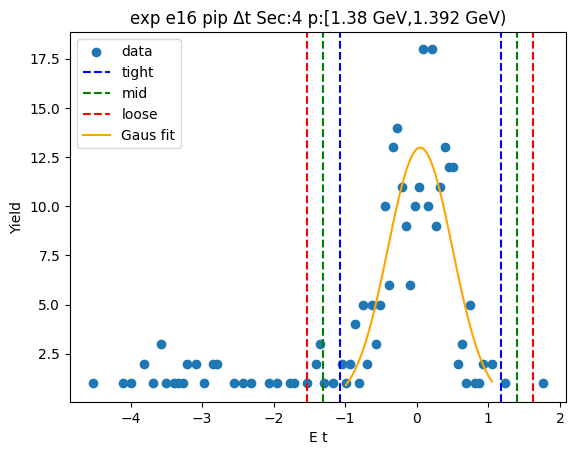

-0.8911839202724919 0.8890841102978743
-1.0692107233295285 1.0671109133549106
-1.2472375263865652 1.2451377164119473
[ 1.45852363e+01 -1.04990499e-03  3.56053606e-01]


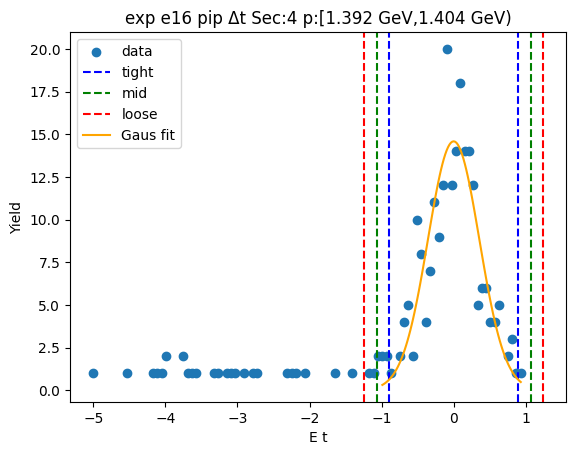

-0.9902640366119739 0.9921791456417763
-1.188508354837349 1.1904234638671514
-1.386752673062724 1.3886677820925264
[1.31539042e+01 9.57554515e-04 3.96488636e-01]


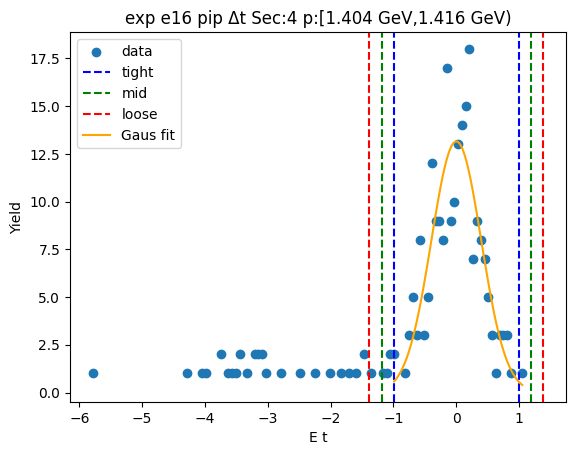

-0.9437522475893849 0.9136625153691895
-1.1294937238852423 1.0994039916650469
-1.3152352001810999 1.2851454679609045
[13.88151433 -0.01504487  0.37148295]


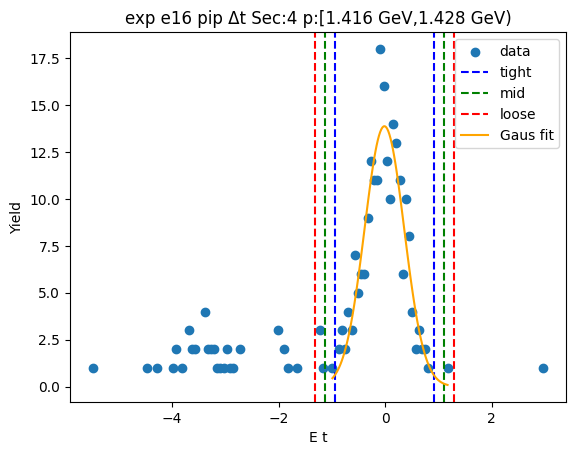

-0.9811176599203602 1.0921677132956062
-1.1884461972419569 1.299496250617203
-1.3957747345635534 1.5068247879387995
[12.18932772  0.05552503  0.41465707]


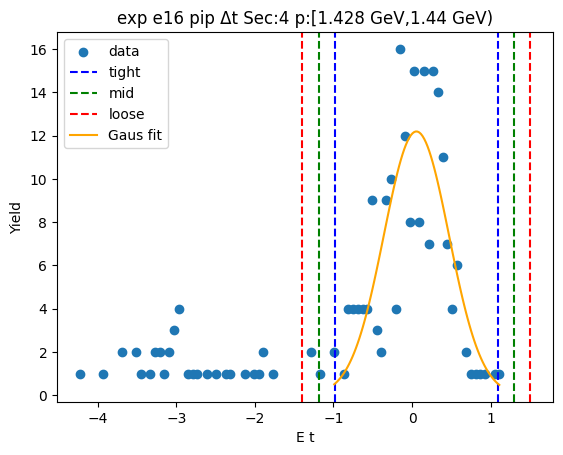

-0.9416069116397089 0.9315167610822214
-1.1289192789119018 1.1188291283544145
-1.3162316461840948 1.3061414956266075
[ 1.47074323e+01 -5.04507528e-03  3.74624735e-01]


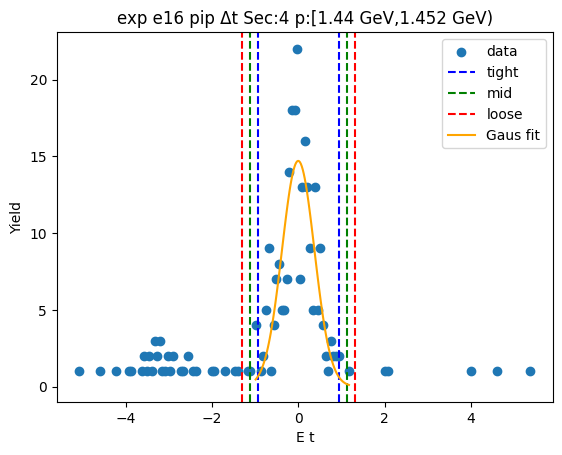

-1.058488105261897 1.0710317984287725
-1.271440095630964 1.2839837887978394
-1.484392086000031 1.4969357791669065
[1.19018392e+01 6.27184658e-03 4.25903981e-01]


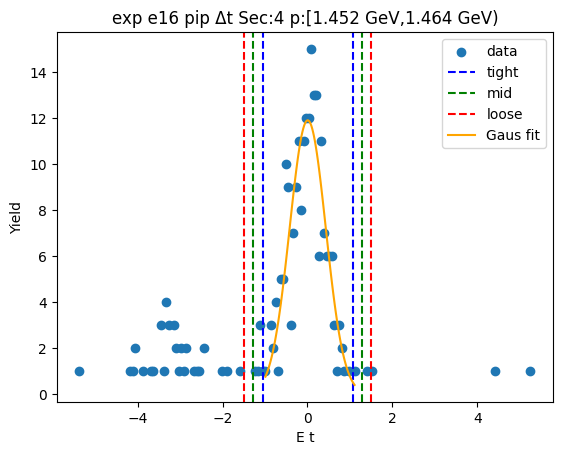

-0.9365047693001587 0.9259845375599534
-1.1227536999861698 1.1122334682459645
-1.3090026306721811 1.2984823989319758
[ 1.34985981e+01 -5.26011587e-03  3.72497861e-01]


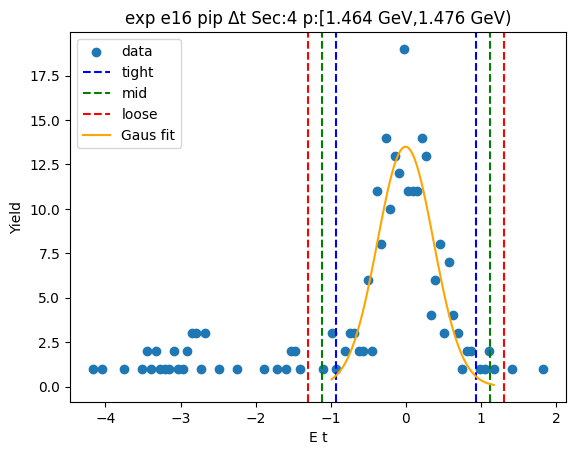

-1.0416807145642561 0.9776571623009263
-1.2436145022507745 1.1795909499874446
-1.445548289937293 1.381524737673963
[11.84843847 -0.03201178  0.40386758]


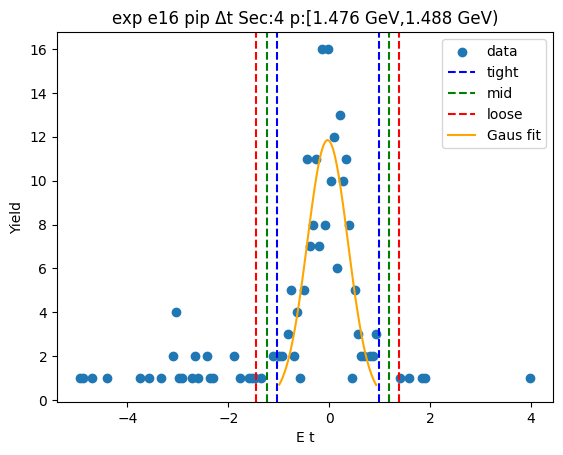

-0.9796571613678916 0.9635041530941247
-1.1739732928140933 1.1578202845403263
-1.368289424260295 1.352136415986528
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


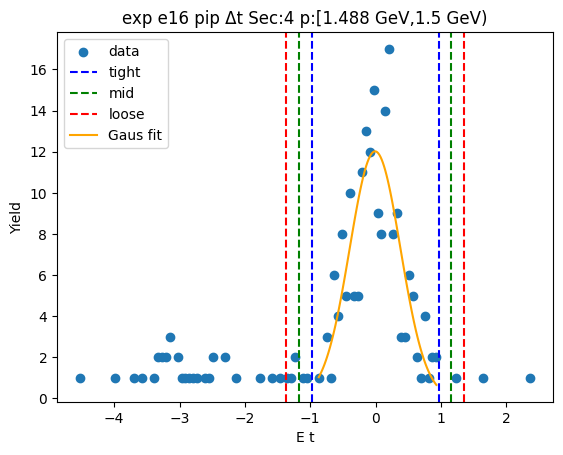

-0.8931893945292515 0.7996292653720838
-1.0624712605193851 0.9689111313622174
-1.2317531265095185 1.1381929973523508
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


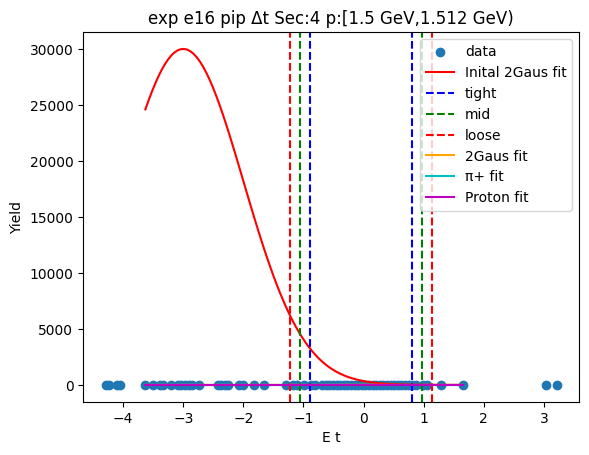

-0.9809849298878237 1.0300344395916687
-1.182086866835773 1.231136376539618
-1.383188803783722 1.4322383134875671
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


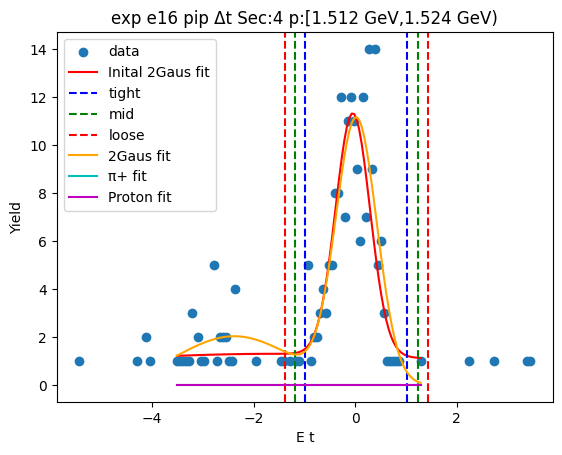

-0.7068980066574274 0.8551713442775036
-0.8631049417509205 1.0113782793709967
-1.0193118768444134 1.1675852144644898
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


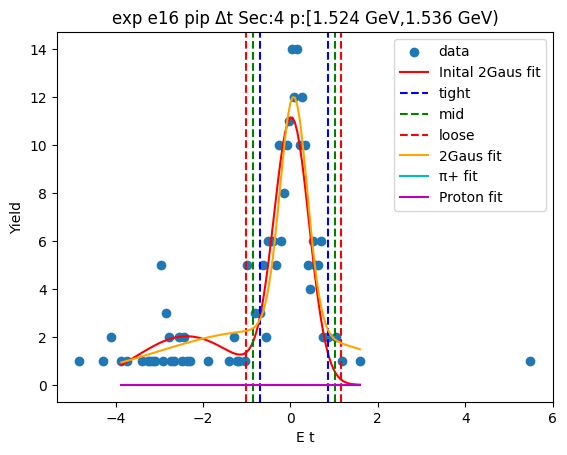

-0.962963507660668 0.9765746835855913
-1.1569173267852937 1.1705285027102172
-1.3508711459099196 1.3644823218348432
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


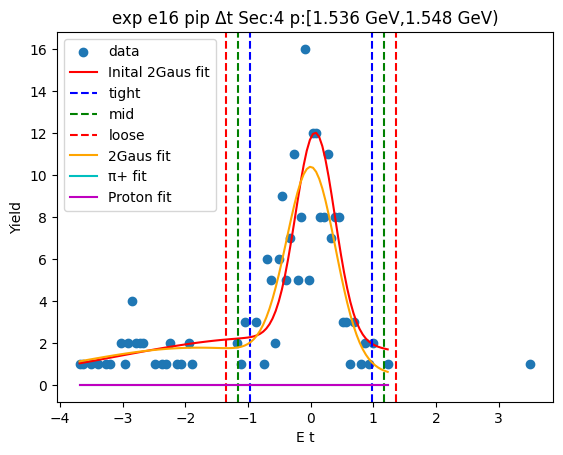

-0.9323647843231051 0.8543023580569544
-1.1110314985611112 1.0329690722949603
-1.2896982127991172 1.2116357865329663
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


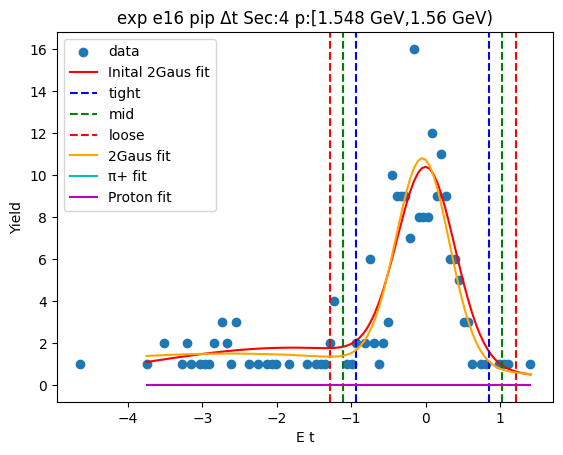

-0.7175292649221388 0.5368563175217964
-0.8429678231665322 0.6622948757661898
-0.9684063814109257 0.7877334340105834
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


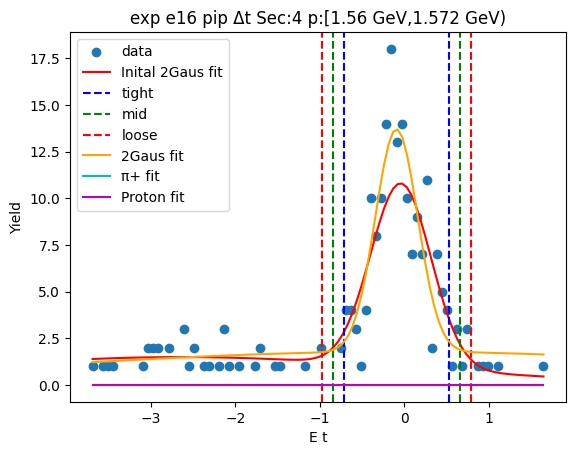

-1.0698631556961824 1.0174413560492486
-1.2785936068707255 1.2261718072237917
-1.4873240580452687 1.4349022583983349
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


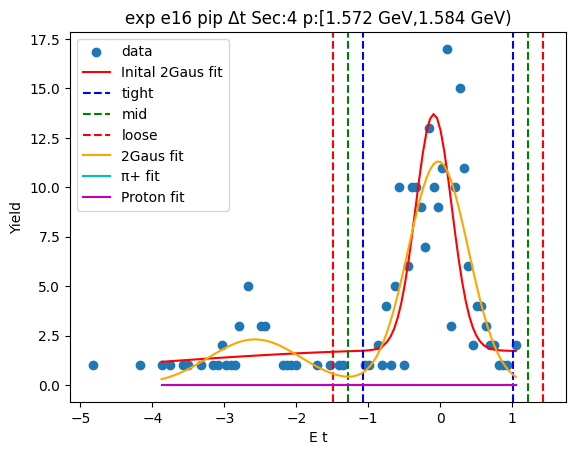

-1.2444694914595444 1.1903597123506058
-1.4879524118405594 1.4338426327316207
-1.7314353322215745 1.6773255531126359
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


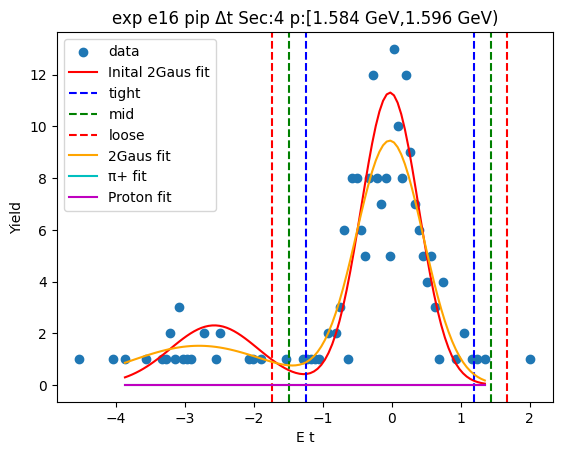

-0.980570170734562 0.9599818570001715
-1.1746253735080354 1.154037059773645
-1.3686805762815086 1.3480922625471181
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


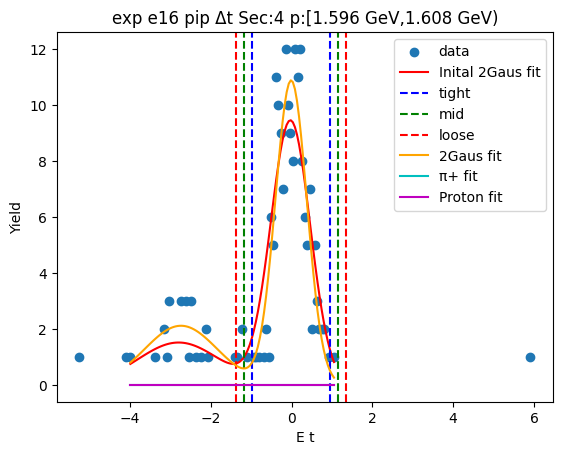

-1.0933835978722428 1.0902467993880556
-1.3117466375982727 1.3086098391140855
-1.5301096773243026 1.5269728788401153
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


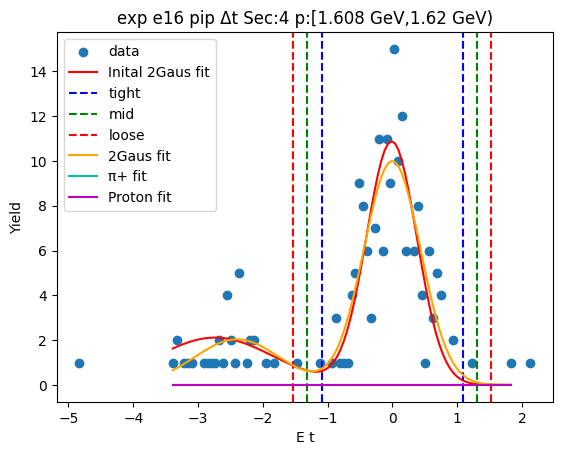

-1.1920430137672522 1.3674151659094687
-1.447988831734924 1.6233609838771406
-1.7039346497025962 1.8793068018448127
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


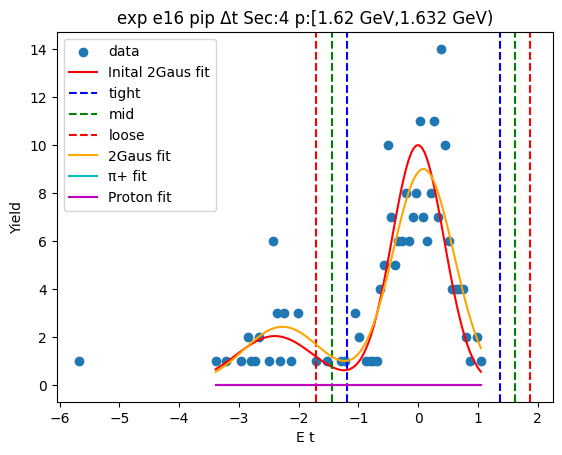

-0.7952998794395292 0.8143295098902326
-0.9562628183725053 0.9752924488232086
-1.1172257573054816 1.136255387756185
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


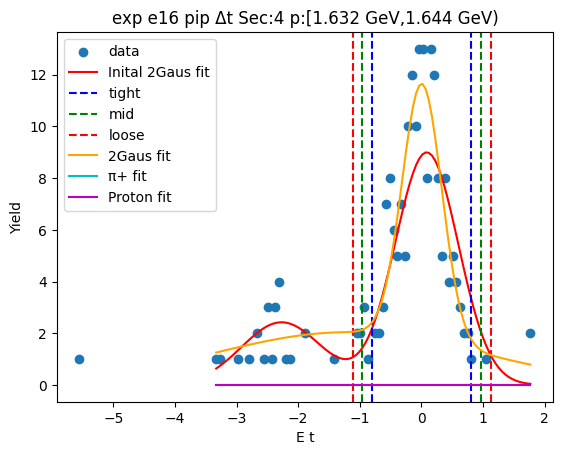

-0.885367464409148 0.9201877227102653
-1.0659229831210895 1.1007432414222067
-1.2464785018330307 1.281298760134148
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


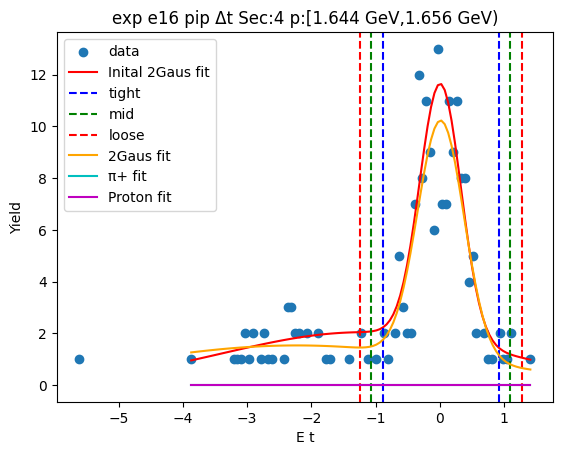

-1.0231171623942232 1.078507854971601
-1.2332796641308057 1.2886703567081834
-1.4434421658673882 1.4988328584447659
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


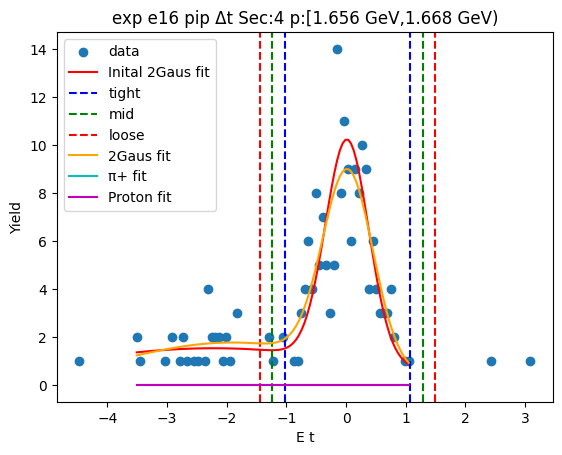

-0.8496682179308318 0.870866240769289
-1.0217216638008442 1.0429196866393011
-1.1937751096708562 1.2149731325093132
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


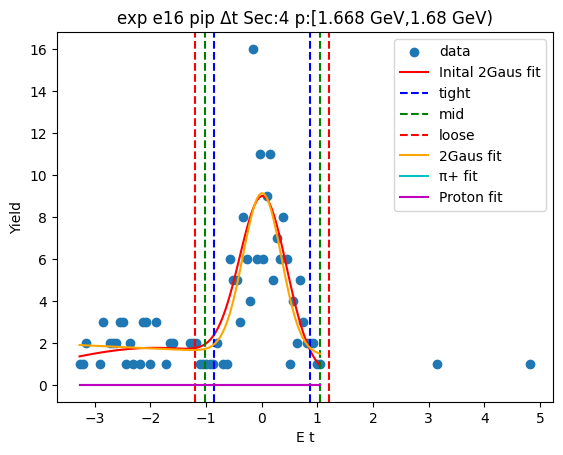

-0.9617910983414794 0.7542058141009077
-1.133390789585718 0.9258055053451465
-1.3049904808299566 1.0974051965893852
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


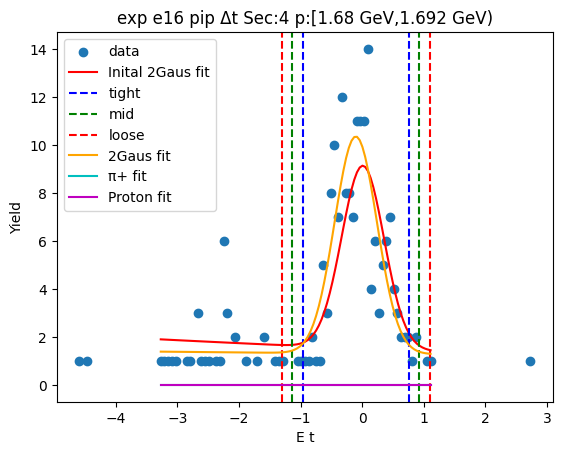

-0.8254545811917788 0.7668503937452296
-0.9846850786854796 0.9260808912389303
-1.1439155761791804 1.085311388732631
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


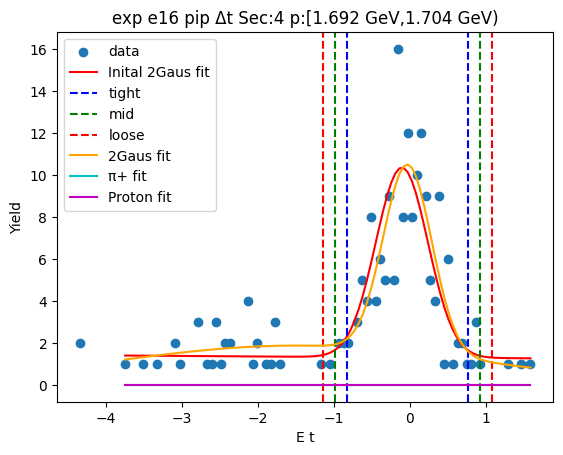

-0.9555569349011369 0.7794099090742269
-1.129053619298673 0.9529065934717632
-1.3025503036962096 1.1264032778692998
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


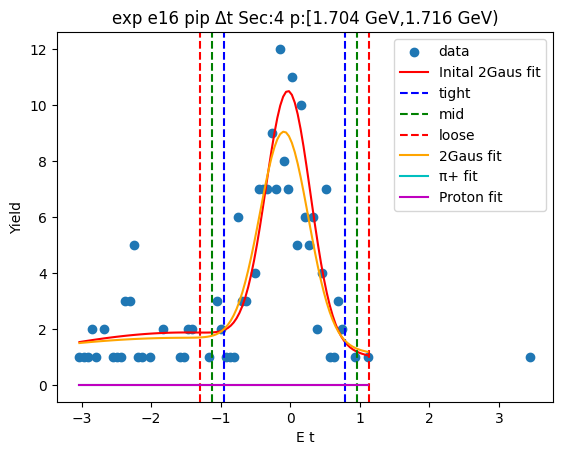

-1.0171898644722341 1.0865438773568104
-1.2275632386551387 1.296917251539715
-1.4379366128380433 1.5072906257226195
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


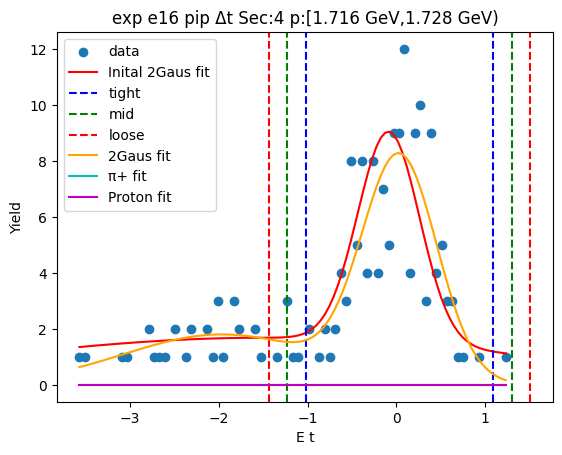

-1.2361057746184034 1.2728292437073052
-1.4869992764509743 1.523722745539876
-1.7378927782835452 1.774616247372447
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


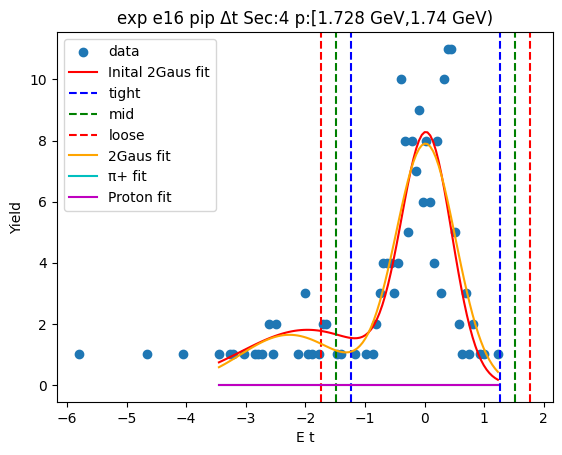

-1.0567216656582457 1.017168659394384
-1.2641106981635086 1.224557691899647
-1.4714997306687716 1.43194672440491
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


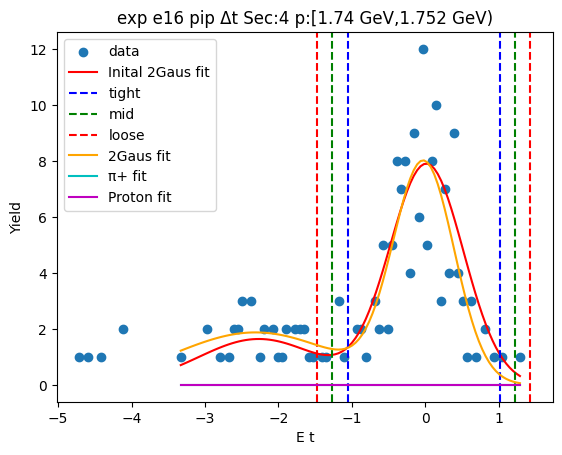

-1.0551535778902863 1.2059772149308967
-1.2812666571724045 1.432090294213015
-1.507379736454523 1.6582033734951334
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


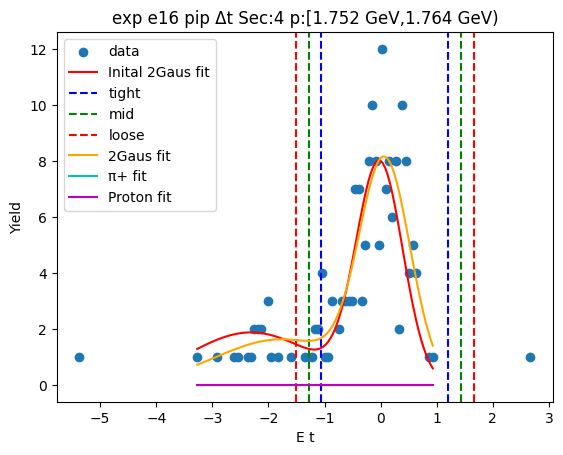

-1.1350930353368256 1.0256043544091826
-1.3511627743114265 1.2416740933837835
-1.5672325132860272 1.4577438323583842
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


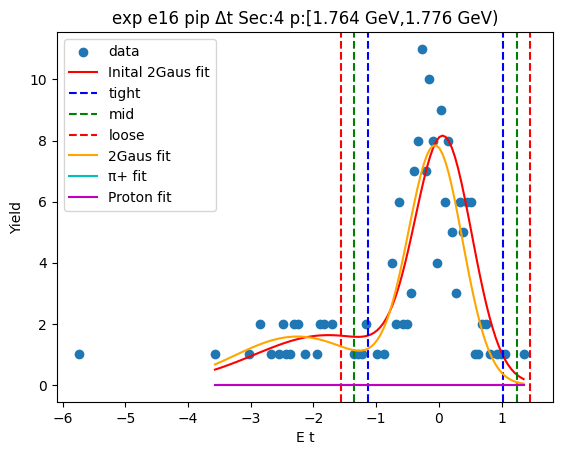

-1.2839626273370142 1.378285843941863
-1.550187474464902 1.644510691069751
-1.8164123215927899 1.9107355381976387
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


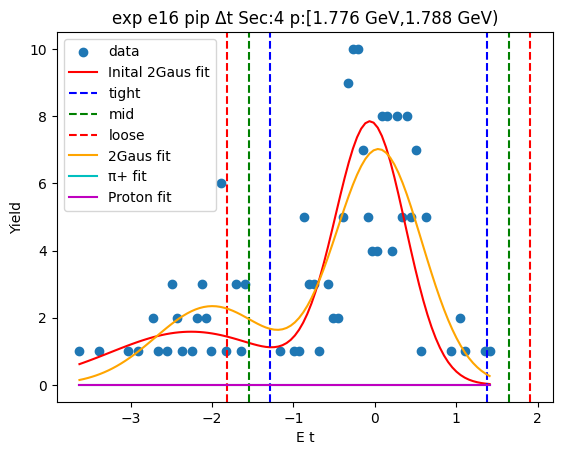

-1.1098752622654984 1.093705338408478
-1.330233322332896 1.3140633984758756
-1.5505913824002937 1.5344214585432734
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


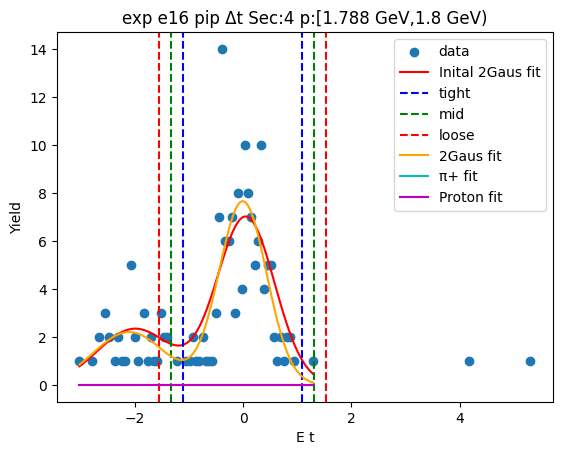

-0.776303562516842 0.7972289532993235
-0.9336568140984586 0.9545822048809401
-1.0910100656800752 1.1119354564625568
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


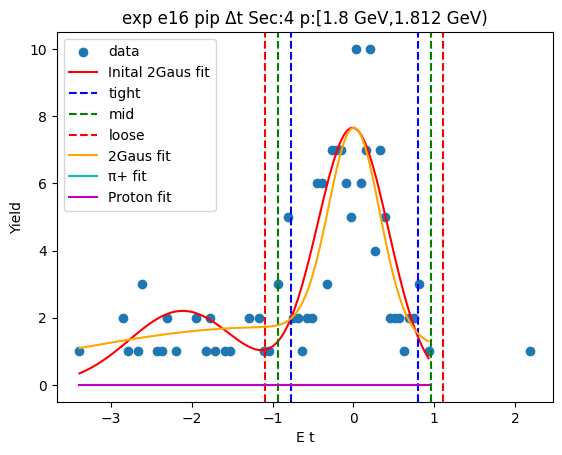

Runtime Error
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


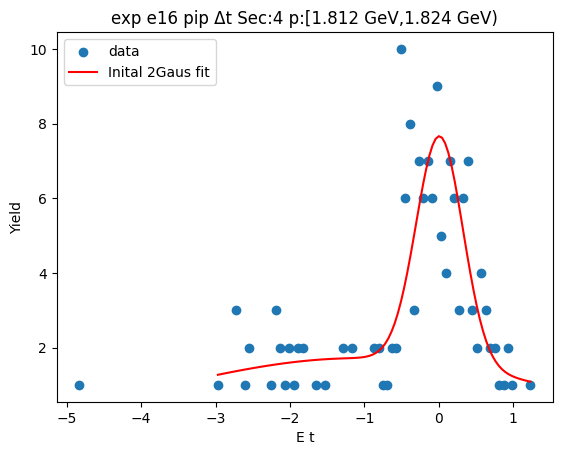

-0.9173658860496375 0.9212348543534671
-1.1012259600899479 1.1050949283937777
-1.2850860341302583 1.2889550024340881
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


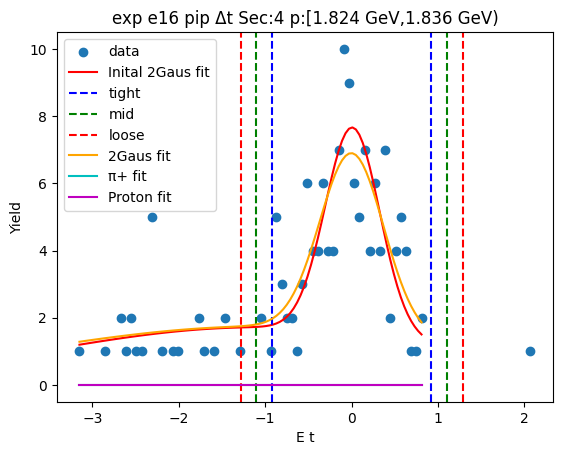

-1.131019412553012 0.9008568873246182
-1.334207042540775 1.1040445173123814
-1.5373946725285381 1.3072321473001445
[ 1.20183567e+01 -8.07650414e-03  3.88632263e-01]


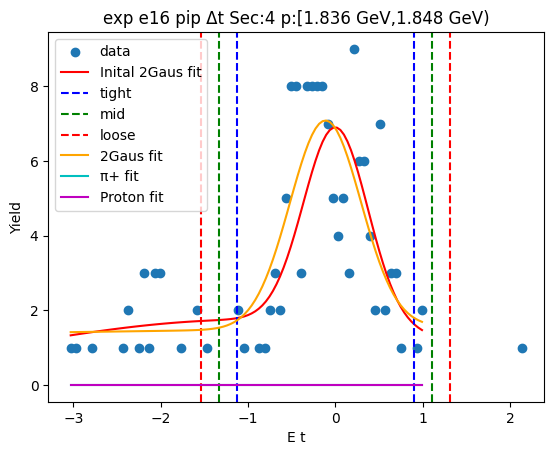

-0.9041556515096637 0.8801832421266572
-1.0825895408732957 1.058617131490289
-1.2610234302369279 1.2370510208539212
[ 3.57942590e+01 -1.19862047e-02  3.56867779e-01]


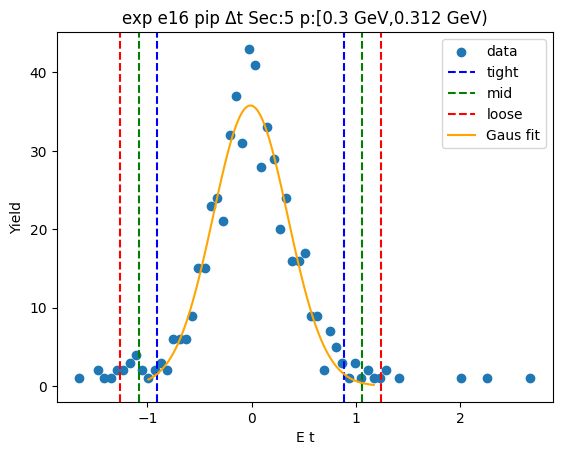

-0.9310363312978114 0.9286252912162845
-1.1170024935492209 1.114591453467694
-1.3029686558006306 1.3005576157191037
[ 2.90700775e+01 -1.20552004e-03  3.71932325e-01]


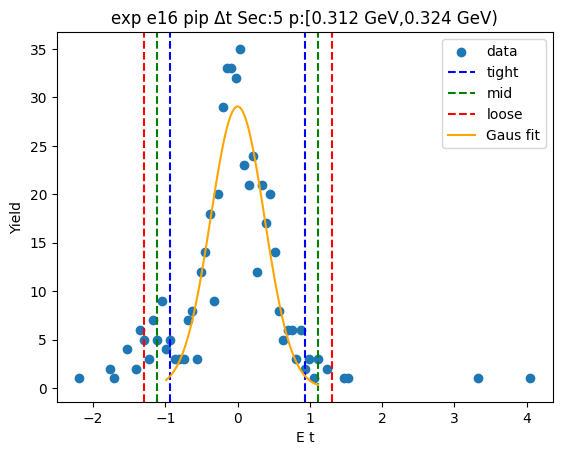

-0.9125531806333634 0.9313783333914339
-1.0969463320358432 1.115771484793914
-1.281339483438323 1.3001646361963937
[3.62525097e+01 9.41257638e-03 3.68786303e-01]


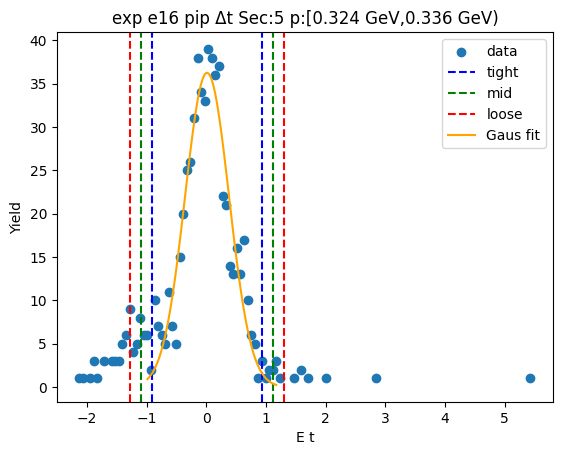

-0.9193331861570908 0.8744890080389742
-1.0987154055766972 1.0538712274585806
-1.2780976249963039 1.2332534468781873
[ 3.39044915e+01 -2.24220891e-02  3.58764439e-01]


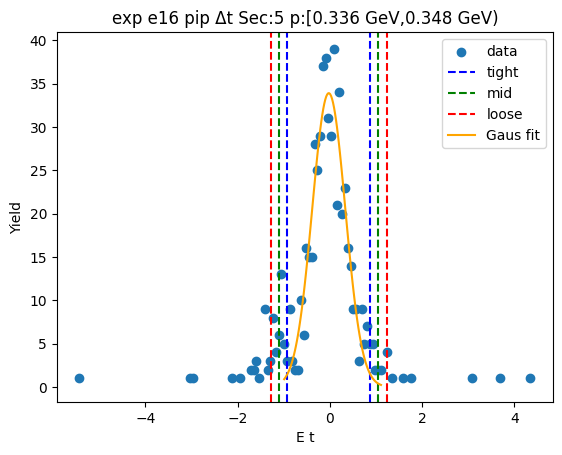

-0.9185301673135707 0.8116976448088583
-1.0915529485258135 0.9847204260211012
-1.2645757297380564 1.1577432072333442
[40.2619104  -0.05341626  0.34604556]


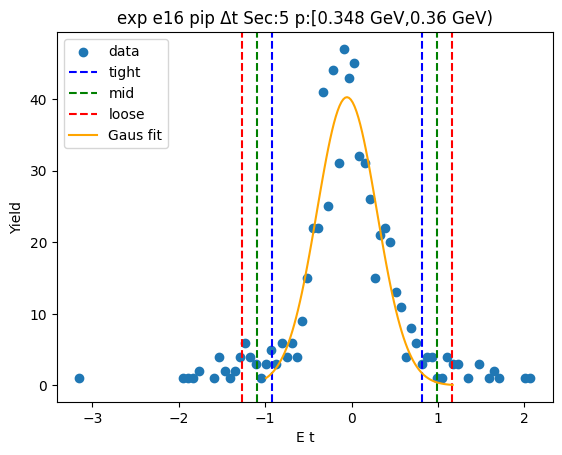

-0.8533134967247863 0.8333860749729923
-1.0219834538945642 1.0020560321427703
-1.190653411064342 1.1707259893125481
[ 3.94899657e+01 -9.96371088e-03  3.37339914e-01]


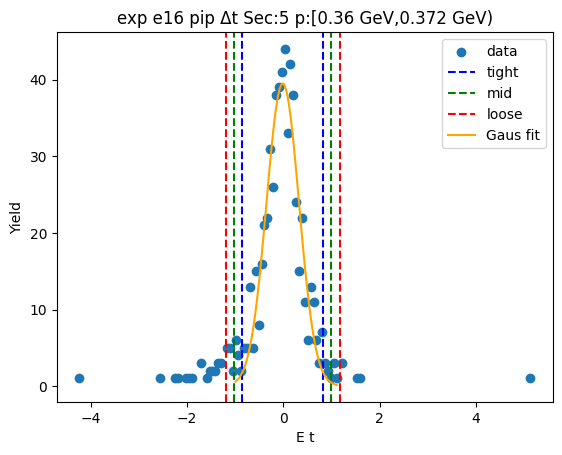

-0.8304086897386402 0.7894684186150696
-0.9923964005740111 0.9514561294504404
-1.1543841114093822 1.1134438402858116
[ 4.13246105e+01 -2.04701356e-02  3.23975422e-01]


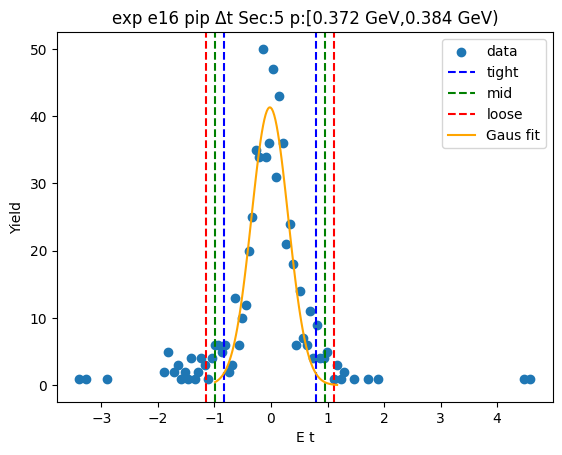

-0.8952461244737636 0.8038420481133727
-1.0651549417324773 0.9737508653720862
-1.235063758991191 1.1436596826307999
[41.27152599 -0.04570204  0.33981763]


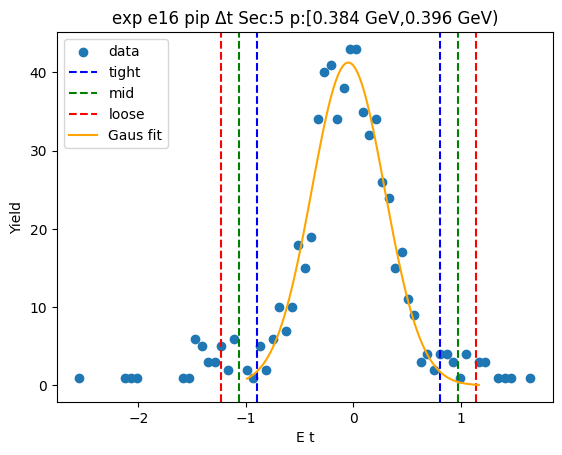

-0.8991091812883811 0.7273824688072628
-1.0617583462979456 0.8900316338168272
-1.22440751130751 1.0526807988263918
[40.24403184 -0.08586336  0.32529833]


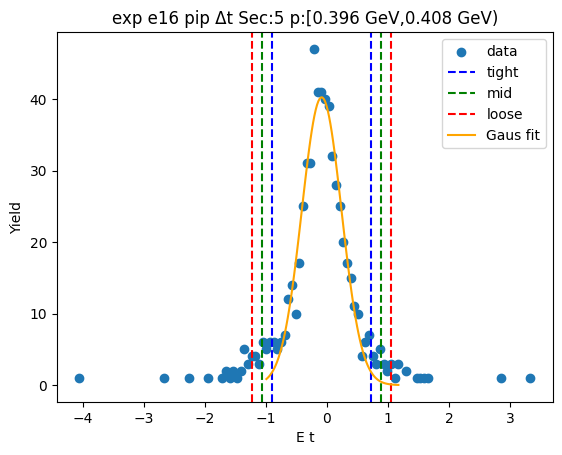

-0.9185941437063372 0.7863108663201581
-1.0890846447089868 0.9568013673228077
-1.2595751457116362 1.1272918683254571
[40.92676223 -0.06614164  0.340981  ]


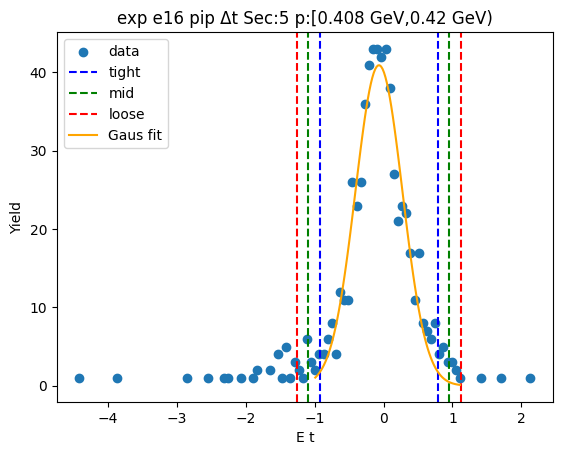

-0.9373037802863293 0.7635053671006988
-1.1073846950250321 0.9335862818394017
-1.277465609763735 1.1036671965781046
[46.60941114 -0.08689921  0.34016183]


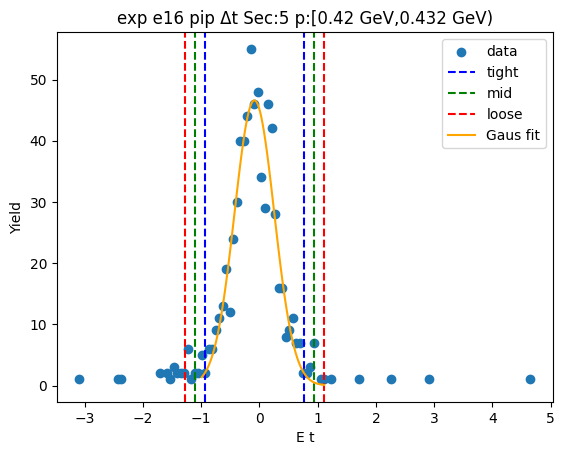

-0.9834162262913155 0.7788464331498224
-1.1596424922354291 0.955072699093936
-1.335868758179543 1.1312989650380498
[46.33660184 -0.1022849   0.35245253]


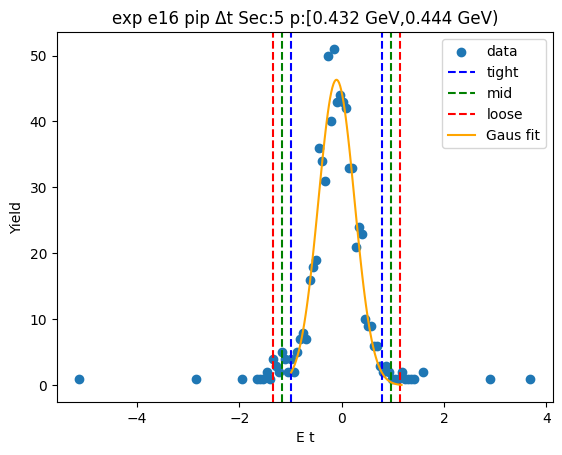

-0.9571246274926628 0.745866066600273
-1.1274236969019562 0.9161651360095664
-1.2977227663112498 1.08646420541886
[43.81047731 -0.10562928  0.34059814]


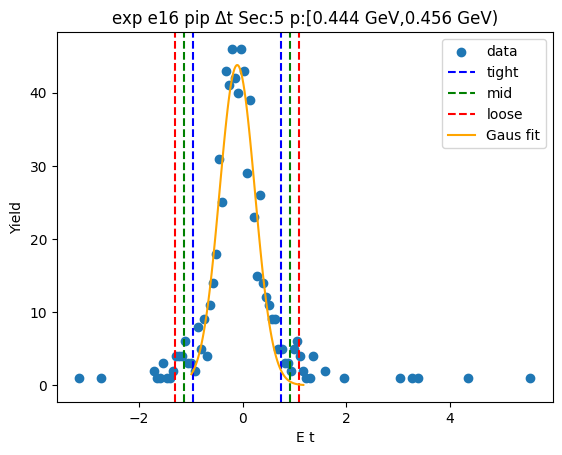

-1.0269163139143433 0.8457129667312392
-1.214179241978902 1.0329758947957974
-1.40144217004346 1.2202388228603556
[38.14650439 -0.09060167  0.37452586]


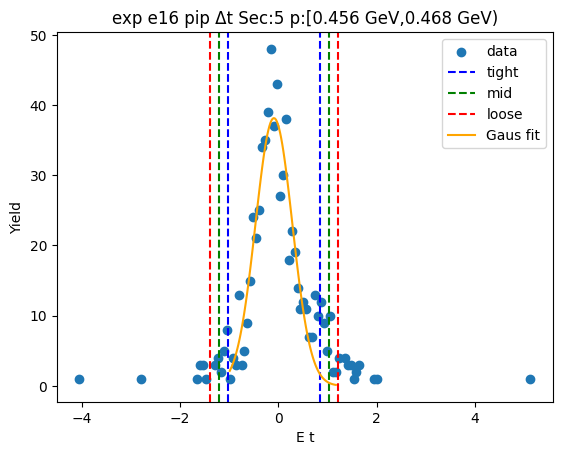

-1.2551825433786268 1.2458803044880618
-1.5052888281652956 1.4959865892747306
-1.7553951129519645 1.7460928740613995
[ 3.03305572e+01 -4.65111945e-03  5.00212570e-01]


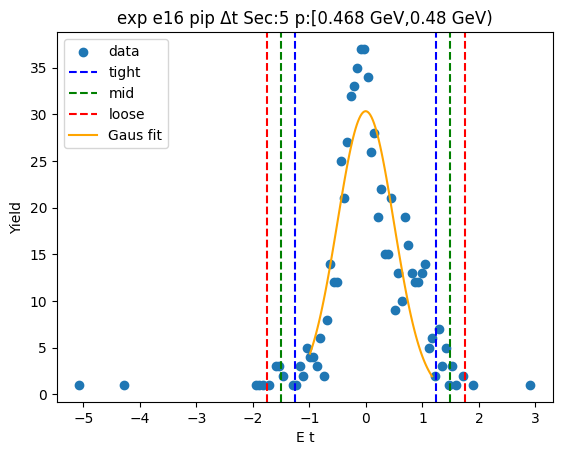

-1.3392716945168308 1.48305152686219
-1.6215040166547328 1.765283849000092
-1.9037363387926347 2.047516171137994
[28.96380334  0.07188992  0.56446464]


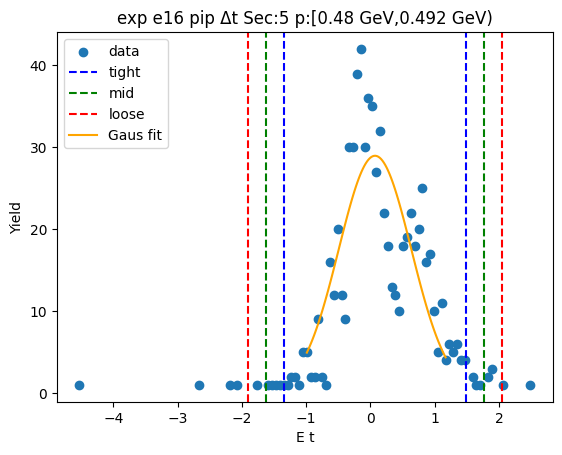

-1.5341338053057976 1.821300231188672
-1.8696772089552447 2.156843634838119
-2.2052206126046916 2.4923870384875655
[24.57594798  0.14358321  0.67108681]


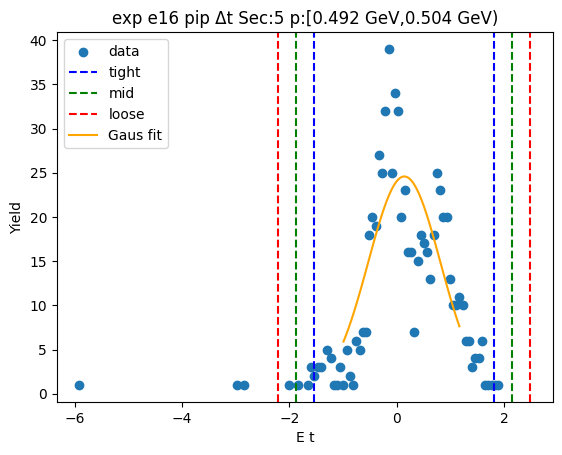

-1.425351362797018 1.815832484449791
-1.749469747521699 2.1399508691744717
-2.07358813224638 2.4640692538991527
[26.62814627  0.19524056  0.64823677]


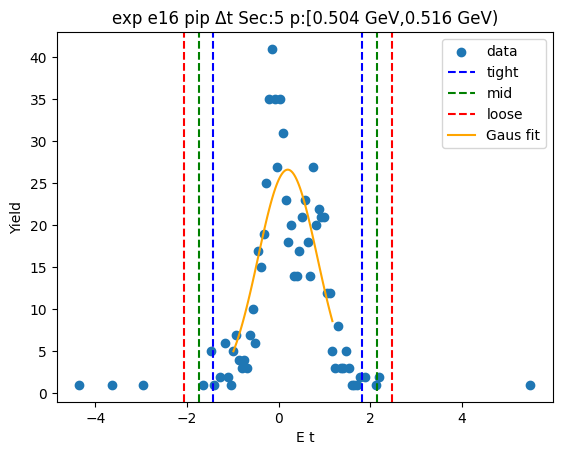

-1.516349796556158 1.9920765200720696
-1.8671924282189807 2.3429191517348924
-2.218035059881804 2.693761783397715
[26.46320283  0.23786336  0.70168526]


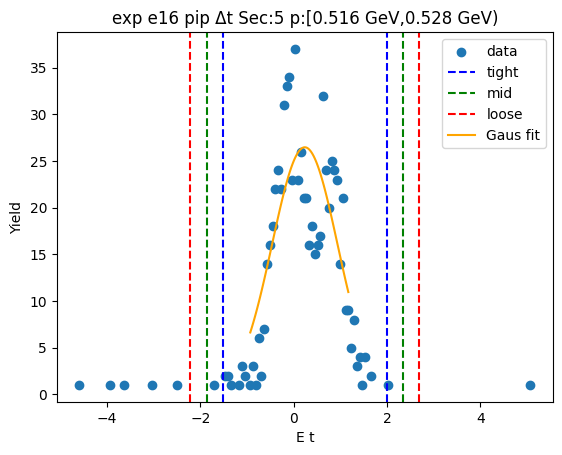

-1.5489152183144697 2.3138890305643676
-1.9351956432023534 2.7001694554522513
-2.321476068090237 3.086449880340135
[25.62212639  0.38248691  0.77256085]


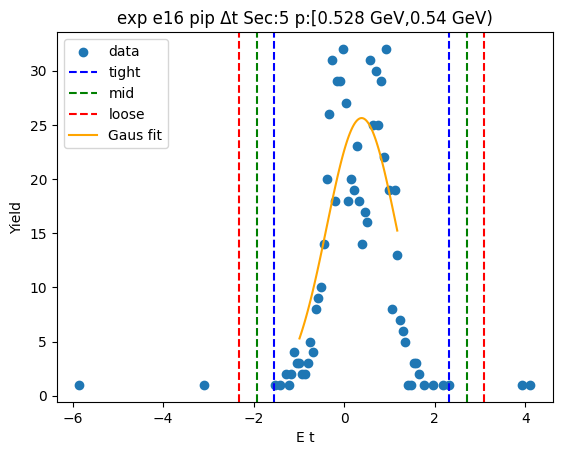

-1.381657196622865 1.9003800440190661
-1.7098609206870583 2.2285837680832596
-2.038064644751251 2.5567874921474525
[26.37575031  0.25936142  0.65640745]


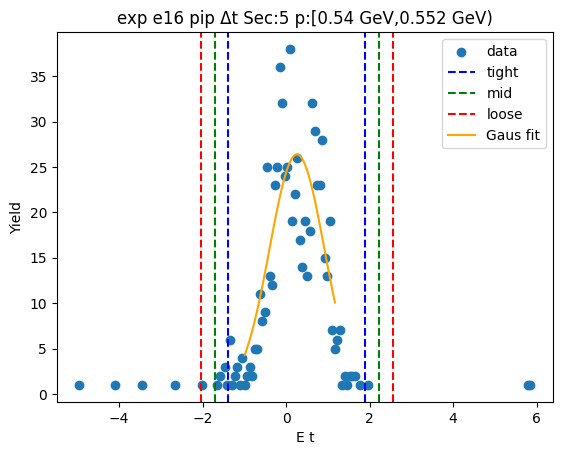

-1.3190812857476233 1.6536856363449528
-1.616357977956881 1.9509623285542106
-1.9136346701661386 2.248239020763468
[29.53436529  0.16730218  0.59455338]


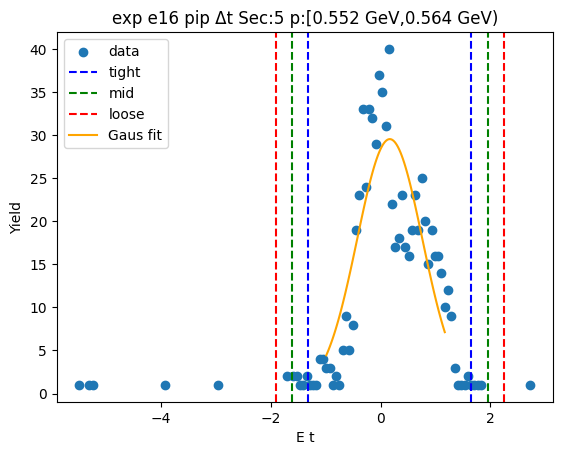

-1.2797249330920821 1.5118653276224623
-1.5588839591635364 1.7910243536939165
-1.8380429852349909 2.070183379765371
[28.26011023  0.1160702   0.55831805]


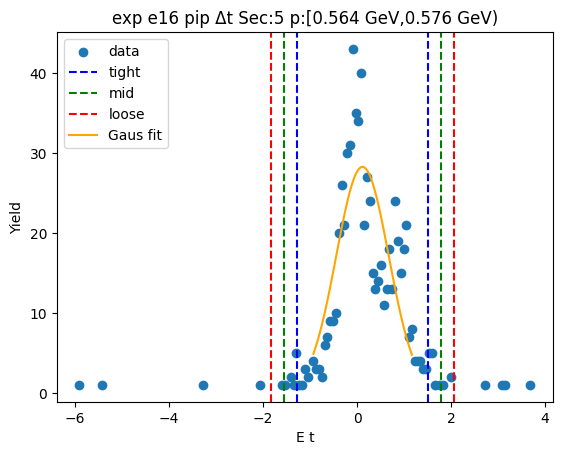

-1.2919497336874055 1.5498067003841836
-1.5761253770945642 1.8339823437913423
-1.8603010205017232 2.1181579871985012
[29.32844964  0.12892848  0.56835129]


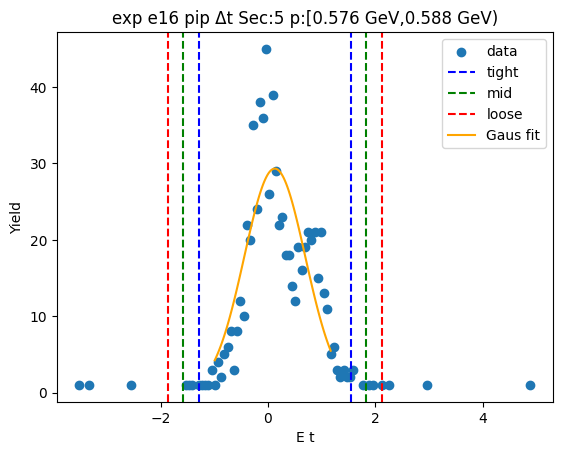

-1.1270989679957397 1.4307914260552947
-1.382888007400843 1.6865804654603984
-1.6386770468059466 1.9423695048655016
[28.01318359  0.15184623  0.51157808]


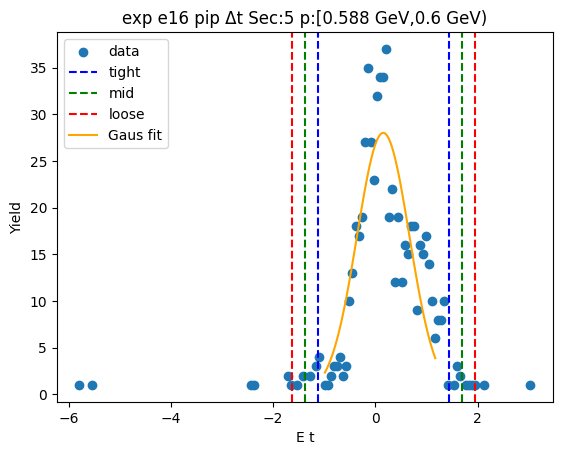

-1.1271892246074802 1.3401857365843273
-1.373926720726661 1.586923232703508
-1.6206642168458416 1.8336607288226887
[29.32008875  0.10649826  0.49347499]


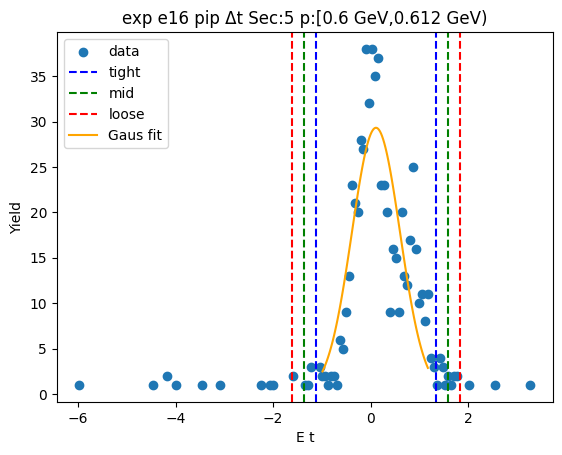

-1.0372253343162101 1.2408127054181928
-1.2650291382896506 1.4686165093916332
-1.4928329422630908 1.6964203133650735
[30.42565253  0.10179369  0.45560761]


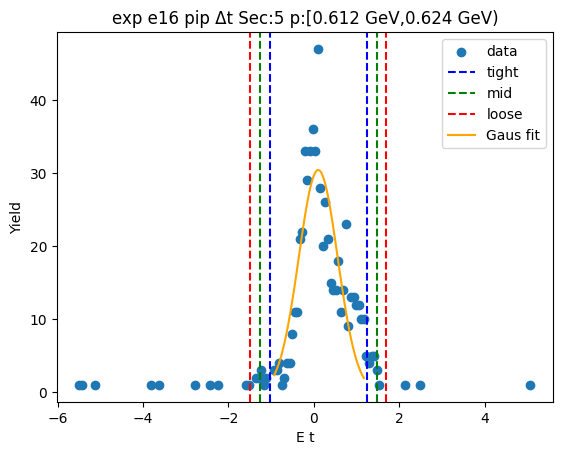

-1.0873881102934932 1.3623944671957369
-1.3323663680424165 1.6073727249446597
-1.5773446257913393 1.852350982693583
[31.18765749  0.13750318  0.48995652]


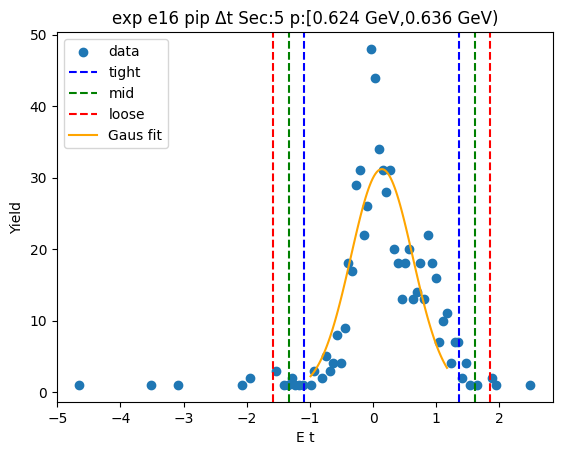

-1.0043708499503137 1.3003138490122133
-1.2348393198465664 1.530782318908466
-1.465307789742819 1.7612507888047186
[30.70162076  0.1479715   0.46093694]


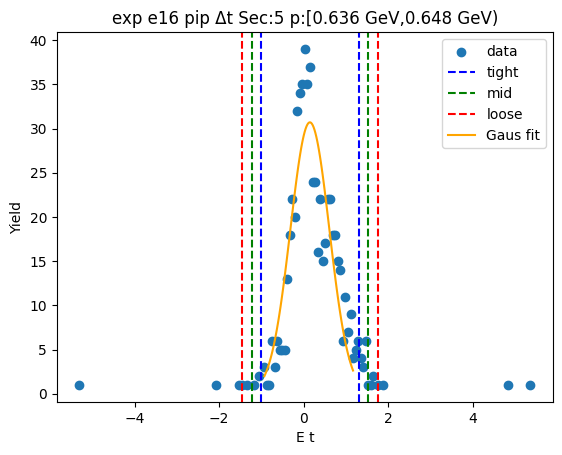

-1.0869672541428828 1.3985497619732121
-1.3355189557544924 1.6471014635848213
-1.5840706573661016 1.895653165196431
[27.98591102  0.15579125  0.4971034 ]


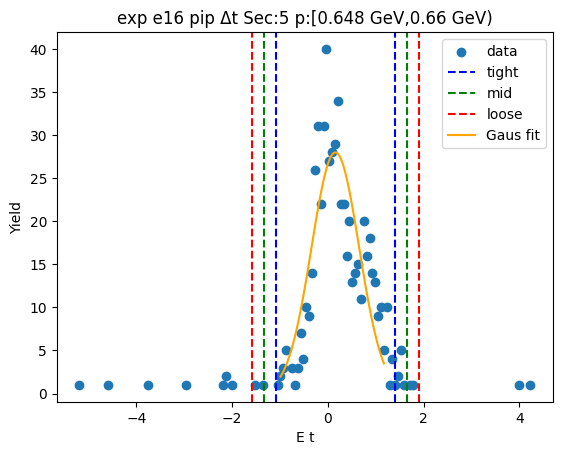

-1.0484273403205908 1.220114853404359
-1.275281559693086 1.4469690727768543
-1.502135779065581 1.6738232921493492
[30.56925561  0.08584376  0.45370844]


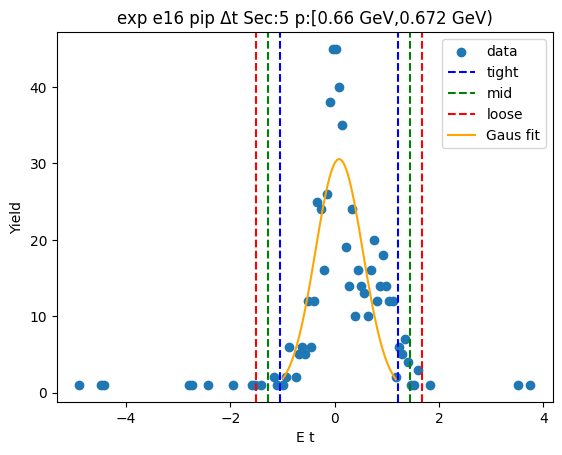

-1.20631343504174 1.3648824753904194
-1.4634330260849557 1.6220020664336352
-1.7205526171281715 1.879121657476851
[28.02349168  0.07928452  0.51423918]


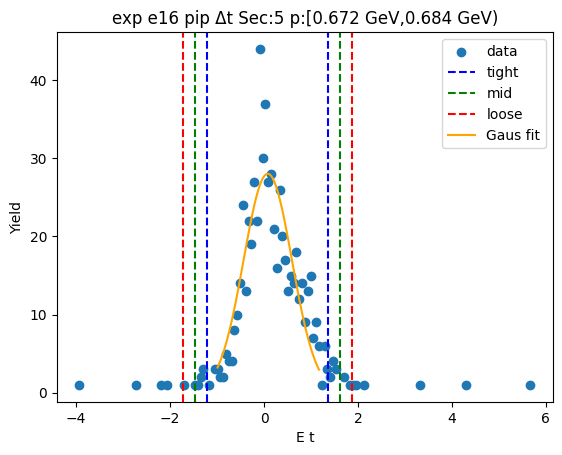

-1.1585370637226162 1.2223102843947793
-1.3966217985343556 1.4603950192065187
-1.634706533346095 1.6984797540182581
[27.47645564  0.03188661  0.47616947]


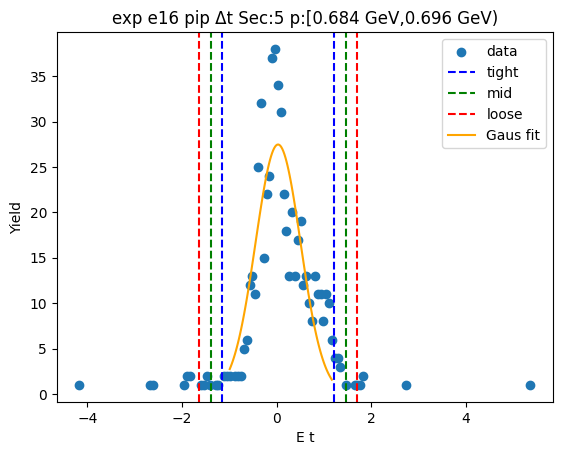

-1.1694540268719014 1.1966544807869999
-1.4060648776377915 1.43326533155289
-1.6426757284036817 1.6698761823187802
[2.54302009e+01 1.36002270e-02 4.73221702e-01]


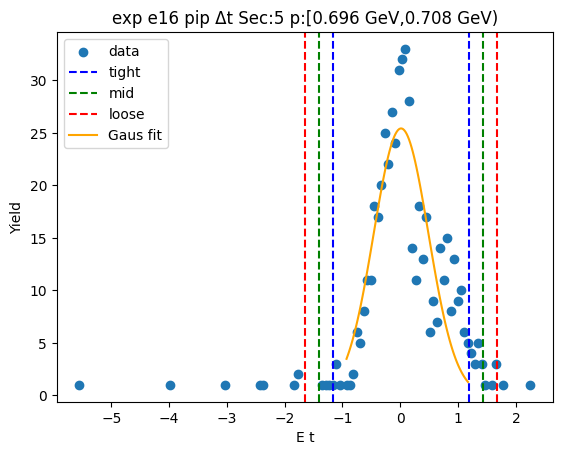

-1.2399115869484882 1.423203515330993
-1.5062230971764365 1.6895150255589413
-1.7725346074043846 1.9558265357868894
[24.54994564  0.09164596  0.53262302]


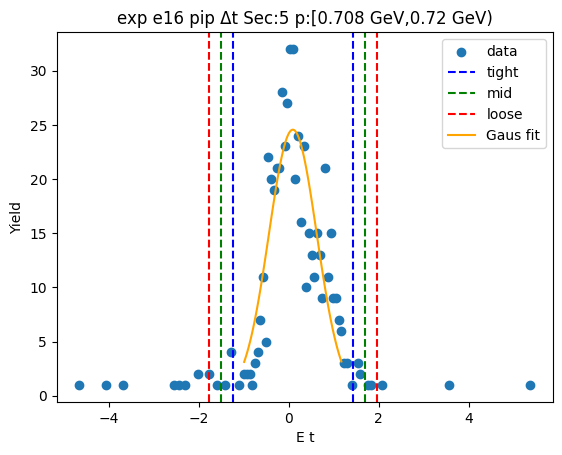

-1.2709187597103462 1.4115421878939025
-1.5391648544707712 1.6797882826543276
-1.807410949231196 1.9480343774147524
[24.62301172  0.07031171  0.53649219]


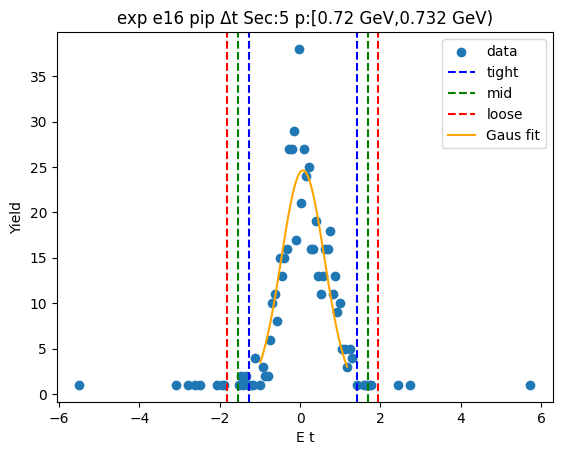

-1.1601966929599117 1.267126038857302
-1.402928966141633 1.5098583120390234
-1.6456612393233545 1.7525905852207448
[24.25371108  0.05346467  0.48546455]


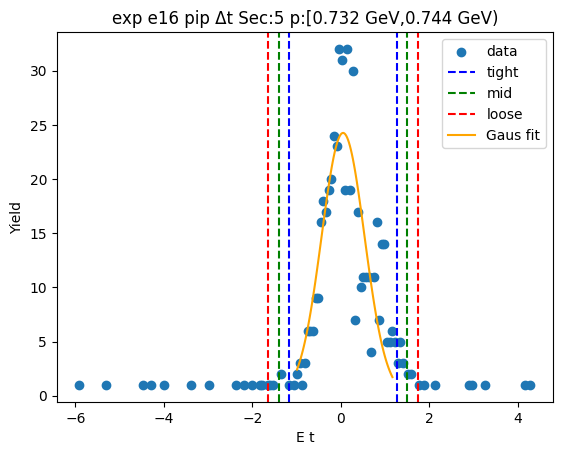

-1.0558230661630843 1.2297058064782525
-1.2843759534272179 1.458258693742386
-1.5129288406913517 1.6868115810065198
[26.18782854  0.08694137  0.45710577]


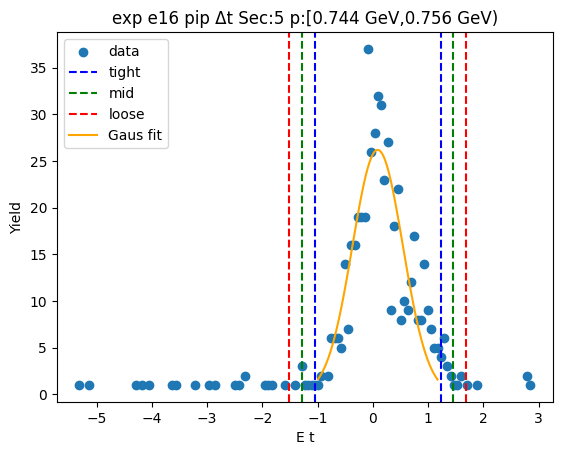

-1.0710034885236857 1.254735075910689
-1.303577344967123 1.4873089323541264
-1.5361512014105605 1.7198827887975638
[27.22158118  0.09186579  0.46514771]


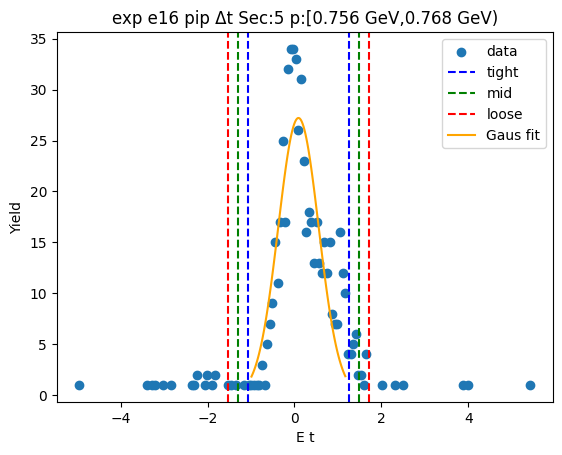

-1.1351073569812309 1.3293984802398011
-1.3815579407033343 1.5758490639619045
-1.6280085244254374 1.8222996476840077
[22.76195051  0.09714556  0.49290117]


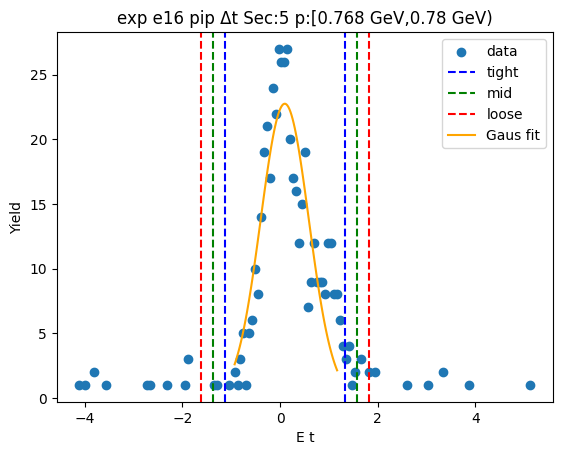

-1.1425810729796164 1.321402482289761
-1.388979428506554 1.5678008378166985
-1.6353777840334918 1.8141991933436363
[23.70482953  0.0894107   0.49279671]


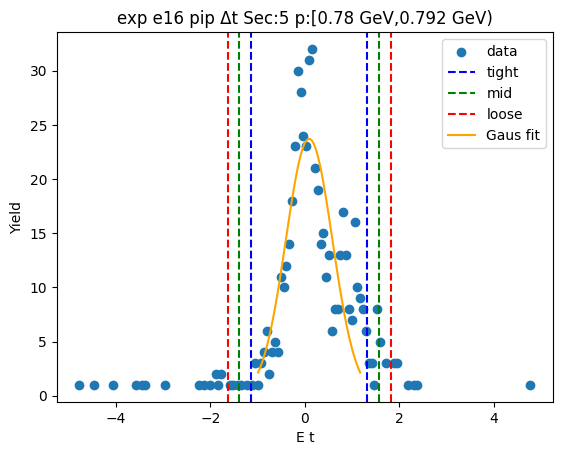

-1.1373429493313214 1.4452172347875063
-1.3955989677432044 1.7034732531993892
-1.653854986155087 1.961729271611272
[21.13688856  0.15393714  0.51651204]


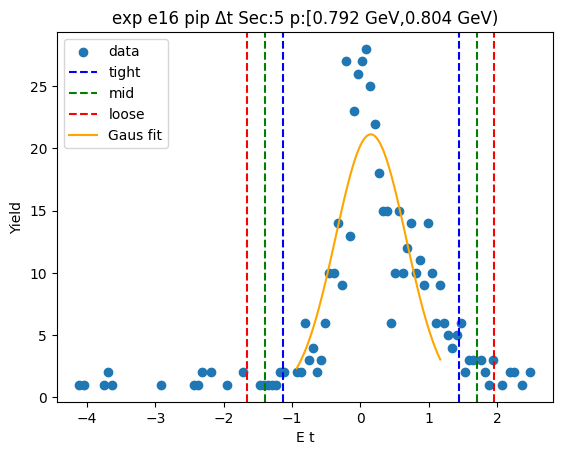

-1.2333197086337473 1.475201772240559
-1.504171856721178 1.7460539203279897
-1.7750240048086086 2.0169060684154205
[21.29351648  0.12094103  0.5417043 ]


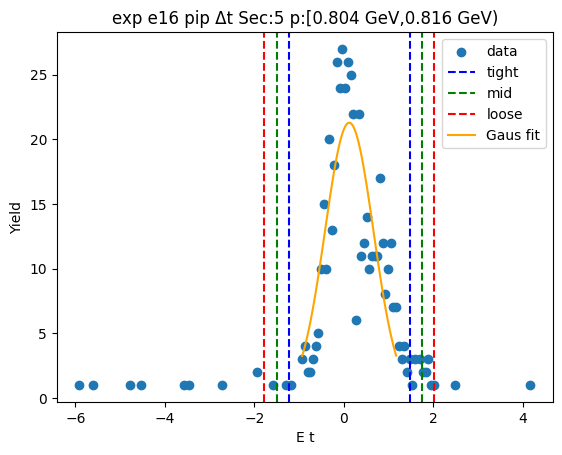

-1.2147086653445796 1.4772207806859254
-1.4839016099476299 1.7464137252889758
-1.7530945545506804 2.0156066698920263
[19.68172119  0.13125606  0.53838589]


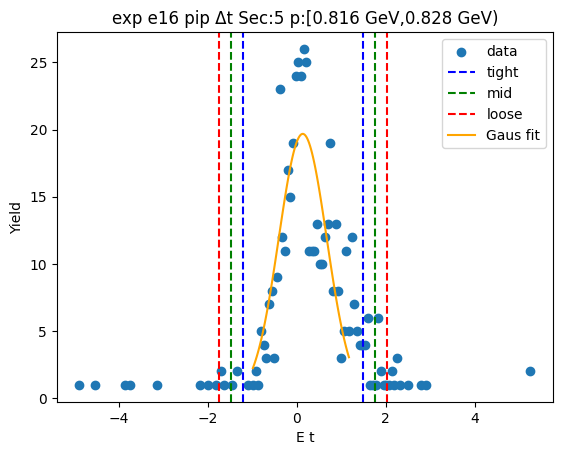

-1.3353143999998747 1.5252568558139343
-1.6213715255812557 1.8113139813953154
-1.9074286511626366 2.0973711069766963
[19.37028599  0.09497123  0.57211425]


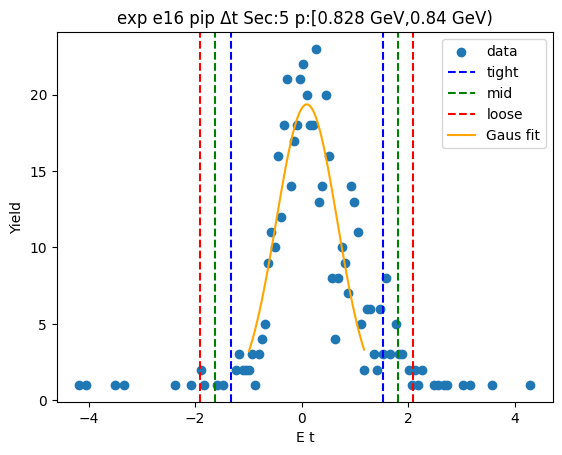

-1.1498581077037506 1.3197865734716727
-1.396822575821293 1.5667510415892152
-1.6437870439388356 1.8137155097067577
[20.28887283  0.08496423  0.49392894]


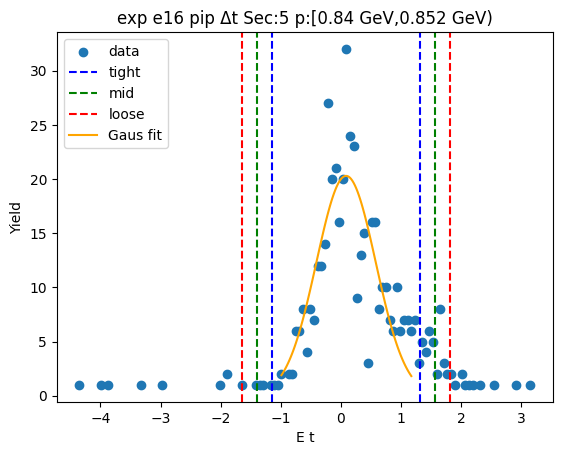

-1.4302695583619778 1.729918197768251
-1.7462883339750008 2.045936973381274
-2.0623071095880237 2.361955748994297
[17.18135159  0.14982432  0.63203755]


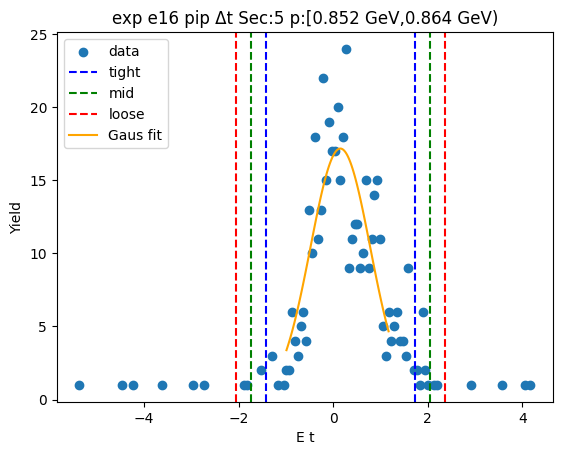

-1.507230023595574 1.6414130019145612
-1.8220943261465874 1.9562773044655746
-2.136958628697601 2.2711416070165877
[17.19737542  0.06709149  0.62972861]


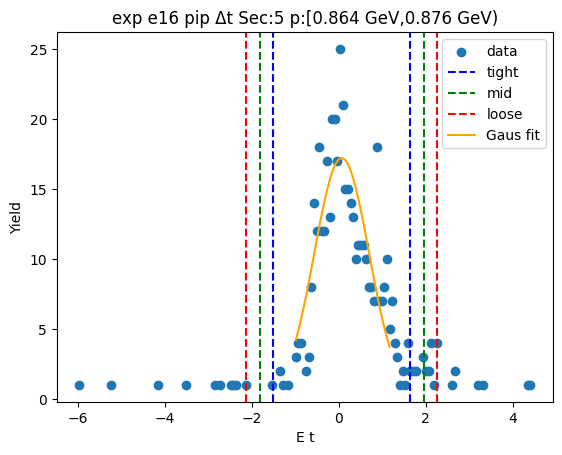

-1.4905705777107265 1.5760002330649103
-1.79722765878829 1.8826573141424738
-2.103884739865854 2.1893143952200376
[17.3316629   0.04271483  0.61331416]


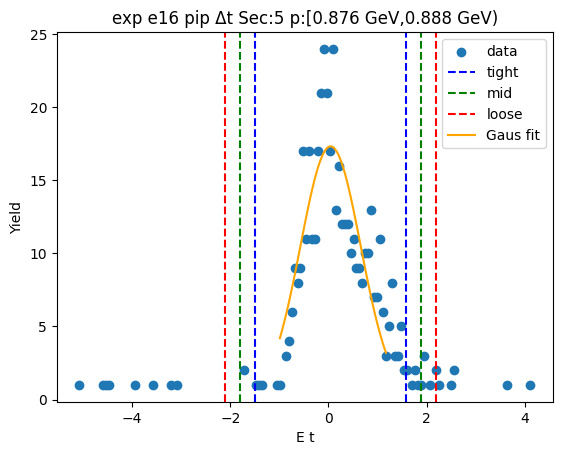

-1.4355682651728723 1.5370780852159045
-1.73283290021175 1.8343427202547822
-2.0300975352506274 2.13160735529366
[15.9428032   0.05075491  0.59452927]


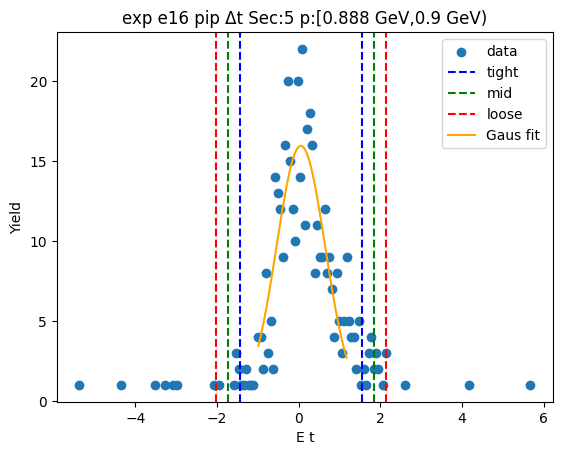

-1.3654244051053719 1.3867698556192187
-1.640643831177831 1.661989281691678
-1.9158632572502903 1.9372087077641371
[1.65159179e+01 1.06727253e-02 5.50438852e-01]


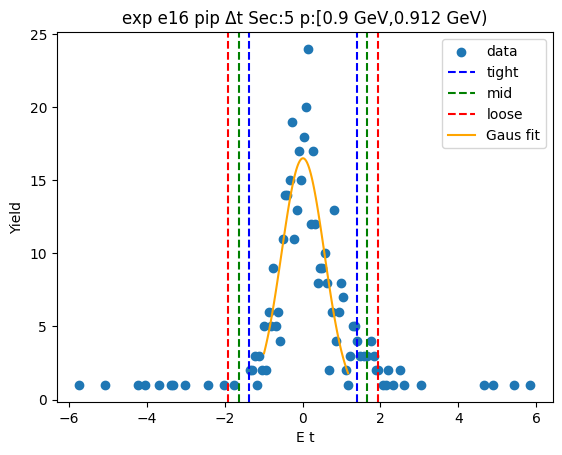

-1.4196190743104349 1.448133057080638
-1.7063942874495424 1.7349082702197456
-1.9931695005886496 2.021683483358853
[1.76663712e+01 1.42569914e-02 5.73550426e-01]


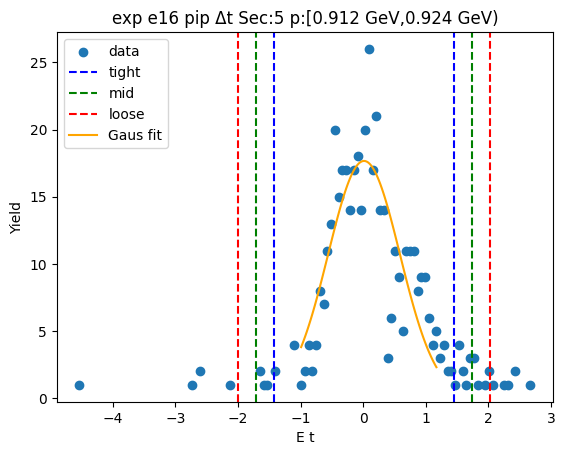

-1.651876205308758 1.6561346757695554
-1.982677293416589 1.9869357638773866
-2.3134783815244204 2.317736851985218
[1.42701102e+01 2.12923523e-03 6.61602176e-01]


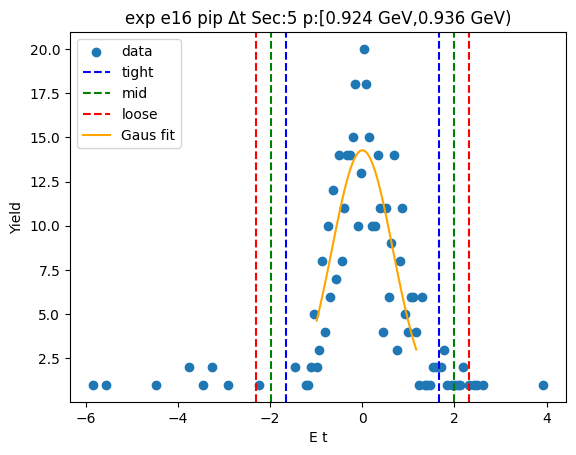

-1.602032731641661 1.4618912206552186
-1.9084251268713492 1.7682836158849065
-2.214817522101037 2.0746760111145948
[13.48037275 -0.07007076  0.61278479]


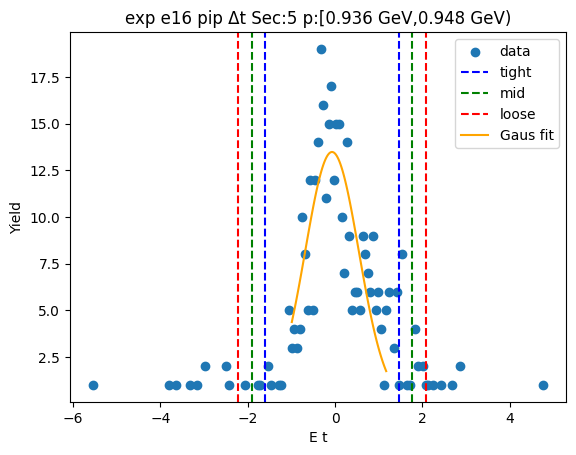

-1.6445756786922816 1.369383371065065
-1.9459715836680163 1.6707792760407996
-2.247367488643751 1.9721751810165342
[14.49626504 -0.13759615  0.60279181]


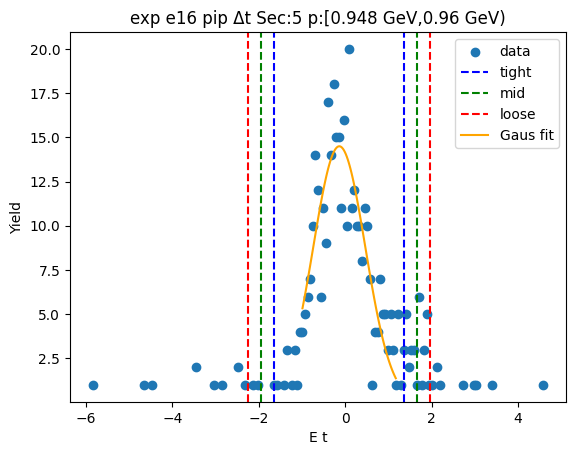

-1.3520851533486504 1.0865771674656397
-1.5959513854300795 1.3304433995470688
-1.8398176175115084 1.5743096316284977
[16.08861374 -0.13275399  0.48773246]


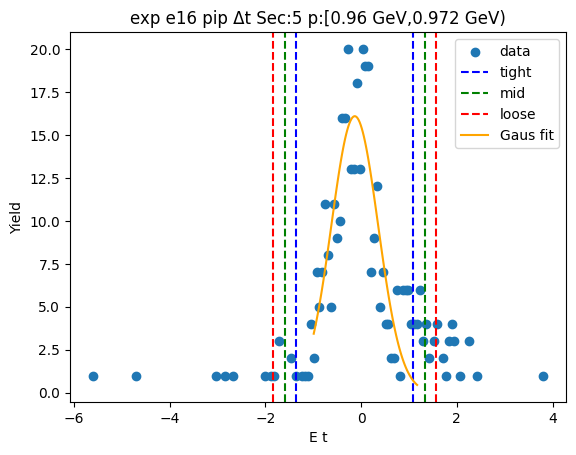

-1.6652771473593886 1.6598412116328924
-1.9977889832586169 1.9923530475321207
-2.330300819157845 2.3248648834313483
[ 1.38551285e+01 -2.71796786e-03  6.65023672e-01]


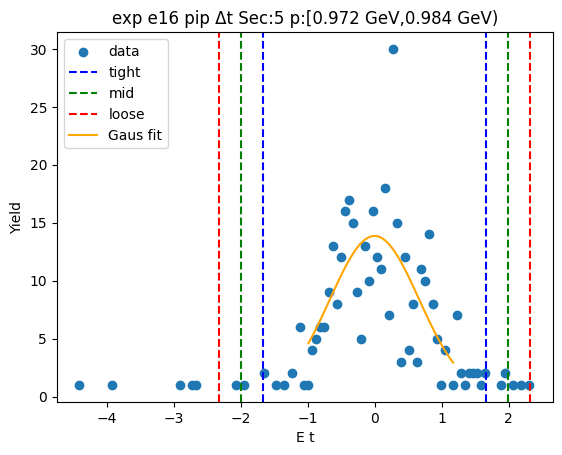

-1.6022528325903385 1.2251916347229534
-1.8849972793216678 1.5079360814542828
-2.167741726052997 1.790680528185612
[13.50037004 -0.1885306   0.56548889]


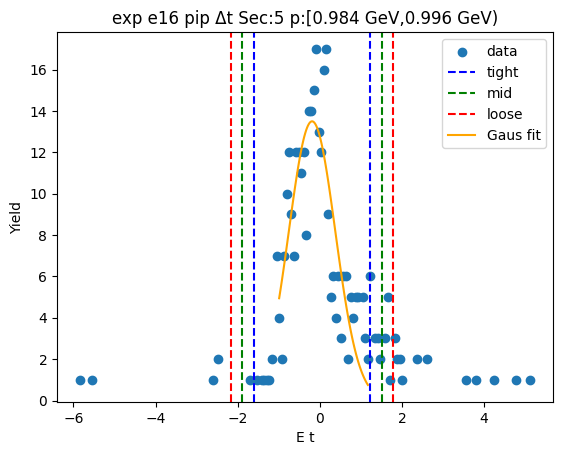

-1.4885291872199355 1.2940681561540017
-1.7667889215573291 1.5723278904913953
-2.045048655894723 1.850587624828789
[14.09027449 -0.09723052  0.55651947]


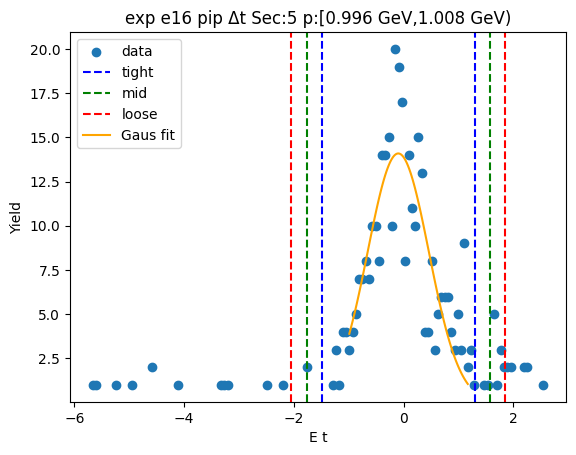

-1.682618306286708 1.2455777807779242
-1.9754379149931713 1.5383973894843876
-2.2682575236996345 1.8312169981908508
[12.4850984  -0.21852026  0.58563922]


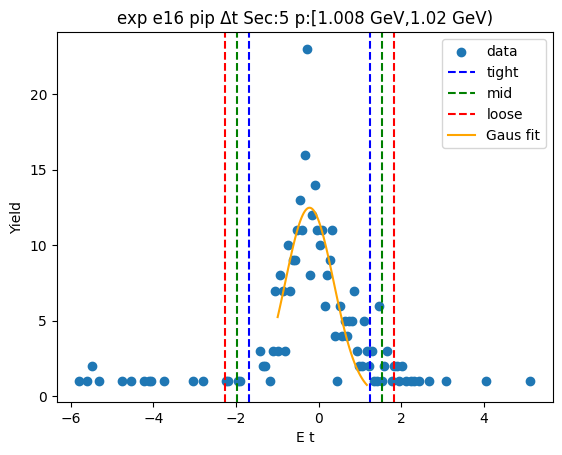

-1.619755071755764 1.4594286106378918
-1.9276734399951296 1.7673469788772573
-2.235591808234495 2.075265347116623
[12.49118131 -0.08016323  0.61583674]


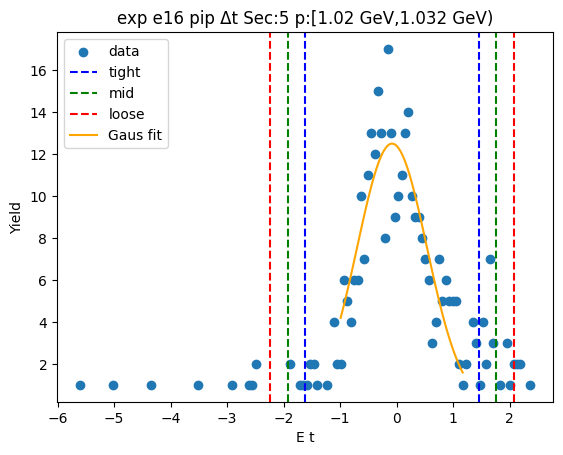

-1.620542163726286 1.4253480438248192
-1.9251311844813965 1.7299370645799297
-2.2297202052365073 2.03452608533504
[13.35617433 -0.09759706  0.60917804]


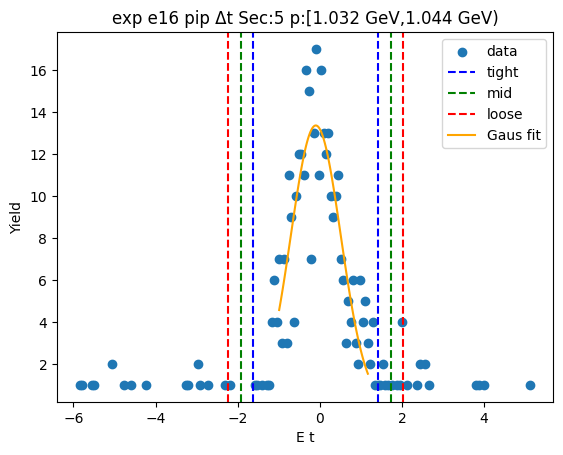

-1.4629070407768303 1.460142318163352
-1.7552119766708487 1.7524472540573703
-2.0475169125648667 2.0447521899513883
[ 1.18975381e+01 -1.38236131e-03  5.84609872e-01]


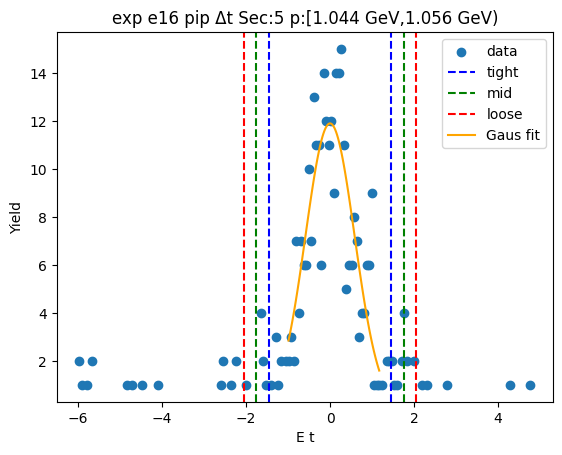

-1.5011728299365052 1.3369488077919907
-1.7849849937093547 1.6207609715648401
-2.068797157482204 1.9045731353376896
[12.55163334 -0.08211201  0.56762433]


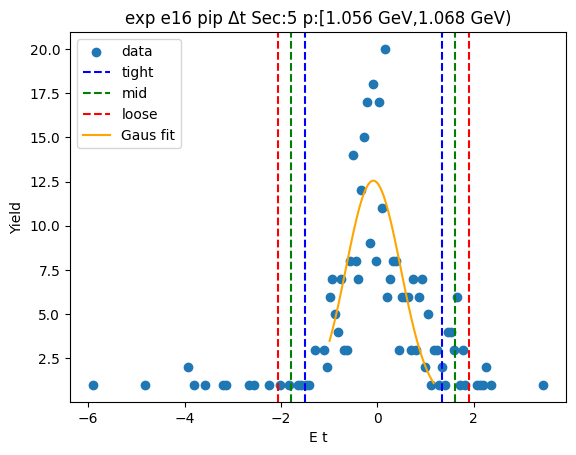

-1.7267889638850638 1.3809447983575573
-2.037562340109326 1.6917181745818193
-2.3483357163335876 2.0024915508060817
[11.92456873 -0.17292208  0.62154675]


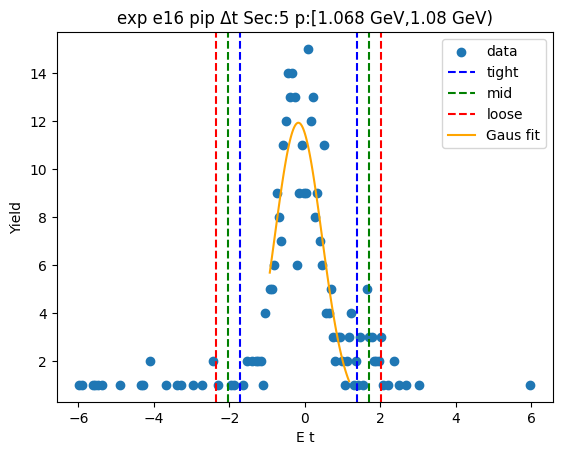

-1.602448347025841 1.2474260376223072
-1.887435785490656 1.5324134760871222
-2.172423223955471 1.817400914551937
[11.78974947 -0.17751115  0.56997488]


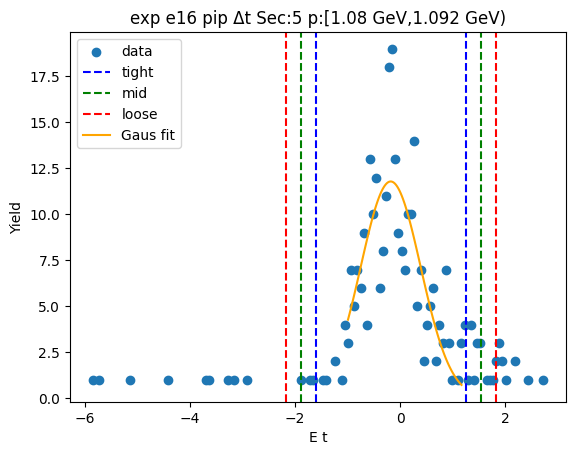

-1.9856996930061879 1.6791488860700872
-2.3521845509138157 2.045633743977715
-2.718669408821443 2.4121186018853424
[10.76397406 -0.1532754   0.73296972]


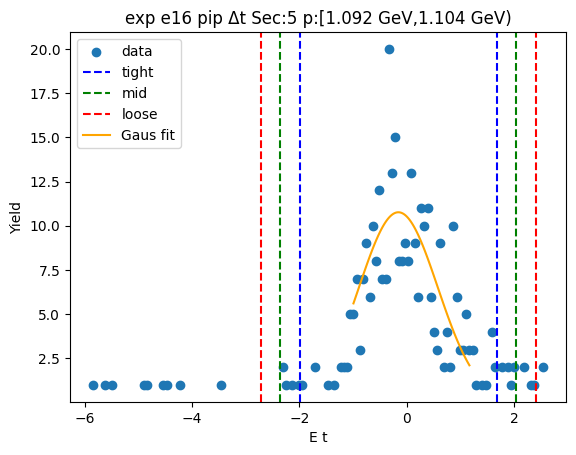

-1.618294779736246 1.3033805148611224
-1.910462309195983 1.5955480443208594
-2.2026298386557195 1.887715573780596
[12.13141327 -0.15745713  0.58433506]


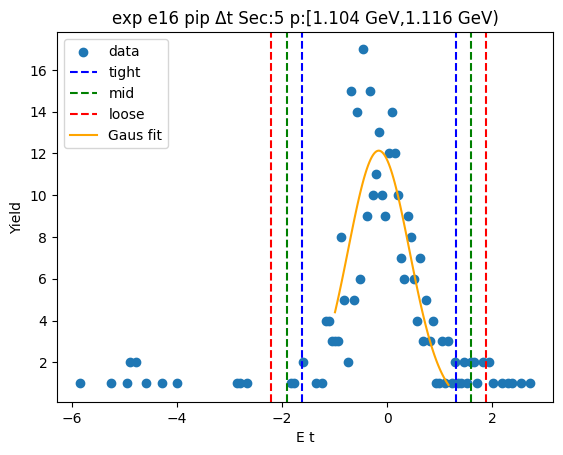

-1.7177041563689448 1.5019071873751506
-2.0396652907433546 1.82386832174956
-2.3616264251177643 2.1458294561239697
[11.27348645 -0.10789848  0.64392227]


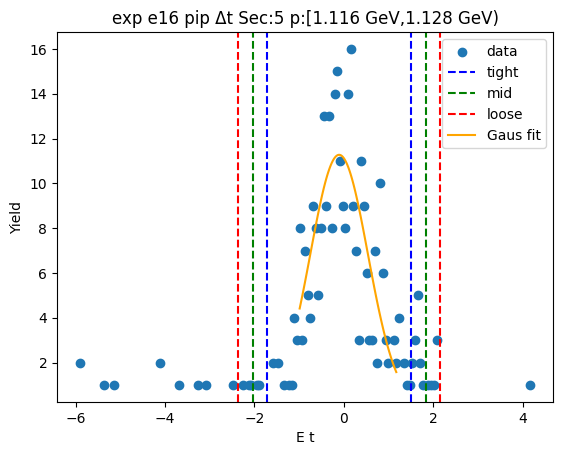

-2.0458239307037354 1.6450096108971202
-2.414907284863821 2.0140929650572055
-2.7839906390239064 2.383176319217291
[ 9.74046713 -0.20040716  0.73816671]


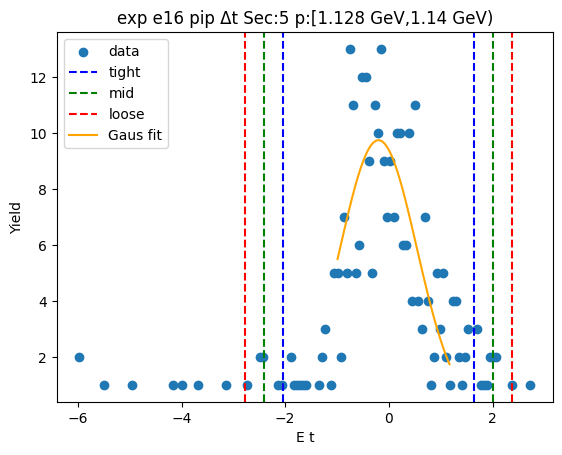

-1.71248716140042 1.5168723639012276
-2.035423113930585 1.8398083164313925
-2.35835906646075 2.162744268961557
[ 9.46059114 -0.0978074   0.64587191]


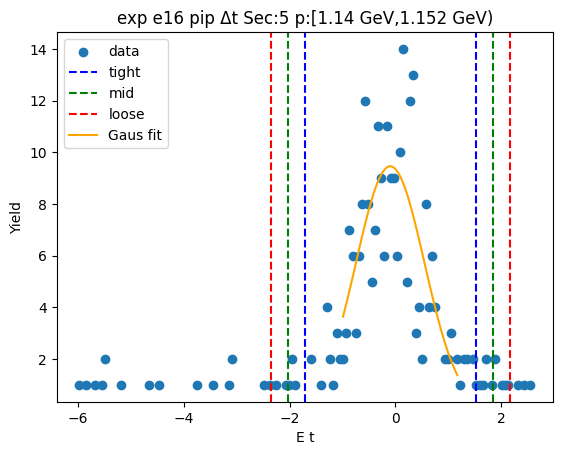

-2.18320912755179 1.6401767766274165
-2.565547717969711 2.0225153670453375
-2.9478863083876314 2.404853957463258
[ 9.22644014 -0.27151618  0.76467718]


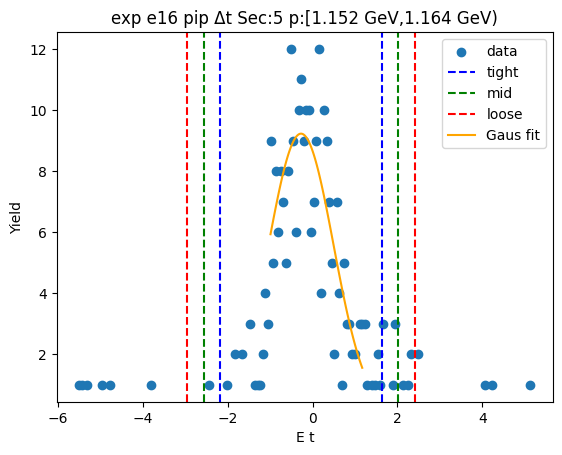

-2.541970286611929 1.8531535706859348
-2.981482672341715 2.292665956415721
-3.4209950580715014 2.7321783421455073
[ 7.85284077 -0.34440836  0.87902477]


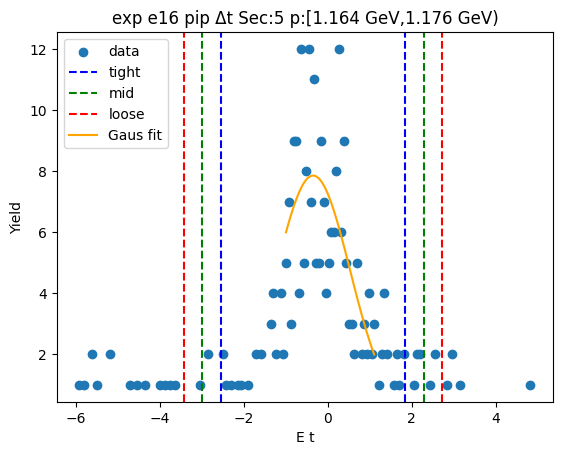

-1.5507032156686429 1.3106185083145818
-1.8368353880669652 1.5967506807129042
-2.1229675604652876 1.8828828531112265
[ 9.2595829  -0.12004235  0.57226434]


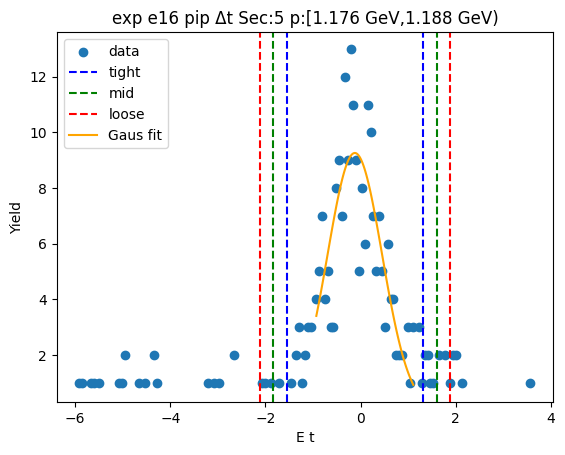

-1.6949107328872581 1.3248128563006638
-1.9968830918060503 1.6267852152194564
-2.2988554507248424 1.9287575741382486
[10.42091275 -0.18504894  0.60394472]


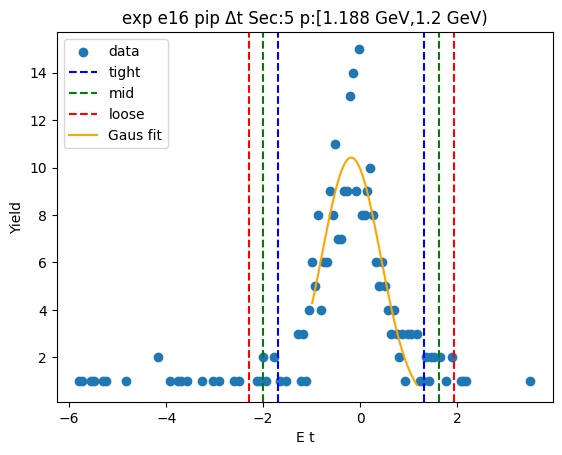

-1.4808075146777304 1.2882963239267171
-1.7577178985381752 1.5652067077871619
-2.0346282823986197 1.8421170916476066
[10.0755822  -0.0962556   0.55382077]


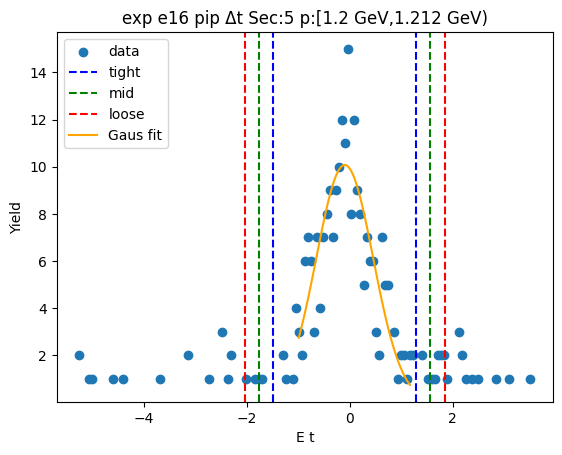

-2.1648023761269553 1.5361058922797801
-2.534893202967629 1.9061967191204539
-2.9049840298083027 2.2762875459611274
[ 8.51810569 -0.31434824  0.74018165]


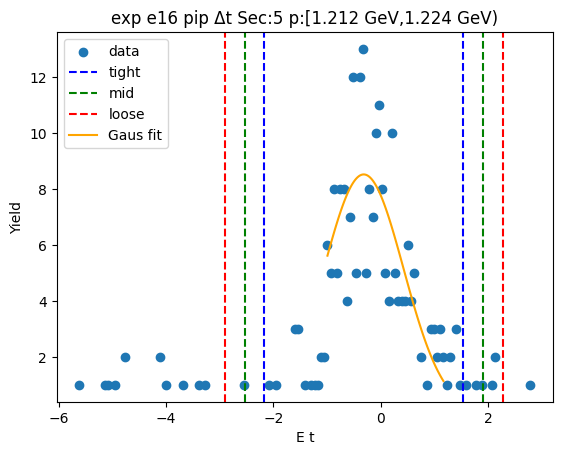

-1.7381135905371496 1.2999737386639532
-2.04192232345726 1.6037824715840636
-2.34573105637737 1.9075912045041736
[ 8.76117832 -0.21906993  0.60761747]


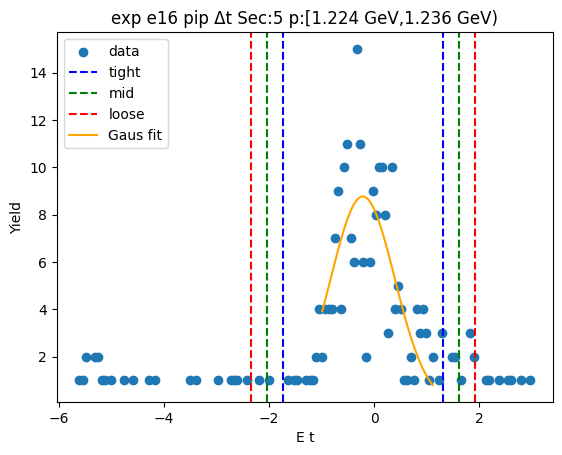

-1.5297203901127034 1.302965542289887
-1.8129889833529627 1.5862341355301461
-2.0962575765932216 1.8695027287704051
[ 9.11562638 -0.11337742  0.56653719]


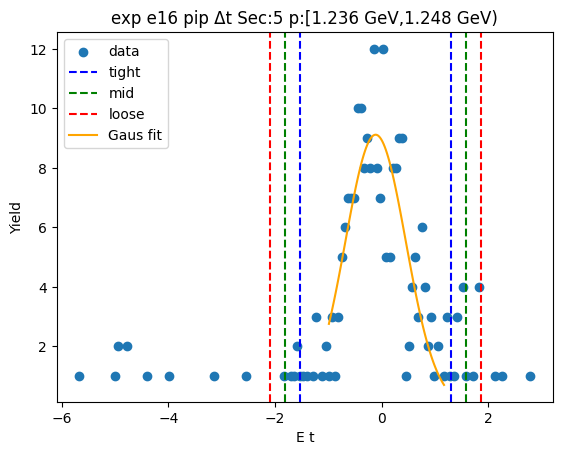

-1.640974508639453 1.467555158461974
-1.9518274753495954 1.7784081251721164
-2.262680442059738 2.089261091882259
[ 8.15776232 -0.08670968  0.62170593]


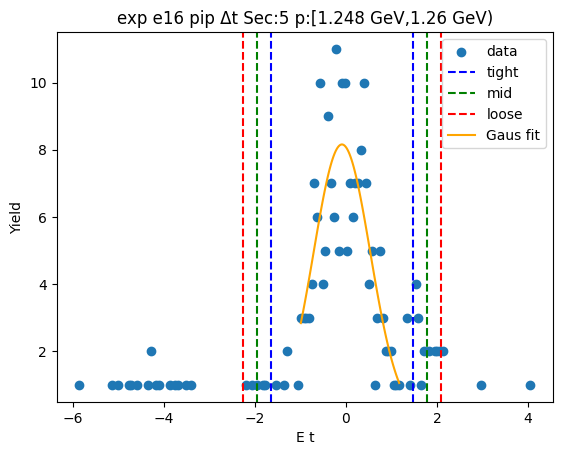

-1.9720480132024067 1.4697257939677582
-2.316225393919423 1.8139031746847745
-2.66040277463644 2.1580805554017912
[ 7.84904336 -0.25116111  0.68835476]


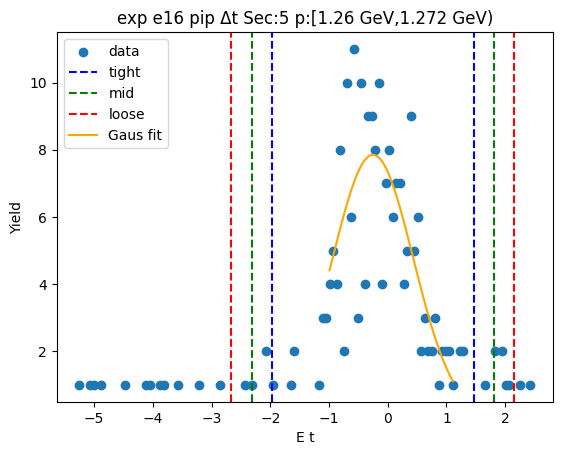

-1.7604761065588261 1.3566372143283238
-2.072187438647541 1.6683485464170387
-2.383898770736256 1.9800598785057537
[ 7.87064372 -0.20191945  0.62342266]


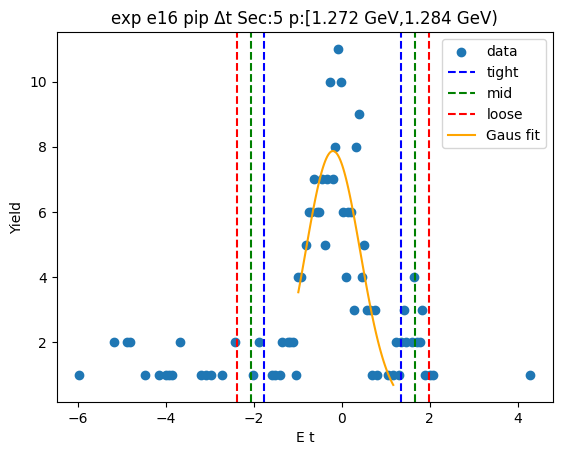

-1.5992001015874933 1.2922866805443847
-1.888348779800681 1.5814353587575725
-2.177497458013869 1.8705840369707603
[ 8.07332086 -0.15345671  0.57829736]


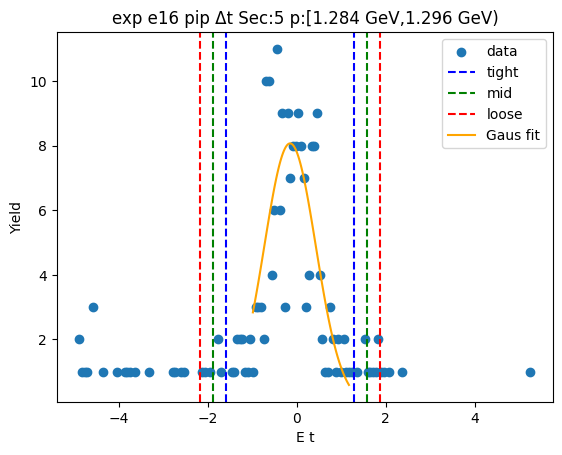

-1.4977246306324887 1.0539063509622513
-1.7528877287919629 1.3090694491217254
-2.008050826951437 1.5642325472811995
[ 9.51001188 -0.22190914  0.5103262 ]


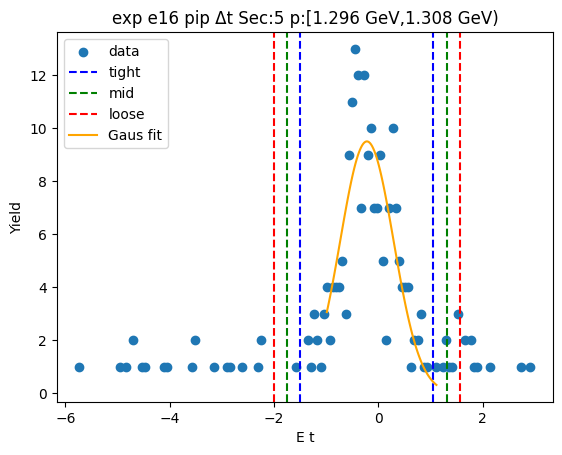

-1.7823653568243736 1.319049398568478
-2.092506832363659 1.6291908741077632
-2.402648307902944 1.9393323496470485
[ 7.78711185 -0.23165798  0.62028295]


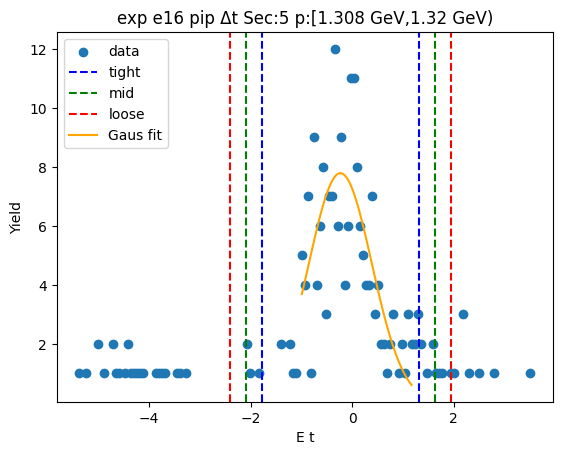

-1.6472028131903895 1.031567602363143
-1.9150798547457426 1.2994446439184961
-2.182956896301096 1.5673216854738494
[ 9.19930201 -0.30781761  0.53575408]


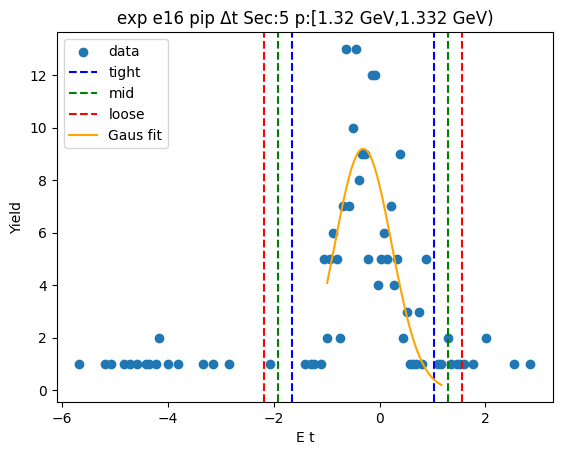

-1.6515246740766751 1.1784058272782993
-1.9345177242121727 1.461398877413797
-2.2175107743476703 1.7443919275492945
[ 7.94943747 -0.23655942  0.5659861 ]


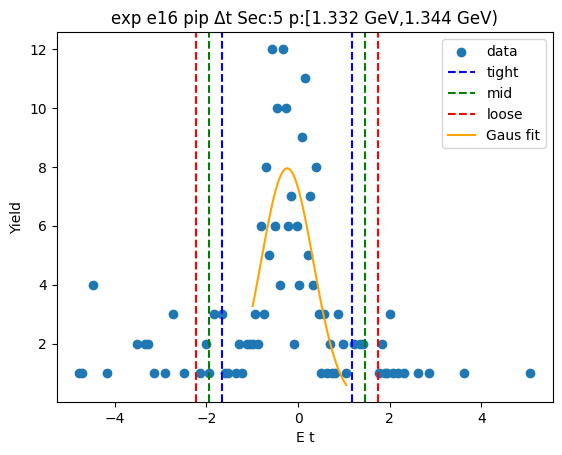

-1.6626788061389761 1.4834868469853166
-1.9772953714514052 1.7981034122977457
-2.2919119367638348 2.112719977610175
[ 7.38694593 -0.08959598  0.62923313]


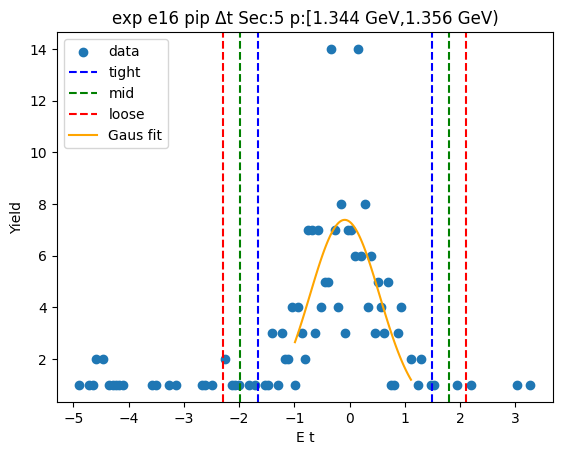

-1.707175289442433 1.094065613283262
-1.9872993797150027 1.3741897035558317
-2.2674234699875724 1.654313793828401
[ 7.73212691 -0.30655484  0.56024818]


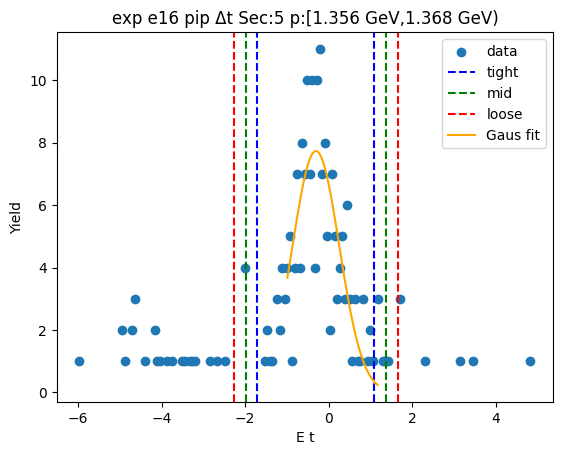

-2.564886808921062 1.687513116172787
-2.9901268014304474 2.1127531086821723
-3.4153667939398322 2.537993101191557
[ 6.50877278 -0.43868685  0.85047999]


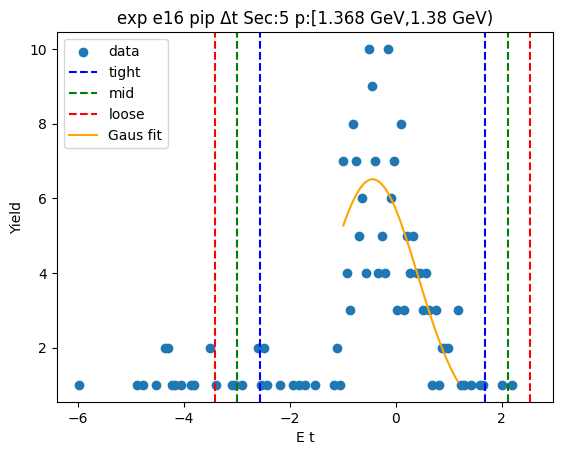

-2.1387915038296903 1.395719325789985
-2.492242586791658 1.7491704087519526
-2.8456936697536253 2.10262149171392
[ 6.8887981  -0.37153609  0.70690217]


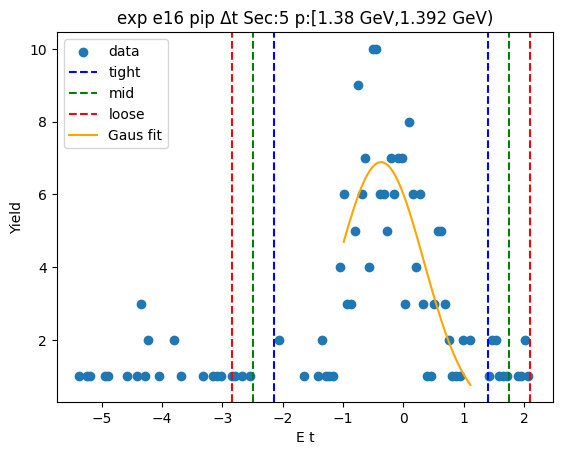

-2.651960278503898 1.9295178859304054
-3.1101080949473277 2.3876657023738357
-3.568255911390758 2.8458135188172653
[ 6.0960167  -0.3612212   0.91629563]


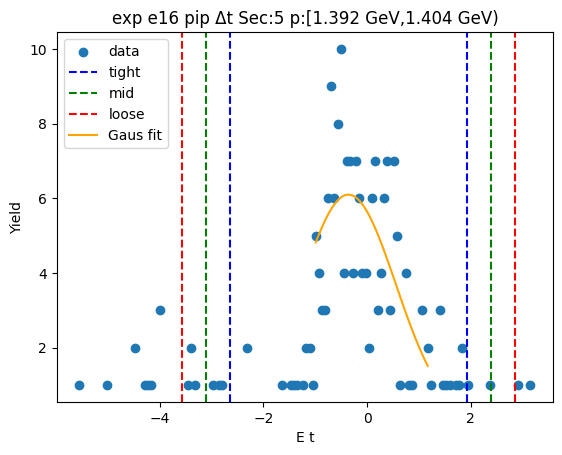

-2.0128515164652745 1.1541772709605846
-2.32955439520786 1.4708801497031707
-2.6462572739504457 1.7875830284457563
[ 7.33804603 -0.42933712  0.63340576]


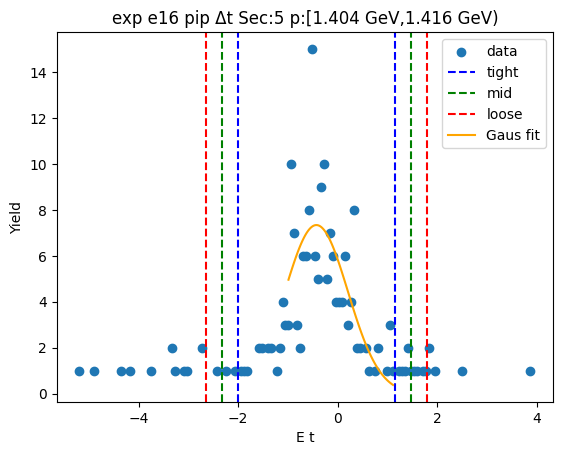

-2.602706878589774 2.0457554636350377
-3.0675531128122553 2.510601697857519
-3.5323993470347363 2.9754479320800002
[ 5.59673676 -0.27847571  0.92969247]


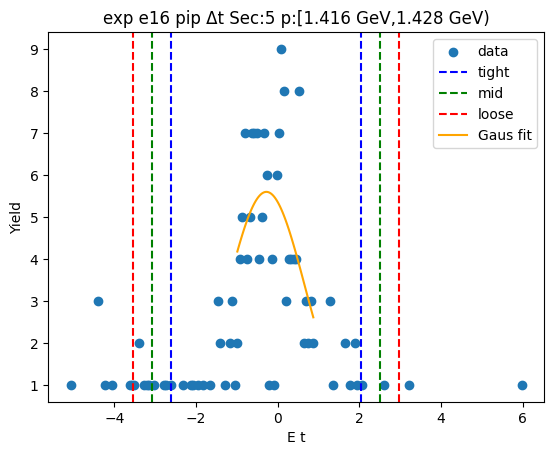

-1.8970236087992085 1.3896651515213911
-2.2256924848312685 1.718334027553451
-2.5543613608633287 2.0470029035855113
[ 5.10612009 -0.25367923  0.65733775]


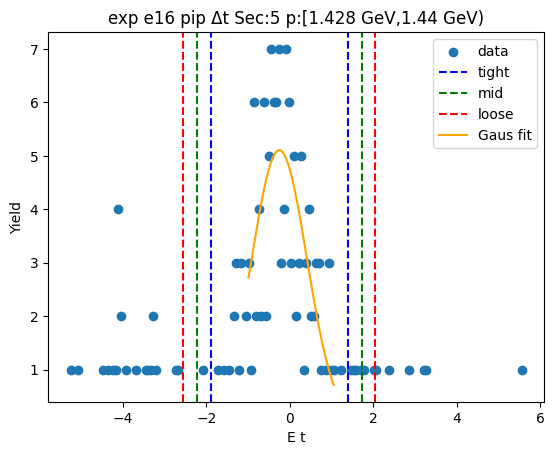

-2.731046543185737 1.4575607181341703
-3.149907269317728 1.8764214442661613
-3.568767995449719 2.2952821703981523
[ 5.30604351 -0.63674291  0.83772145]


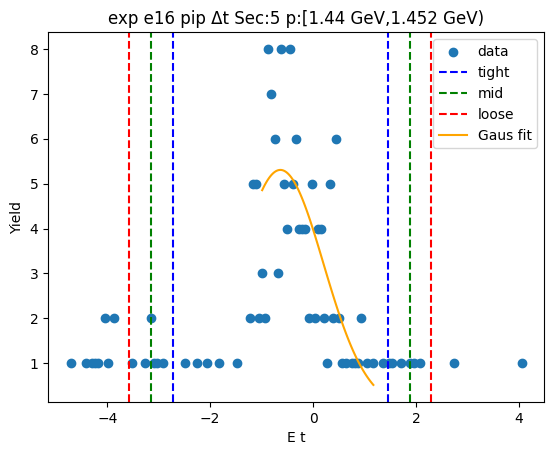

-2.552106861674169 1.5663378723586345
-2.963951335077449 1.9781823457619145
-3.3757958084807296 2.390026819165195
[ 5.93805128 -0.49288449  0.82368895]


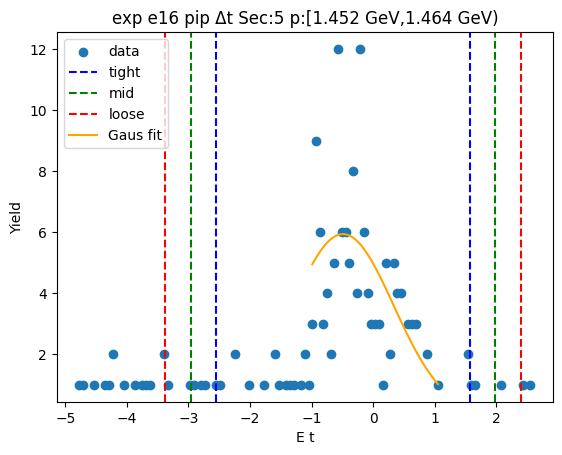

-1.9610742041511688 1.402509470768579
-2.2974325716431436 1.7388678382605538
-2.6337909391351184 2.0752262057525286
[ 5.46805621 -0.27928237  0.67271673]


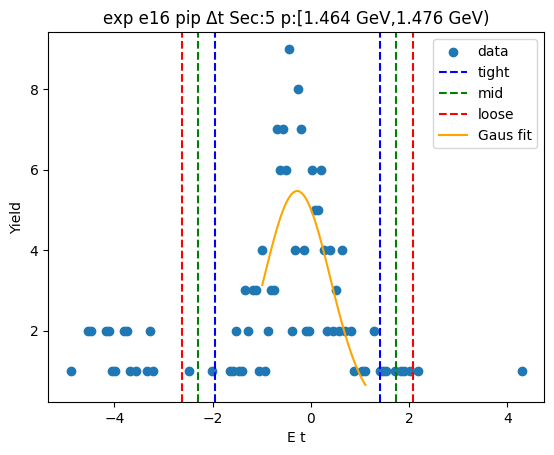

-1.7007676580486355 1.2092157422834826
-1.9917659980818472 1.5002140823166943
-2.282764338115059 1.791212422349906
[ 7.17400187 -0.24577596  0.58199668]


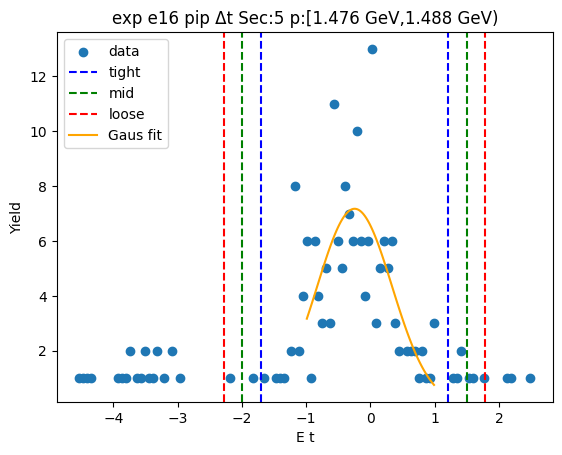

-2.0582846328648703 1.399579325940455
-2.4040710287454035 1.7453657218209877
-2.7498574246259357 2.0911521177015198
[ 5.67266995 -0.32935265  0.69157279]


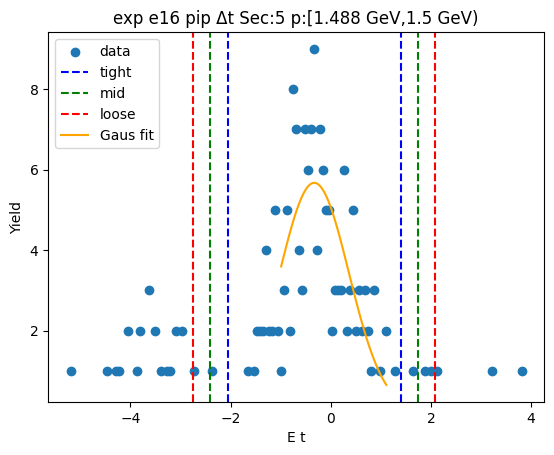

-2.641438726256829 1.9273869694884007
-3.0983212958313517 2.384269539062924
-3.5552038654058746 2.8411521086374467
[ 5.67266995 -0.32935265  0.69157279]


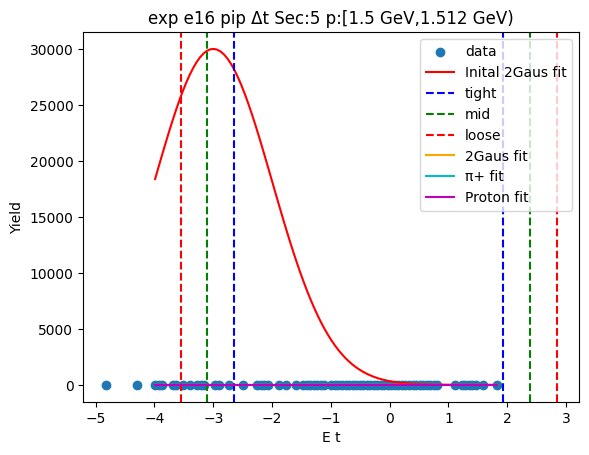

-2.1666395188350975 1.5416237273823028
-2.537465843456838 1.9124500520040426
-2.9082921680785776 2.2832763766257824
[ 5.67266995 -0.32935265  0.69157279]


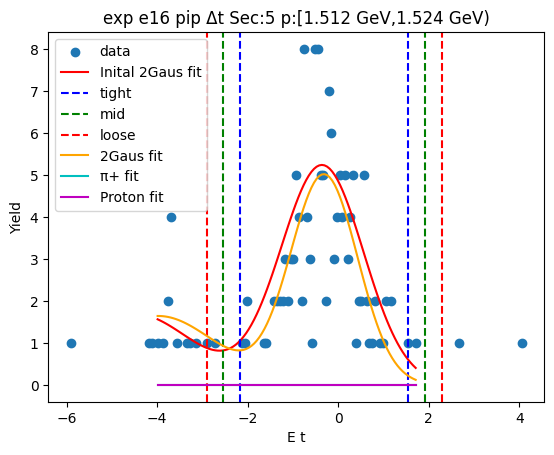

Runtime Error
[ 5.67266995 -0.32935265  0.69157279]


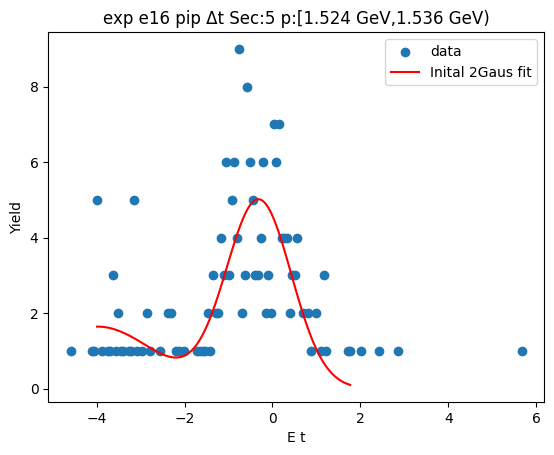

-2.592191041769791 1.610537899780331
-3.0124639359248033 2.0308107939353435
-3.432736830079816 2.451083688090356
[ 5.67266995 -0.32935265  0.69157279]


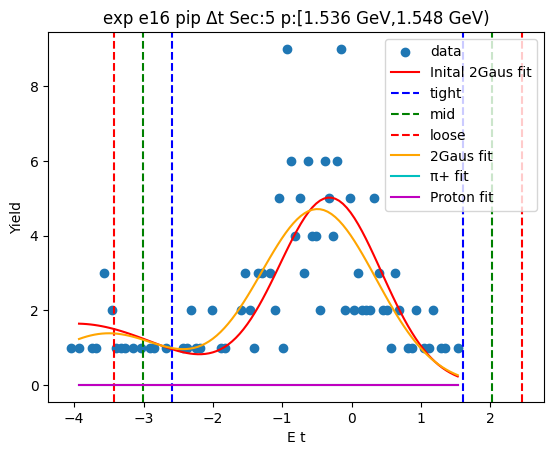

-2.2078178696145914 1.2109349632026278
-2.549693152896313 1.5528102464843494
-2.891568436178035 1.8946855297660714
[ 5.67266995 -0.32935265  0.69157279]


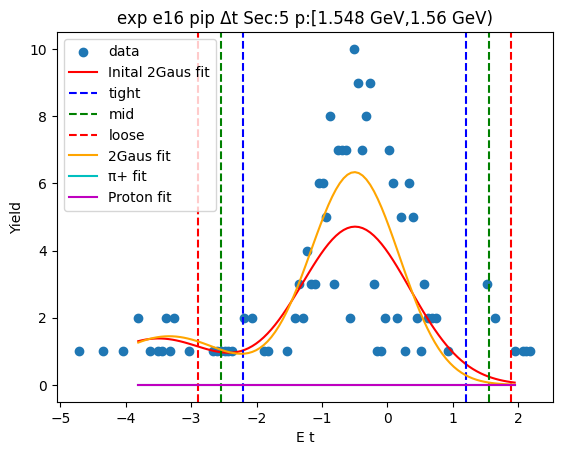

-1.4788088291949533 0.8443431266546184
-1.7111240247799104 1.0766583222395756
-1.9434392203648676 1.3089735178245328
[ 5.67266995 -0.32935265  0.69157279]


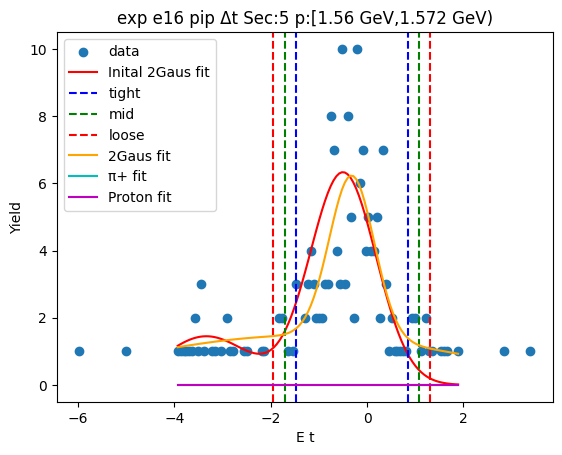

-0.9231570566701197 -0.16013005274481668
-0.99945975706265 -0.08382735235228633
-1.0757624574551803 -0.007524651959756046
[ 5.67266995 -0.32935265  0.69157279]


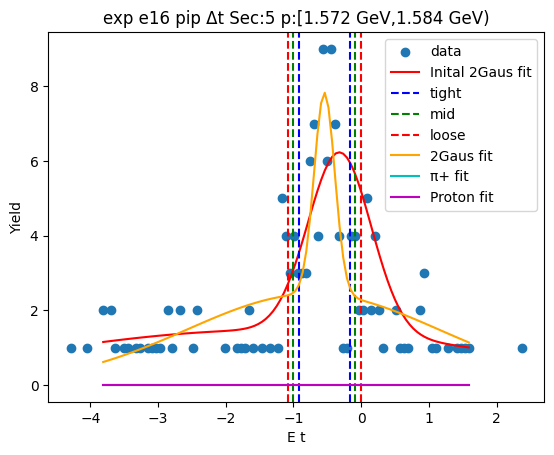

Runtime Error
[ 5.67266995 -0.32935265  0.69157279]


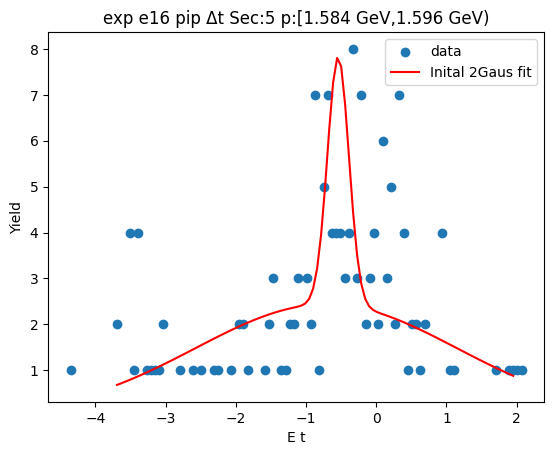

-0.49770421417104516 -0.5756240488079515
-0.48991223070735457 -0.5834160322716421
-0.4821202472436639 -0.5912080157353328
[ 5.67266995 -0.32935265  0.69157279]


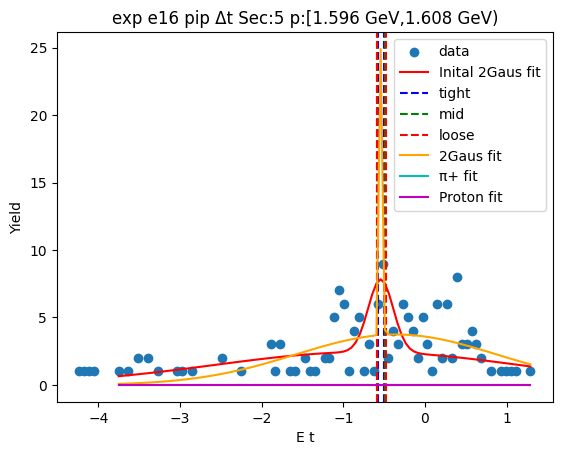

-0.5572458206749025 -0.5870496213281655
-0.5542654406095762 -0.5900300013934918
-0.5512850605442499 -0.5930103814588181
[ 5.67266995 -0.32935265  0.69157279]


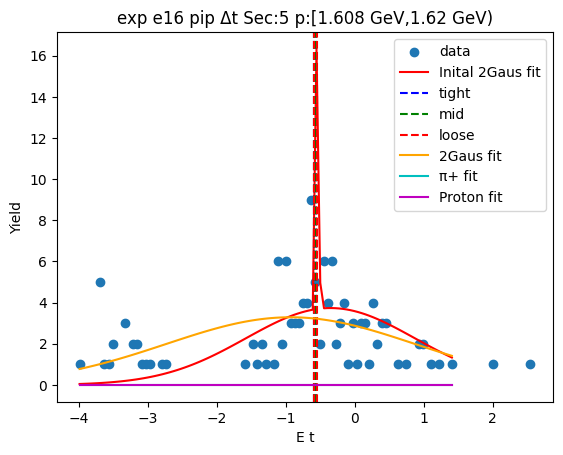

-0.22199212733005771 -0.6949654559252201
-0.17469479447054148 -0.7422627887847363
-0.12739746161102522 -0.7895601216442525
[ 5.67266995 -0.32935265  0.69157279]


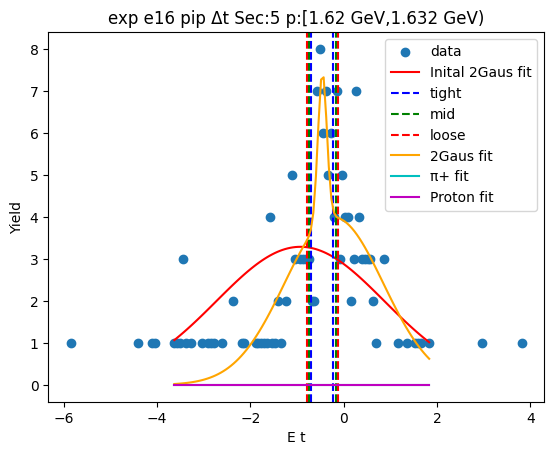

0.5932697822922659 -1.2237171400815714
0.7749684745296495 -1.405415832318955
0.9566671667670332 -1.5871145245563387
[ 5.67266995 -0.32935265  0.69157279]


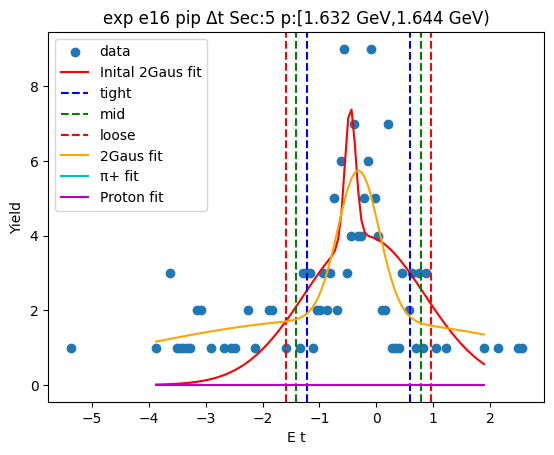

1.337124443887329 -2.1589069004758334
1.6867275783236455 -2.50851003491215
2.0363307127599612 -2.858113169348466
[ 5.67266995 -0.32935265  0.69157279]


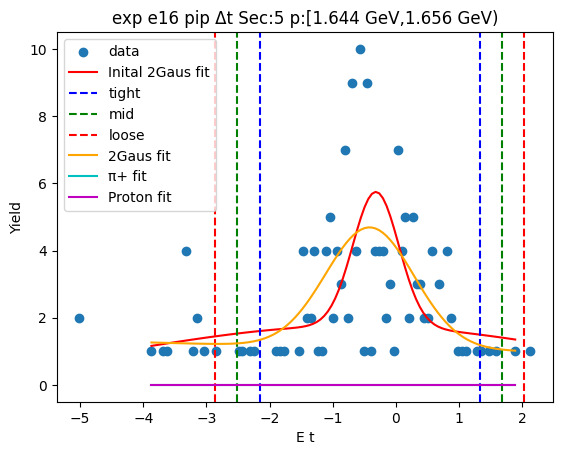

1.4119112317730103 -1.8805523211041233
1.7411575870607234 -2.2097986763918365
2.070403942348437 -2.53904503167955
[ 5.67266995 -0.32935265  0.69157279]


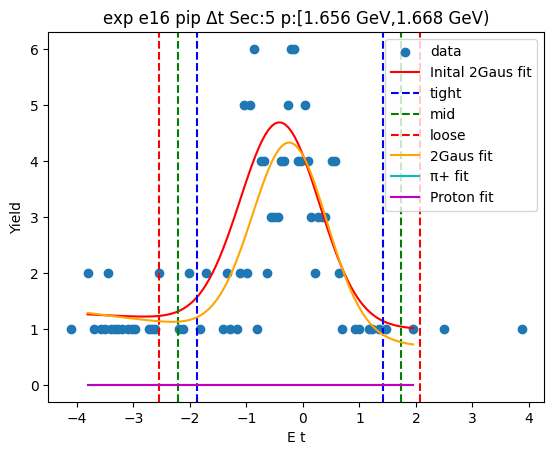

0.774623098169012 -2.0419422917185277
1.056279637157766 -2.3235988307072817
1.33793617614652 -2.6052553696960357
[ 5.67266995 -0.32935265  0.69157279]


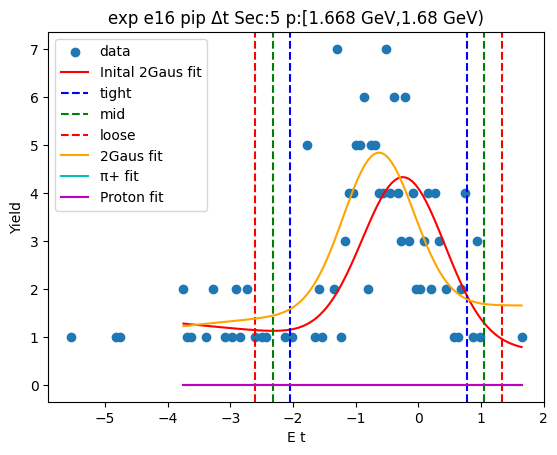

0.3273528754668717 -1.180857805703867
0.47817394358394566 -1.331678873820941
0.6289950117010195 -1.482499941938015
[ 5.67266995 -0.32935265  0.69157279]


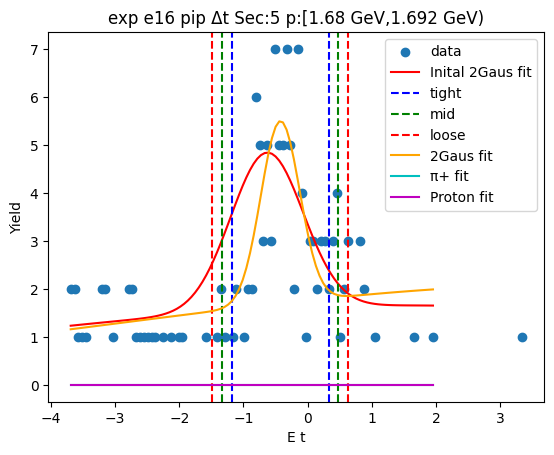

1.5081496664062335 -1.9074357028805797
1.8497082033349148 -2.248994239809261
2.1912667402635964 -2.5905527767379426
[ 5.67266995 -0.32935265  0.69157279]


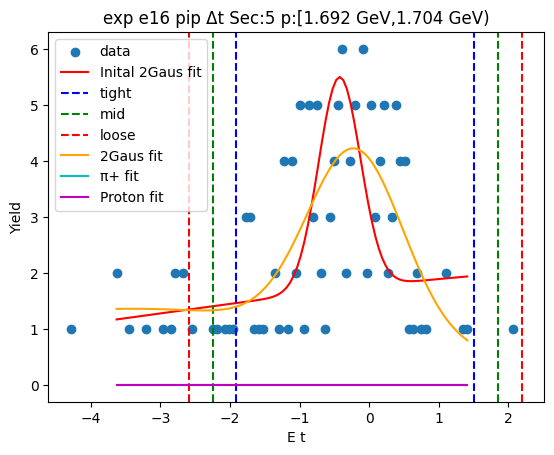

0.6337999665125189 -1.3917860227790906
0.8363585654416799 -1.5943446217082515
1.0389171643708408 -1.7969032206374125
[ 5.67266995 -0.32935265  0.69157279]


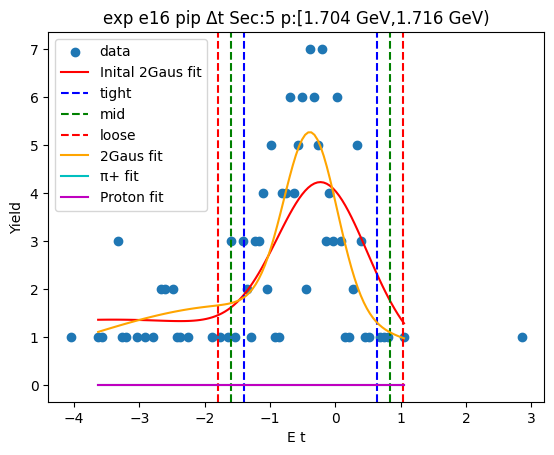

0.22911527314403957 -1.3332169977089197
0.3853485002293354 -1.4894502247942154
0.5415817273146313 -1.6456834518795114
[ 5.67266995 -0.32935265  0.69157279]


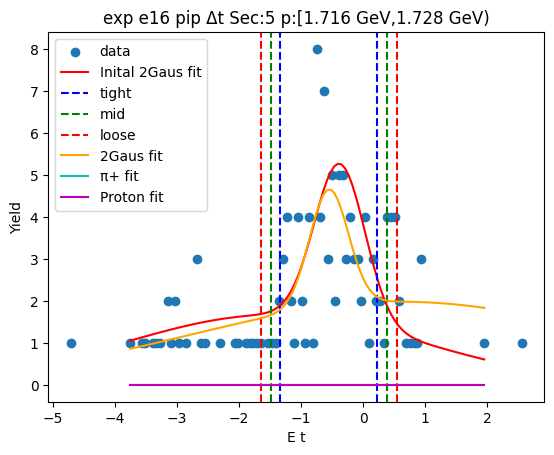

0.11051253364736924 -0.9275569178262487
0.21431947879473112 -1.0313638629736106
0.3181264239420929 -1.1351708081209724
[ 5.67266995 -0.32935265  0.69157279]


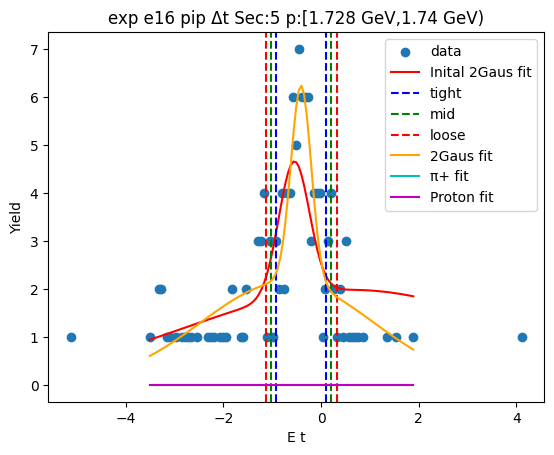

0.6052351885993219 -1.4419320316811728
0.8099519106273714 -1.6466487537092223
1.0146686326554208 -1.8513654757372717
[ 5.67266995 -0.32935265  0.69157279]


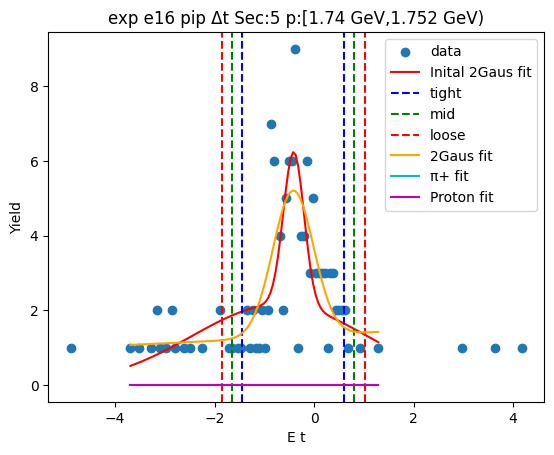

-1.015515790209531 0.8648096996226087
-1.203548339192745 1.0528422486058227
-1.391580888175959 1.2408747975890366
[13.45512415 -0.07535305  0.3760651 ]


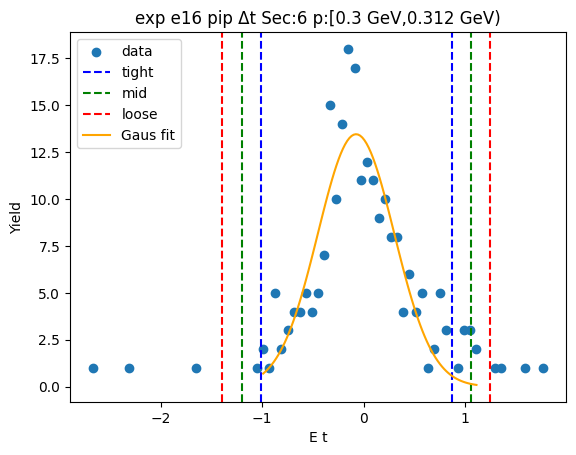

-1.2183745108353778 1.0319534482339998
-1.4434073067423154 1.2569862441409374
-1.6684401026492532 1.4820190400478752
[14.57145402 -0.09321053  0.45006559]


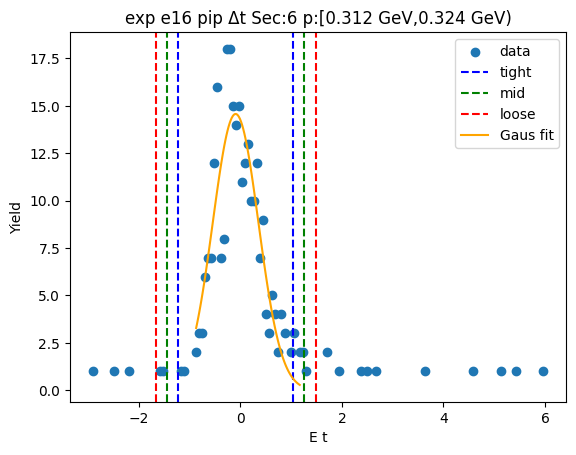

-0.9909397928675433 0.7857198594274261
-1.1686057580970401 0.9633858246569229
-1.346271723326537 1.1410517898864199
[15.00404571 -0.10260997  0.35533193]


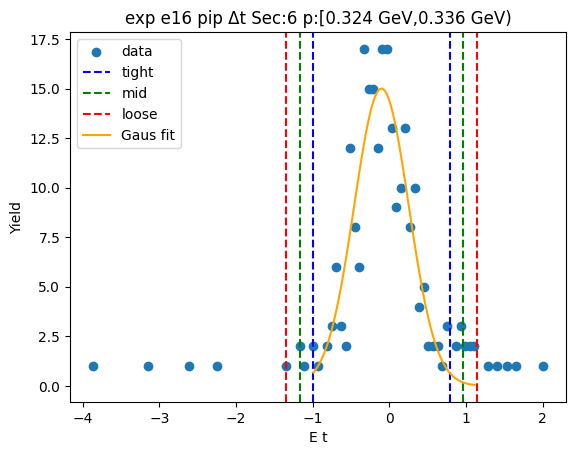

-0.9595815400214228 0.6675746928609753
-1.1222971633096626 0.830290316149215
-1.2850127865979024 0.9930059394374547
[19.05813347 -0.14600342  0.32543125]


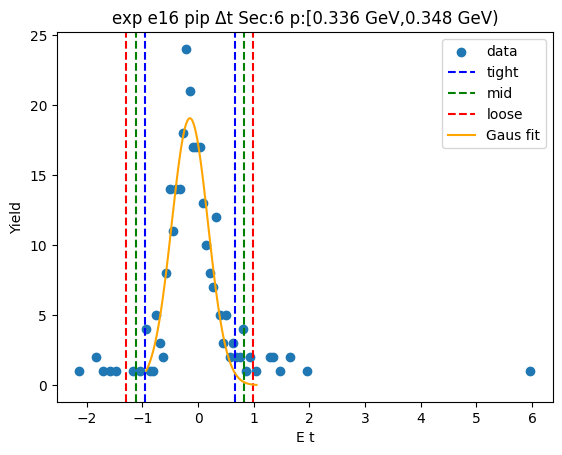

-1.103232347904474 0.8303827543259665
-1.2965938581275183 1.0237442645490107
-1.4899553683505622 1.2171057747720546
[16.35657338 -0.1364248   0.38672302]


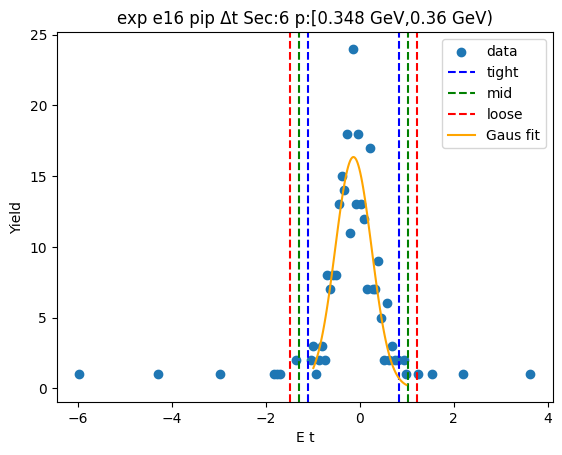

-0.9646482230426212 0.8331437618711404
-1.1444274215339976 1.0129229603625165
-1.3242066200253737 1.1927021588538926
[15.75630763 -0.06575223  0.3595584 ]


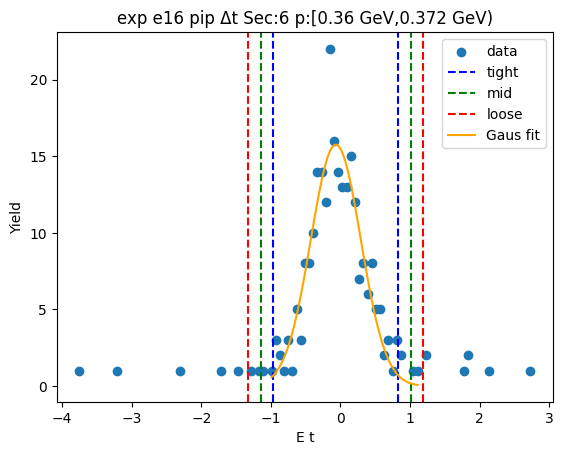

-0.9446631677398979 0.6798096595598925
-1.107110450469877 0.8422569422898716
-1.269557733199856 1.0047042250198508
[19.43300955 -0.13242675  0.32489457]


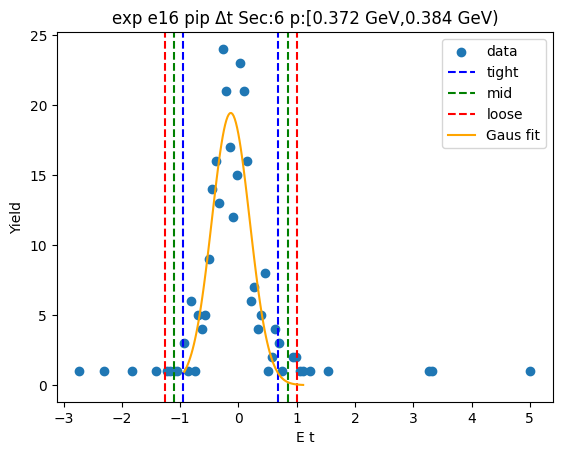

-0.995309979200786 0.7334924865970882
-1.1681902257805734 0.9063727331768757
-1.3410704723603608 1.0792529797566632
[17.30601744 -0.13090875  0.34576049]


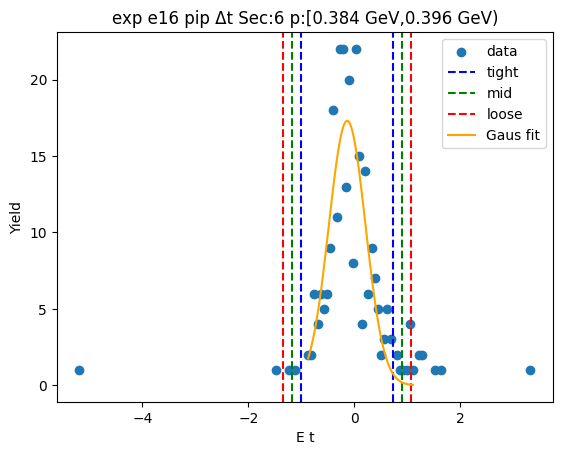

-0.943903346187082 0.731843327285425
-1.1114780135343327 0.8994179946326759
-1.2790526808815834 1.0669926619799266
[18.39762649 -0.10603001  0.33514933]


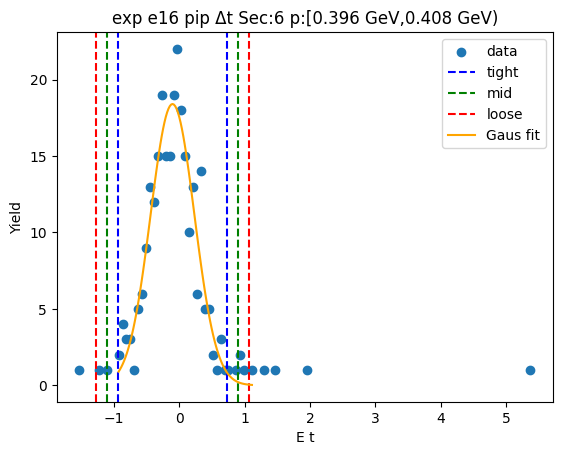

-1.0640687064387844 0.8477450015103554
-1.2552500772336985 1.0389263723052695
-1.4464314480286125 1.2301077431001834
[17.22513766 -0.10816185  0.38236274]


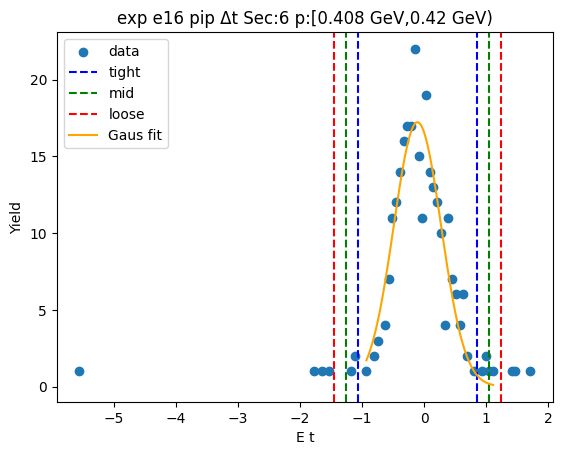

-0.9217812611530202 0.8436132819687198
-1.0983207154651942 1.0201527362808938
-1.274860169777368 1.1966921905930676
[18.40596718 -0.03908399  0.35307891]


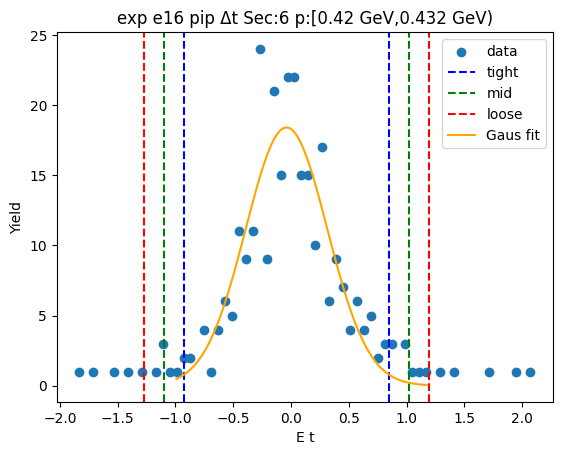

-1.0794590140431286 1.0076586553132498
-1.2881707809787666 1.2163704222488878
-1.4968825479144046 1.4250821891845258
[16.68444792 -0.03590018  0.41742353]


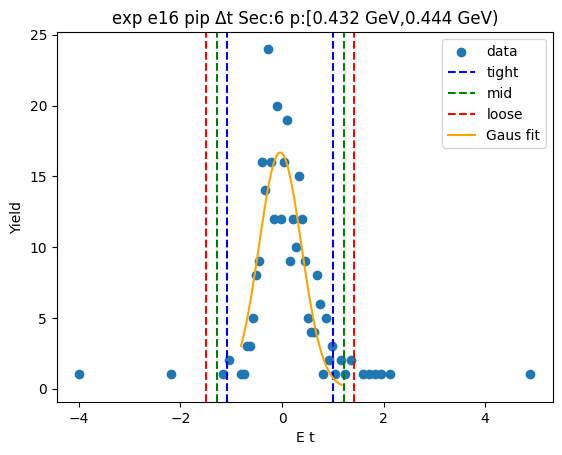

-1.2628312261579773 1.2715229156634609
-1.5162666403401213 1.5249583298456049
-1.769702054522265 1.7783937440277486
[1.31285093e+01 4.34584475e-03 5.06870828e-01]


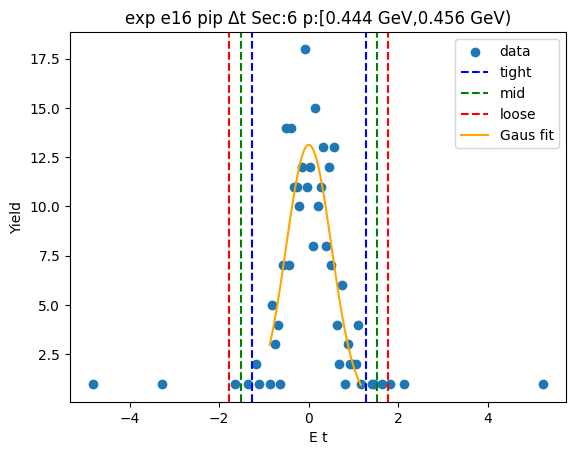

-0.9813079629978364 1.3126917856692537
-1.2107079378645453 1.5420917605359628
-1.4401079127312544 1.7714917354026718
[15.18767011  0.16569191  0.45879995]


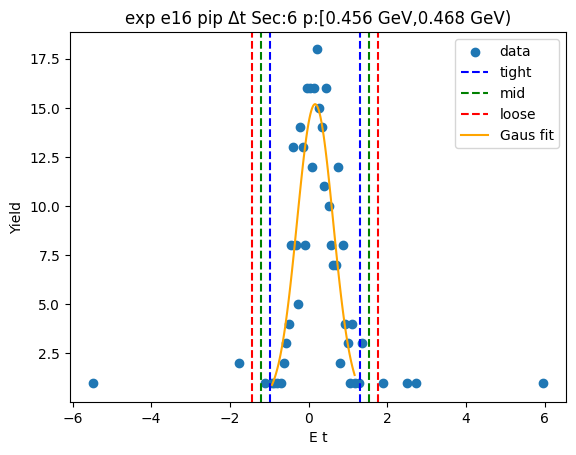

-0.8259481477695609 1.3760993527633159
-1.0461528978228485 1.5963041028166034
-1.266357647876136 1.816508852869891
[17.03526327  0.2750756   0.4404095 ]


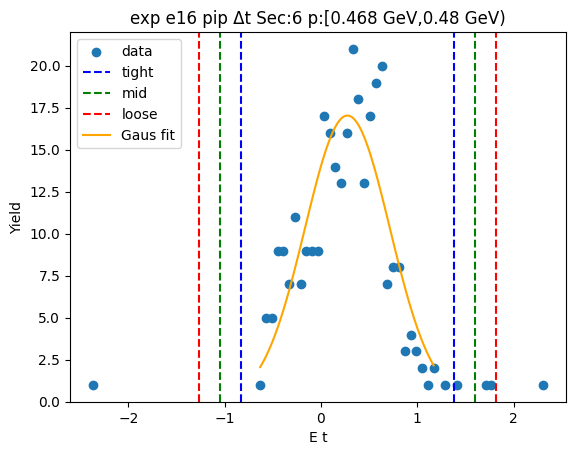

-0.9843622710633163 1.4187983159890725
-1.224678329768555 1.6591143746943113
-1.464994388473794 1.8994304333995502
[14.54345105  0.21721802  0.48063212]


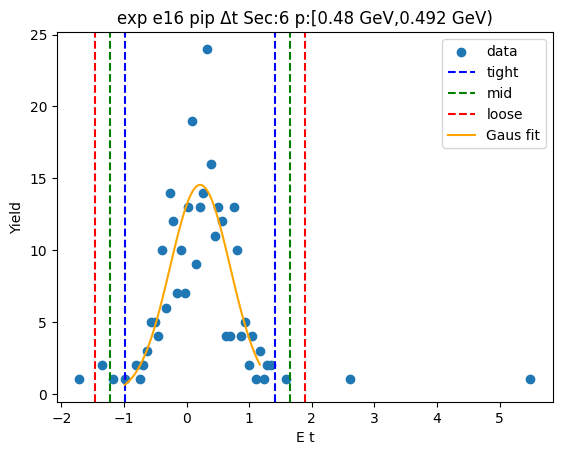

-1.2613858281953794 1.4090865227750033
-1.5284330632924175 1.6761337578720414
-1.7954802983894558 1.9431809929690798
[12.95230384  0.07385035  0.53409447]


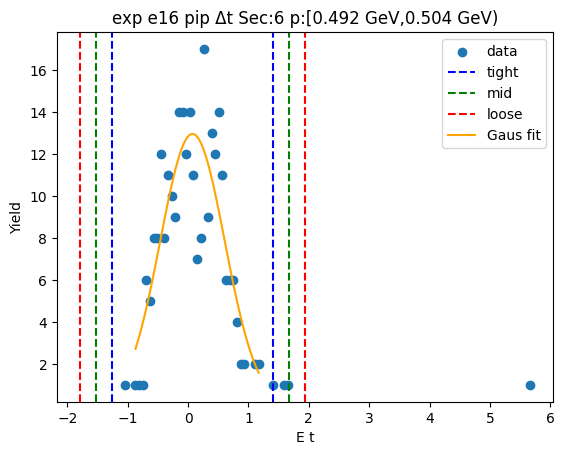

-1.5655620602786287 1.4820437430427225
-1.8703226406107636 1.7868043233748574
-2.1750832209428985 2.0915649037069928
[11.17776379 -0.04175916  0.60952116]


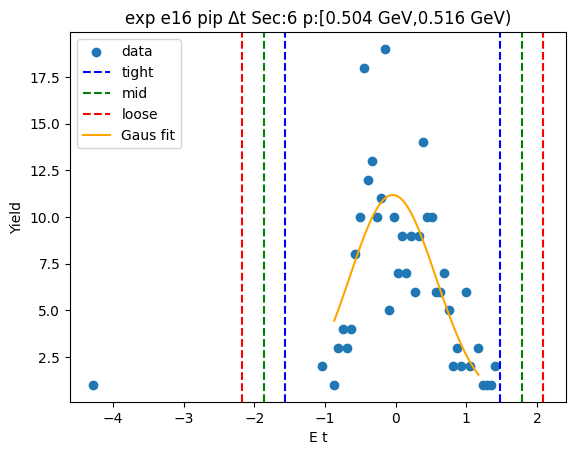

-1.2432024997557924 1.0033072967593837
-1.46785347940731 1.2279582764109012
-1.6925044590588274 1.4526092560624186
[13.96892942 -0.1199476   0.44930196]


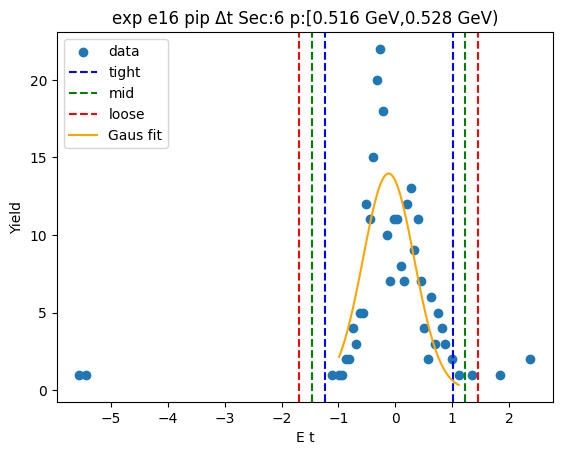

-1.450735820133479 1.3332030679365061
-1.7291297089404774 1.6115969567435044
-2.007523597747476 1.889990845550503
[11.2743648  -0.05876638  0.55678778]


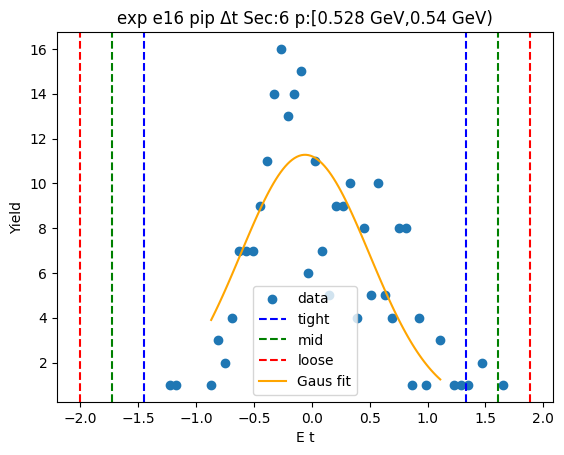

-1.5853457657483072 1.8947021254678136
-1.9333505548699195 2.2427069145894256
-2.2813553439915317 2.5907117037110377
[9.44759231 0.15467818 0.69600958]


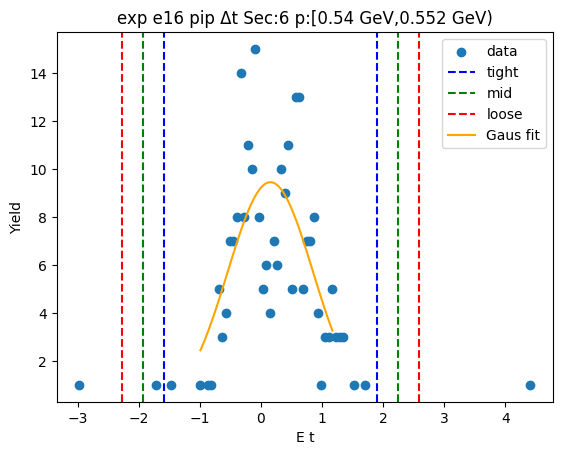

-1.8602578056581243 2.146381051997716
-2.2609216914237087 2.5470449377633
-2.6615855771892925 2.9477088235288837
[8.24863461 0.14306162 0.80132777]


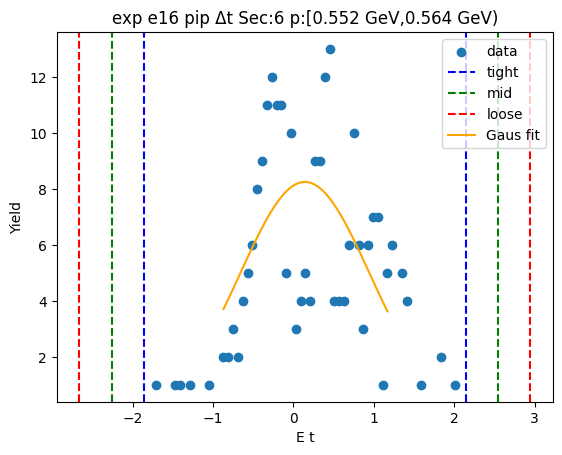

-1.5160056754083049 2.100639677099214
-1.8776702106590566 2.4623042123499657
-2.2393347459098085 2.8239687476007176
[9.58677949 0.292317   0.72332907]


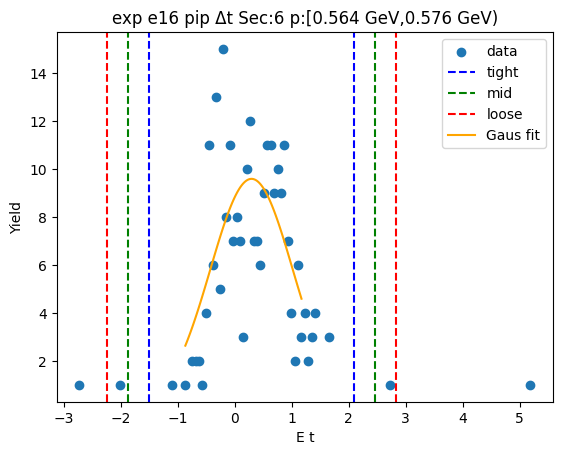

-1.5350917212786808 2.2858133913883334
-1.917182232545382 2.6679039026550346
-2.2992727438120837 3.0499944139217363
[9.09856148 0.37536084 0.76418102]


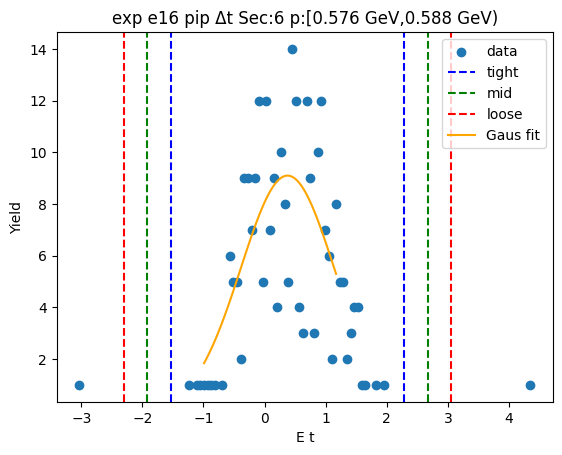

-1.9473780411296973 2.0344895889603203
-2.3455648041386996 2.4326763519693224
-2.7437515671477013 2.830863114978324
[8.09235558 0.04355577 0.79637353]


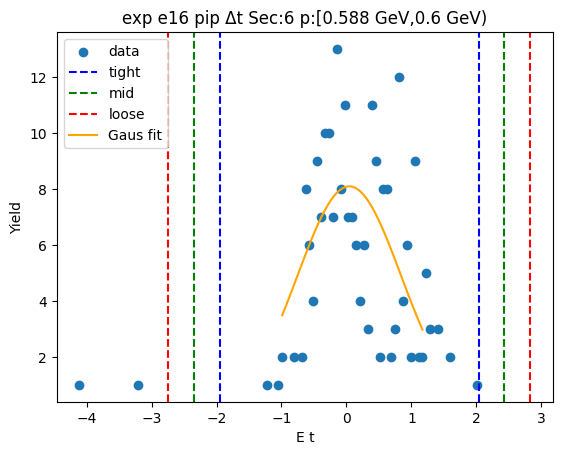

-2.0975665294882404 1.9311074926177056
-2.5004339316988347 2.3339748948283
-2.9033013339094293 2.7368422970388946
[ 8.69538137 -0.08322952  0.8057348 ]


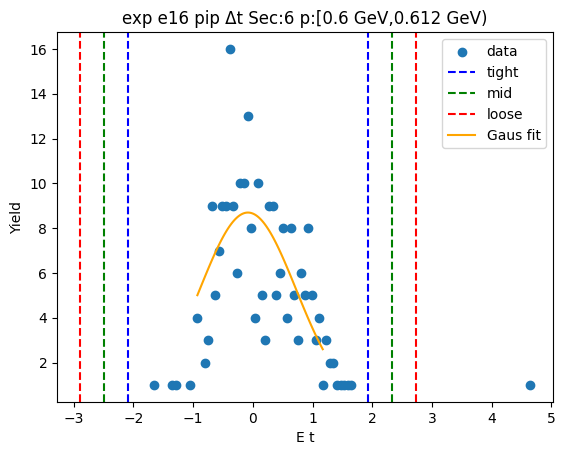

-2.7572954856039558 2.1335625496914328
-3.2463812891334944 2.6226483532209715
-3.7354670926630336 3.1117341567505106
[ 7.95247977 -0.31186647  0.97817161]


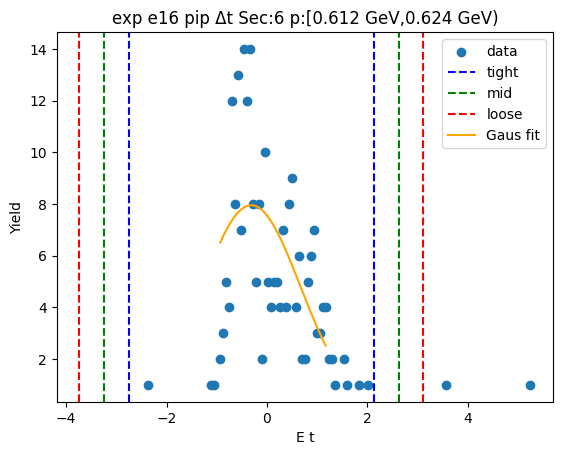

-1.6398426414121474 1.285632984051751
-1.9323902039585374 1.578180546598141
-2.2249377665049273 1.870728109144531
[ 9.81712371 -0.17710483  0.58509513]


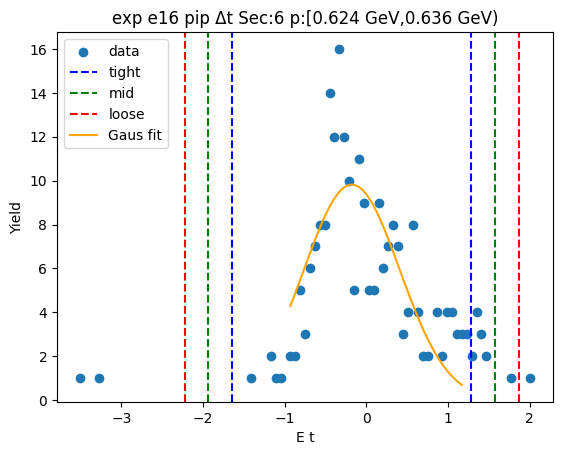

-1.55880955569212 1.2484438552200676
-1.8395348967833387 1.5291691963112868
-2.1202602378745574 1.8098945374025055
[ 8.37983074 -0.15518285  0.56145068]


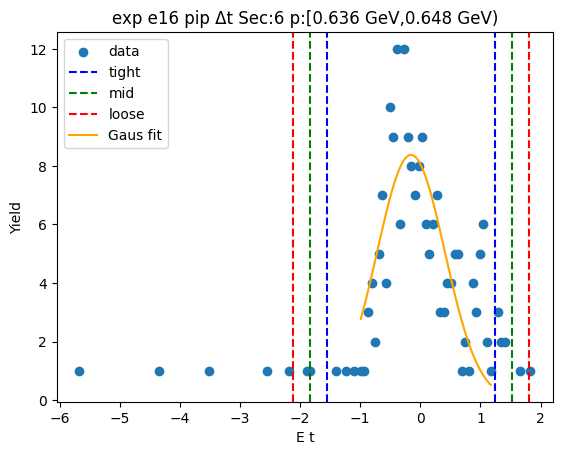

-1.8620999832705873 1.6420307481403125
-2.2125130564116775 1.9924438212814026
-2.562926129552767 2.3428568944224923
[ 6.80730672 -0.11003462  0.70082615]


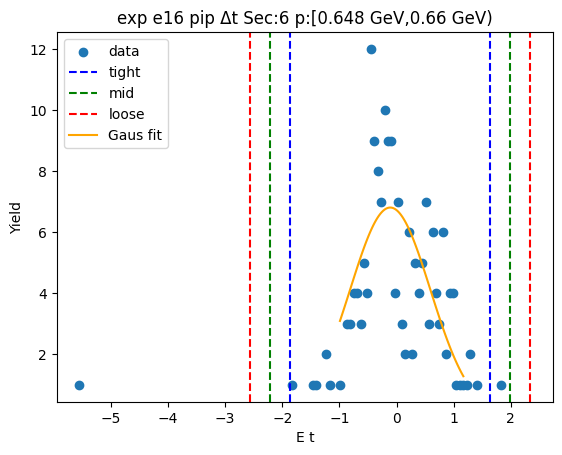

-1.5487717566247878 1.315141719163462
-1.835163104203613 1.6015330667422871
-2.121554451782438 1.8879244143211122
[ 7.38049954 -0.11681502  0.5727827 ]


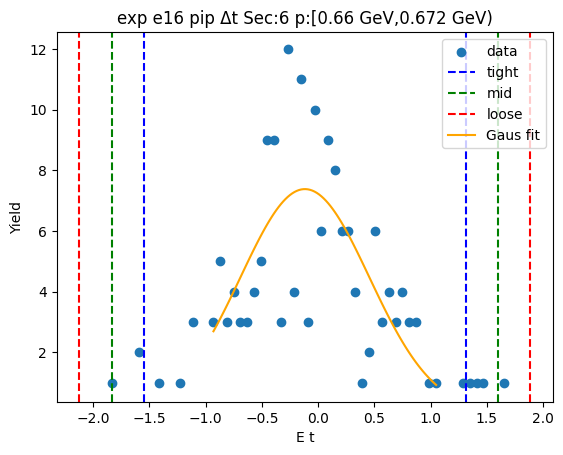

-1.3824057563651702 1.3228005349334733
-1.6529263854950347 1.5933211640633378
-1.923447014624899 1.863841793193202
[ 7.93026396 -0.02980261  0.54104126]


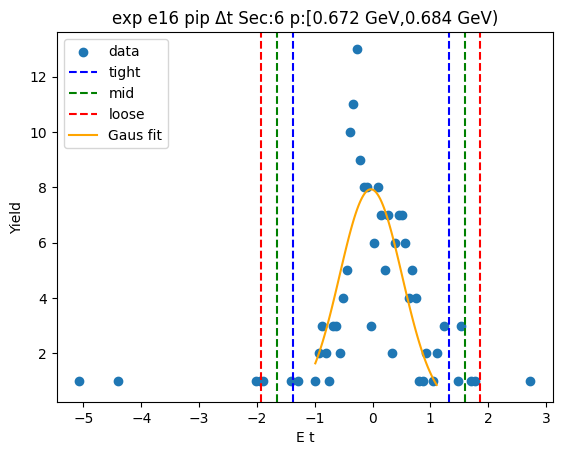

-1.3341924477032983 1.2485092347142959
-1.5924626159450577 1.5067794029560553
-1.850732784186817 1.7650495711978147
[ 8.11766685 -0.04284161  0.51654034]


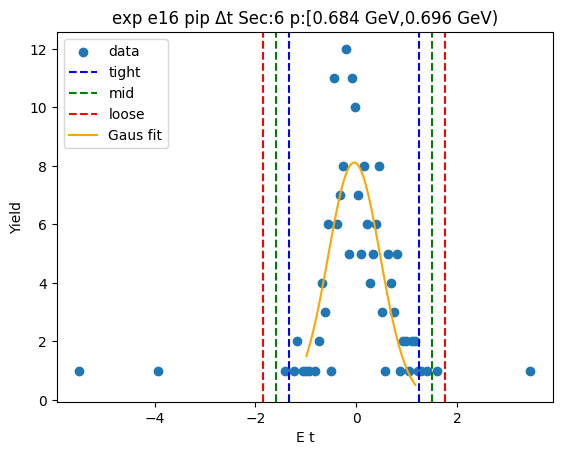

-1.3050324280292203 1.202737486674223
-1.5558094194995644 1.4535144781445672
-1.8065864109699088 1.7042914696149116
[ 8.49712532 -0.05114747  0.50155398]


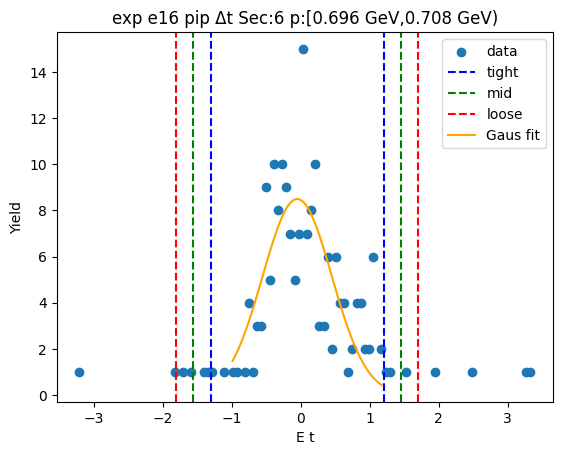

-1.4513126016521676 1.0823975564496024
-1.7046836174623448 1.3357685722597796
-1.9580546332725217 1.5891395880699566
[ 9.46932046 -0.18445752  0.50674203]


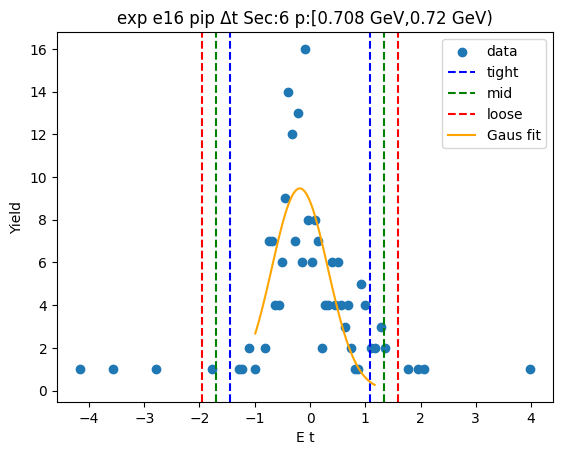

-0.9858367347023299 0.5749163657210602
-1.141912044744669 0.7309916757633993
-1.2979873547870078 0.8870669858057382
[11.29036202 -0.20546018  0.31215062]


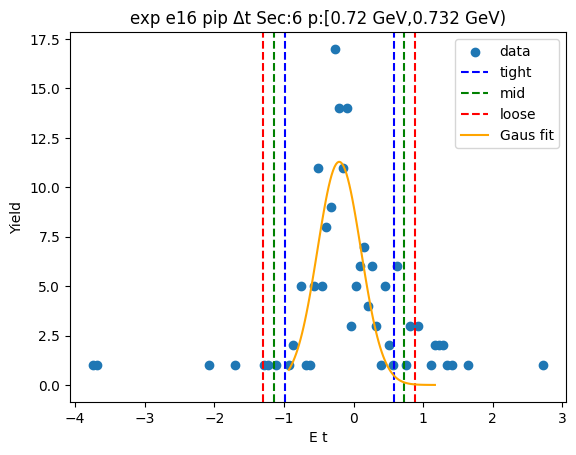

-1.2713153032616848 0.9807438952568359
-1.4965212231135367 1.2059498151086878
-1.7217271429653889 1.43115573496054
[ 9.13425302 -0.1452857   0.45041184]


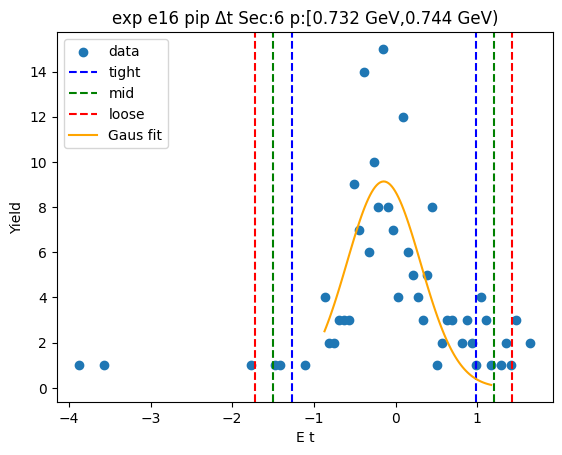

-1.0798357189623475 0.8485115326370378
-1.2726704441222862 1.0413462577969765
-1.4655051692822247 1.234180982956915
[10.14777868 -0.11566209  0.38566945]


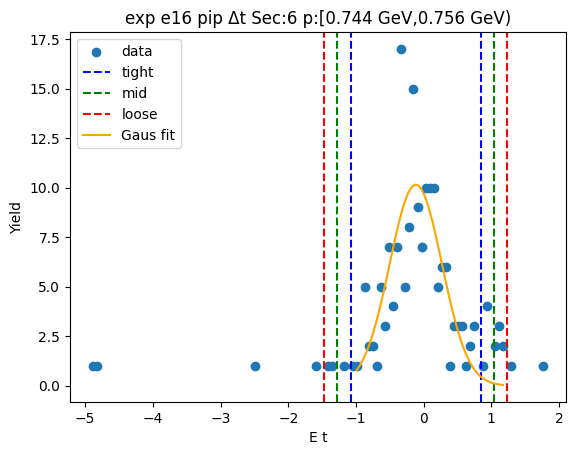

-1.5915596134712855 1.2219061094677186
-1.872906185765186 1.5032526817616192
-2.1542527580590867 1.7845992540555196
[ 6.92015014 -0.18482675  0.56269314]


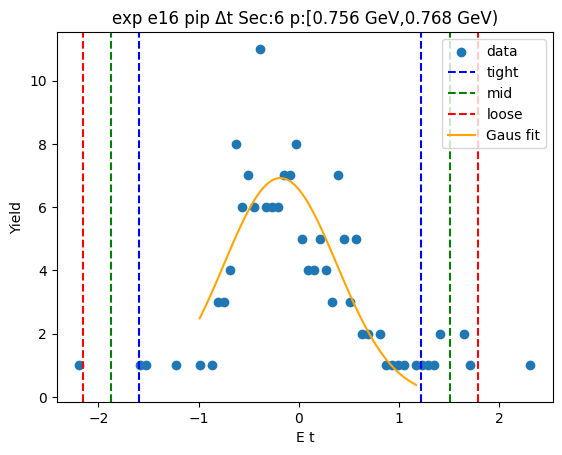

-1.1171568563393568 0.5985495347506873
-1.2887274954483612 0.7701201738596919
-1.4602981345573656 0.9416908129686963
[10.07593589 -0.25930366  0.34314128]


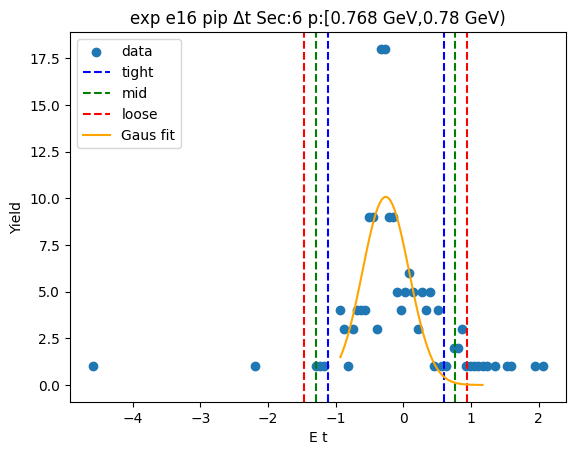

-0.9974276167150574 0.4585371686810421
-1.1430240952546673 0.604133647220652
-1.2886205737942773 0.7497301257602619
[10.80458664 -0.26944522  0.29119296]


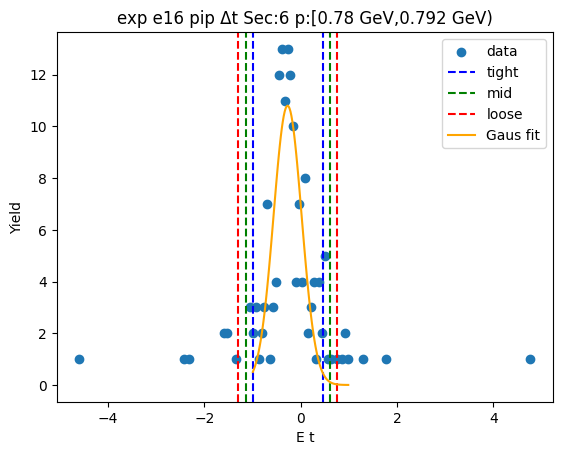

-1.2799692390013306 0.7257117715910004
-1.480537340060564 0.9262798726502337
-1.681105441119797 1.1268479737094668
[ 8.92796822 -0.27712873  0.4011362 ]


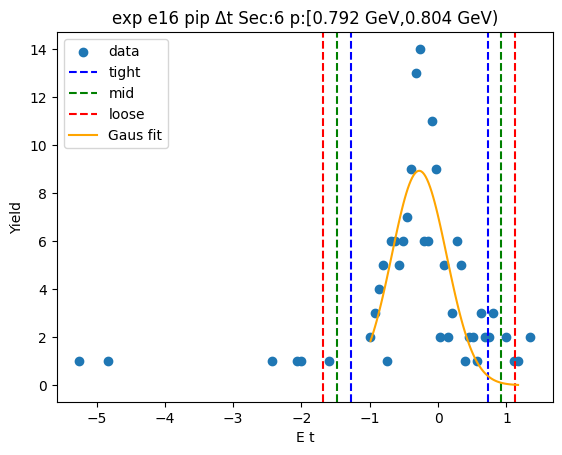

-1.418671202972286 0.9064022734169155
-1.6511785506112062 1.1389096210558356
-1.8836858982501263 1.3714169686947557
[ 7.61378503 -0.25613446  0.4650147 ]


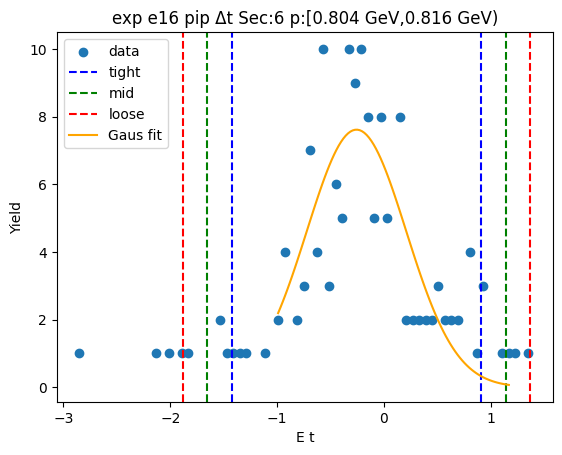

-1.5637291636209953 1.1239483544266693
-1.832496915425762 1.392716106231436
-2.1012646672305286 1.6614838580362024
[ 7.27151782 -0.2198904   0.5375355 ]


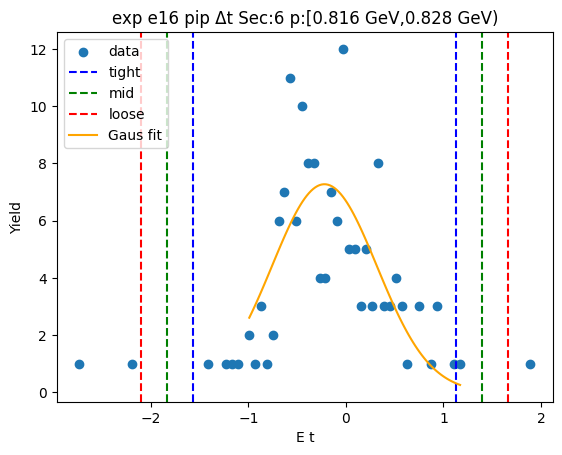

-1.3431646034292108 1.0892905561020076
-1.5864101193823326 1.3325360720551294
-1.8296556353354543 1.575781588008251
[ 6.41723538 -0.12693702  0.48649103]


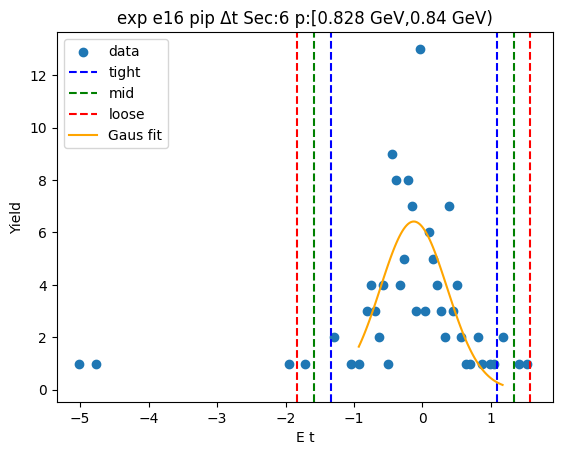

-1.5112968134732259 1.1556676654544082
-1.7779932613659895 1.4223641133471718
-2.044689709258753 1.6890605612399352
[ 6.26872308 -0.17781457  0.5333929 ]


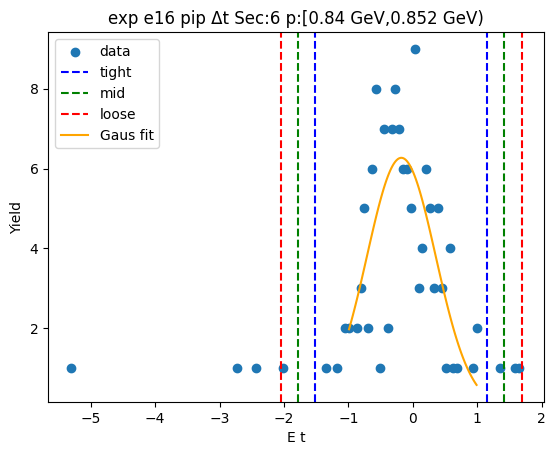

-1.4930674659483447 1.347165851155423
-1.7770907976587214 1.6311891828657996
-2.061114129369098 1.9152125145761763
[ 6.94790387 -0.07295081  0.56804666]


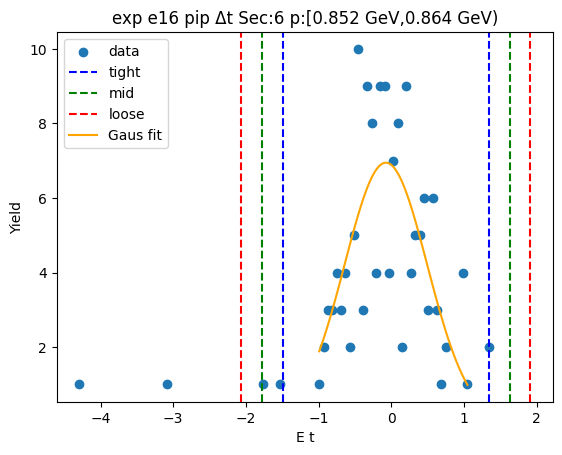

-1.3516155103511123 1.2475696257320696
-1.6115340239594305 1.5074881393403878
-1.8714525375677487 1.767406652948706
[ 6.43117867 -0.05202294  0.51983703]


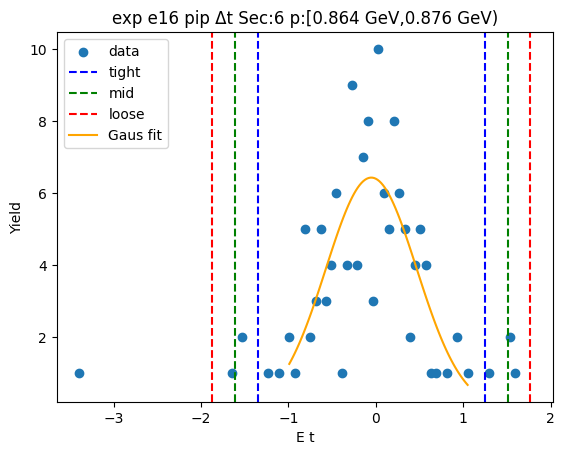

-1.2479593596666851 1.0045771697750276
-1.4732130126108565 1.229830822719199
-1.6984666655550278 1.4550844756633703
[ 7.2871644  -0.12169109  0.45050731]


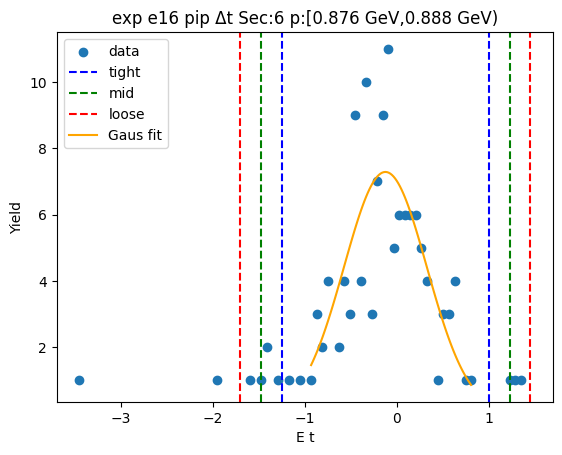

-1.210463492306756 0.9544761313682416
-1.4269574546742563 1.1709700937357415
-1.643451417041756 1.3874640561032412
[ 6.84927582 -0.12799368  0.43298792]


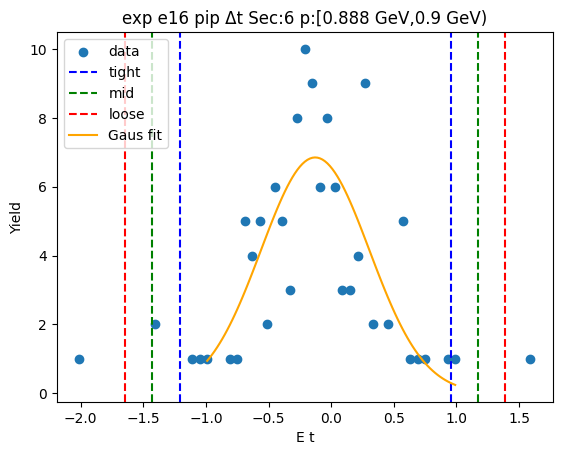

-1.1442826960815187 1.0831549688627988
-1.3670264625759503 1.3058987353572304
-1.589770229070382 1.528642501851662
[ 7.3734994  -0.03056386  0.44548753]


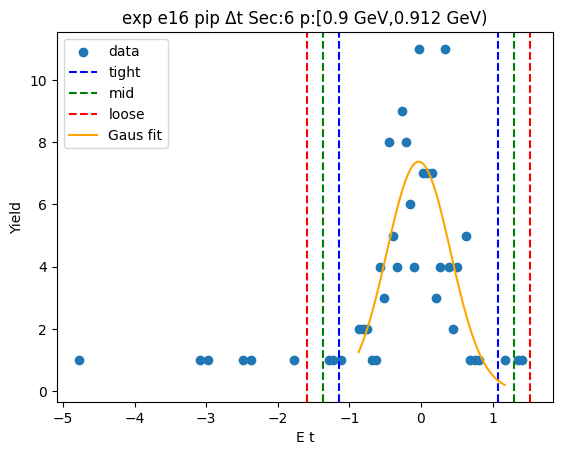

-1.1667342491525732 1.2925300795926127
-1.4126606820270917 1.5384565124671312
-1.6585871149016103 1.7843829453416498
[5.82470248 0.06289792 0.49185287]


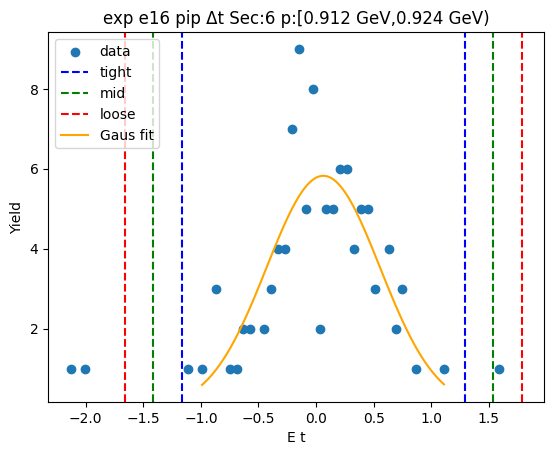

-1.4966777589473763 1.4561361196340326
-1.7919591468055174 1.7514175074921736
-2.087240534663658 2.0466988953503145
[ 5.9713847  -0.02027082  0.59056278]


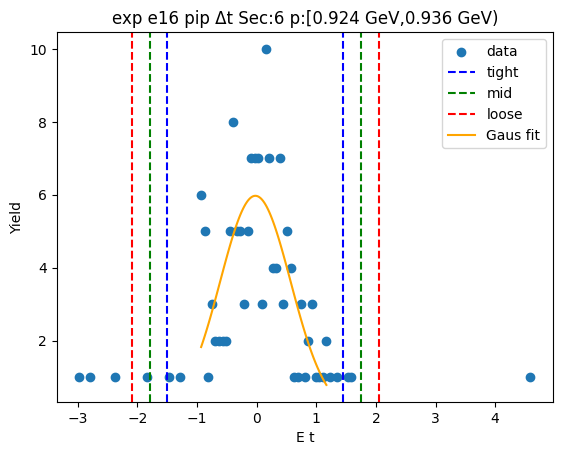

-1.104675257570961 1.077132465989081
-1.3228560299269652 1.2953132383450852
-1.5410368022829692 1.5134940107010892
[ 6.66236797 -0.0137714   0.43636154]


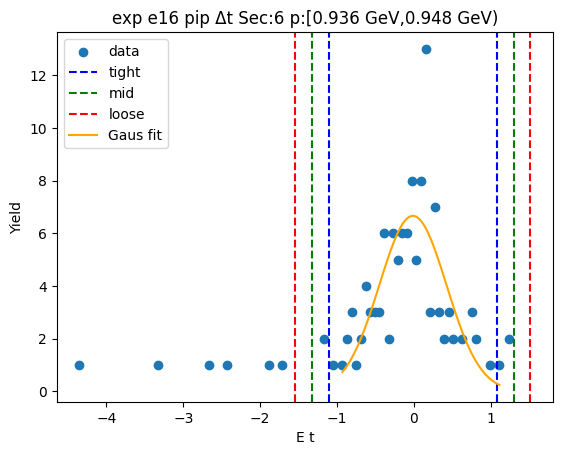

-1.1869781581946537 1.1915091781035363
-1.4248268918244729 1.4293579117333555
-1.6626756254542918 1.6672066453631744
[6.44010020e+00 2.26550995e-03 4.75697467e-01]


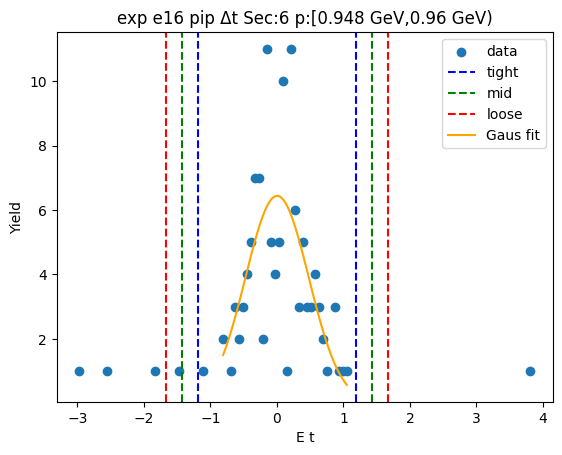

-1.1521797896989432 1.3599576938299054
-1.4033935380518279 1.61117144218279
-1.6546072864047128 1.862385190535675
[5.75881808 0.10388895 0.5024275 ]


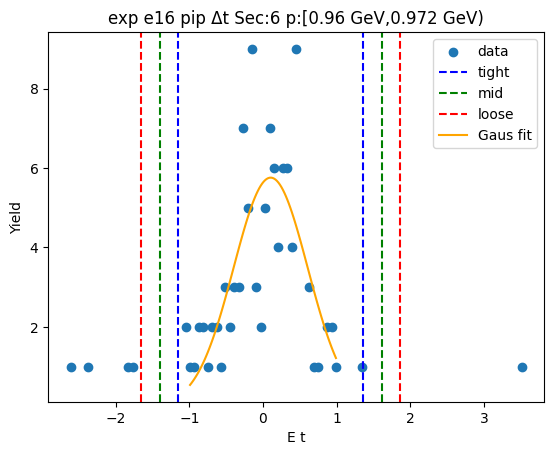

-1.1553353063865612 1.299584336275785
-1.4008272706527958 1.5450763005420196
-1.6463192349190305 1.7905682648082544
[5.55569103 0.07212451 0.49098393]


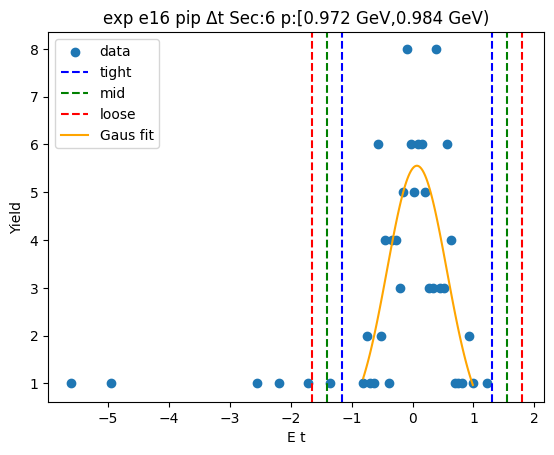

-1.3590581809714104 1.4509721233017565
-1.640061211398727 1.731975153729073
-1.9210642418260435 2.0129781841563896
[5.91366293 0.04595697 0.56200606]


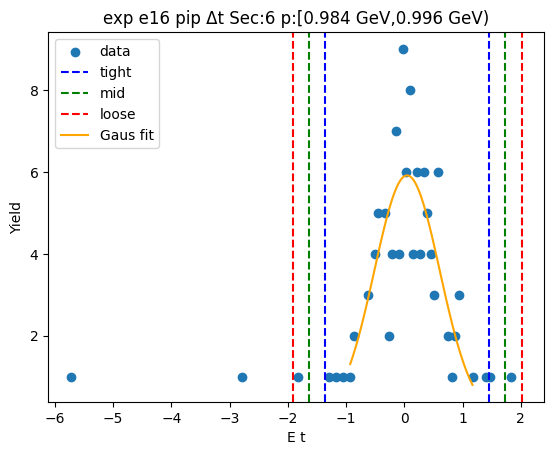

-1.389524616095134 1.3609400127446978
-1.664571078979117 1.6359864756286808
-1.9396175418631 1.9110329385126639
[ 4.52911581 -0.0142923   0.55009293]


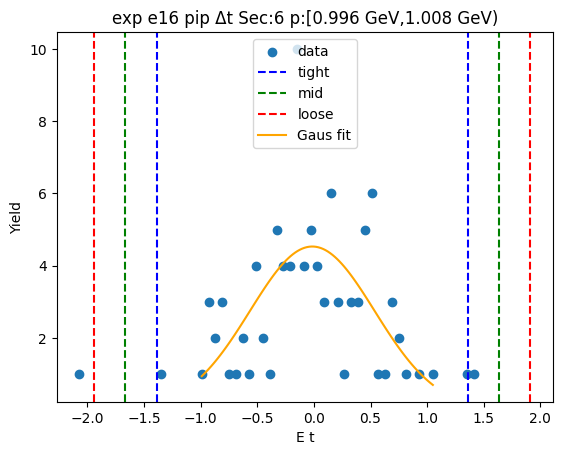

-1.0988374069926448 1.250716531515297
-1.3337928008434388 1.485671925366091
-1.568748194694233 1.7206273192168853
[5.80059677 0.07593956 0.46991079]


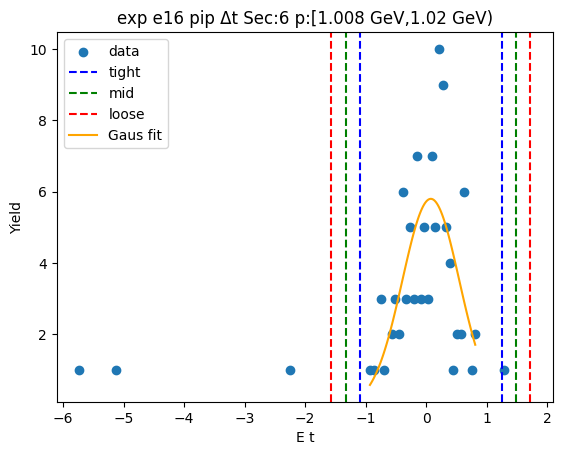

-1.0673665371884826 0.8687663654754212
-1.260979827454873 1.0623796557418115
-1.4545931177212634 1.255992946008202
[ 5.85668369 -0.09930009  0.38722658]


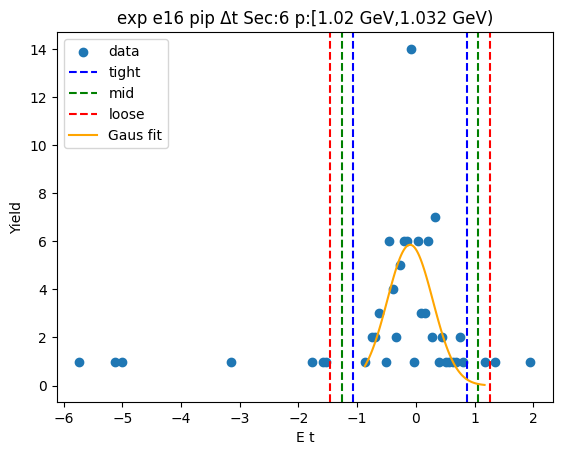

-1.4065163480886096 1.6108938709579779
-1.7082573699932682 1.9126348928626364
-2.009998391897927 2.2143759147672952
[4.55969535 0.10218876 0.60348204]


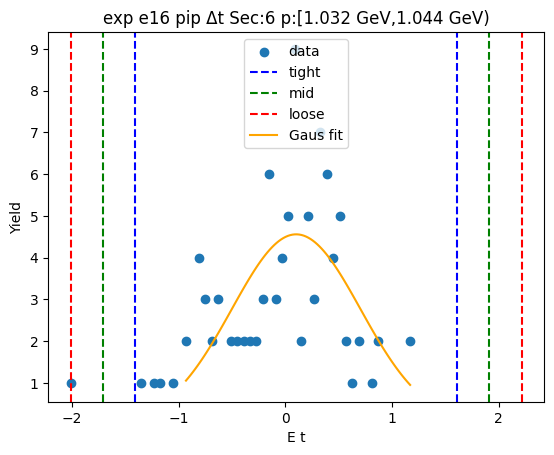

-1.3802916175826507 1.5268560609993405
-1.6710063854408497 1.8175708288575394
-1.9617211532990488 2.1082855967157386
[4.75370145 0.07328222 0.58142954]


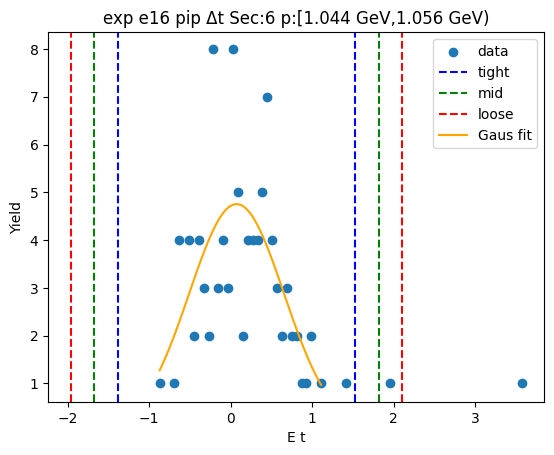

-1.0120598949551634 1.3052267655200114
-1.2437885610026806 1.5369554315675287
-1.4755172270501982 1.7686840976150462
[5.21135529 0.14658344 0.46345733]


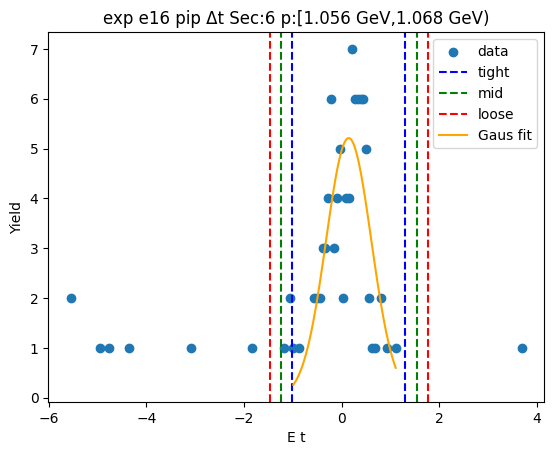

-0.9880545202071284 1.048341425129437
-1.1916941147407847 1.2519810196630934
-1.3953337092744413 1.45562061419675
[4.95929263 0.03014345 0.40727919]


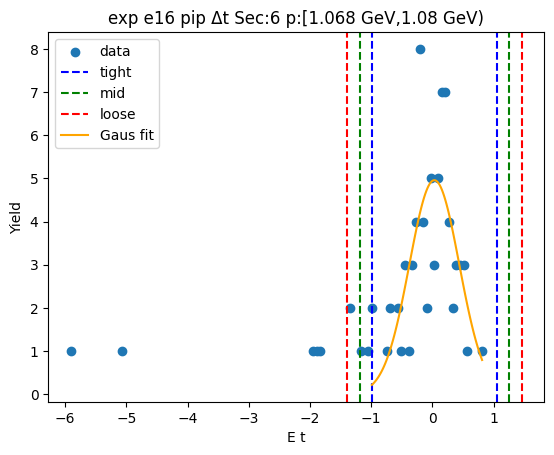

-1.1726194829504388 1.2599502061270753
-1.4158764518581903 1.5032071750348268
-1.6591334207659416 1.746464143942578
[4.81214362 0.04366536 0.48651394]


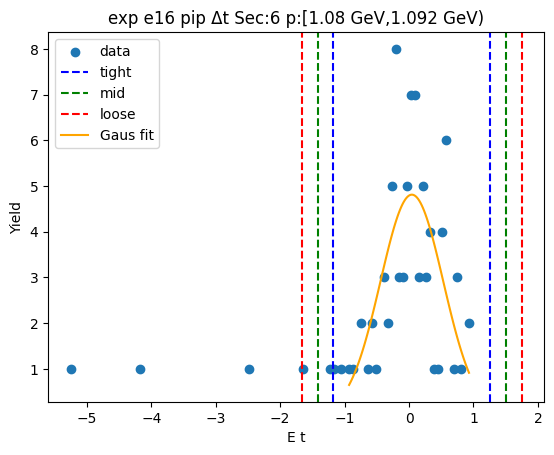

-1.1648047368828074 1.5456006225149395
-1.435845272822582 1.816641158454714
-1.7068858087623566 2.087681694394489
[4.14039368 0.19039794 0.54208107]


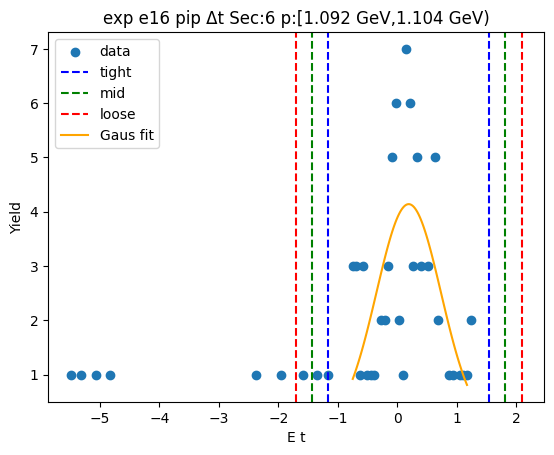

-1.288793329901301 1.6164923194474454
-1.5793218948361758 1.9070208843823202
-1.8698504597710506 2.197549449317195
[3.41798574 0.16384949 0.58105713]


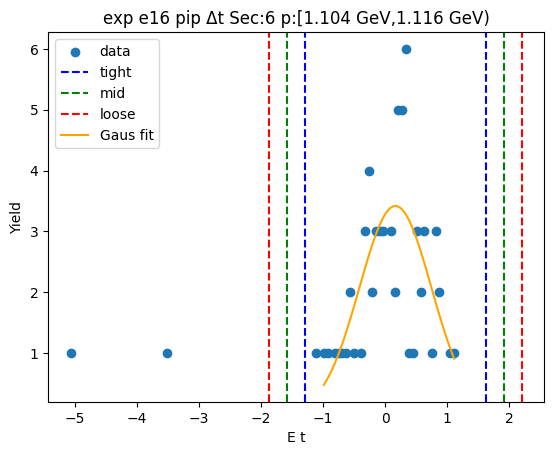

-1.1601797918878436 1.4373345527130676
-1.4199312263479347 1.6970859871731592
-1.6796826608080258 1.9568374216332503
[4.39057815 0.13857738 0.51950287]


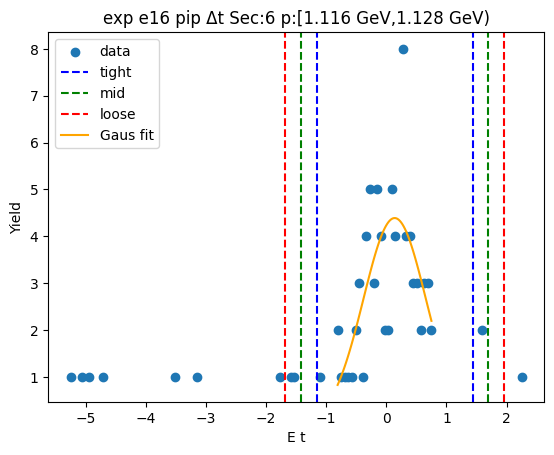

-1.2104334391267941 1.203166529615809
-1.4517934360010545 1.4445265264900693
-1.6931534328753148 1.6858865233643296
[ 4.26714395e+00 -3.63345476e-03  4.82719994e-01]


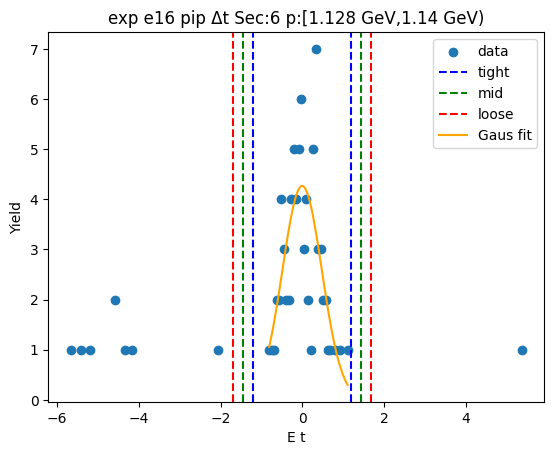

-1.1481548139007707 1.52518205489134
-1.4154885007799816 1.7925157417705508
-1.6828221876591927 2.0598494286497617
[3.89912422 0.18851362 0.53466737]


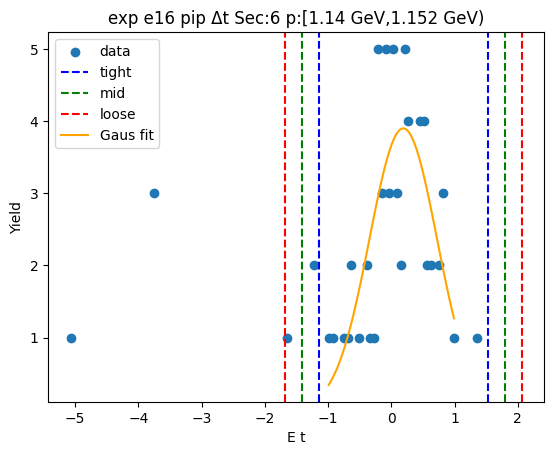

-1.4392689410073123 1.581770279737034
-1.741372863081747 1.883874201811469
-2.0434767851561815 2.1859781238859033
[3.70969758 0.07125067 0.60420784]


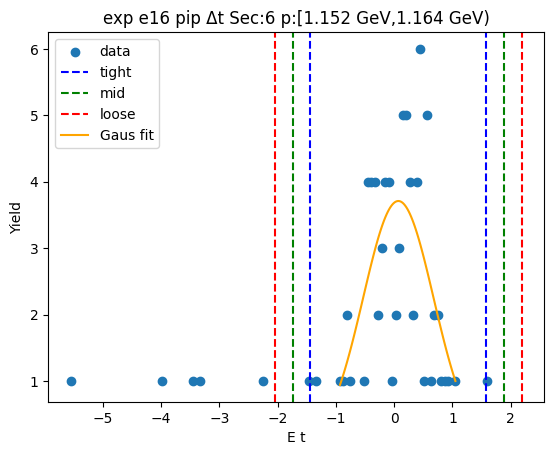

-1.5257410704853813 1.4815795113610857
-1.8264731286700282 1.7823115695457326
-2.127205186854675 2.0830436277303788
[ 3.10983601 -0.02208078  0.60146412]


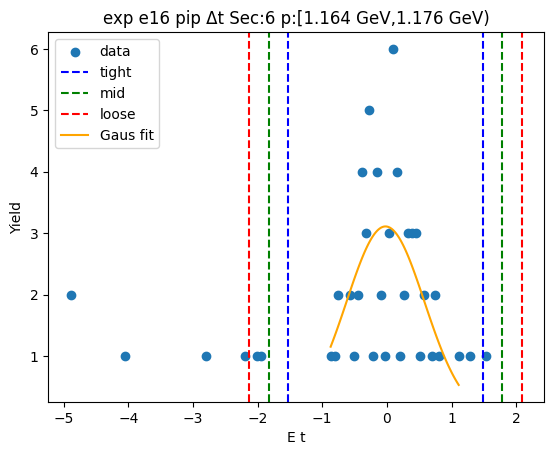

-1.3984925241108779 1.1558427617001121
-1.653926052691977 1.4112762902812113
-1.9093595812730761 1.6667098188623104
[ 3.98016053 -0.12132488  0.51086706]


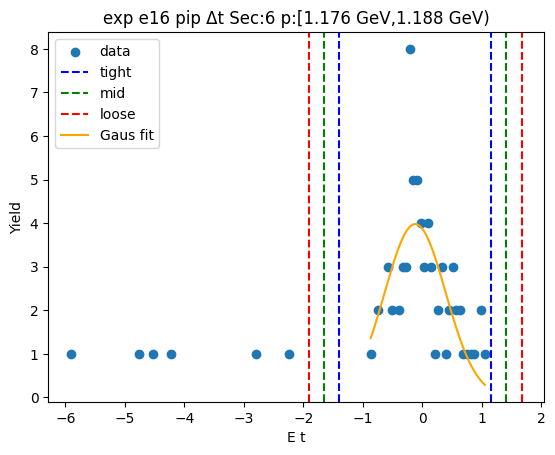

-1.0374387758670085 1.1074385938670603
-1.2519265128404153 1.3219263308404672
-1.4664142498138222 1.536414067813874
[3.84373652 0.03499991 0.42897547]


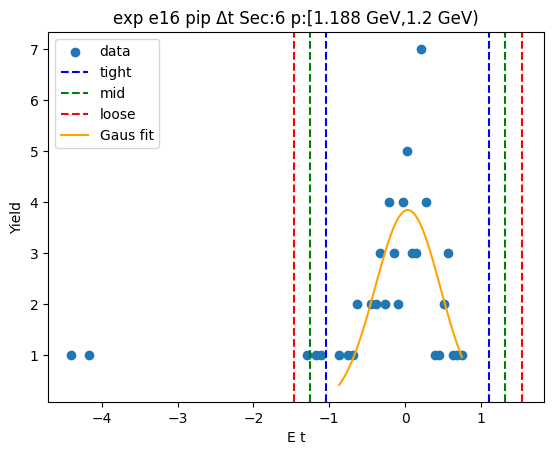

-1.1432654121447996 1.1496771234134897
-1.3725596657006285 1.3789713769693186
-1.6018539192564574 1.6082656305251475
[4.62356672e+00 3.20585563e-03 4.58588507e-01]


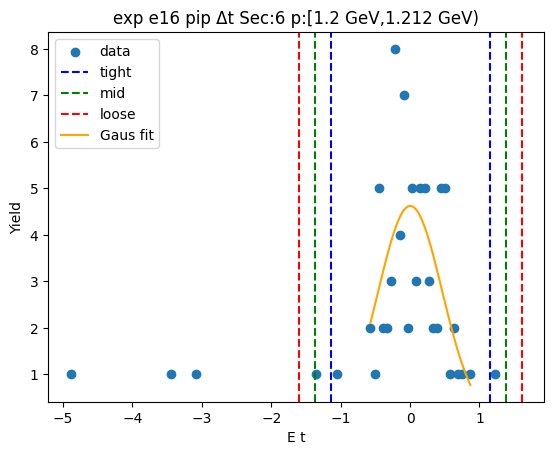

-1.0742837211008427 1.257030550586827
-1.3074151482696095 1.4901619777555937
-1.5405465754383765 1.7232934049243607
[3.72397979 0.09137341 0.46626285]


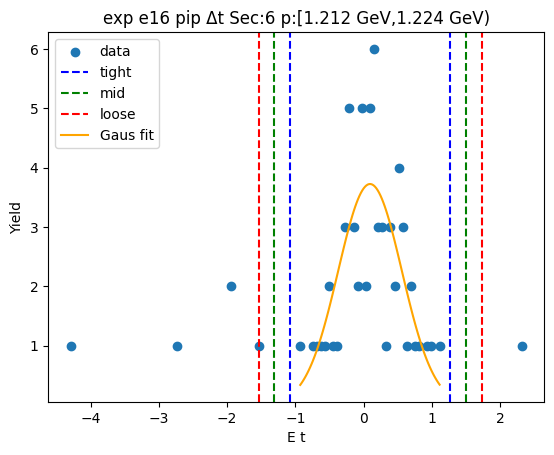

-1.3395226361890071 1.5412410913740417
-1.6275990089453118 1.8293174641303465
-1.915675381701617 2.1173938368866514
[2.68825651 0.10085923 0.57615275]


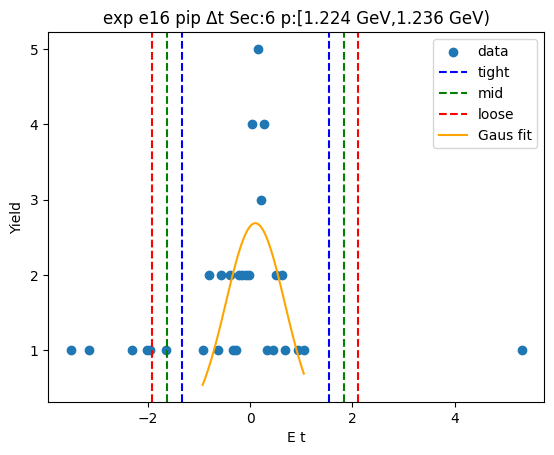

-1.2841134470290698 1.303866749058392
-1.5429114666378159 1.562664768667138
-1.801709486246562 1.821462788275884
[3.37281586 0.00987665 0.51759604]


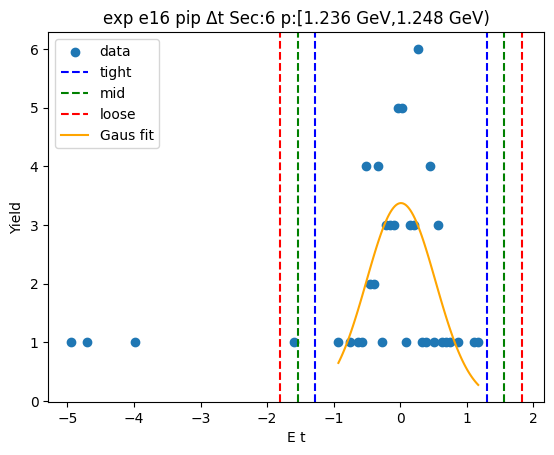

-1.5090182914860315 1.1706007206354685
-1.7769801926981816 1.4385626218476186
-2.0449420939103318 1.7065245230597688
[ 3.43686177 -0.16920879  0.5359238 ]


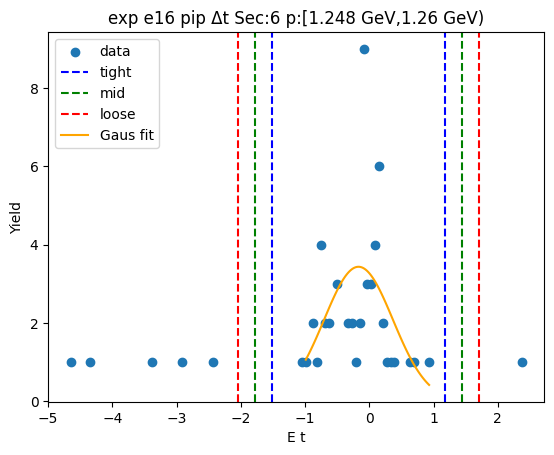

-1.207446513404939 1.2067877091862709
-1.4488699356640602 1.448211131445392
-1.6902933579231811 1.689634553704513
[ 3.59139631e+00 -3.29402109e-04  4.82846845e-01]


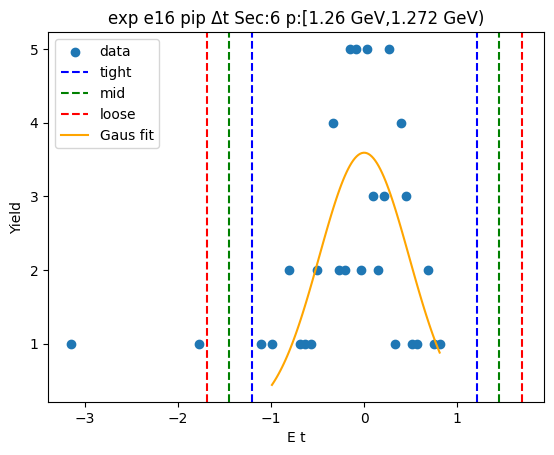

-1.6931244864138193 1.7998380937342515
-2.042420744428626 2.1491343517490584
-2.3917170024434333 2.4984306097638656
[2.78202905 0.0533568  0.69859252]


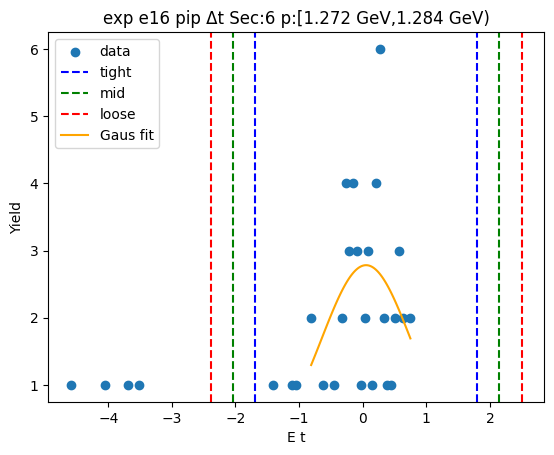

-1.9631605586146423 1.734606543687288
-2.3329372688448355 2.104383253917481
-2.7027139790750283 2.474159964147674
[ 3.20163103 -0.11427701  0.73955342]


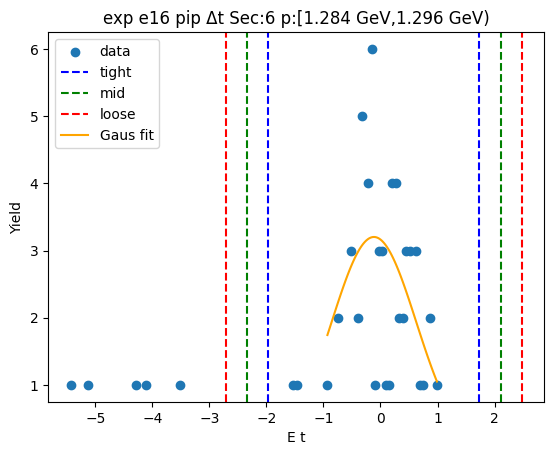

-1.292951299915917 1.266035551340452
-1.548849985041554 1.521934236466089
-1.8047486701671909 1.777832921591726
[ 3.63519462 -0.01345787  0.51179737]


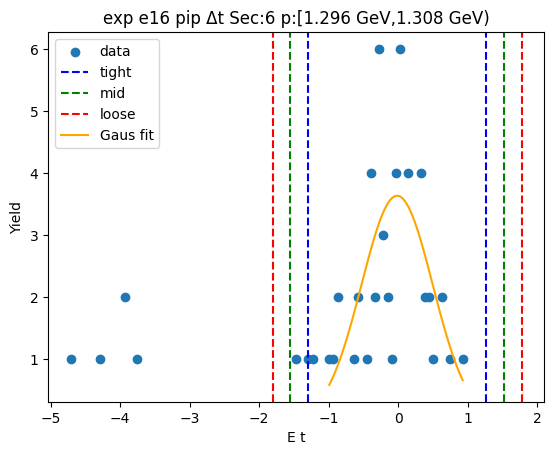

-1.141019323503415 1.219019318322536
-1.37702318768601 1.455023182505131
-1.6130270518686052 1.6910270466877262
[3.4595938  0.039      0.47200773]


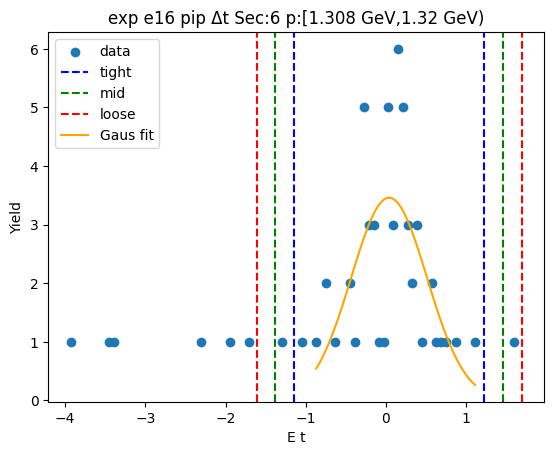

-1.5327880345163691 1.7117846431315031
-1.8572453022811564 2.0362419108962904
-2.181702570045944 2.360699178661078
[2.71521424 0.0894983  0.64891454]


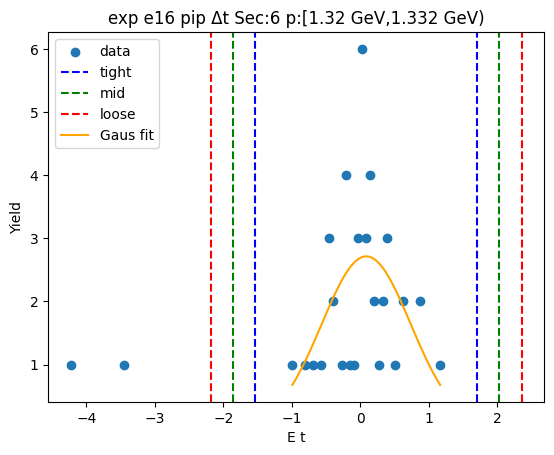

-0.8148988069581452 1.0672986408844725
-1.003118551742407 1.2555183856687342
-1.1913382965266688 1.443738130452996
[4.71209902 0.12619992 0.37643949]


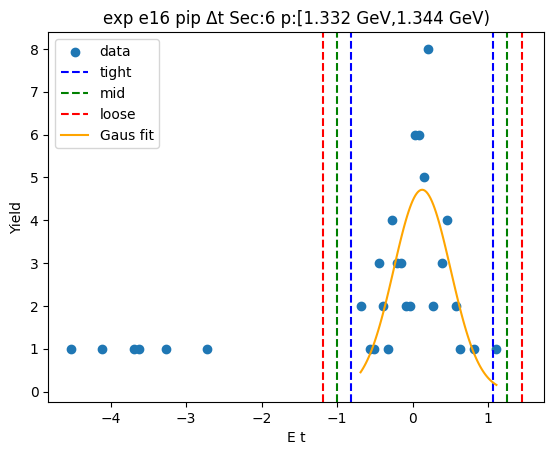

-1.6718154300179133 1.8278287270194564
-2.0217798457216505 2.1777931427231936
-2.371744261425387 2.5277575584269303
[2.46062876 0.07800665 0.69992883]


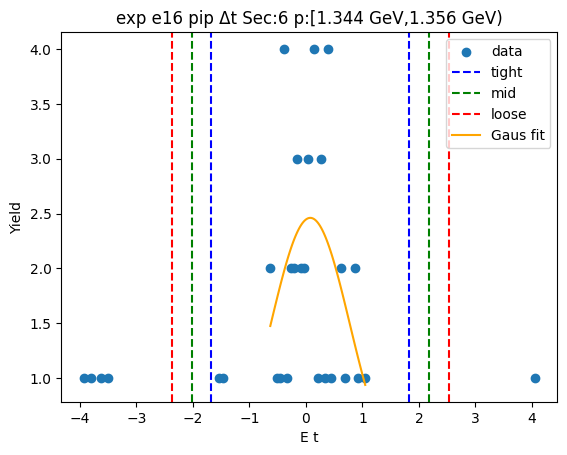

-1.3425752236821442 1.6009745728079003
-1.6369302033311488 1.895329552456905
-1.9312851829801534 2.1896845321059093
[2.80094351 0.12919967 0.58870996]


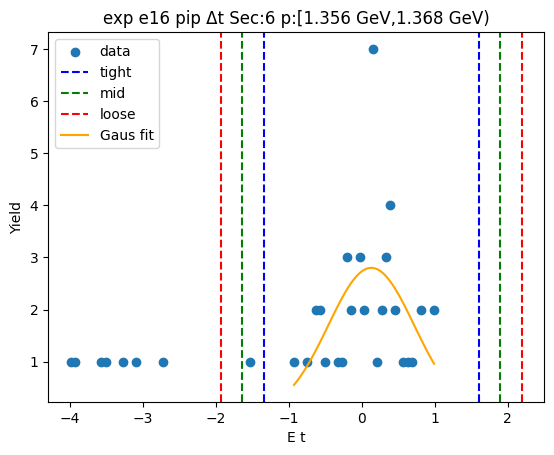

-0.8515990305915725 1.1258672193124215
-1.049345655581972 1.323613844302821
-1.2470922805723714 1.5213604692932203
[2.97569929 0.13713409 0.39549325]


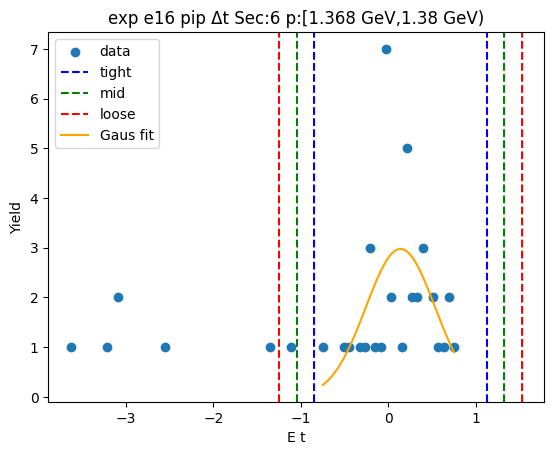

-0.943512314877427 0.9113721591652729
-1.129000762281697 1.0968606065695432
-1.314489209685967 1.2823490539738132
[ 3.34792435 -0.01607008  0.37097689]


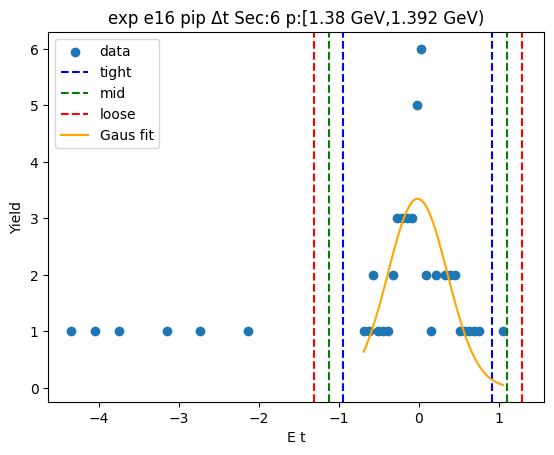

-1.6312592839990046 1.7351999930660418
-1.9679052117055094 2.0718459207725464
-2.304551139412014 2.4084918484790507
[2.03330595 0.05197035 0.67329186]


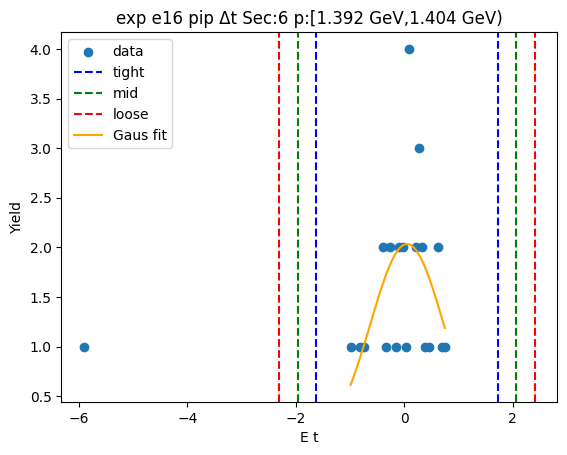

-1.4624303321117371 1.3924227762310344
-1.747915642946014 1.6779080870653114
-2.0334009537802915 1.9633933978995886
[ 3.29999034 -0.03500378  0.57097062]


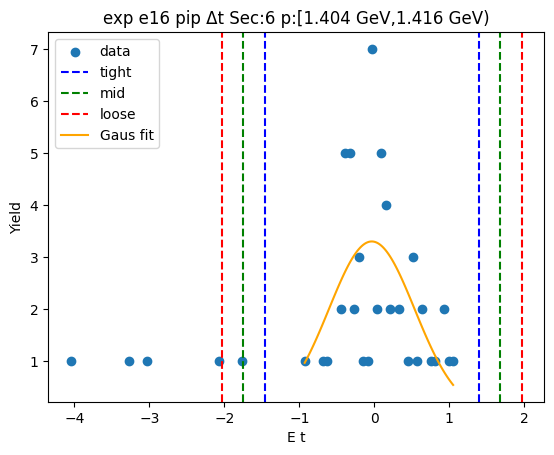

-1.4521719187199094 1.6369740021077002
-1.7610865108026703 1.9458885941904611
-2.070001102885431 2.254803186273222
[2.45579673 0.09240104 0.61782918]


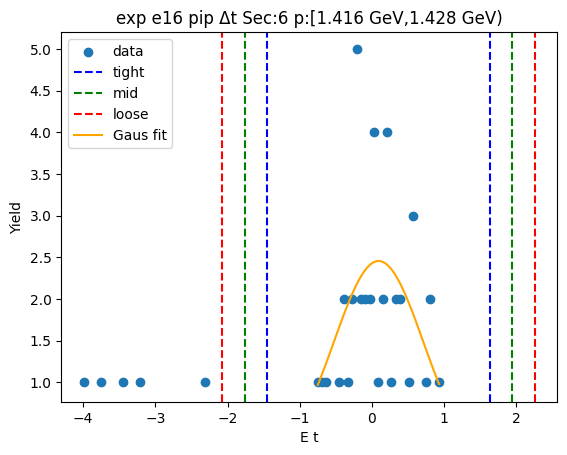

-0.7780456019107074 0.9271602999244999
-0.9485661920942281 1.0976808901080206
-1.1190867822777488 1.2682014802915413
[3.85704756 0.07455735 0.34104118]


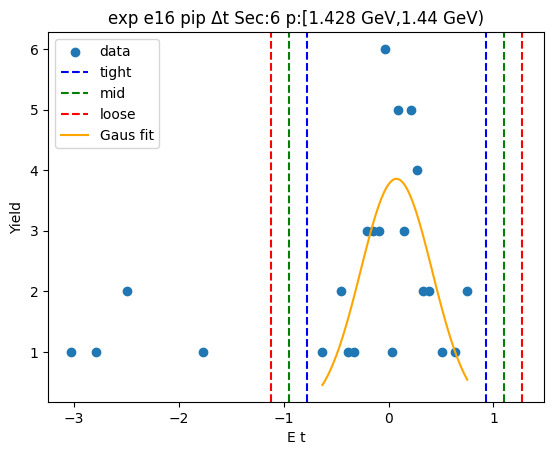

-1.6244939843389146 1.9415801804156843
-1.9811014008143748 2.2981875968911445
-2.3377088172898346 2.6547950133666043
[2.73046065 0.1585431  0.71321483]


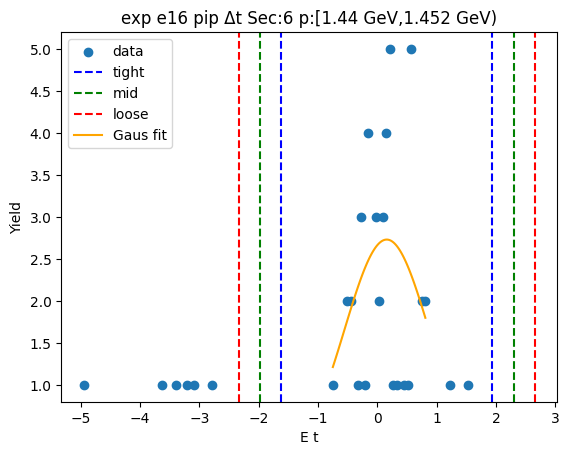

-1.1713458282425093 1.361304159021611
-1.4246108269689215 1.6145691577480232
-1.6778758256953337 1.8678341564744354
[2.82926631 0.09497917 0.50653   ]


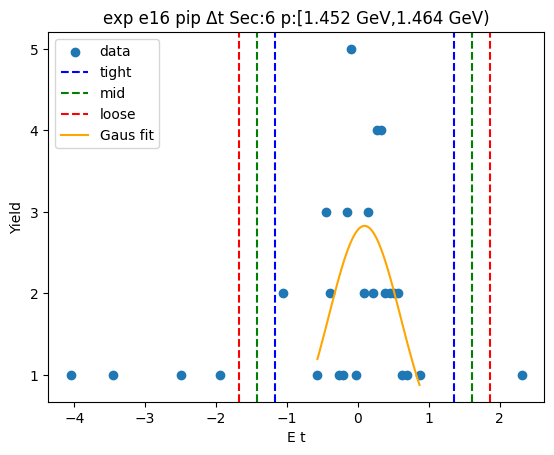

-1.388721235908158 1.1739398854599752
-1.6449873480449715 1.4302059975967887
-1.9012534601817848 1.686472109733602
[ 3.01660283 -0.10739068  0.51253222]


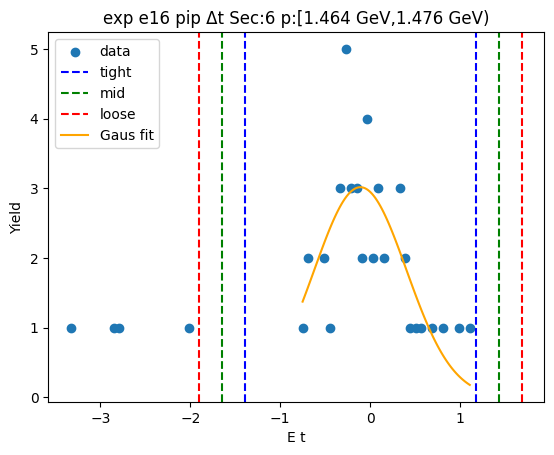

-1.7516608466466657 1.7714453449736018
-2.103971465808693 2.1237559641356287
-2.4562820849707196 2.4760665832976554
[2.26777121 0.00989225 0.70462124]


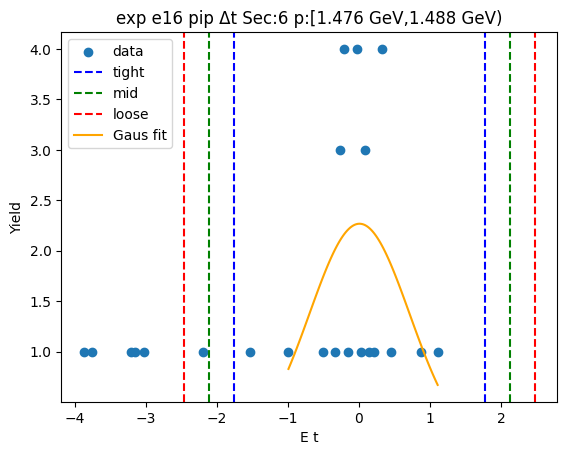

-1.723467838522866 1.7719896401739093
-2.0730135863925434 2.1215353880435868
-2.422559334262221 2.4710811359132645
[2.14721098 0.0242609  0.6990915 ]


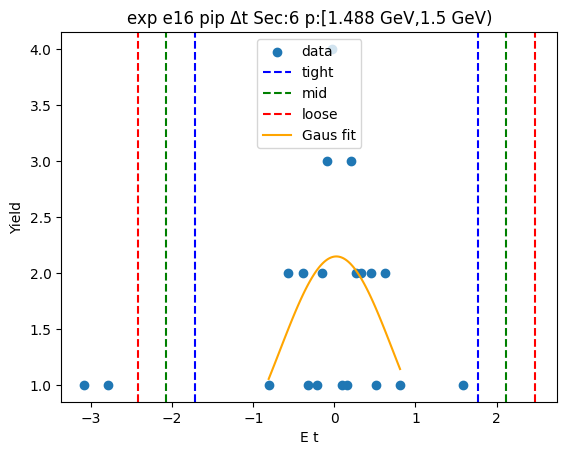

0.3804282218898003 -0.2375010029196032
0.4422211443707406 -0.2992939254005435
0.5040140668516809 -0.3610868478814838
[2.14721098 0.0242609  0.6990915 ]


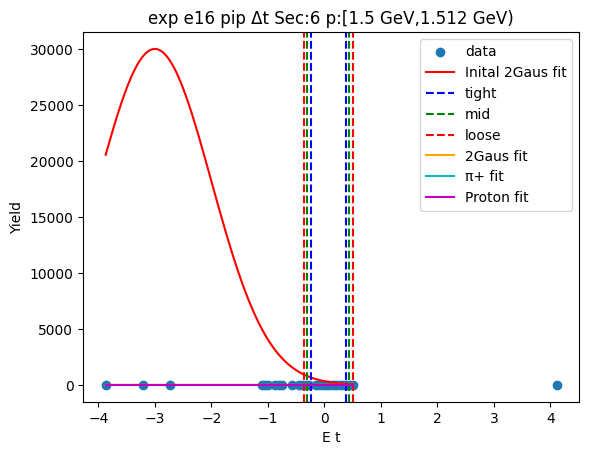

1.7551223893792633 -1.8123622940330575
2.111870857720495 -2.16911076237429
2.4686193260617273 -2.525859230715522
[2.14721098 0.0242609  0.6990915 ]


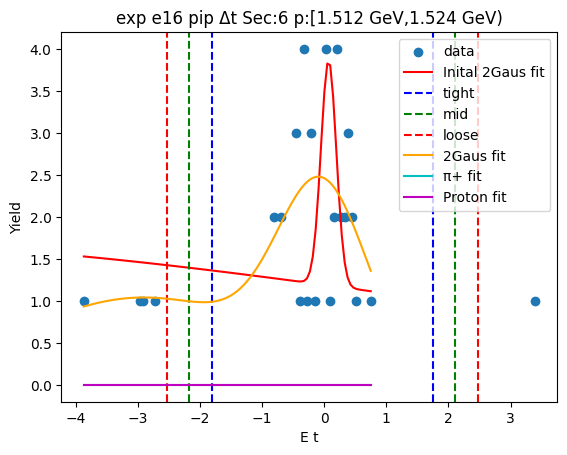

Runtime Error
[2.14721098 0.0242609  0.6990915 ]


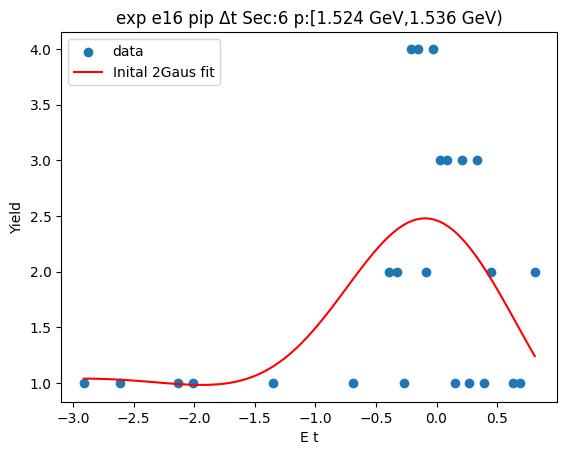

0.1252992422740909 -0.06439019729484355
0.14426818623098434 -0.08335914125173702
0.16323713018787778 -0.10232808520863046
[2.14721098 0.0242609  0.6990915 ]


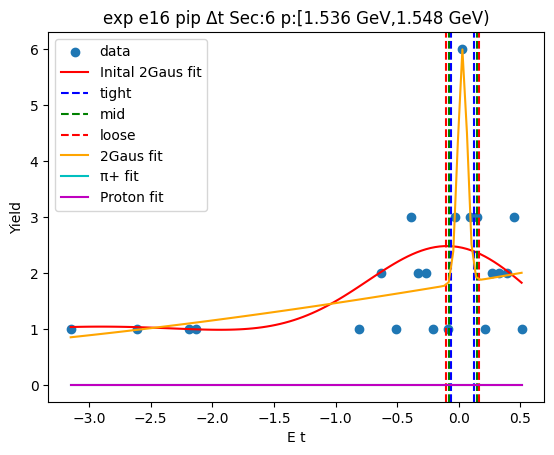

-0.016658232896867894 -0.0866849180832251
-0.009655564378232173 -0.09368758660186081
-0.002652895859596452 -0.10069025512049654
[2.14721098 0.0242609  0.6990915 ]


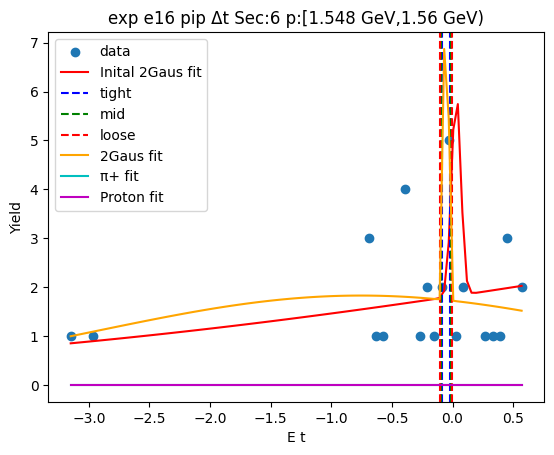

-0.028635981626567046 -0.05628590812887787
-0.025870988976335964 -0.05905090077910895
-0.023105996326104883 -0.06181589342934003
[2.14721098 0.0242609  0.6990915 ]


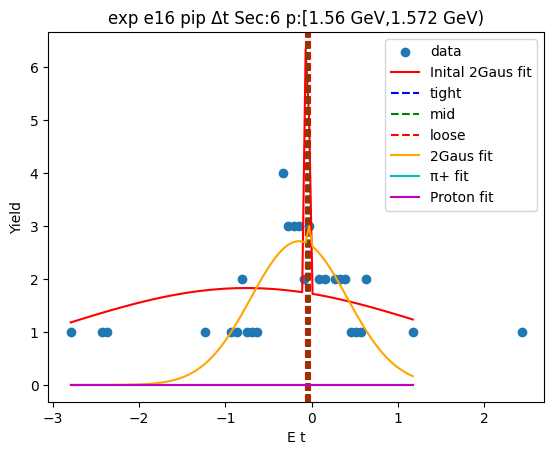

Runtime Error
[2.14721098 0.0242609  0.6990915 ]


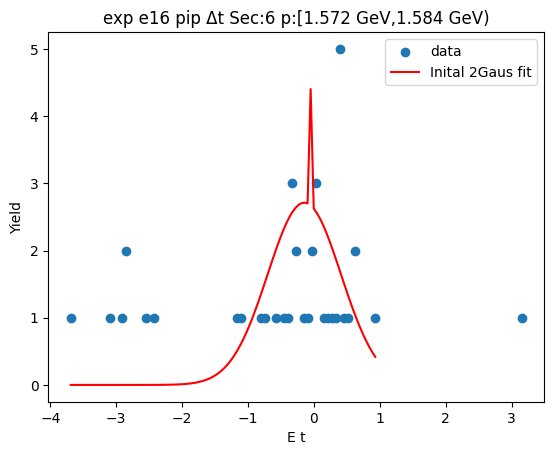

-0.06484431613936213 -0.028512555209449897
-0.06847749223235336 -0.024879379116458676
-0.07211066832534457 -0.021246203023467452
[2.14721098 0.0242609  0.6990915 ]


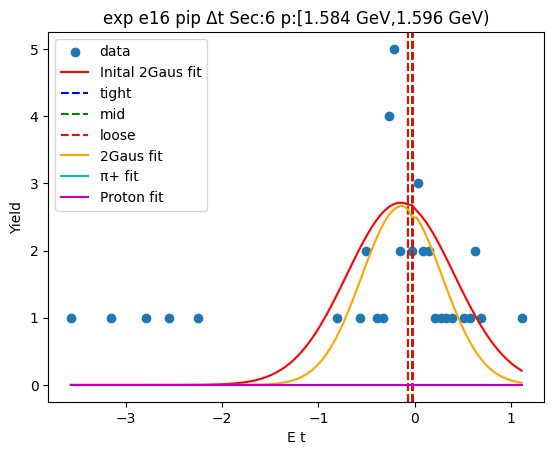

-0.06012713541207969 -0.026521392192294047
-0.06348770973405826 -0.02316081787031548
-0.06684828405603682 -0.019800243548336916
[2.14721098 0.0242609  0.6990915 ]


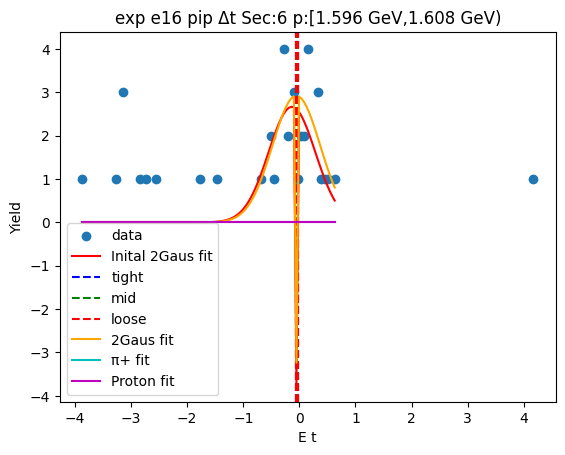

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


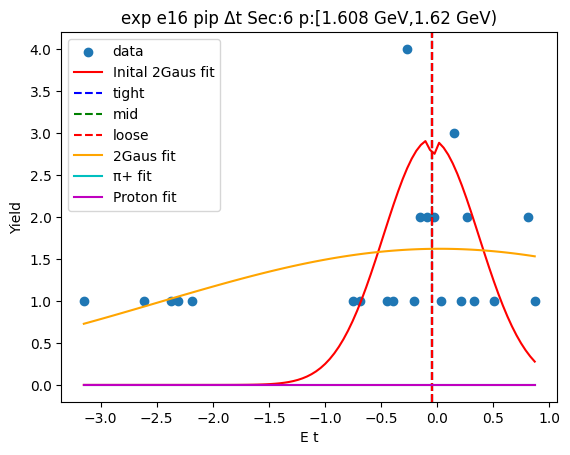

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


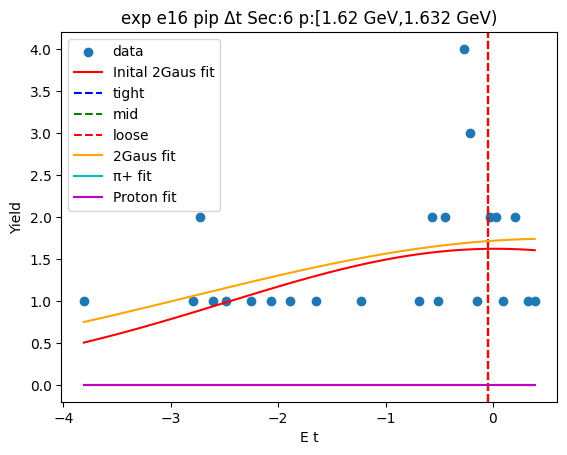

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


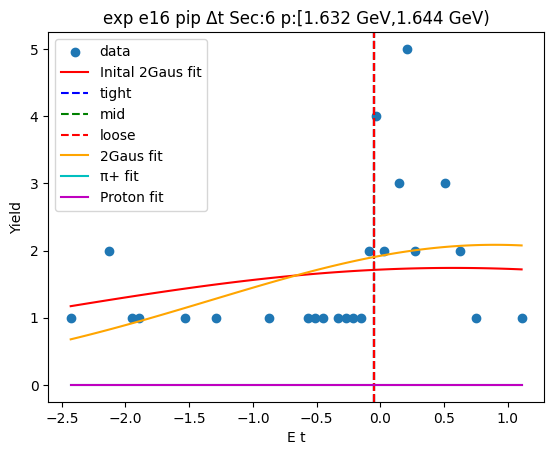

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


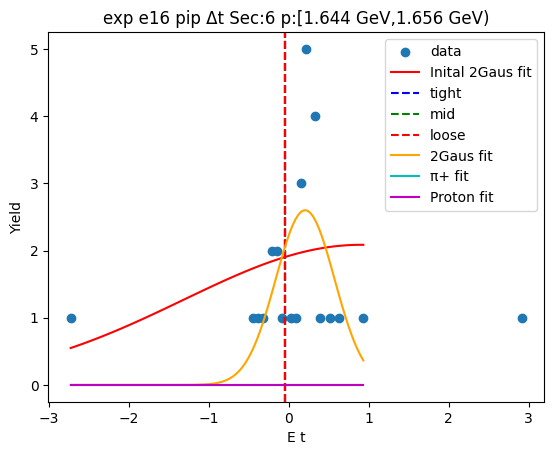

Runtime Error
[2.14721098 0.0242609  0.6990915 ]


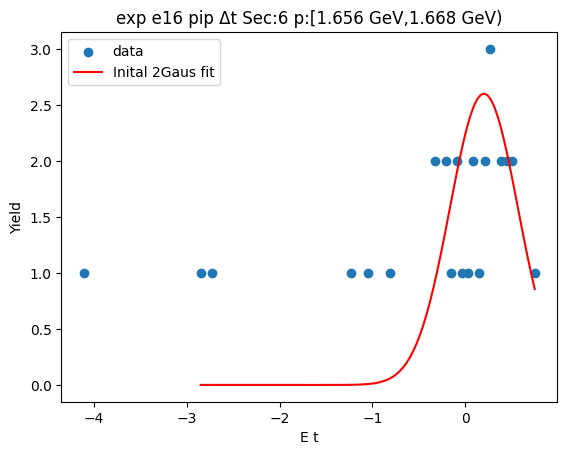

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


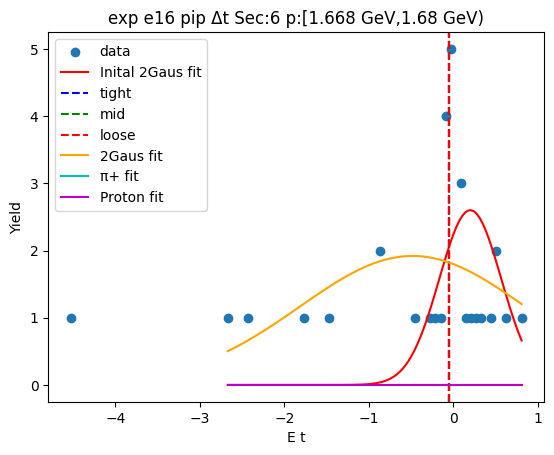

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


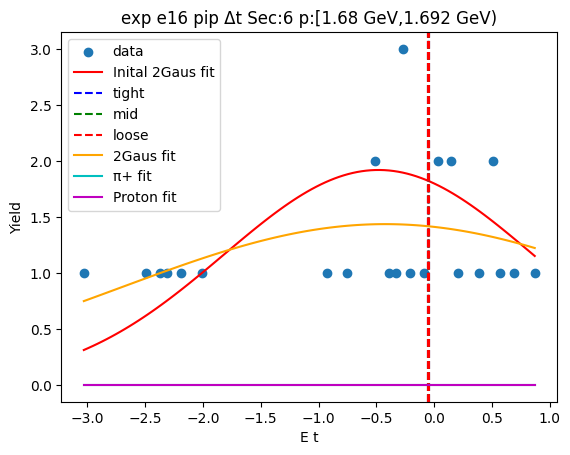

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


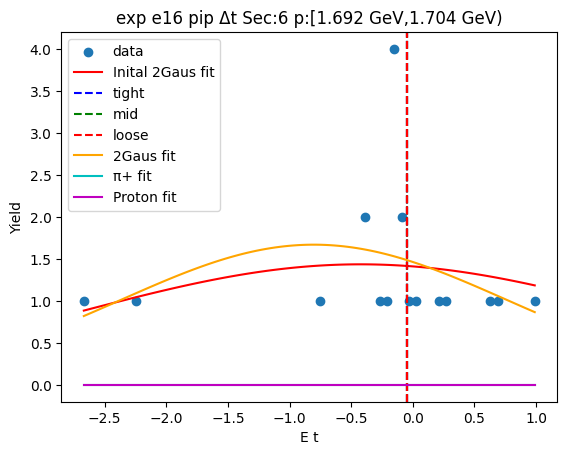

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


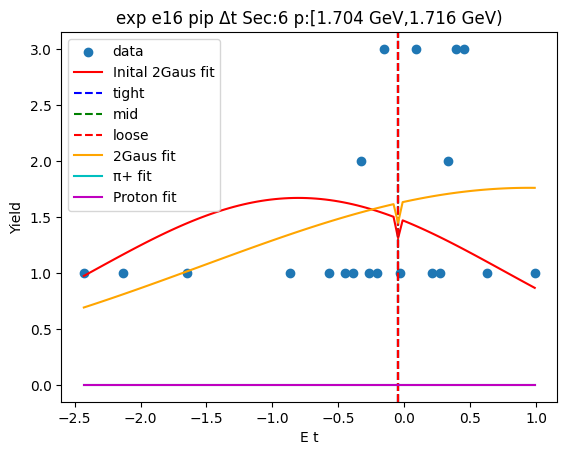

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


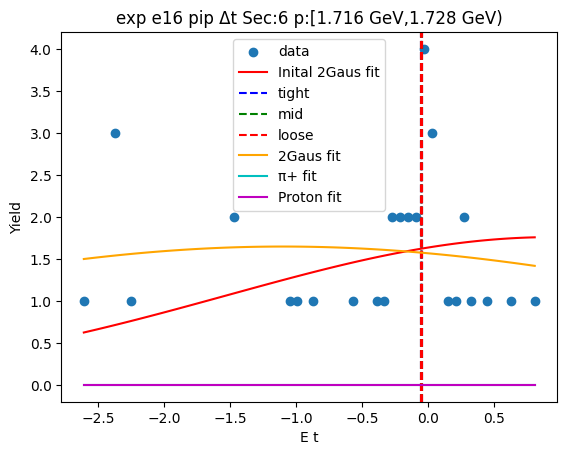

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


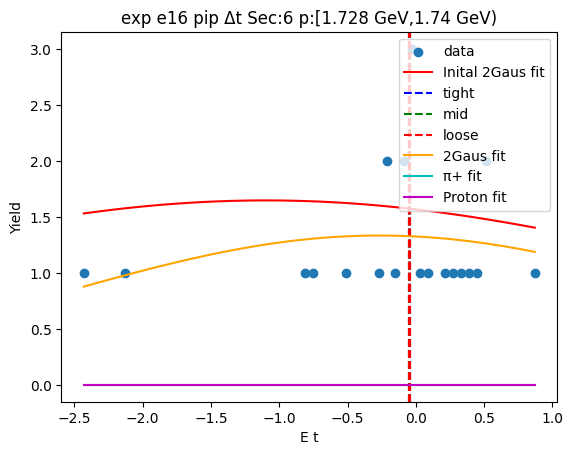

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


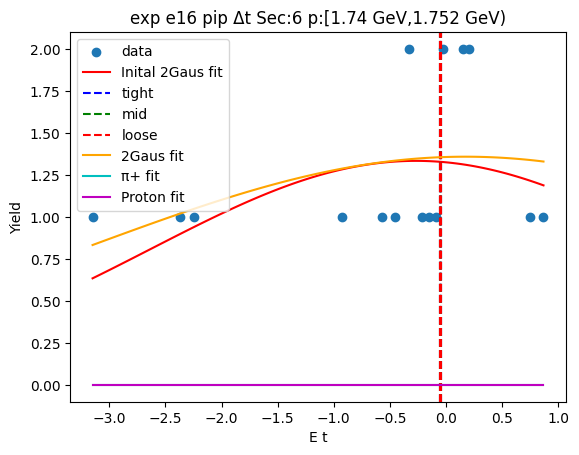

Runtime Error
[2.14721098 0.0242609  0.6990915 ]


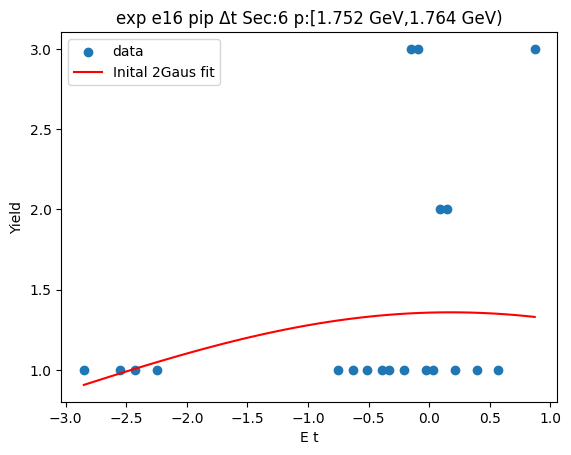

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


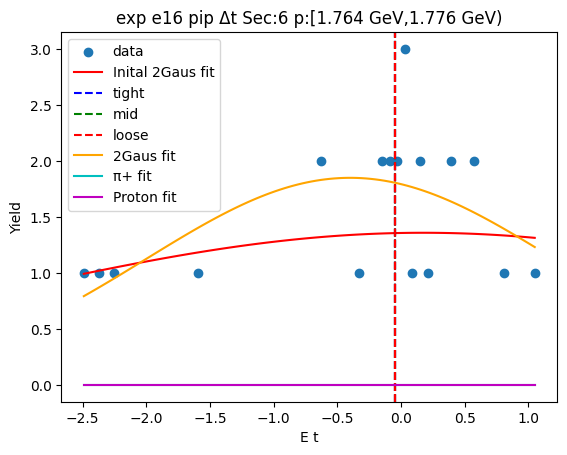

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


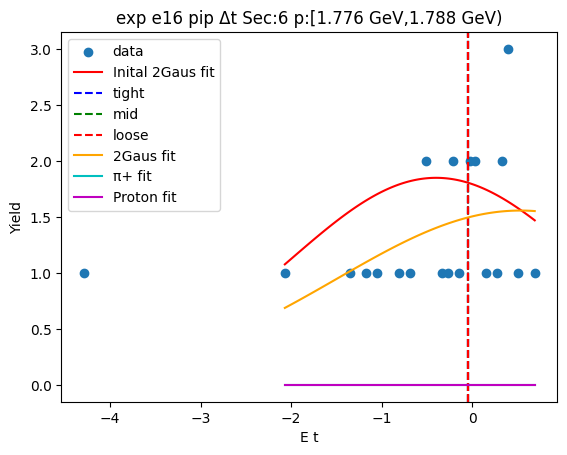

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


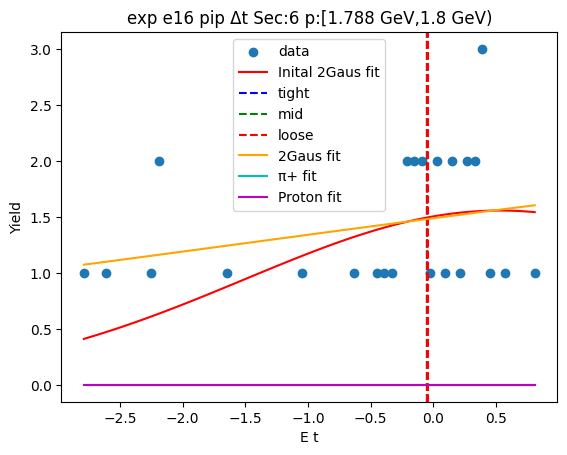

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


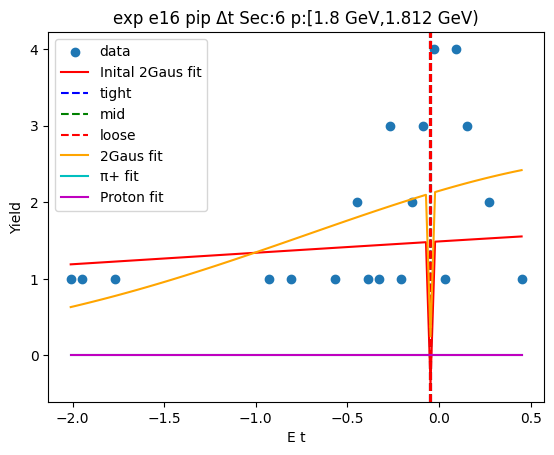

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


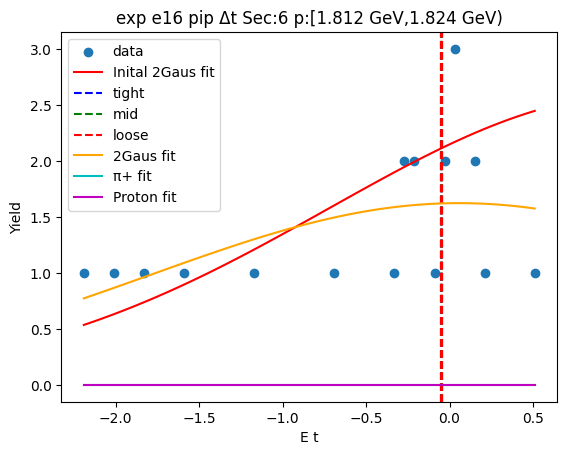

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


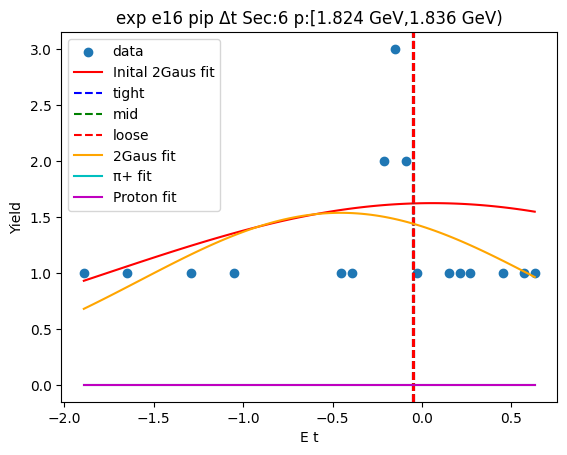

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


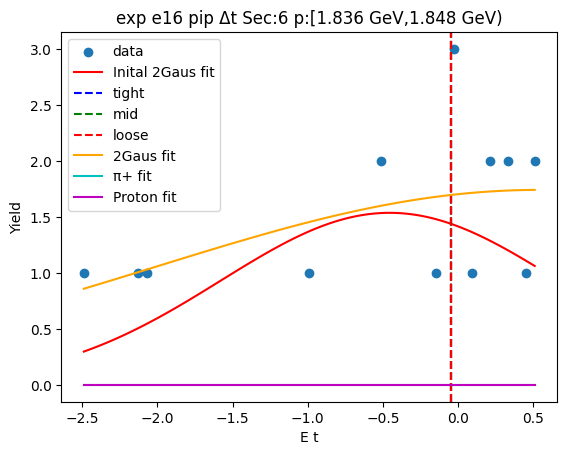

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


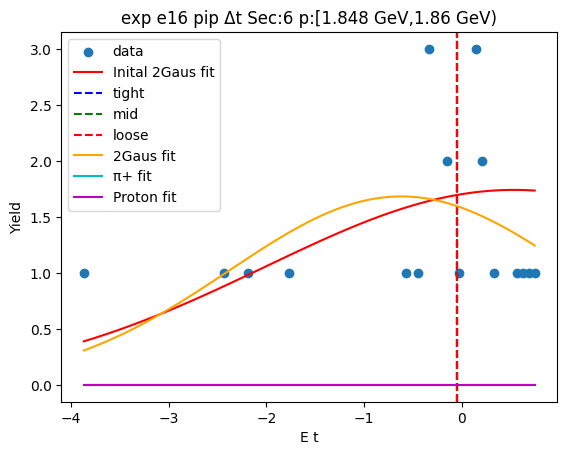

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


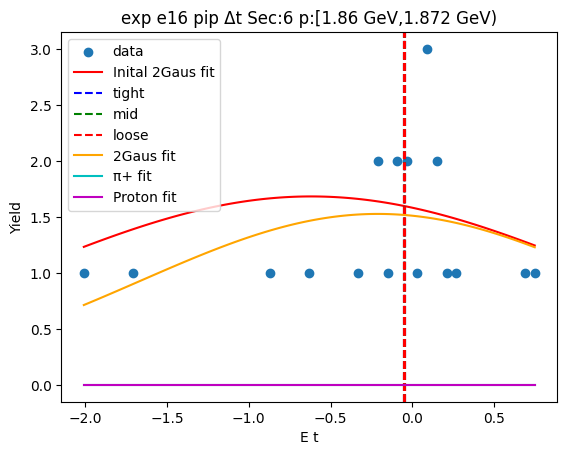

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


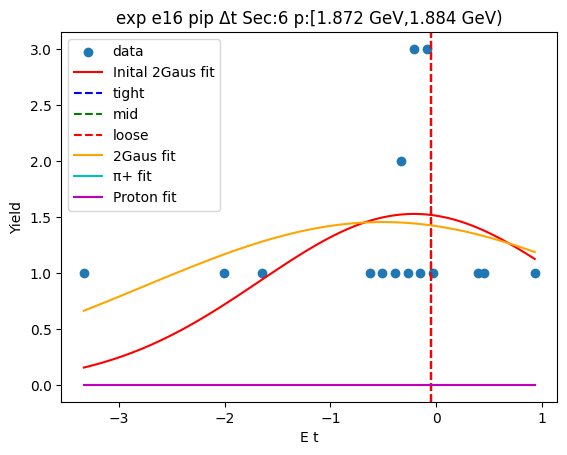

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


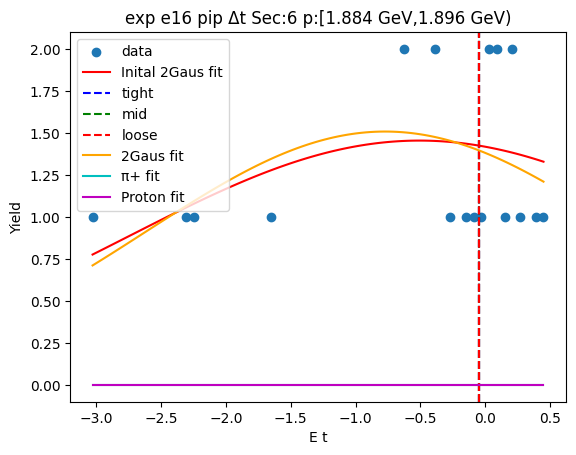

Runtime Error
[2.14721098 0.0242609  0.6990915 ]


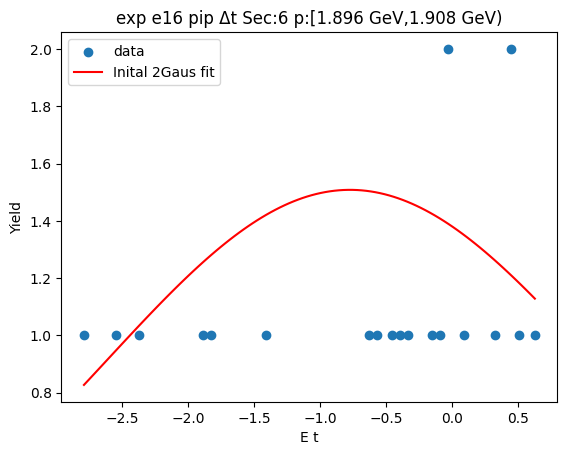

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


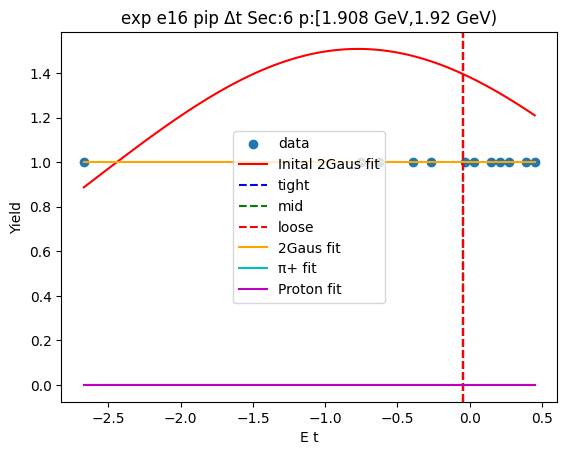

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


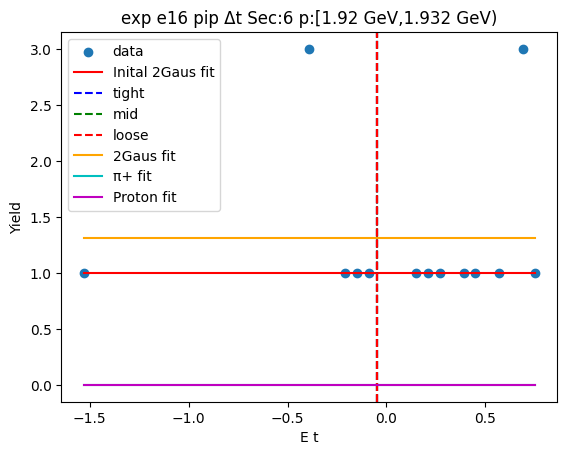

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


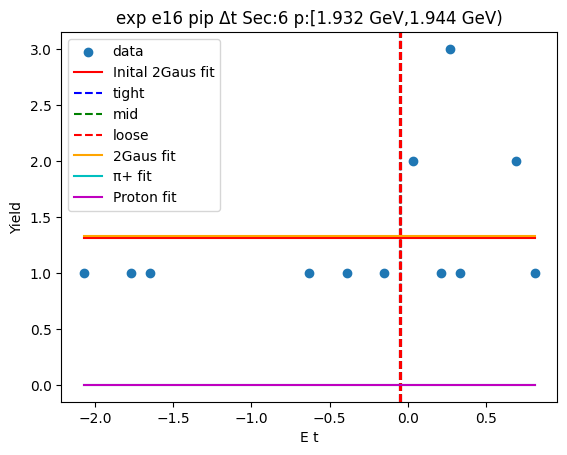

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


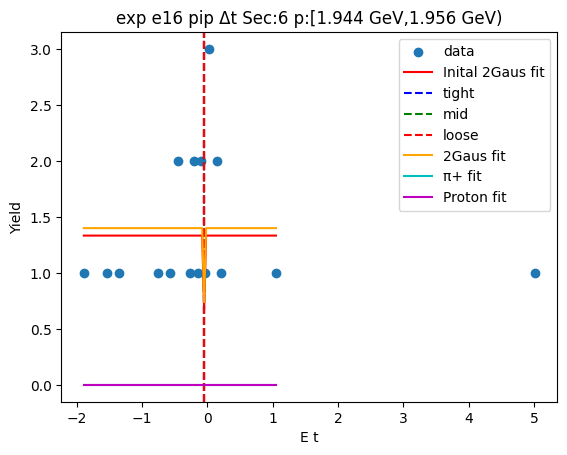

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


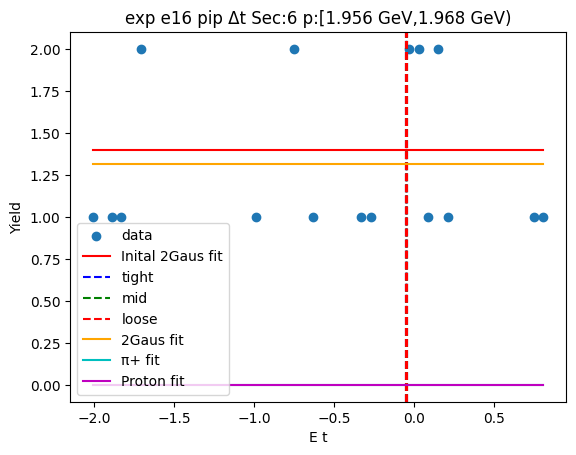

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


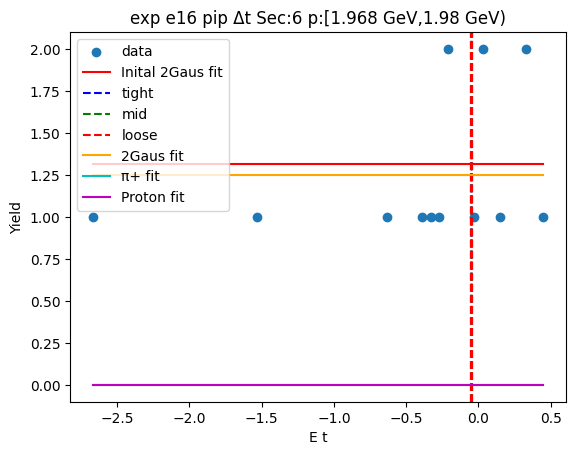

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


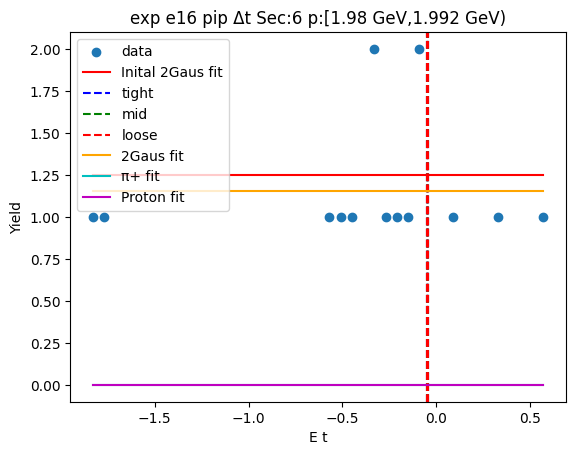

-0.046421947740662516 -0.04902596480265125
-0.046161546034463645 -0.04928636650885012
-0.045901144328264774 -0.04954676821504899
[2.14721098 0.0242609  0.6990915 ]


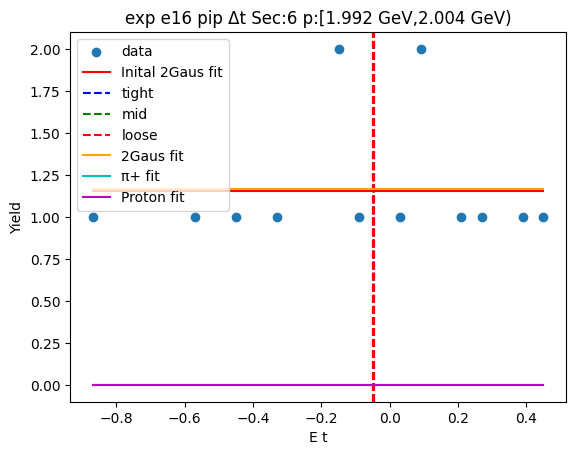

In [53]:
#Initial Guesses for Gaussian Fit
a1=30
m1=0.01
s1=1.5
initial_pars1=[3.95304416, 0.35017566, 0.62554042]

initial_pars2 = [30000,-3.0,1.0]

inital_pars3 = []

tmp_par1 = np.zeros(3)
tmp_par2 = np.zeros(6)

#par_bound_low = [0.0,0.0,0.0]
#par_bound_top = [inf,inf,inf]

fit_pars1 = np.zeros((6,len(x),6))
err1 = np.zeros((6,len(x),3))
bound_mod=[0.6,]
low_mod = 1.2
norm_mod=1.2
min_p = [0.3,0.3,0.3,0.3,0.3,0.3]
mid_p = 1.5
p_cutoff = [1.75,1.75,2.0,1.85,1.75,2.0]

num_sigma1 = [2.5,3,3.5]
bounds1 = np.zeros((6,2,3,len(x)))
sigma1= np.zeros((6,2,3,len(x)))

g1_pars = np.zeros((6,len(x),3))
g2_pars = np.zeros((6,len(x),3))

for sec in range(6):
    for i in range(3):
        tmp_par1[i] = initial_pars1[i]
        for j in range(2):
            if j ==0:
                tmp_par2[i+j*3]= initial_pars1[i]
            elif j ==1:
                tmp_par2[i+j*3]= initial_pars2[i]
    for xbin in range(len(x)):
        if fit_y[sec][xbin].sum()>10 and x[xbin]>min_p[sec] and x[xbin]<p_cutoff[sec]:
            #Set the amplitude guess to the maximum yield value
            initial_pars1[0] = np.amax(fit_y[sec][xbin])
            plt.scatter(fit_x[sec][xbin],fit_y[sec][xbin],label="data")
            #Initial Fitting
            #Set Fit Range
            if x[xbin]<mid_p:  
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x1 = Bounds_on_Y(fit_x[sec][xbin],-1.0,1.2)
                fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-1.0,1.2)
                cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
                try:
                    pars1 = op.curve_fit(Gaus,fit_x1,fit_y1,p0=tmp_par1,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars1[0][i]
                        tmp_par1[i]=pars1[0][i]
                        tmp_par2[i]=pars1[0][i]
                        err1[sec][xbin][i]=np.sqrt(pars1[1][i][i])
                        bounds1[sec][0][i][xbin] = pars1[0][1] - num_sigma1[i]*pars1[0][2]
                        bounds1[sec][1][i][xbin] = pars1[0][1] + num_sigma1[i]*pars1[0][2]
                        sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]
                        sigma1[sec][1][i][xbin] = pars1[1][1][1] + num_sigma1[i]*pars1[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                    plt.plot(cont_x1,Gaus(cont_x1,*pars1[0]),color='orange',label='Gaus fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            else:
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x2 = Bounds_on_Y(fit_x[sec][xbin],-4.0,2.0)
                fit_y2 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-4.0,2.0)
                cont_x2 = np.linspace(fit_x2[0],fit_x2[len(fit_x2)-1],100)
                plt.plot(cont_x2,Gaus2(cont_x2,*tmp_par2),color='r',label='Inital 2Gaus fit')
                try:
                    pars2 = op.curve_fit(Gaus2,fit_x2,fit_y2,p0=tmp_par2,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars2[0][i]
                        g1_pars[sec][xbin][i] = pars2[0][i]
                        g2_pars[sec][xbin][i] = pars2[0][i+3]
                        err1[sec][xbin][i]=np.sqrt(pars2[1][i][i])
                        bounds1[sec][0][i][xbin] = pars2[0][1] - num_sigma1[i]*pars2[0][2]
                        bounds1[sec][1][i][xbin] = pars2[0][1] + num_sigma1[i]*pars2[0][2]
                        sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]
                        sigma1[sec][1][i][xbin] = pars2[1][1][1] + num_sigma1[i]*pars2[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                        for j in range(2):
                            tmp_par2[i+j*3]= pars2[0][i+j*3]
                    plt.plot(cont_x2,Gaus2(cont_x2,*pars2[0]),color='orange',label='2Gaus fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g1_pars[0][xbin]),color='c',label='\u03C0+ fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g2_pars[0][xbin]),color='m',label='Proton fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            
            
            #if np.sqrt(pars1[1][1][1])/pars1[0][1] < 0.1:
            
            cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
            print(pars1[0])
           
            plot_title="{} {} {} \u0394t Sec:{} p:[{} GeV,{} GeV)".format(sim,run,species,sec+1,Pbin_low(xbin),Pbin_top(xbin))
            plt.title(plot_title)
            plt.xlabel(yname)
            plt.ylabel("Yield")
            plt.legend()
            plt.show()

In [54]:

for sec in range(6):
    for cut in range(3):
        for xbin in range(len(x)):
            bounds1[sec][0][cut][xbin] = fit_pars1[sec][xbin][1]-num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][0][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]
            bounds1[sec][1][cut][xbin] = fit_pars1[sec][xbin][1]+num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][1][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]

top [-1.07663057e+00  7.63469050e+00 -6.20290426e+00 -2.21890001e-18]
low [ -4.59014171  20.72187519 -33.84295699  16.79498807]
top [-1.13628669e+00  8.51014777e+00 -6.92383648e+00 -3.86125325e-25]
low [ -4.86217742  21.60873253 -35.9322195   18.1510121 ]
top [-1.19547881e+00  9.38397129e+00 -7.64373374e+00 -1.16560985e-08]
low [ -5.13350249  22.49177848 -38.01542676  19.50436176]


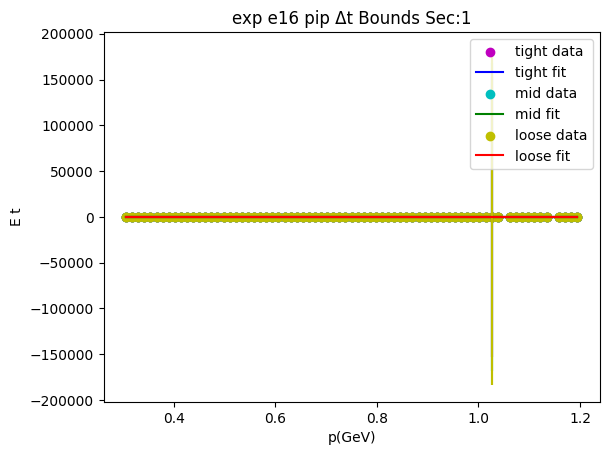

top [  6.43644363 -32.58398693  57.92313052 -32.91439081]
low [ -4.45330503  23.84345498 -48.43946487  29.95336962]
top [  7.53145182 -38.26014796  68.6174024  -39.23440989]
low [ -5.55365667  29.55378912 -59.19943341  36.31130437]
top [  8.62748489 -43.94265069  79.32360679 -45.56134847]
low [ -6.65380563  35.26263737 -69.95631535  42.66750036]


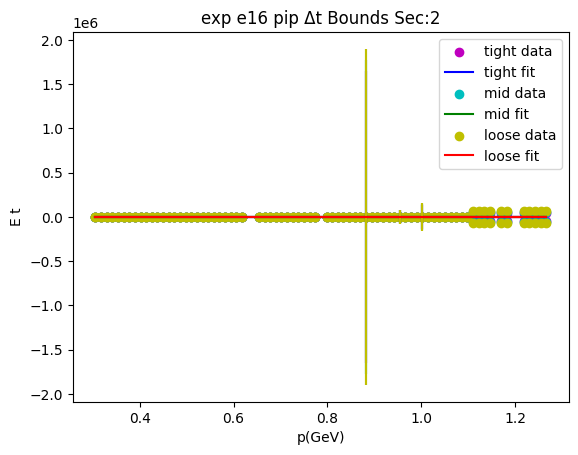

top [ 2.34234814 -7.83019612 10.37833885 -4.09610126]
low [-0.84943768  0.94175624 -2.94863746  1.55341173]
top [ 2.65770901 -8.68895198 11.68451481 -4.65024404]
low [-1.16634465  1.80763917 -4.26448917  2.11138398]
top [ 2.97304306 -9.54752118 12.99032396 -5.20421431]
low [-1.48287405  2.67172113 -5.57778729  2.66832052]


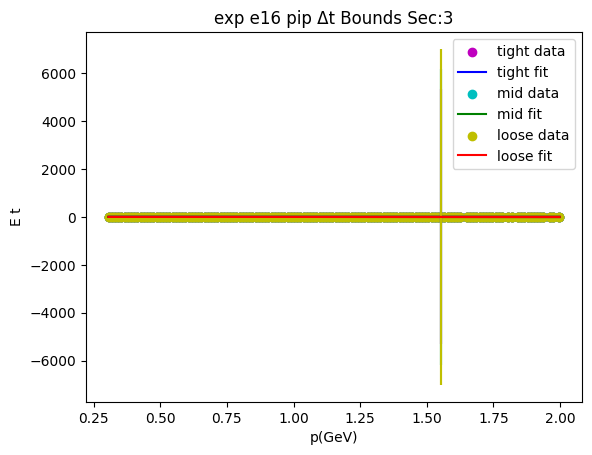

top [ 8.77782258e-01  1.03172063e-01 -6.04427678e-02 -8.08469242e-22]
low [-2.02692654  1.6574338  -0.63898446  0.01388719]
top [ 1.16787478e+00 -4.99005683e-02 -6.05631210e-03 -1.18329136e-26]
low [-2.30738259e+00  1.77342735e+00 -6.52043326e-01  7.43269884e-13]
top [ 1.45810687e+00 -2.03309840e-01  4.85175592e-02 -2.30313129e-16]
low [-2.59803606e+00  1.92790627e+00 -7.07256053e-01  6.07237379e-18]


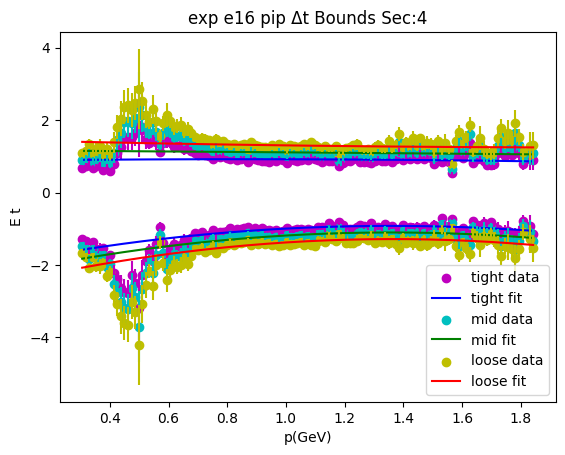

top [ 0.99022319 -2.14257327  5.679872   -2.99728353]
low [-1.88474543  5.36263322 -8.81407112  3.712919  ]
top [ 1.27956213 -2.90105082  7.13702859 -3.6702721 ]
low [ -2.17013038   6.10358464 -10.25011046   4.3785214 ]
top [ 1.56847454 -3.65762612  8.59178841 -4.34237926]
low [ -2.45597537   6.84656347 -11.6884842    5.04489649]


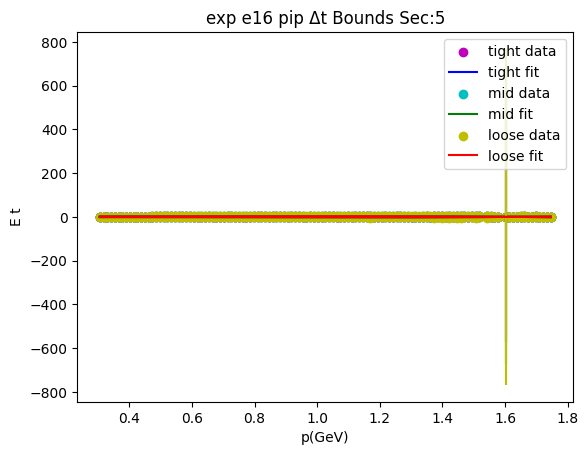

top [ 1.40988595 -3.45801752  6.45773195 -3.13269631]
low [-1.41149645  2.71599566 -5.46721631  2.82279323]
top [ 1.69457479 -4.08732087  7.66164112 -3.73142837]
low [-1.6967052   3.34726211 -6.67436513  3.42283786]
top [ 1.9795027  -4.71767068  8.86675019 -4.33055348]
low [-1.98204916  3.97919666 -7.88206544  4.02301059]


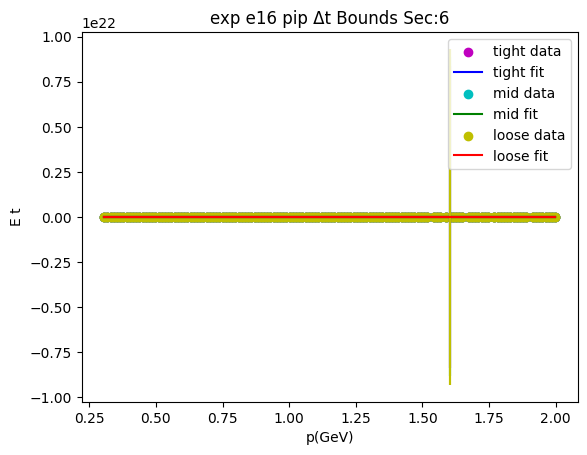

In [55]:
l0=0.0
l1=0.5
l2=-0.2
l3=0.2
initial_low_par2=[l0,l1,l2,l3]
t0=0.0
t1=0.5
t2=-0.2
t3=-0.2
initial_top_par2=[t0,t1,t2,t3]

low_par_fit= np.zeros((6,3,4))
top_par_fit = np.zeros((6,3,4))

cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

par_bou = [[[-np.inf,-np.inf,-np.inf,0.0],[np.inf,np.inf,np.inf,np.inf]],
           [[-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,0.0]]]

for sec in range(6):
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),label="{} data".format(cut_name[cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        #Fit with 3rd order Polynomial 
        par_low1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),p0=initial_low_par2,sigma=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),bounds=par_bou[0],maxfev=5000)
        par_top1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),p0=initial_top_par2,sigma=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),bounds=par_bou[1],maxfev=5000)
        print("top",par_top1[0])
        print("low",par_low1[0])
        for i in range(4):
            low_par_fit[sec][cut][i] = par_low1[0][i]
            top_par_fit[sec][cut][i] = par_top1[0][i]
        cont_x_low = np.linspace(Remove_Zeros_X(x,bounds1[sec][0][cut])[0],Remove_Zeros_X(x,bounds1[sec][0][cut])[len(Remove_Zeros_X(x,bounds1[sec][0][cut]))-1],200)
        cont_x_top = np.linspace(Remove_Zeros_X(x,bounds1[sec][1][cut])[0],Remove_Zeros_X(x,bounds1[sec][1][cut])[len(Remove_Zeros_X(x,bounds1[sec][1][cut]))-1],200)
        plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color=cut_cols[cut],label="{} fit".format(cut_name[cut]))
        plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color=cut_cols[cut])
    plot_title="{} {} {} \u0394t Bounds Sec:{}".format(sim,run,species,sec+1)
    plt.title(plot_title)
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.legend()
    plt.show()

In [56]:
#Stuff to make it so I can plot a 2d Histogram with data in the format I have
#Would be a lot easier if I had uproot 4 working 
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    for i in range(len(xbins)):
        for j in range(len(ybins)):
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]

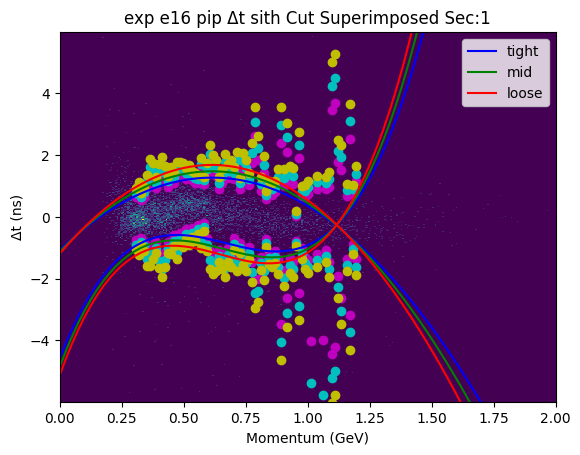

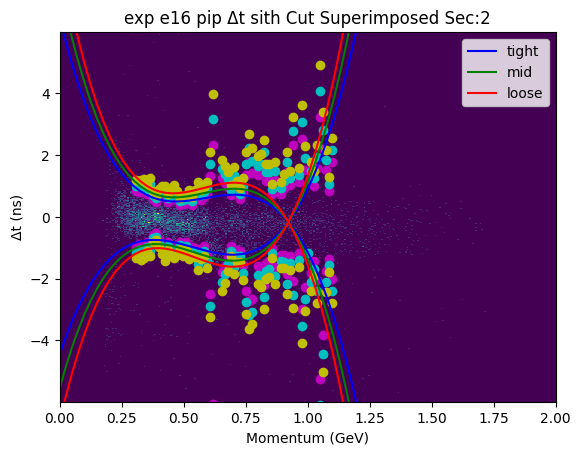

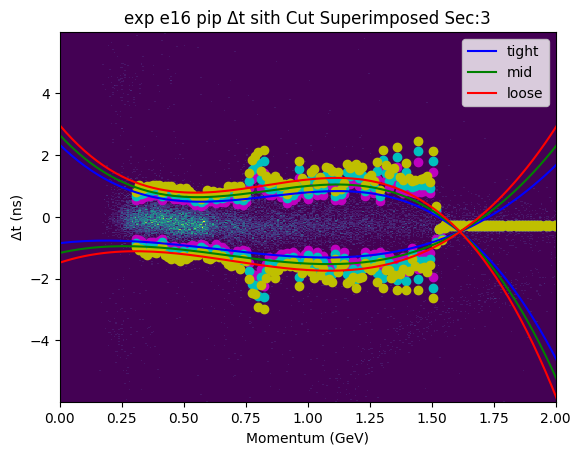

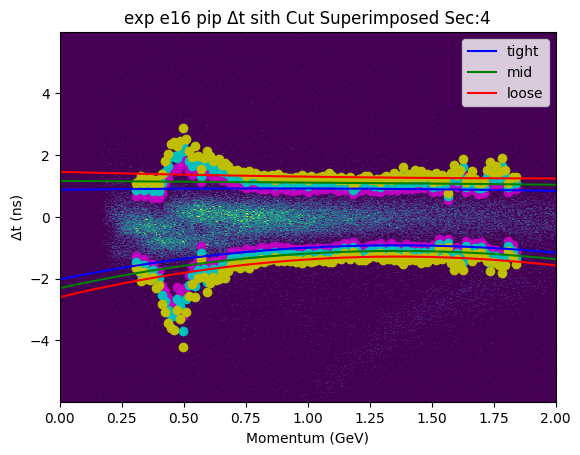

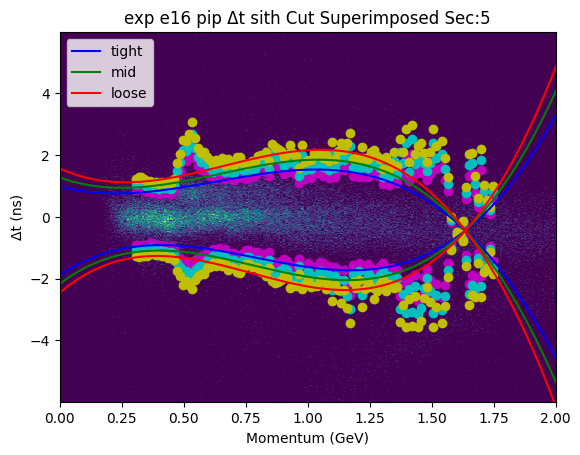

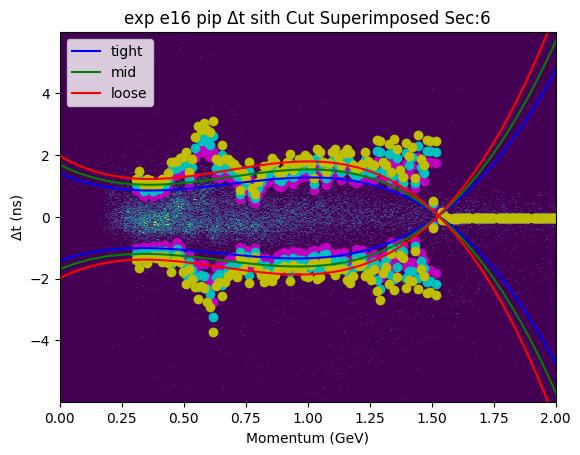

In [57]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(xbins), len(ybins)), weights=dense2[sec])
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        cont_x_low2 = np.linspace(0.0,5.0,200)
        cont_x_top2 = np.linspace(0.0,5.0,200)
        plt.plot(cont_x_low2,Poly3(cont_x_low2,*low_par_fit[sec][cut]),color=cut_cols[cut],label=cut_name[cut])
        plt.plot(cont_x_top2,Poly3(cont_x_top2,*top_par_fit[sec][cut]),color=cut_cols[cut])
        #cont_x_low = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut]))-1],200)
        #cont_x_top = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut]))-1],200)
        #plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color='y')
        #plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color='y')
    plt.title("{} {} {} \u0394t sith Cut Superimposed Sec:{}".format(sim,run,species,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("\u0394t (ns)")
    plt.xlim([0.0,2.0])
    
    plt.legend()
    plt.show()
    
    

In [58]:
print(cut_perf+" "+species+" Cut Parameters for ",num_sigma1," sigma cut using 3rd order Polynomial")
print("Lower Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        print("{\t{\t{",low_par_fit[sec][cut][par],end=",")
                    else:
                        print("\t{\t{",low_par_fit[sec][cut][par],end=",")
                else:
                    print("\t\t{",low_par_fit[sec][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            print(low_par_fit[sec][cut][par],"}}}")
                        else:
                            print(low_par_fit[sec][cut][par],"}},")
                    else:
                        print(low_par_fit[sec][cut][par],"},")
                else:
                    print(low_par_fit[sec][cut][par],end=",")
print("Upper Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        print("{\t{\t{",top_par_fit[sec][cut][par],end=",")
                    else:
                        print("\t{\t{",top_par_fit[sec][cut][par],end=",")
                else:
                    print("\t\t{",top_par_fit[sec][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            print(top_par_fit[sec][cut][par],"}}}")
                        else:
                            print(top_par_fit[sec][cut][par],"}},")
                    else:
                        print(top_par_fit[sec][cut][par],"},")
                else:
                    print(top_par_fit[sec][cut][par],end=",")
#print(low_par_fit)
#print(top_par_fit)

delta pip Cut Parameters for  [2.5, 3, 3.5]  sigma cut using 3rd order Polynomial
Lower Bound in order of increasing exponent
{	{	{ -4.59014170662765,20.721875194426246,-33.84295698702704,16.794988065241853 },
		{ -4.8621774208348985,21.608732525557915,-35.93221950323491,18.151012098194414 },
		{ -5.133502491640687,22.491778482389236,-38.01542675553456,19.504361758905006 }},
	{	{ -4.453305027461035,23.843454980302834,-48.43946486776543,29.953369622987655 },
		{ -5.55365666888281,29.553789116448886,-59.199433413279394,36.311304370547674 },
		{ -6.653805627875358,35.262637373126466,-69.95631534923417,42.66750035831012 }},
	{	{ -0.8494376760865774,0.9417562446872055,-2.948637464648333,1.5534117272370467 },
		{ -1.1663446464214047,1.8076391678949615,-4.264489174116016,2.1113839771230385 },
		{ -1.4828740489769814,2.6717211282056215,-5.577787285704722,2.6683205209411347 }},
	{	{ -2.026926544012596,1.6574337954972946,-0.6389844571984429,0.01388718590734796 },
		{ -2.3073825851787597,1.773427